In [1]:
import numpy as np
import matplotlib.pyplot as plt
# from matplotlib.ticker import FormatStrFormatter
from astropy import units as u
from astropy import constants as aconsts
from scipy.interpolate import interp1d

### Matplotlib params

In [455]:
from matplotlib import rcParams
rcParams['font.size'] = 10
rcParams['figure.dpi'] = 300

rcParams['font.family'] = 'serif'
rcParams['mathtext.fontset'] = 'dejavuserif'


### A4 width = 8.268 x 11.693
### margins = 3cm --> 6cm = 2.362205 inch
MPL_STD_WIDTH = 5.905795
MPL_STD_RATIO = 6.4 / 4.8 # width / height (from default)
MPL_STD_HEIGHT = MPL_STD_WIDTH / MPL_STD_RATIO

rcParams['figure.figsize'] = (MPL_STD_WIDTH, MPL_STD_HEIGHT)

## Util

In [3]:
# We need to add the path to the myutils.py file, in order to import it
from pathlib import Path
import sys
module_location = Path('/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model')
sys.path.append(str(module_location))

In [4]:
# Custom imports
from dataclasses import dataclass
from misc import Parameters, compute_quantities
from models import beta_model, nfw_potential_gradient, nfw_potential_gradient_scalar
import constants as cst

from caching import Cache
# Init
cache = Cache(Path.home() / 'dataserver' / 'MscThesis' / 'data' / 'cache')

In [684]:
def save_name(fname, ext="pdf", path=None):
    if path is None:
        path = Path("./figures/milkyway")
    return path / f"{fname}.{ext}"

def savefig(fig, name, ext="pdf", dpi=None, *args, **kwargs):
    if dpi is None:
        dpi = rcParams['figure.dpi']
    sname = save_name(name, ext=ext)
    fig.savefig(sname, dpi=dpi, bbox_inches = "tight")

In [6]:
from plotting import full_plot_all, recreate_plot_all
from matplotlib import colormaps

from itertools import chain, islice

from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
from matplotlib import colormaps

def annotate(text, xy, ax, **kwargs):
    # TODO: improve the defaults
    if 'bbox' in kwargs:
        bbox = kwargs['bbox']
        kwargs.remove('bbox')
    else:
        bbox = dict(facecolor='0.9', edgecolor='none', pad=3.0)
        
    if 'fontsize' not in kwargs:
        kwargs['fontsize'] = 7

    ax.annotate(
        text=text,
        xy=xy,
        xycoords='axes fraction',
        bbox=bbox,
        **kwargs
    )

### Cooling Functions

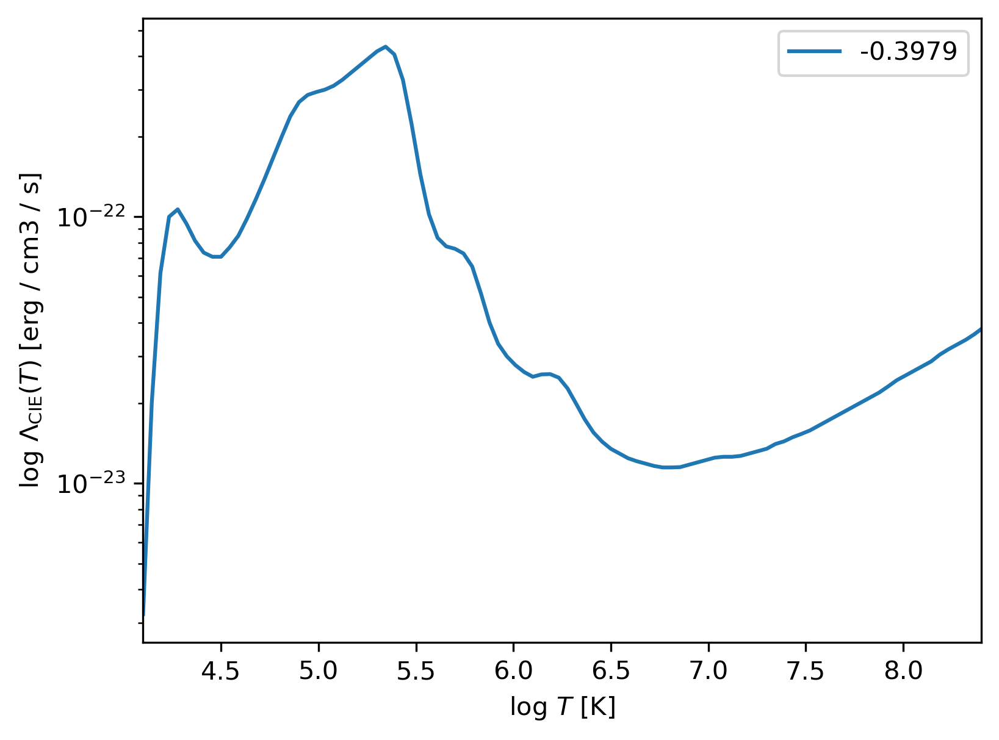

In [7]:
from cooling_func import CoolingFunc
cooling_sd = CoolingFunc(data_location="/net/virgo01/data/users/sipma/data/SutherlandCoolingFunctions")


# FeH -> log10(0.2)
def cooling_f_sd(T, n_e, FeH=-0.6989700043360187):
    T_in = np.log10(T * cst.TEMP_UNIT)  # Convert to log & set to correct unit
    L = cooling_sd(FeH, T_in)[0]
    return 10**L

Ts = np.linspace(4.1, 8.5, 100)  # Temperature in log space
L = cooling_f_sd(10**Ts / cst.TEMP_UNIT, n_e=None, FeH=np.log10(0.1))

# Plot the lines for different metallicity
fig, ax = plt.subplots(1, 1)
ax.plot(Ts, L, label=f"{-0.3979}")
ax.set_ylabel(r"$\log\, \Lambda_{\rm CIE}(T)$ [erg / cm3 / s]")
ax.set_xlabel(r"$\log\, T$ [K]")
ax.set_xlim(4.1, 8.4)
ax.set_yscale('log')
ax.legend()
plt.show()

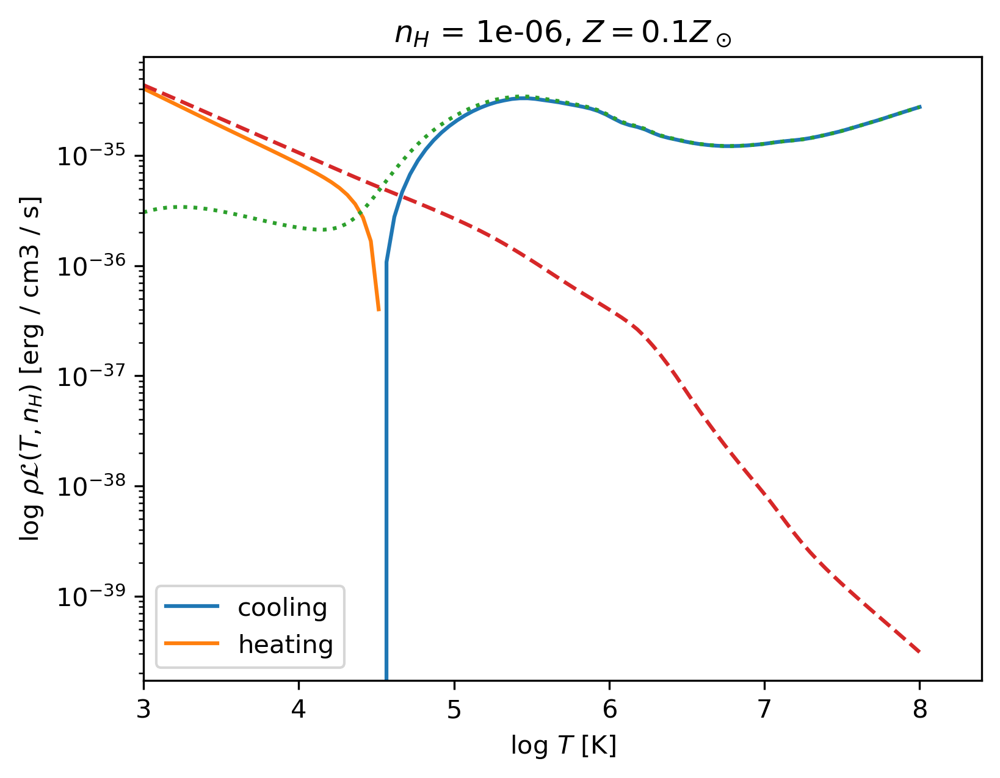

In [8]:
from MscThesisAstronomy.Cloudy.custom_read import CloudyCoolingFunc
cooling_cloudy = CloudyCoolingFunc(data_location=Path("MscThesisAstronomy/Cloudy/FinalTable.txt"), interp_method='pchip')

## Maps the metallicity to the n_H = a x rho relation (the number here is a)
## input is metallicity in relative solar metallicity
DENSITY_NH_MAP = {
    0.05 : 1.321933959813,
    0.10 : 1.327257504256,
    0.20 : 1.346317884938,
    0.30 : 1.367010767026,
    0.40 : 1.377914209247,
}


def cooling_f_cloudy(T, n_H, Z=0.2):
    """
    Returns cooling - heating for the cloudy cooling func
    
    T: not in log space
    n_H: not in log space
    Z: not in log space, relative to solar metallicity (= Z*Z_sol)
    """
    T_in = T * cst.TEMP_UNIT  # Convert to correct unit
    
    # Convert to correct shape (if not in correct shape)
    n_H_in = np.broadcast_to(np.array(n_H), T.shape)
    
    # Convert to correct shape
    Z_in = np.broadcast_to(np.array(Z), T.shape)
    
    heat = cooling_cloudy.heating(n_H_in, Z_in, T_in)
    cool = cooling_cloudy.cooling(n_H_in, Z_in, T_in)
    return cool - heat, heat, cool

Ts = np.linspace(3.0, 8.0, 100)  # Temperature in log space
n_H = 1e-6
L, heat, cool = cooling_f_cloudy(10**Ts / cst.TEMP_UNIT, n_H=n_H, Z=0.1)

# Plot the lines for different metallicity
fig, ax = plt.subplots(1, 1)
ax.plot(Ts, L, label=f"cooling")
ax.plot(Ts[L < 0], -L[L < 0], label=f"heating")

ax.plot(Ts, cool, ls=':')
ax.plot(Ts, heat, ls='--')

ax.set_ylabel(r"$\log\, \rho\mathcal{L}(T, n_H)$ [erg / cm3 / s]")
ax.set_xlabel(r"$\log\, T$ [K]")
ax.set_xlim(3.0, 8.4)
ax.set_yscale('log')
ax.legend()
ax.set_title(f"$n_H$ = {n_H}, $Z = 0.1Z_\odot$")
plt.show()

### Stern

In [9]:
def stern2019_quantities_new(r, M12=1.3, dotM_1=1, m=0.0, cool_22=0.6):
    """
    Mhalo = 1e12 * M12
    dotM  = 1 * dotM_1  # Msol / yr
    r     = r_100 * 100  # kpc
    
    # They assume:
    Z = 0.3Zo
    cool_22 = 0.6 # Maybe specify this using the cooling function we have?
    
    Adapted for m = 0
    """
    r_100 = r / 100 # give r in kpc
    
    A = (9/10)*(1 - 2*m)
    B = 1 + (4/3)*m
    
    rho = 2.3e-5 * np.sqrt(B/A) * M12**(0.36) * dotM_1**(1 / 2) * cool_22**(-1 / 2) * r_100**(m-3/2)  # m_p / cm3
    v_r = -13.6 * np.sqrt(A/B) * M12**(-0.36) * dotM_1**(1 / 2) * cool_22**(1 / 2) * r_100**(-m-1/2) # km / s
    T = 7.2e5 / A / 2.6**(2*m) * M12**(2/3 - 2*m/3) * r_100 ** (2*m) # K
    mach = 0.11 # CHANGE ?
    Rsonic = 0.06 # CHANGE ?
    ## for m=-0.1 : 
    # mach = 0.11 * M12**(-0.72) * dotM_1**(1 / 2) * cool_22**(-1 / 2) * r_100**(-0.3) 
    # Rsonic = 0.06 * M12**(-2.4) * dotM_1**(1.67) * cool_22**(1.67) # kpc
    
    return rho, v_r, T, mach, Rsonic

## Initial Conditions

### Milky Way

In [520]:
from scipy.integrate import cumulative_trapezoid, trapezoid


def mw_initial_conditions(R_ref=None, R_out=None, beta_param=None, T_ref=None, electron=True):
    ## For the NFW profile
    M_vir = 1.3e12 * cst.solmass
    r_vir = 282e3 * cst.pc_to_cm
    c_vir = 10

    r_s = r_vir / c_vir

    rho_s = M_vir / (16 * np.pi * r_s**3 * (np.log(1 + c_vir) - c_vir /
                                            (1 + c_vir)))
    NFW_param_mw = (r_s, rho_s)

    if T_ref is None:
        T_ref = 10**6.3  # Kelvin

    if R_out is None:
        R_out = r_vir

    if R_ref is None:
        R_out0 = R_out
    else:
        R_out0 = R_ref

    if beta_param:
        n_0, r_c, beta = beta_param
    else:
        n_0 = 2.6e-3  # cm-3
        r_c = 3.0  # kpc
        beta = 0.5

    dR = 1 * cst.pc_to_cm  # pc

    ## Density profile
    # Make spacing better
    #     M_low = 10**np.arange(-3, np.log10(dM / solmass), .2) * solmass
    #     r = np.linspace(0, R_out, 10000)
    r1 = 10**np.arange(-4, np.log10(dR / cst.pc_to_cm), .2) * cst.pc_to_cm
    r2 = np.arange(dR, R_out0 + 1, dR)
    r = np.append(r1, r2)

    n_e = beta_model(r / cst.pc_to_cm / 1e3, n0=n_0, rc=r_c, beta=beta)

    #     T_inf = 10**6.3 # Kelvin

    n_frac = 11 / 6  # Conversion of n = frac * n_e
    mu = 0.62
    if electron:
        n = n_frac * n_e
    else:
        n = n_e
    rho = mu * cst.proton_mass * n

    # Calculate based on a constant T profile and given density
    P_ref = n[-1] * cst.k_B * T_ref

    # Find optimal P_0
    #     g = np.array([-nfw_potential_gradient_scalar(i, r_s=r_s, rho_s=rho_s) for i in r])
    g = -nfw_potential_gradient(r, r_s=r_s, rho_s=rho_s)
    rhs_P = g * rho

    P_guess = cumulative_trapezoid(rhs_P, r, initial=0)
    P_0 = P_ref - P_guess[-1]
    P = P_guess + P_0

    P_0_ref = P_0

    ### Now we have P_0, so we can integrate further to get P_inf at an actual outer radius
    ### we also integrate Mass now

    r1 = 10**np.arange(-4, np.log10(dR / cst.pc_to_cm), .2) * cst.pc_to_cm
    r2 = np.arange(dR, R_out + 1, dR)
    r = np.append(r1, r2)

    n_e = beta_model(r / cst.pc_to_cm / 1e3, n0=n_0, rc=r_c, beta=beta)
    if electron:
        n = n_frac * n_e
    else:
        n = n_e
    rho = mu * cst.proton_mass * n

    # Integrate rho (TODO: integration can also be analytic?)
    rhs_M = 4 * np.pi * r**2 * rho
    M = cumulative_trapezoid(rhs_M, r, initial=0)
    M_tot = M[-1]

    # Integrate P (with known P_0)
    #     g = np.array([-nfw_potential_gradient_scalar(i, r_s=r_s, rho_s=rho_s) for i in r])
    g = -nfw_potential_gradient(r, r_s=r_s, rho_s=rho_s)
    rhs_P = g * rho
    P = cumulative_trapezoid(rhs_P, r, initial=0) + P_0_ref

    P_inf_ref = P[-1]
    sig = P / rho**cst.gamma

    # Convert back to right units:
    M_tot /= cst.MASS_UNIT
    R_out /= cst.LEN_UNIT
    r_s /= cst.LEN_UNIT
    rho_s /= cst.DENS_UNIT
    P_inf_ref /= cst.PRES_UNIT
    P_0_ref /= cst.PRES_UNIT
    M /= cst.MASS_UNIT
    sig /= cst.SIG_UNIT

    P /= cst.PRES_UNIT
    n_e /= cst.NDENS_UNIT
    r /= cst.LEN_UNIT

    return P, M, n_e, r, Parameters(M_tot=M_tot,
                                    R_out=R_out,
                                    r_s=r_s,
                                    rho_s=rho_s,
                                    P_inf=P_inf_ref,
                                    P_0=P_0_ref,
                                    M=M,
                                    sig=sig,
                                    r=r)

In [521]:
# Initial conditions:

def ic_mb2016():
    rc = 2.12 # kpc
    beta = 0.49
    C = 0.0135
    n0 = C / (rc ** (3*beta)) # cm-3

    Z = 0.3 # Zsol
    return (n0, rc, beta), Z

def ic_mb2016_rescaled():
    scale = 0.3 / 0.09 # To get  M_cgm / (Mb - Mdisk) ~ 0.3

    rc = 2.12 # kpc
    beta = 0.49
    C = scale*0.0135

    n0 = C / (rc ** (3*beta)) # cm-3
    
    Z = 0.1 # Zsol
    return (n0, rc, beta), Z

### Plots

[4.47321789e-03 4.46591662e-03 4.44418055e-03 ... 3.38165287e-06
 3.37988909e-06 3.37812686e-06]


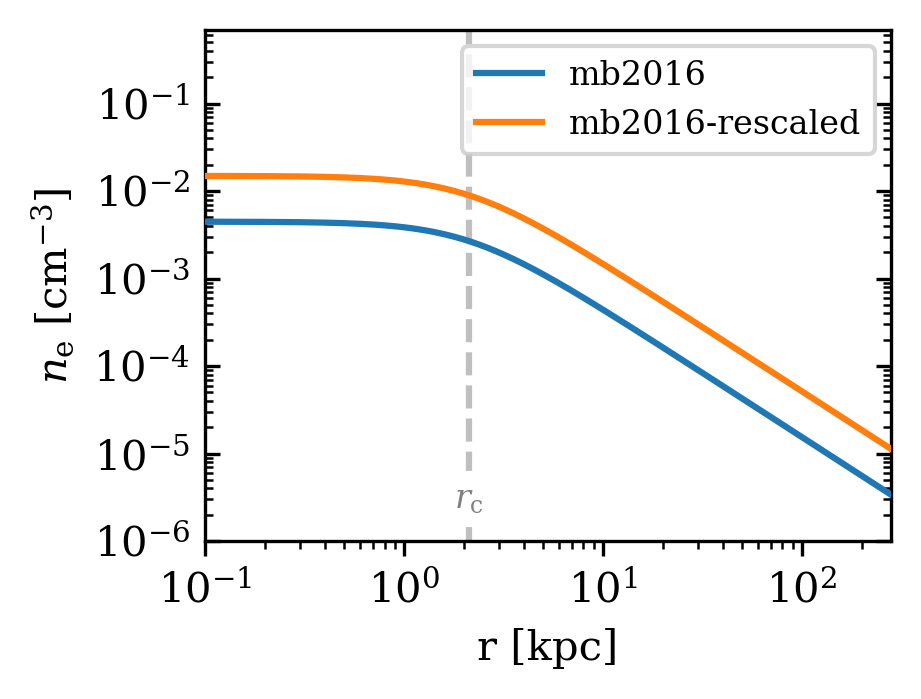

In [685]:

# #         stern_params = {'M12': 1.3, 'dotM_1': 2.0, 'cool_22': 0.6}
# if 'rescaled' in name:
#     cool_22 = 0.25
# else:
#     cool_22 = 0.6

# ylim = ax[0, 0].get_ylim()
# ylimT = ax[0, 1].get_ylim()
# ylimS = ax[0, 2].get_ylim()
# for dotM_1 in [0.1, 1, 10]:
#     rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
#     n_e = 0.88*rho

#     rh = rho*cst.proton_mass
#     sig = cst.k_B * T / (mu*cst.proton_mass*rh**(cst.gamma - 1))
#     ax[0, 0].plot(r0 / 1e3, n_e, c='gray', ls='--')
#     ax[0, 2].plot(r0 / 1e3, sig, c='gray', ls='--')
# ax[0, 1].plot(r0 / 1e3, T, c='gray', ls='--')
# #             ax[0, 2].plot(r0 / 1e3, n_e, c='gray', ls='--')

# ax[0, 0].set_ylim(*ylim)
# ax[0, 1].set_ylim(*ylimT)
# ax[0, 2].set_ylim(*ylimS)

fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/2, MPL_STD_HEIGHT/2))

(n0, rc, beta), Z = ic_mb2016()
r = np.arange(0, 282, 0.1)
n_e = beta_model(r, n0, rc, beta)
print(n_e)
ax.plot(r, n_e, zorder=10, label='mb2016')

(n0, rc, beta), Z = ic_mb2016_rescaled()
n_e = beta_model(r, n0, rc, beta)
ax.plot(r, n_e, zorder=10, label='mb2016-rescaled')

ax.axvline(rc, alpha=0.5, c='gray', ls='--')

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(0.1, param.R_out / 1e3)
ax.set_ylim(1e-6, 0.7)

ax.set_ylabel(r'$n_{\rm e}$ [cm$^{-3}$]')
ax.set_xlabel('r [kpc]')
    
ax.tick_params(axis="y", direction='in', which='both', right=True)  #, length=8)

ax.legend(fontsize=8)

ax.text(rc, 3e-6, r"$r_{\rm c}$", c='gray', ha='center', va='center', size=8, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})

savefig(fig, "ic-density")


plt.show()

1.71e-15
5.68e-15


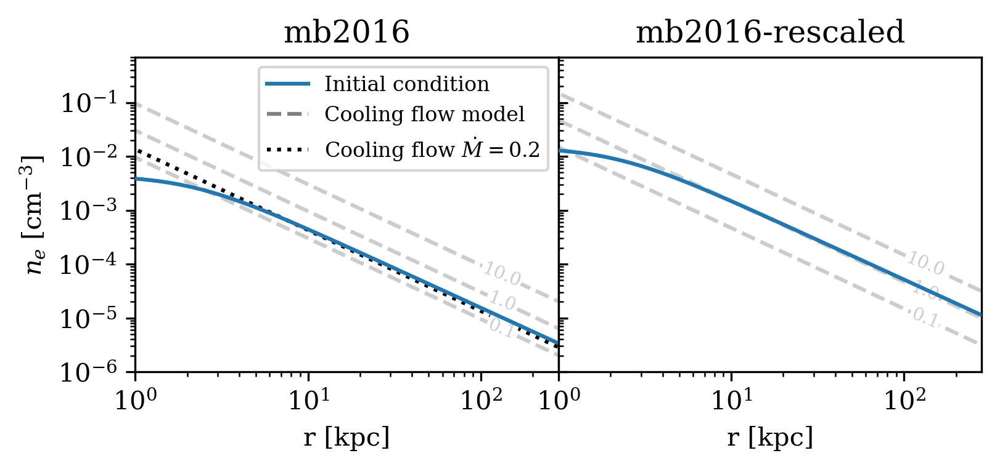

In [522]:

# #         stern_params = {'M12': 1.3, 'dotM_1': 2.0, 'cool_22': 0.6}
# if 'rescaled' in name:
#     cool_22 = 0.25
# else:
#     cool_22 = 0.6

# ylim = ax[0, 0].get_ylim()
# ylimT = ax[0, 1].get_ylim()
# ylimS = ax[0, 2].get_ylim()
# for dotM_1 in [0.1, 1, 10]:
#     rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
#     n_e = 0.88*rho

#     rh = rho*cst.proton_mass
#     sig = cst.k_B * T / (mu*cst.proton_mass*rh**(cst.gamma - 1))
#     ax[0, 0].plot(r0 / 1e3, n_e, c='gray', ls='--')
#     ax[0, 2].plot(r0 / 1e3, sig, c='gray', ls='--')
# ax[0, 1].plot(r0 / 1e3, T, c='gray', ls='--')
# #             ax[0, 2].plot(r0 / 1e3, n_e, c='gray', ls='--')

# ax[0, 0].set_ylim(*ylim)
# ax[0, 1].set_ylim(*ylimT)
# ax[0, 2].set_ylim(*ylimS)

fig, ax = plt.subplots(1, 2, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2), sharey=True, sharex=True)

beta_param, Z = ic_mb2016()
_, _, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
ax[0].plot(r / 1e3, n_e, zorder=10)
print(f"{param.P_inf * cst.PRES_UNIT:.2e}")

beta_param, Z = ic_mb2016_rescaled()
_, _, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
ax[1].plot(r / 1e3, n_e, zorder=10)
print(f"{param.P_inf * cst.PRES_UNIT:.2e}")

###### Stern
r0 = np.arange(1., param.R_out, 1000.)

for dotM_1 in [0.1, 1, 10]:
    rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=0.6)
    n_e = 0.88*rho
    line, = ax[0].plot(r0 / 1e3, n_e, alpha=0.4, c='gray', ls='--')
    
    x = line.get_xdata()[-150]
    y = line.get_ydata()[-150]
    ax[0].text(x, y, f"{dotM_1:.1f}", alpha=0.4, c='gray', ha='center', va='center', size=7, rotation=-22, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})
    
    rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=0.25)
    n_e = 0.88*rho
    
    line, = ax[1].plot(r0 / 1e3, n_e, alpha=0.4, c='gray', ls='--')
    x = line.get_xdata()[-150]
    y = line.get_ydata()[-150]
    ax[1].text(x, y, f"{dotM_1:.1f}", alpha=0.4, c='gray', ha='center', va='center', size=7, rotation=-22, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})
    
rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=0.2, cool_22=0.6)
n_e = 0.88*rho
line, = ax[0].plot(r0 / 1e3, n_e, c='k', ls=':')
#     break
########



ax[0].set_yscale('log')
ax[0].set_xscale('log')
ax[0].set_xlim(1, param.R_out / 1e3)
ax[0].set_ylim(1e-6, 0.7)

ax[0].set_ylabel('$n_e$ [cm$^{-3}$]')
for a in ax:
    a.set_xlabel('r [kpc]')
    
ax[0].set_title('mb2016')
ax[1].set_title('mb2016-rescaled')
ax[1].tick_params(axis="y", direction='in', which='both')  #, length=8)

fig.subplots_adjust(wspace=0)

handles =  [
    Line2D([0], [0], c='tab:blue', ls='-', label='Initial condition'),
    Line2D([0], [0], c='gray', ls='--', label='Cooling flow model'),
    Line2D([0], [0], c='k', ls=':', label='Cooling flow $\dot M = 0.2$'),
]
ax[0].legend(handles=handles, fontsize=8)


savefig(fig, "ic-density-compare")


plt.show()

1.71e-15
5.68e-15


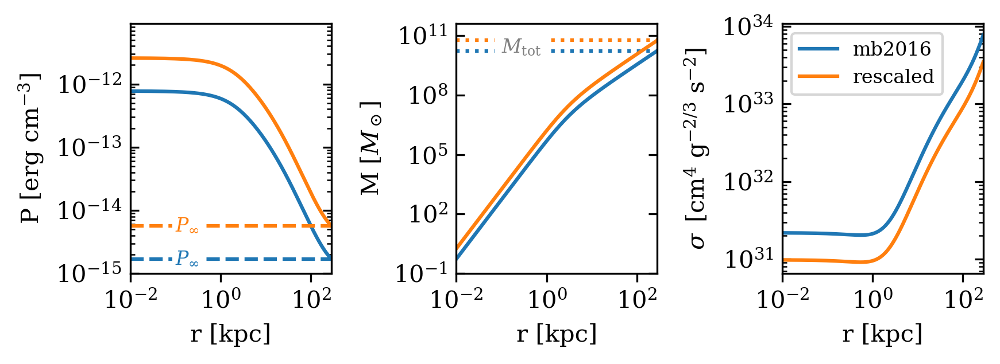

In [714]:
fig, ax = plt.subplots(1, 3, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2), sharex=True)

beta_param, Z = ic_mb2016()
P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)

ax[0].plot(r / 1e3, P*cst.PRES_UNIT)
ax[1].plot(r / 1e3, M*cst.MASS_UNIT / cst.solmass)
ax[2].plot(r / 1e3, param.sig * cst.SIG_UNIT)

ax[0].axhline(param.P_inf * cst.PRES_UNIT, ls='--', c='tab:blue')
ax[1].axhline(param.M_tot * cst.MASS_UNIT / cst.solmass, ls=':', c='tab:blue')

ax[0].text(1e-1, param.P_inf * cst.PRES_UNIT, "$P_\infty$", c='tab:blue', va='center', size=8, bbox={'boxstyle': 'square,pad=0.1', 'fc':'white', 'ec':'white'})

ax[1].text(1e-1, param.M_tot * 1.5 * cst.MASS_UNIT / cst.solmass, r"$M_{\rm tot}$", c='gray', va='center', size=8, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})

print(f"{param.P_inf * cst.PRES_UNIT:.2e}")

beta_param, Z = ic_mb2016_rescaled()
P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)

ax[0].plot(r / 1e3, P*cst.PRES_UNIT)
ax[1].plot(r / 1e3, M*cst.MASS_UNIT / cst.solmass)
ax[2].plot(r / 1e3, param.sig * cst.SIG_UNIT)

ax[0].axhline(param.P_inf * cst.PRES_UNIT, ls='--', c='tab:orange')
ax[1].axhline(param.M_tot * cst.MASS_UNIT / cst.solmass, ls=':', c='tab:orange')

ax[0].text(1e-1, param.P_inf * cst.PRES_UNIT, "$P_\infty$", c='tab:orange', va='center', size=8, bbox={'boxstyle': 'square,pad=0.1', 'fc':'white', 'ec':'white'})

print(f"{param.P_inf * cst.PRES_UNIT:.2e}")


for a in ax:
    a.set_yscale('log')
    a.set_xlabel('r [kpc]')
    a.tick_params(axis='y', which='both', direction='in', right=True)

ax[0].set_xscale('log')
ax[0].set_xlim(0.01, param.R_out / 1e3)

ax[0].set_ylim(1e-15, 9e-12)
ax[1].set_ylim(0.1, 4e11)

ax[0].set_ylabel('P [erg cm$^{-3}$]')
ax[1].set_ylabel('M [$M_\odot$]')
ax[2].set_ylabel(r'$\sigma\,\,\,[{\rm cm}^4\,\,{\rm g}^{-2/3}\,\,{\rm s}^{-2}]$')

        
# ax[0].set_ylim(1e-6, 0.7)

# ax[0].set_ylabel('$n_e$ [cm$^{-3}$]')
# for a in ax:
#     a.set_xlabel('r [kpc]')
    
# ax[0].set_title('mb2016')
# ax[1].set_title('mb2016-rescaled')
# ax[1].tick_params(axis="y", direction='in', which='both')  #, length=8)

# fig.subplots_adjust(wspace=0)

handles =  [
    Line2D([0], [0], c='tab:blue', ls='-', label='mb2016'),
    Line2D([0], [0], c='tab:orange', ls='-', label='rescaled'),
]
ax[2].legend(handles=handles, fontsize=8)



fig.tight_layout()
savefig(fig, "initial-conditions")


plt.show()

## Integration

In [13]:
from kb_integration import integrate_hydrostatic_equilibrium

## Convection

In [14]:
import numba


@numba.jit(nopython=True)
def equalize_entropy(sig, T, M):
    sig = sig.copy()
    restart = True
    Mshell = M[1:] - M[:-1]
    Mshell = np.append([0], Mshell)
    while restart:  # Keep looping until everything is flat.
        restart = False
        s_prev = sig[0]
        for i, s in enumerate(sig[1:], 1):
            if s_prev > s:
                # Instabiel, zei de kat
                start = i - 1

                # Sum variables
                sTM = 0
                TM = 0
                s_prev_inner = s_prev + 1
                for j, s_inner in enumerate(sig[start:], start):
                    #                     if s_inner > s_prev:
                    if s_inner > s_prev_inner:
                        end = j
                        break
                    sTM += np.log(s_inner) * T[j] * Mshell[j]
                    TM += T[j] * Mshell[j]

                    s_prev_inner = s_inner
                else:
                    end = len(sig)
                smean = sTM / TM  # = ln (sig_mean), so exponentiate later

                sig[start:end] = np.exp(smean)

                # Restart the loop
                restart = True
                break

            s_prev = s
    return sig


def apply_convection(r, P, M, sig, param, **kwargs):
    rho, n_e, T = compute_quantities(r, P, M, sig, mu=0.62)

    sig_new = equalize_entropy(sig, T, M)
    if any(sig_new[:-1] > sig_new[1:]):
        print("WARN: Negative gradient after convection calc")

    sig_func = interp1d(M, sig_new, kind="linear", fill_value="extrapolate")
    r, y = integrate_hydrostatic_equilibrium(
        P[0],
        M=M,
        sig=sig_new,
        r_s=param.r_s,
        rho_s=param.rho_s,
        M_tot=param.M_tot,
        P_inf=param.P_inf,
        **kwargs,
    )
    P, M = y.T

    # Updates sigma + updated masses
    sig_new = sig_func(M)
    if any(sig_new[:-1] > sig_new[1:]):
        print("WARN: Negative gradient after H.E. integration")

    return r, P, M, sig_new

## Evolution

### Updating Entropy

In [15]:
def update_entropy_sd(r, P, M, sig, temperature_limit, dt_lower_factor, dt, Z):
    rho, n_e, T = compute_quantities(r, P, M, sig)

    # Apply a limit to the cooling
#     lamb = np.zeros_like(T)

    idx_good = T > temperature_limit
    lamb = cooling_f_sd(T[idx_good], None, FeH=np.log10(Z))

    # Calculate the cooling time for cells above the temperature limit.
    # Cells above will be set to inf (because cooling = 0)
    t_cool = np.full_like(sig, np.inf)
    t_cool[idx_good] = (3 / 2) * 2.2 / n_e[idx_good] * T[idx_good] / lamb * cst.C3
    min_t_cool = t_cool.min()

    if min_t_cool / dt_lower_factor <= dt:
        dt = min_t_cool / dt_lower_factor  # Can refine this guess ?

    sig_new = sig*(1 - dt / t_cool)

    return sig_new, dt, t_cool

In [16]:
def update_entropy_cloudy(r, P, M, sig, temperature_limit, dt_lower_factor, dt, Z, onlycool=False):
    rho, n_e, T = compute_quantities(r, P, M, sig, mu=0.62)

    # Apply a limit to the cooling
    a = DENSITY_NH_MAP[Z]  # From relation between n_H and rho for different Z
    n_H = rho / a
    lamb, heat, cool, = cooling_f_cloudy(T, n_H, Z=Z)
    
    if onlycool:
        lamb = cool
        
    mu = 0.62 # Use same value as used in compute_quantities
    n = rho / mu # TODO: check if this is correct (since we use rho differently before)
    
    # Calculate cooling time (used for updating and checking lower limit)
    # Can be inf if the cooling is below the temperature limit, so if
    # used in the update, set those components to 0 again.
    t_cool = (3 / 2) * n * T / lamb * cst.C3
#     min_t_cool = t_cool[t_cool > 0].min()
    min_t_cool = np.abs(t_cool).min()

    if min_t_cool / dt_lower_factor <= dt:
        dt = min_t_cool / dt_lower_factor  # Can refine this guess ?

    sig = sig*(1 - dt / t_cool)
    return sig, dt, t_cool

In [17]:
def gaussian_3d(r, sigma, norm=1):
    return norm * (2 * np.pi * sigma**2)**(-3 / 2) * np.exp(-r**2 / (2 * sigma**2))


def sech(x):
    return 1 / np.cosh(x)


def sech2_3d(r, sigma, norm=1):
    return 3 * norm / (np.pi**3 * sigma**3) * sech(r / sigma)**2


def fermi_bubble_heat(r, scale=3e3, E_tot=1e39, kernel_func=gaussian_3d):
    # Scale: units of pc
    # E_tot: units of erg / s
    # r    : units of pc
    kernel = kernel_func(r, sigma=scale, norm=1)  # unit in 1 / pc3
    kernel /= (cst.pc_to_cm)**3  # Convert 1/pc3 to 1/cm3
    return E_tot * kernel  # Unit erg / s / cm3


def update_entropy_bubble(r,
                          P,
                          M,
                          sig,
                          temperature_limit,
                          dt_lower_factor,
                          dt,
                          Z,
                          fb_scale=3e3,
                          fb_heat=1e39,
                          kernel_func=gaussian_3d):
    rho, n_e, T = compute_quantities(r, P, M, sig, mu=0.62)

    # Apply a limit to the cooling
    a = DENSITY_NH_MAP[Z]  # From relation between n_H and rho for different Z
    n_H = rho / a
    lamb, _, _, = cooling_f_cloudy(T, n_H, Z=Z)

    # Also add fermi bubble heating
    fb_heat = fermi_bubble_heat(r, scale=fb_scale, E_tot=fb_heat, kernel_func=kernel_func)
    lamb -= fb_heat

    mu = 0.62  # Use same value as used in compute_quantities
    n = rho / mu  # TODO: check if this is correct (since we use rho differently before)

    # Calculate cooling time (used for updating and checking lower limit)
    # Can be inf if the cooling is below the temperature limit, so if
    # used in the update, set those components to 0 again.
    t_cool = (3 / 2) * n * T / lamb * cst.C3
    #     min_t_cool = t_cool[t_cool > 0].min()
    min_t_cool = np.abs(t_cool).min()

    if min_t_cool / dt_lower_factor <= dt:
        dt = min_t_cool / dt_lower_factor  # Can refine this guess ?

    sig = sig * (1 - dt / t_cool)
    return sig, dt, t_cool

In [18]:
def update_entropy_stopcool(r, P, M, sig, temperature_limit, dt_lower_factor, dt, Z):
    rho, n_e, T = compute_quantities(r, P, M, sig)

    R_LIMIT = 1e3
    # Apply a limit to the cooling
    idx_good = r > R_LIMIT
    a = DENSITY_NH_MAP[Z]  # From relation between n_H and rho for different Z
    n_H = rho / a
    lamb, _, _, = cooling_f_cloudy(T[idx_good], n_H[idx_good], Z=Z)

    mu = 0.62 # Use same value as used in compute_quantities
    n = rho / mu # TODO: check if this is correct (since we use rho differently before)
    
    # Calculate the cooling time for cells above the temperature limit.
    # Cells above will be set to inf (because cooling = 0)
    t_cool = np.full_like(sig, np.inf)
    t_cool[idx_good] = (3 / 2) * n[idx_good] * T[idx_good] / lamb * cst.C3
    min_t_cool = t_cool.min()

    if min_t_cool / dt_lower_factor <= dt:
        dt = min_t_cool / dt_lower_factor  # Can refine this guess ?

    sig_new = sig*(1 - dt / t_cool)

    return sig_new, dt, t_cool

In [19]:
import traceback
def print_types(**kwargs):
    for name, arg in kwargs.items():
        print(f"{name}: {type(arg)}")
    print("-------------")

### Adaptive Evolution

In [20]:
def evolve_adaptive(
    update_entropy,
    dt_start,
    t_max,
    metallicity,
    param: Parameters = None,
    max_niter=40,
    temperature_limit=None,
    dt_lower_factor=2,
    dt_limit=0.01, # TODO: see if this is a good limit?
    convection=False,
    r_inner=0.0,
    entropy_kwargs=None,
):
    entropy_kwargs = {} if entropy_kwargs is None else entropy_kwargs
    
    # TODO: add docstring
    M0 = param.M
    sig0 = param.sig
    r_s, rho_s = param.r_s, param.rho_s
    P_inf_ref = param.P_inf
    P_0_guess = param.P_0
    R_out = param.R_out
    M_tot = param.M_tot
    
    ## Boundary conditions at r > 0, will also give a nonzero mass
    M_inner = 0.0
    if r_inner > 0.0:
        M_func = interp1d(param.r, param.M, kind="linear")
        M_inner = float(M_func(r_inner))
        print(f"Integrating from nonzero r: {r_inner}, found mass: {M_inner} 10^8 Mo")

    sig_func = interp1d(M0, sig0, kind="linear", fill_value="extrapolate")
    r, y = integrate_hydrostatic_equilibrium(
        P_0_guess,
        M=M0,
        sig=sig0,
        r_s=r_s,
        rho_s=rho_s,
        M_tot=M_tot,
        P_inf=P_inf_ref,
        r0=r_inner,
        M0=M_inner,
    )
    P, M = y.T

    sig = sig_func(M)

    if convection:
        print("Applying convection")
        r, P, M, sig = apply_convection(r, P, M, sig, param, r0=r_inner, M0=M_inner)

    # Store initial values
    radii = [r]
    pressures = [P]
    masses = [M]
    sigmas = [sig]
    # Empty first, will be added at the start of the first iteration.
    t_cools = []

    dt = dt_start
    t = 0.
    time_steps = [t]

    niter = 0

    try:
        while niter < max_niter and t < t_max:
            print(f"Iteration {niter:>3d}, at {t:g} Myr")

            sig, dt, t_cool = update_entropy(r, P, M, sig, temperature_limit,
                                             dt_lower_factor, dt, metallicity, **entropy_kwargs)
            t_cools.append(t_cool)

            if dt < dt_limit:
                print(f"Lower limit for timestep reached: {dt} Myr < {dt_limit} Myr. Stopping evolution.")
                break

            if np.any(sig < 0):
                print("Negative entropy found stopping evolution")
                raise ValueError()

            ## To resynchronize later
            sig_func = interp1d(M,
                                sig,
                                kind="linear",
                                fill_value="extrapolate")
            # Updated sigma, old masses
            P_0_guess = P[0]  #* 1e1
            r, y = integrate_hydrostatic_equilibrium(
                P_0_guess,
                M=M,
                sig=sig,
                r_s=r_s,
                rho_s=rho_s,
                M_tot=M_tot,
                P_inf=P_inf_ref,
                r0=r_inner,
                M0=M_inner,
            )
            P, M = y.T

            # Updated sigma + updated masses
            sig = sig_func(M)

            if convection:
                print("Applying convection")
                r, P, M, sig = apply_convection(r, P, M, sig, param, r0=r_inner, M0=M_inner)

            # Update time
            t += dt
            dt = dt_start  # reset
            niter += 1

            sigmas.append(sig)
            radii.append(r)
            masses.append(M)
            pressures.append(P)
            time_steps.append(t)
        else:
            if not niter < max_niter:
                print(f"\nReached max number of iterations: {max_niter}")
            elif not t < t_max:
                print(f"\nReached max time: {t_max} Myr")
            else:
                # Should not happen...
                print("\nLoop exited for unknown reason")
    except Exception as e:
        print(
            f"Evolution failed at time {t:.2f} Myr with exception {e}                  "
        )
        traceback.print_exc()

    print("\nDone")

    #     return {'time': np.array(time_steps), 'radius': radii, 'pressure': pressures, 'mass': masses, 'sig':sigmas, 't_cool': t_cools}
    return np.array(time_steps), radii, pressures, masses, sigmas, t_cools

## Execution

### Test
Also partly to let the Numba routines compile once.

In [21]:
from time import process_time

TEMPERATURE_LIM = 10**(4.2) / cst.TEMP_UNIT

In [22]:
from multiprocessing import Pool


def evolve_test(cache,
                     name,
                     entropy_func,
                     *args,
                     dt=1., # Myr
                     t_max=1000., # Myr
                     max_niter=200,
                     dt_lower_factor=10.,
                     convection=True,
                     entropy_kwargs=None,
                     r_inner=0.,
                     **kwargs):

#     @cache.named(name)
    def func():
        print("Running", name)
        start = process_time()

        beta_param, Z = ic_mb2016()
        *_, param = mw_initial_conditions(beta_param=beta_param)


        # Limit in temperature unit (1 / 1e6)
        TEMPERATURE_LIM = 10**(4.2) / cst.TEMP_UNIT

        print(f"Running with {dt = }")
        evolve_result = evolve_adaptive(
            param=param,
            update_entropy=entropy_func,
            dt_start=dt,
            t_max=t_max,
            max_niter=max_niter,
            metallicity=Z,
            temperature_limit=TEMPERATURE_LIM,
            dt_lower_factor=dt_lower_factor,
            convection=convection,
            entropy_kwargs=entropy_kwargs,
            r_inner=r_inner,
            #                 r_inner=1.0e3,
            #                 entropy_kwargs={
            #                     'fb_scale': 3e3,
            #                     'fb_heat': 1e40,
            #                     'kernel_func': sech2_3d
            #                 },
        )

        duration = process_time() - start
        print("-------------------------------------------")
        print(f"Process finished in {duration:.1f} seconds. ")
        print(f": {duration / 60:.1f} minutes")
        print(f": {duration / 3600:.1f} hours")

        return param, evolve_result

    return func(*args, **kwargs)

In [23]:
def mw_adaptive_test(*args, **kwargs):
    entropy_funcs = [ update_entropy_sd]
    names = [f"MW-TEST-1"]
    dts = [0.1]

    evolutions = {}

    for name, entropy_func, dt in zip(names, entropy_funcs, dts):
        print(f"Submitting {name}")

        func = evolve_test

        all_args = (cache, name, entropy_func, *args)
        all_kwargs = {'dt': dt, 't_max': 10, 'max_niter': 3, **kwargs}

        evolutions[name] = func(*all_args, **all_kwargs)

#         print(f"All done, collecting results...")
#         for name, fut in evolutions_fut.items():
#             evolutions[name] = fut.get() # Get the result from the Future
#             if evolutions[name]['stderr'] != "":
#                 print(f"Error for {name}")
#                 print(evoltions[name]['stderr'])
    return evolutions


res_mw_test = mw_adaptive_test()
res_mw_test

Submitting MW-TEST-1
Running MW-TEST-1
Running with dt = 0.1
Starting integration


/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:115: NumbaWarning: Cannot cache compiled function "stepper_dopr_853_hydrostat" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  f = func(a, args)
/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:115: NumbaWarning: Cannot cache compiled function "he_to_solve" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  f = func(a, args)
/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:102: NumbaWarning: Cannot cache compiled function "bisect" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  @numba.jit(nopython=True, cache=True)


Pressure low, stopping early
Pressure low, stopping early
Applying convection
Starting integration


/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:115: NumbaWarning: Cannot cache compiled function "stepper_dopr_853_hydrostat" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  f = func(a, args)
/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:115: NumbaWarning: Cannot cache compiled function "he_to_solve" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  f = func(a, args)
/net/virgo01/data/users/sipma/MscThesis/MscThesisAstronomy/KB_Model/num_utils.py:102: NumbaWarning: Cannot cache compiled function "bisect" as it uses dynamic globals (such as ctypes pointers and large global arrays)
  @numba.jit(nopython=True, cache=True)


Pressure low, stopping early
Pressure low, stopping early
Iteration   0, at 0 Myr
Starting integration
Pressure low, stopping early
Pressure low, stopping early
Applying convection
Starting integration
Pressure low, stopping early
Pressure low, stopping early
Iteration   1, at 0.1 Myr
Starting integration
Pressure low, stopping early
Pressure low, stopping early
Applying convection
Starting integration
Pressure low, stopping early
Pressure low, stopping early
Iteration   2, at 0.2 Myr
Starting integration
Pressure low, stopping early
Pressure low, stopping early
Applying convection
Starting integration
Pressure low, stopping early
Pressure low, stopping early

Reached max number of iterations: 3

Done
-------------------------------------------
Process finished in 68.9 seconds. 
: 1.1 minutes
: 0.0 hours


{'MW-TEST-1': (Parameters(M_tot=174.45878588775125, R_out=282000.0, r_s=28199.999999999996, rho_s=0.031343322313405995, P_inf=0.01705204698480851, P_0=7.755655895065757, M=array([0.00000000e+00, 1.62178614e-23, 8.07823307e-23, ...,
         1.74456890e+02, 1.74457838e+02, 1.74458786e+02]), sig=array([  21.88770676,   21.88770643,   21.88770591, ..., 7690.71562594,
         7690.76208368, 7690.80854162]), r=array([1.00000000e-04, 1.58489319e-04, 2.51188643e-04, ...,
         2.81997000e+05, 2.81998000e+05, 2.81999000e+05])),
  (array([0. , 0.1, 0.2, 0.3]),
   [array([0.00000000e+00, 1.00000000e+00, 4.94593143e+00, ...,
           2.81877814e+05, 2.81905237e+05, 2.81999075e+05]),
    array([0.00000000e+00, 1.00000000e+00, 4.94414304e+00, ...,
           2.81810858e+05, 2.81943172e+05, 2.81998888e+05]),
    array([0.00000000e+00, 1.00000000e+00, 4.92664054e+00, ...,
           2.81955027e+05, 2.81984109e+05, 2.81998699e+05]),
    array([0.00000000e+00, 1.00000000e+00, 4.94417082e+00, ...,

In [24]:
from multiprocessing import Pool



def evolve_ic_mb2016(cache,
                     name,
                     entropy_func,
                     *args,
                     dt=1., # Myr
                     t_max=1000., # Myr
                     max_niter=200,
                     dt_lower_factor=10.,
                     convection=True,
                     entropy_kwargs=None,
                     r_inner=0.,
                     **kwargs):

    @cache.named(name)
    def func(*args, **kwargs):
        print("Running", name)
        start = process_time()

        beta_param, Z = ic_mb2016()
        *_, param = mw_initial_conditions(beta_param=beta_param)


        # Limit in temperature unit (1 / 1e6)
        TEMPERATURE_LIM = 10**(4.2) / cst.TEMP_UNIT

        print(f"Running with {dt = }")
        evolve_result = evolve_adaptive(
            *args,
            param=param,
            update_entropy=entropy_func,
            dt_start=dt,
            t_max=t_max,
            max_niter=max_niter,
            metallicity=Z,
            temperature_limit=TEMPERATURE_LIM,
            dt_lower_factor=dt_lower_factor,
            convection=convection,
            entropy_kwargs=entropy_kwargs,
            r_inner=r_inner,
            **kwargs,
            #                 r_inner=1.0e3,
            #                 entropy_kwargs={
            #                     'fb_scale': 3e3,
            #                     'fb_heat': 1e40,
            #                     'kernel_func': sech2_3d
            #                 },
        )

        duration = process_time() - start
        print("-------------------------------------------")
        print(f"Process finished in {duration:.1f} seconds. ")
        print(f": {duration / 60:.1f} minutes")
        print(f": {duration / 3600:.1f} hours")

        return param, evolve_result

    return func(*args, **kwargs)

In [25]:
def mw_adaptive_test_parallel(*args, **kwargs):
    entropy_funcs = [
        update_entropy_sd, update_entropy_sd, update_entropy_sd,
        update_entropy_sd
    ]
    names = [f"MW-TEST-1", "MW-TEST-2", "MW-TEST-3", "MW-TEST-4"]
    dts = [0.1, 0.5, 1, 5]

    evolutions = {}
    evolutions_fut = {}

    with Pool(processes=4) as pool:
        for name, entropy_func, dt in zip(names, entropy_funcs, dts):
            print(f"Submitting {name}")
            
            func = evolve_ic_mb2016

            all_args = (cache, name, entropy_func, *args)
            all_kwargs = {'dt': dt, 't_max': 10, 'max_niter': 3, **kwargs}

            evolutions_fut[name] = pool.apply_async(
                func, args=all_args, kwds=all_kwargs)  # Start the processes and get the Future

        print(f"Closing and waiting...")
        pool.close()  # Avoid more processes from entering the pool
        pool.join()  # Wait until all are done

        print(f"All done, collecting results...")
        for name, fut in evolutions_fut.items():
            evolutions[name] = fut.get() # Get the result from the Future
            if evolutions[name]['stderr'] != "":
                print(f"Error for {name}")
                print(evoltions[name]['stderr'])
    return evolutions


res_mw_test = mw_adaptive_test_parallel(force_run=True)
res_mw_test




Submitting MW-TEST-1
Submitting MW-TEST-2
Submitting MW-TEST-3
Submitting MW-TEST-4
Closing and waiting...
Saving result to /net/virgo01/data/users/sipma/MscThesis/data/cache/MW-TEST-1.pkl...
Result saved
Saving result to /net/virgo01/data/users/sipma/MscThesis/data/cache/MW-TEST-3.pkl...
Result saved
Saving result to /net/virgo01/data/users/sipma/MscThesis/data/cache/MW-TEST-2.pkl...
Result saved
Saving result to /net/virgo01/data/users/sipma/MscThesis/data/cache/MW-TEST-4.pkl...
Result saved
All done, collecting results...


{'MW-TEST-1': {'result': (Parameters(M_tot=174.45878588775125, R_out=282000.0, r_s=28199.999999999996, rho_s=0.031343322313405995, P_inf=0.01705204698480851, P_0=7.755655895065757, M=array([0.00000000e+00, 1.62178614e-23, 8.07823307e-23, ...,
          1.74456890e+02, 1.74457838e+02, 1.74458786e+02]), sig=array([  21.88770676,   21.88770643,   21.88770591, ..., 7690.71562594,
          7690.76208368, 7690.80854162]), r=array([1.00000000e-04, 1.58489319e-04, 2.51188643e-04, ...,
          2.81997000e+05, 2.81998000e+05, 2.81999000e+05])),
   (array([0. , 0.1, 0.2, 0.3]),
    [array([0.00000000e+00, 1.00000000e+00, 4.94593143e+00, ...,
            2.81877814e+05, 2.81905237e+05, 2.81999075e+05]),
     array([0.00000000e+00, 1.00000000e+00, 4.94414304e+00, ...,
            2.81810858e+05, 2.81943172e+05, 2.81998888e+05]),
     array([0.00000000e+00, 1.00000000e+00, 4.92664054e+00, ...,
            2.81955027e+05, 2.81984109e+05, 2.81998699e+05]),
     array([0.00000000e+00, 1.00000000e+00

### MB2016 (Cooling + Convection)

In [26]:
def mw_adaptive_mb2016_cooling(pool, *args, force_run=False, **kwargs):
    profile_name = "mb2016"
    entropy_funcs = [ update_entropy_sd, update_entropy_cloudy, update_entropy_sd, update_entropy_cloudy, update_entropy_cloudy ]
    convection = [False, False, True, True, True ]
    names = [ f"MW-SD-{profile_name}", f"MW-CLOUDY-{profile_name}", f"MW-SD-{profile_name}-conv", f"MW-CLOUDY-{profile_name}-conv", f"MW-CLOUDY-{profile_name}-cool-conv" ]
    
    entropy_kwargs = [ None, None, None, None, {'onlycool':True} ]

    dts = [0.1, 0.1, 0.1, 0.1, 0.1 ]

    if isinstance(force_run, bool):
        force_run = [force_run] * len(entropy_funcs)
    elif isinstance(force_run, list):
        assert len(force_run) == len(entropy_funcs)
    else:
        print(f"force_run has unknown type {type(force_run)}")

    evolutions_fut = {}

    for name, entropy_func, f_run, conv, dt, e_kw in zip(names, entropy_funcs, force_run, convection, dts, entropy_kwargs):
        print(f"Submitting {name}")

        func = evolve_ic_mb2016

        all_args = (cache, name, entropy_func, *args)
        all_kwargs = {'dt': dt, 'convection':conv, 'max_niter':4000, 'entropy_kwargs':e_kw, 'force_run': f_run, **kwargs}

        evolutions_fut[name] = pool.apply_async(
            func, args=all_args, kwds=all_kwargs)  # Start the processes and get the Future
    return evolutions_fut

In [27]:
# def mw_adaptive_mb2016_OLD(pool, *args, force_run=False, **kwargs):
#     profile_name = "mb2016"
#     entropy_funcs = [
#         update_entropy_sd, update_entropy_cloudy, update_entropy_sd, update_entropy_cloudy,
#         update_entropy_bubble, update_entropy_bubble, 
#         update_entropy_bubble, update_entropy_bubble,
#         update_entropy_bubble, update_entropy_bubble,
#         update_entropy_bubble, update_entropy_bubble,
#         update_entropy_bubble, update_entropy_bubble,
# #         update_entropy_bubble, update_entropy_bubble, update_entropy_bubble,
#     ]
#     convection = [False, False, True, True,
#                   True, True, 
#                   True, True, 
#                   True, True, 
#                   True, True,
#                   True, True,
# #                   True, True, True,
#                  ]
#     names = [
#         f"MW-SD-{profile_name}", f"MW-CLOUDY-{profile_name}", f"MW-SD-{profile_name}-conv", f"MW-CLOUDY-{profile_name}-conv",
#         f"MW-{profile_name}-E5e43-S8e3", f"MW-{profile_name}-E1e43-S8e3",
#         f"MW-{profile_name}-E5e42-S8e3", f"MW-{profile_name}-E1e42-S8e3",
#         f"MW-{profile_name}-E5e41-S8e3", f"MW-{profile_name}-E1e41-S8e3",
#         f"MW-{profile_name}-E5e40-S8e3", f"MW-{profile_name}-E1e40-S8e3",
#         f"MW-{profile_name}-E5e39-S8e3", f"MW-{profile_name}-E1e39-S8e3",
# #         f"MW-{profile_name}-E2e42-S8e3", f"MW-{profile_name}-E3e42-S8e3", f"MW-{profile_name}-E4e42-S8e3",
#     ]
    
#     entropy_kwargs = [
#         None, None, None, None,
#         {'fb_scale': 8e3, 'fb_heat': 5e43}, {'fb_scale': 8e3, 'fb_heat': 1e43},
#         {'fb_scale': 8e3, 'fb_heat': 5e42}, {'fb_scale': 8e3, 'fb_heat': 1e42},
#         {'fb_scale': 8e3, 'fb_heat': 5e41}, {'fb_scale': 8e3, 'fb_heat': 1e41},
#         {'fb_scale': 8e3, 'fb_heat': 5e40}, {'fb_scale': 8e3, 'fb_heat': 1e40},
#         {'fb_scale': 8e3, 'fb_heat': 5e39}, {'fb_scale': 8e3, 'fb_heat': 1e39},
# #         {'fb_scale': 8e3, 'fb_heat': 2e42}, {'fb_scale': 8e3, 'fb_heat': 3e42}, {'fb_scale': 8e3, 'fb_heat': 4e42},
#     ]

#     dts = [0.1, 0.1, 0.1, 0.1,
#            0.1, 0.1,
#            0.1, 0.1,
#            0.1, 0.1,
#            0.1, 0.1,
#            0.1, 0.1,
# #            0.5, 0.1, 0.1,
#           ]

#     if isinstance(force_run, bool):
#         force_run = [force_run] * len(entropy_funcs)
#     elif isinstance(force_run, list):
#         assert len(force_run) == len(entropy_funcs)
#     else:
#         print(f"force_run has unknown type {type(force_run)}")

#     evolutions_fut = {}

#     for name, entropy_func, f_run, conv, dt, e_kw in zip(names, entropy_funcs, force_run, convection, dts, entropy_kwargs):
#         print(f"Submitting {name}")

#         func = evolve_ic_mb2016

#         all_args = (cache, name, entropy_func, *args)
#         all_kwargs = {'dt': dt, 'convection':conv, 'max_niter':4000, 'entropy_kwargs':e_kw, 'force_run': f_run, **kwargs}
        
#         # Start the processes and get the Future
#         evolutions_fut[name] = pool.apply_async( func, args=all_args, kwds=all_kwargs)

#     return evolutions_fut

In [28]:
# force_run = [False, False, False, False,
#        False, True,
#        True, False,
#        False, False,
#        False, False,
#        True, True, True, 
#       ]
# res_mw_mb2016 = mw_adaptive_mb2016(force_run=True)

### MB2016-reschaled (Cooling + Convection)

In [29]:
def evolve_ic_mb2016_rescaled(cache,
                     name,
                     entropy_func,
                     *args,
                     dt=1., # Myr
                     t_max=1000., # Myr
                     max_niter=200,
                     dt_lower_factor=10.,
                     convection=True,
                     entropy_kwargs=None,
                     r_inner=0.,
                     **kwargs):

    @cache.named(name)
    def func(*args, **kwargs):
        print("Running", name)
        start = process_time()

        beta_param, Z = ic_mb2016_rescaled()
        *_, param = mw_initial_conditions(beta_param=beta_param)


        # Limit in temperature unit (1 / 1e6)
        TEMPERATURE_LIM = 10**(4.2) / cst.TEMP_UNIT

        print(f"Running with {dt = }")
        evolve_result = evolve_adaptive(
            *args,
            param=param,
            update_entropy=entropy_func,
            dt_start=dt,
            t_max=t_max,
            max_niter=max_niter,
            metallicity=Z,
            temperature_limit=TEMPERATURE_LIM,
            dt_lower_factor=dt_lower_factor,
            convection=convection,
            entropy_kwargs=entropy_kwargs,
            r_inner=r_inner,
            **kwargs,
        )

        duration = process_time() - start
        print("-------------------------------------------")
        print(f"Process finished in {duration:.1f} seconds. ")
        print(f": {duration / 60:.1f} minutes")
        print(f": {duration / 3600:.1f} hours")

        return param, evolve_result

    return func(*args, **kwargs)

In [30]:
def mw_adaptive_mb2016_rescaled_cooling(pool, *args, force_run=False, **kwargs):
    profile_name = "mb2016rescaled"
    entropy_funcs = [ update_entropy_sd, update_entropy_cloudy, update_entropy_sd, update_entropy_cloudy, update_entropy_cloudy ]
    convection = [False, False, True, True, True ]
    names = [ f"MW-SD-{profile_name}", f"MW-CLOUDY-{profile_name}", f"MW-SD-{profile_name}-conv", f"MW-CLOUDY-{profile_name}-conv", f"MW-CLOUDY-{profile_name}-cool-conv" ]
    
    entropy_kwargs = [ None, None, None, None, {'onlycool':True} ]

    dts = [0.1, 0.1, 0.1, 0.1, 0.1 ]

    if isinstance(force_run, bool):
        force_run = [force_run] * len(entropy_funcs)
    elif isinstance(force_run, list):
        assert len(force_run) == len(entropy_funcs)
    else:
        print(f"force_run has unknown type {type(force_run)}")

    evolutions_fut = {}

    for name, entropy_func, f_run, conv, dt, e_kw in zip(names, entropy_funcs, force_run, convection, dts, entropy_kwargs):
        print(f"Submitting {name}")

        func = evolve_ic_mb2016_rescaled

        all_args = (cache, name, entropy_func, *args)
        all_kwargs = {'dt': dt, 'convection':conv, 'max_niter':4000, 'entropy_kwargs':e_kw, 'force_run': f_run, **kwargs}

        evolutions_fut[name] = pool.apply_async(
            func, args=all_args, kwds=all_kwargs)  # Start the processes and get the Future
    return evolutions_fut

### Outer Boundary

In [31]:
def mw_adaptive_nonzero_bound(pool, *args, force_run=False, **kwargs):
    r0s = ["0.1", "1", "10"] # In kpc
    profile_name_fmt = "MW-SD-mb2016{rescaled}-radius{radius}e3"
    entropy_func = update_entropy_sd
    conv = True
    dt = 0.1

    evolutions_fut = {}

    if isinstance(force_run, bool):
        force_run = [force_run] * len(r0s) * 2
    elif isinstance(force_run, list):
        assert len(force_run) == len(r0s) * 2
    else:
        print(f"force_run has unknown type {type(force_run)}")

    for rescaled in ["", "rescaled"]:
        if rescaled == "":
            func = evolve_ic_mb2016
        elif rescaled == "rescaled":
            func = evolve_ic_mb2016_rescaled
        else:
            print(f"Invalid {rescaled}, skipping")
            continue

        for f_run, r0 in zip(force_run, r0s):

            name = profile_name_fmt.format(rescaled=rescaled, radius=r0)
            print(f"Submitting {name}")

            r_inner = float(r0)*1e3 # Convert to number (in pc)

            all_args = (cache, name, entropy_func, *args)
            all_kwargs = {'r_inner':r_inner, 'dt': dt, 'convection': conv, 'max_niter':4000, 'force_run': f_run, **kwargs}

            evolutions_fut[name] = pool.apply_async(
                func, args=all_args, kwds=all_kwargs)  # Start the processes and get the Future
    return evolutions_fut

### Lower dt limit

In [32]:
def mw_adaptive_dt_lower(pool, *args, force_run=False, **kwargs):
    profile_name_fmt = "MW-{method}-mb2016{rescaled}-dtlim{dt_limit}"
    conv = True
    dt = 0.1
    dtlims = [1e-2, 1e-3, 1e-4]

    evolutions_fut = {}

    if isinstance(force_run, bool):
        force_run = [force_run] * len(dtlims) * 4
    elif isinstance(force_run, list):
        assert len(force_run) == len(dtlims) * 4
    else:
        print(f"force_run has unknown type {type(force_run)}")

    for rescaled in ["", "rescaled"]:
        if rescaled == "":
            func = evolve_ic_mb2016
        elif rescaled == "rescaled":
            func = evolve_ic_mb2016_rescaled
        else:
            print(f"Invalid {rescaled}, skipping")
            continue

        for method in ["SD", "CLOUDY"]:
            if method == "SD":
                entropy_func = update_entropy_sd
            elif method == "CLOUDY":
                entropy_func = update_entropy_cloudy
            else:
                print(f"Invalid {method}, skipping")
                continue


            for f_run, dt_limit in zip(force_run, dtlims):

                name = profile_name_fmt.format(method=method, rescaled=rescaled, dt_limit=dt_limit)
                print(f"Submitting {name}")


                all_args = (cache, name, entropy_func, *args)
                all_kwargs = {'dt_limit': dt_limit, 'dt': dt, 'convection': conv, 'max_niter':4000, 'force_run': f_run, **kwargs}

                evolutions_fut[name] = pool.apply_async(
                    func, args=all_args, kwds=all_kwargs)  # Start the processes and get the Future
    return evolutions_fut

### Run for specific Energy

In [33]:
def create_name(rescaled: bool, fb_heat: str, fb_scale: str, prefix="MW-", suffix=""):
    if rescaled:
        profile_name = "mb2016rescaled"
    else:
        profile_name = "mb2016"

    name = f"{prefix}{profile_name}-E{fb_heat}-S{fb_scale}{suffix}"
    return name

create_name(True, fb_heat="1e39", fb_scale="8e3")

'MW-mb2016rescaled-E1e39-S8e3'

In [34]:
def mw_adaptive_energy(
    pool,
    cache,
    rescaled: bool,
    fb_heat: str,
    fb_scale: str,
    *args,
    convection=True,
    dt=0.1,
    max_niter=4000,
    **kwargs,
):
    name = create_name(rescaled=rescaled, fb_heat=fb_heat, fb_scale=fb_scale)
    
    entropy_func = update_entropy_bubble

    if rescaled:
        func = evolve_ic_mb2016_rescaled
    else:
        func = evolve_ic_mb2016

    e_kw = {
        'fb_heat': float(fb_heat),
        'fb_scale': float(fb_scale),
    }
    
    all_args = (cache, name, entropy_func, *args)
    all_kwargs = {
        'dt': dt,
        'convection': convection,
        'max_niter': 4000,
        'entropy_kwargs': e_kw,
        **kwargs
    }
    
    print(f"Submitting {name}")

    # Start the processes and return the Future
    return name, pool.apply_async(func, args=all_args, kwds=all_kwargs)

In [35]:
def mw_adaptive_mb2016_heating(pool, cache, *args, fb_scale="8e3", **kwargs):
    energies = [
        "5e43",
        "1e43",
        "5e42",
        "1e42",
        "5e41",
        "1e41",
        "5e40",
        "1e40",
        "5e39",
        "1e39",
    ]

    evolutions_fut = {}
    for resc in [False, True]:  # Rescaled profile or not
        for e in energies:
            name, fut = mw_adaptive_energy(pool,
                                           cache,
                                           *args,
                                           rescaled=resc,
                                           fb_heat=e,
                                           fb_scale=fb_scale,
                                           **kwargs)
            evolutions_fut[name] = fut

    return evolutions_fut

## Run all

In [36]:
evolutions = {}

with Pool(processes=10) as pool:
    evolutions_fut = {}
    
    ### Cooling case
    fut_mb2016 = mw_adaptive_mb2016_cooling(pool)
    evolutions_fut.update(fut_mb2016)
    
    fut_mb2016rescaled = mw_adaptive_mb2016_rescaled_cooling(pool)
    evolutions_fut.update(fut_mb2016rescaled)
    
    fut_nonzero_bound = mw_adaptive_nonzero_bound(pool)
    evolutions_fut.update(fut_nonzero_bound)
 
    ### Lower dt limits
    fut_lower_dt_limit = mw_adaptive_dt_lower(pool)
    evolutions_fut.update(fut_lower_dt_limit)
    
    ### Heating case (for multiple energies 1e39 - 1e43)
    for scale in ["8e3", "5e3"]:
        fut_mb2016_heat = mw_adaptive_mb2016_heating(pool, cache, fb_scale=scale)
        evolutions_fut.update(fut_mb2016_heat)

    ### For scale = 8e3, rerun for more fine energies to find cooling / heating balance.
    ### Values for energies obtained by earlier runs
    
    # mb2016
    for e in ['2e41', '3e41', '4e41']:
        name, fut = mw_adaptive_energy(pool, cache, rescaled=False, fb_heat=e, fb_scale="8e3")
        evolutions_fut[name] = fut
    # mb2016rescaled
    for e in ['2e42', '3e42', '4e42']:
        name, fut = mw_adaptive_energy(pool, cache, rescaled=True, fb_heat=e, fb_scale="8e3")
        evolutions_fut[name] = fut

    print("Closing and waiting...")
    pool.close()
    pool.join()

    print(f"All done, collecting results...")
    for name, fut in evolutions_fut.items():
        evolutions[name] = fut.get()  # Get the result from the Future
        if evolutions[name]['stderr'] != "":
            print(f"Error for {name}")
            print(evolutions[name]['stderr'])

Found: MW-CLOUDY-mb2016-cool-conv, using cached result
Found: MW-SD-mb2016, using cached resultFound: MW-CLOUDY-mb2016, using cached resultFound: MW-SD-mb2016rescaled-conv, using cached resultFound: MW-CLOUDY-mb2016rescaled-cool-conv, using cached resultFound: MW-CLOUDY-mb2016rescaled-conv, using cached resultFound: MW-CLOUDY-mb2016-conv, using cached resultFound: MW-SD-mb2016-conv, using cached resultFound: MW-CLOUDY-mb2016rescaled, using cached result




Found: MW-SD-mb2016rescaled, using cached result



Submitting MW-SD-mb2016
Submitting MW-CLOUDY-mb2016
Submitting MW-SD-mb2016-conv
Submitting MW-CLOUDY-mb2016-conv
Submitting MW-CLOUDY-mb2016-cool-conv
Submitting MW-SD-mb2016rescaled
Submitting MW-CLOUDY-mb2016rescaled
Submitting MW-SD-mb2016rescaled-conv
Submitting MW-CLOUDY-mb2016rescaled-conv
Submitting MW-CLOUDY-mb2016rescaled-cool-conv
Submitting MW-SD-mb2016-radius0.1e3
Submitting MW-SD-mb2016-radius1e3
Submitting MW-SD-mb2016-radius10e3
Submitting MW-SD-mb2016rescaled-radiu

### Merge all results into one dict

In [37]:
def extract_results(d: dict):
    return {k: v['result'] for k, v in d.items()}

res_mw = {}
res_mw.update(extract_results(evolutions))
# res_mw.update(extract_results(res_mw_mb2016_rescaled))

## Plots

In [38]:
def mask_result(result, plot_mask=None, plot_times=None):
    
    if plot_mask is not None:
        t = result[1][0]
        selected = [[qi for qi, m in zip(quantity, plot_mask) if m] for quantity in result[1]]
        selected[0] = t[plot_mask]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [
            [qi for qi, m in zip(quantity, plot_mask) if m] for quantity in result[1]
        ]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]
        
    return selected

In [39]:
from plotting import index_closest, full_plot, recreate_plot

def full_plot_all(result, plot_mask=None, plot_times=None, time_cmap='rainbow', **kwargs):
    param, _ = result

    # UPDATE: with mask_result
    if plot_mask is not None:
        selected = [q[plot_mask] for q in result[1]]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [
            [qi for qi, m in zip(quantity, plot_mask) if m] for quantity in result[1]
        ]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]

    ts, rs, ps, ms, ss, tcs = selected

    figax = None
    
    cmap = colormaps[time_cmap].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)
    
    figax = plt.subplots(3, 2, figsize=(2*3.5, 3*3.5), sharex=True)
    for t, r, p, m, s, tcs in zip(*selected):
        color = mapper.to_rgba(t)
        figax = full_plot(r, p, m, s, param=param, figax=figax, options={'label': f"{t:.0f} Myr", 'color': color})
        fig, ax = figax
    
    # Add the colourbar
    
    # left, bottom, width, height
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.01])
    fig.colorbar(mapper, cax=cbar_ax, orientation='horizontal')
    cbar_ax.set_xlabel(r't [Myr]')
    
    for a in ax.flat[:-2]:
        a.tick_params(axis="x",direction="in", pad=-15)
    
    fig.subplots_adjust(bottom=0.18, wspace=0.32, hspace=0)
    return figax

def recreate_plot_all(result, plot_mask=None, plot_times=None, time_cmap='rainbow', **kwargs):
    param, _ = result
    cmap = colormaps[time_cmap].resampled(8)

    # UPDATE: with mask_result
    if plot_mask is not None:
        selected = [ [qi for qi, m in zip(quantity, plot_mask) if m] for quantity in result[1] ]
        selected[0] = t[plot_mask]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [
            [qi for qi, m in zip(quantity, plot_mask) if m] for quantity in result[1]
        ]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]

    ts, rs, ps, ms, ss, tcs = selected

    cmap = colormaps[time_cmap].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)
    
    figax = plt.subplots(2, 2, figsize=(2*4.5, 2*3.5))
    
    for t, r, p, m, s, tc in zip(*selected):
        color = mapper.to_rgba(t)
        figax = recreate_plot(r, p, m, s, param=param, figax=figax, temp_unit='K', options={'label': f"{t:.0f} Myr", 'color': color}, **kwargs)
        fig, ax = figax
        
    sig0 = [s[0] for s in ss]
    ax[1, 1].plot(ts, sig0, c='k')
    ax[1, 1].set_ylabel(r'$\sigma_0$')
    ax[1, 1].set_xlabel(r't $[Myr]$')
    # left, bottom, width, height
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.01])
    fig.colorbar(mapper, cax=cbar_ax, orientation='horizontal')
    cbar_ax.set_xlabel(r't [Myr]')
    fig.subplots_adjust(bottom=0.20, wspace=0.3, hspace=0.31)
    
    return figax

In [40]:
# def basic_plot(r,
#                P,
#                M,
#                sig,
#                figax=None,
#                param: Parameters = None,
#                options=None,
#                log_x=True,
#                r_min=None,
#                r_max=None,
#                **kwargs):
#     P_0_ref = param.P_0
#     P_inf_ref = param.P_inf
#     M_tot = param.M_tot
#     R_out = param.R_out

#     if figax is None:
#         figax = plt.subplots(1,
#                              3,
#                              sharex=True,
#                              figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2),
#                              squeeze=False)

# #     options_def = {'c': 'tab:blue', 'ls':'--'}
#     options_def = dict()
#     if options is not None:
#         for k, v in options.items():
#             options_def[k] = v

#     fig, ax = figax

#     rho, n_e, T = compute_quantities(r, P, M, sig)

#     r_plot = r / 1e3

#     ax[0, 0].plot(r_plot, n_e * cst.NDENS_UNIT, **options_def, **kwargs)
#     ax[0, 0].set_yscale('log')
# #     ax[0, 0].set_ylabel(r'$e^-$ number density $n_e \,\,[{\rm cm}^{-3}]$')
#     ax[0, 0].set_ylabel(r'$n_e \,\,[{\rm cm}^{-3}]$')

#     ax[0, 1].plot(r_plot, T * cst.TEMP_UNIT, **options_def, **kwargs)
#     ax[0, 1].set_yscale('log')
#     ax[0, 1].set_ylabel(r'$T\,\, [{\rm K}]$')

#     ax[0, 2].plot(r_plot, sig * cst.SIG_UNIT, **options_def, **kwargs)
#     ax[0, 2].set_yscale('log')
#     ax[0, 2].set_ylabel(
#         r'$\sigma\,\,\,[{\rm cm}^4\,\,{\rm g}^{-2/3}\,\,{\rm s}^{-2}]$'
#     )

#     for a in ax[-1, :]:
#         a.set_xlabel('r [kpc]')

#     if r_min is not None:
#         ax[0, 0].set_xlim(r_min, ax[0, 0].get_xlim()[1])

#     if r_max is not None:
#         ax[0, 0].set_xlim(ax[0, 0].get_xlim()[0], r_max)

#     if log_x:
#         ax[0, 0].set_xscale('log')  # All axes are connected

#     #ax[0, 0].axhline(P_0_ref, ls=':', c='k')


# #     ax[0, 0].axhline(P_inf_ref, ls=':', c='k', alpha=0.5)
# #     ax[1, 0].axhline(M_tot, ls=':', c='k', alpha=0.5)
# #ax[1, 0].axvline(R_out / 1e3, ls='--', c='k')
#     return fig, ax


# def basic_plot_all(result,
#                    plot_mask=None,
#                    plot_times=None,
#                    time_cmap='rainbow',
#                    colorbar_ticksformat=None,
#                    colorbar_ticks=None,
#                    colorbar_loc=None,
#                    **kwargs):
#     param, _ = result

#     # UPDATE: with mask_result
#     if plot_mask is not None:
#         selected = [q[plot_mask] for q in result[1]]
#     elif plot_times is not None:
#         t = result[1][0]
#         plot_mask = index_closest(t, plot_times)
#         selected = [[qi for qi, m in zip(quantity, plot_mask) if m]
#                     for quantity in result[1]]
#         selected[0] = t[plot_mask]
#     else:
#         selected = result[1]

#     ts, rs, ps, ms, ss, tcs = selected

#     figax = None

#     cmap = colormaps[time_cmap].resampled(64)
#     norm = Normalize(vmin=ts.min(), vmax=ts.max())
#     mapper = ScalarMappable(norm=norm, cmap=cmap)

#     #     figax = plt.subplots(3, 2, figsize=(2*3.5, 3*3.5), sharex=True)
#     for t, r, p, m, s, tcs in zip(*selected):
#         color = mapper.to_rgba(t)
#         figax = basic_plot(r,
#                            p,
#                            m,
#                            s,
#                            param=param,
#                            figax=figax,
#                            options={
#                                'label': f"{t:.0f} Myr",
#                                'color': color
#                            },
#                            **kwargs)
#         fig, ax = figax

#     # Add the colourbar
#     for a in ax[0]:
# #         a.tick_params(axis='y', which='both', direction='in', right=True)
#         a.tick_params(axis="y", direction='out')#, length=8)

#         ax2 = a.secondary_yaxis("right")
#         ax2.tick_params(axis="y", direction="in", which='both')#, length=8)
#         ax2.set_yticklabels([])

#     # left, bottom, width, height
#     if colorbar_loc is None:
#         cbar_ax = fig.add_axes([0.47, 0.8, 0.15, 0.05])
#     else:
#         cbar_ax = fig.add_axes(colorbar_loc)

#     fig.colorbar(mapper, cax=cbar_ax, orientation='horizontal')
#     cbar_ax.set_xlabel(r't [Myr]', fontsize=7)

#     if colorbar_ticks is None:
#         t_ticks = np.linspace(ts[0], ts[-1], 5)
#     else:
#         t_ticks = colorbar_ticks

#     if colorbar_ticksformat is None:
#         fmt = "{tick:.0f}"
#     else:
#         fmt = colorbar_ticksformat

#     cbar_ax.set_xticks(t_ticks)
#     cbar_ax.set_xticklabels([fmt.format(tick=tick) for tick in t_ticks], fontsize=7)

#     #     for a in ax.flat[:-2]:
#     #         a.tick_params(axis="x",direction="in", pad=-15)

#     fig.subplots_adjust(right=1, wspace=0.55, hspace=0)
#     return figax

In [472]:
def basic_plot(r,
               P,
               M,
               sig,
               figax=None,
               param: Parameters = None,
               options=None,
               **kwargs):
    P_0_ref = param.P_0
    P_inf_ref = param.P_inf
    M_tot = param.M_tot
    R_out = param.R_out

    if figax is None:
        figax = plt.subplots(1,
                             3,
                             sharex=True,
                             figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2),
                             )

#     options_def = {'c': 'tab:blue', 'ls':'--'}
    options_def = dict()
    if options is not None:
        for k, v in options.items():
            options_def[k] = v

    fig, ax = figax

    rho, n_e, T = compute_quantities(r, P, M, sig)

    r_plot = r / 1e3

    ax[0].plot(r_plot, n_e * cst.NDENS_UNIT, **options_def, **kwargs)
    ax[0].set_yscale('log')
#     ax[0].set_ylabel(r'$e^-$ number density $n_e \,\,[{\rm cm}^{-3}]$')
    ax[0].set_ylabel(r'$n_{\rm e} \,\,[{\rm cm}^{-3}]$')

    ax[1].plot(r_plot, T * cst.TEMP_UNIT, **options_def, **kwargs)
    ax[1].set_yscale('log')
    ax[1].set_ylabel(r'$T\,\, [{\rm K}]$')

    ax[2].plot(r_plot, sig * cst.SIG_UNIT, **options_def, **kwargs)
    ax[2].set_yscale('log')
    ax[2].set_ylabel(
        r'$\sigma\,\,\,[{\rm cm}^4\,\,{\rm g}^{-2/3}\,\,{\rm s}^{-2}]$'
    )

    for a in ax:
        a.set_xlabel('r [kpc]')

    return fig, ax


def basic_plot_all(result,
                   plot_mask=None,
                   plot_times=None,
                   time_cmap='rainbow',
                   colorbar_ticksformat=None,
                   colorbar_ticks=None,
                   colorbar_loc=None,
                   figax=None,
                   **kwargs):
    param, _ = result

    # UPDATE: with mask_result
    if plot_mask is not None:
        selected = [q[plot_mask] for q in result[1]]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [[qi for qi, m in zip(quantity, plot_mask) if m]
                    for quantity in result[1]]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]

    ts, rs, ps, ms, ss, tcs = selected

    cmap = colormaps[time_cmap].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)

    #     figax = plt.subplots(3, 2, figsize=(2*3.5, 3*3.5), sharex=True)
    for t, r, p, m, s, tcs in zip(*selected):
        color = mapper.to_rgba(t)
        figax = basic_plot(r,
                           p,
                           m,
                           s,
                           param=param,
                           figax=figax,
                           options={
                               'label': f"{t:.0f} Myr",
                               'color': color
                           },
                           **kwargs)
        fig, ax = figax

    # Add the colourbar
#     for a in ax:
# #         a.tick_params(axis='y', which='both', direction='in', right=True)
#         a.tick_params(axis="y", direction='out')#, length=8)

#         ax2 = a.secondary_yaxis("right")
#         ax2.tick_params(axis="y", direction="in", which='both')#, length=8)
#         ax2.set_yticklabels([])

    # left, bottom, width, height
    if colorbar_loc is None:
        cbar_ax = fig.add_axes([0.47, 0.8, 0.15, 0.05])
    else:
        cbar_ax = fig.add_axes(colorbar_loc)

    fig.colorbar(mapper, cax=cbar_ax, orientation='horizontal')
    cbar_ax.set_xlabel(r't [Myr]', fontsize=7)

    if colorbar_ticks is None:
        t_ticks = np.linspace(ts[0], ts[-1], 5)
    else:
        t_ticks = colorbar_ticks

    if colorbar_ticksformat is None:
        fmt = "{tick:.1f}"
    else:
        fmt = colorbar_ticksformat

    cbar_ax.set_xticks(t_ticks)
    cbar_ax.set_xticklabels([fmt.format(tick=tick) for tick in t_ticks], fontsize=7)

    #     for a in ax.flat[:-2]:
    #         a.tick_params(axis="x",direction="in", pad=-15)

#     fig.subplots_adjust(right=1, wspace=0.55, hspace=0)
    return figax

In [473]:
def density_plot(result,
                 plot_mask=None,
                 plot_times=None,
                 time_cmap='rainbow',
                 figax=None,
                 **kwargs,
                ):
    param, _ = result

    # UPDATE: with mask_result
    if plot_mask is not None:
        selected = [q[plot_mask] for q in result[1]]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [[qi for qi, m in zip(quantity, plot_mask) if m]
                    for quantity in result[1]]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]

    ts, rs, ps, ms, ss, tcs = selected

    cmap = colormaps[time_cmap].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)

    if figax is None:
        figax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/2, MPL_STD_HEIGHT/2))
    fig, ax = figax
    
    for t, r, P, M, sig, tcs in zip(*selected):
        color = mapper.to_rgba(t)
        
        P_0_ref = param.P_0
        P_inf_ref = param.P_inf
        M_tot = param.M_tot
        R_out = param.R_out

        fig, ax = figax

        rho, n_e, T = compute_quantities(r, P, M, sig)

        r_plot = r / 1e3

        ax.plot(r_plot, n_e * cst.NDENS_UNIT, c=color, **kwargs)
        
        ax.set_yscale('log')
        ax.set_xscale('log')
        ax.set_ylabel(r'$n_{\rm e} \,\,[{\rm cm}^{-3}]$')
        
    cbar = fig.colorbar(mapper, ax=ax, orientation='vertical')
    cbar.ax.set_ylabel('t [Myr]')
    
    return figax

In [43]:
def select_times(ts, dt=1):
    times = np.arange(ts[0], ts[-1], dt)
    if len(times) < 1:
        return None
    return times

### Full Plot All

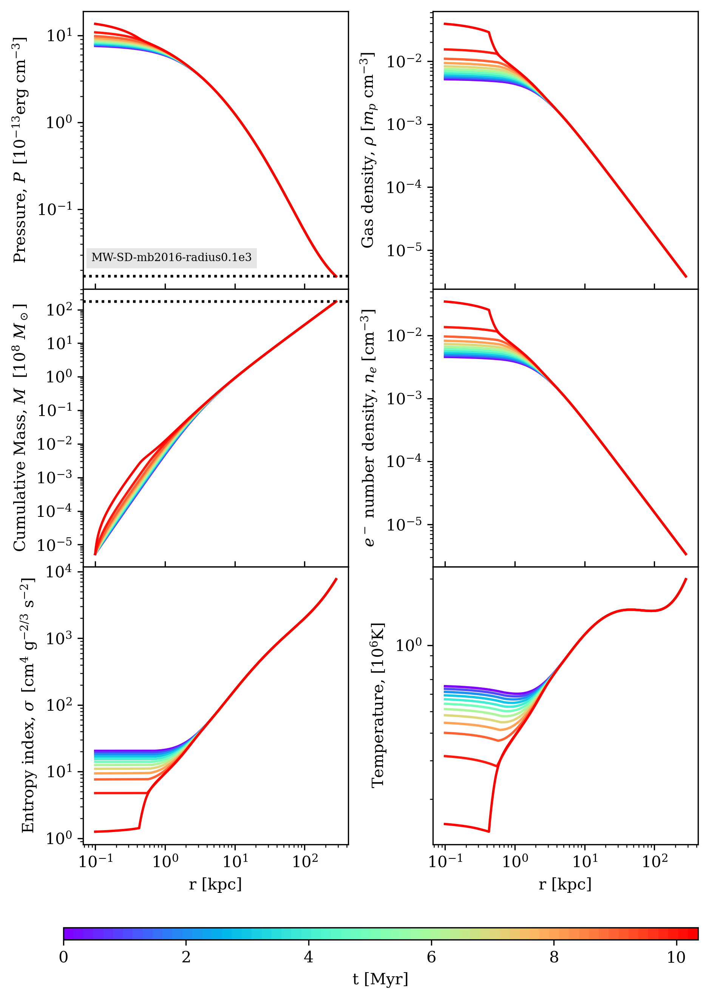

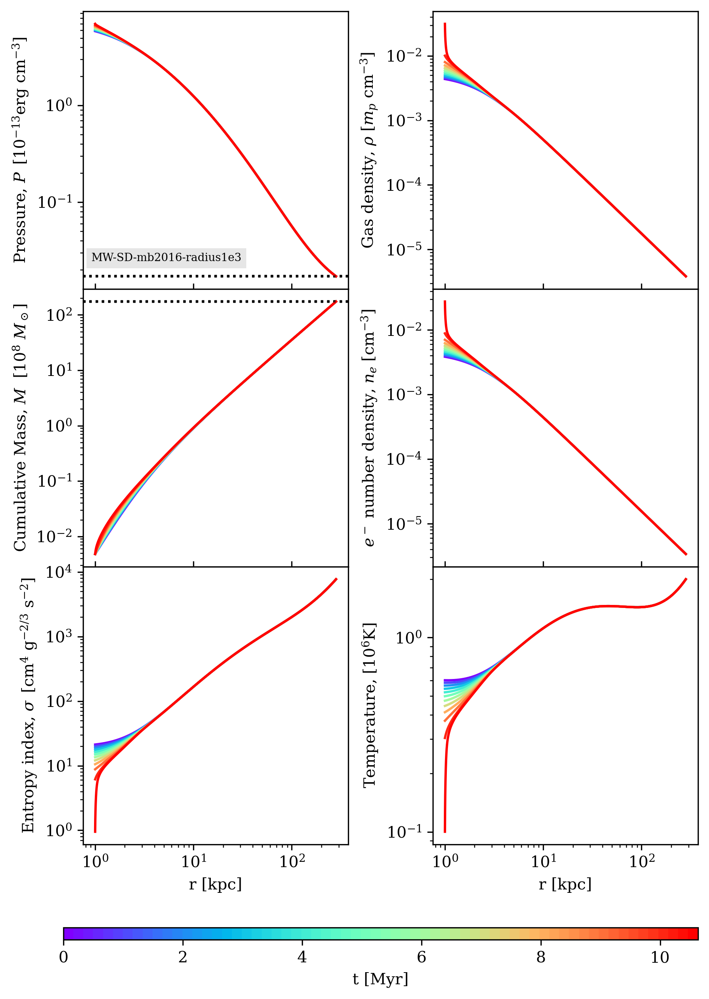

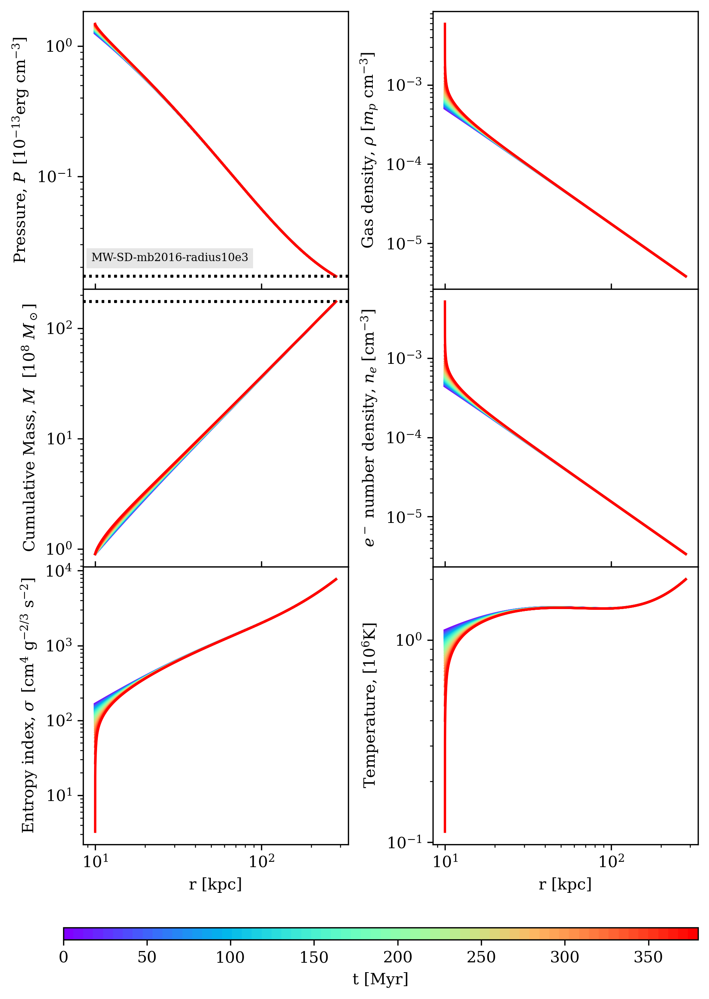

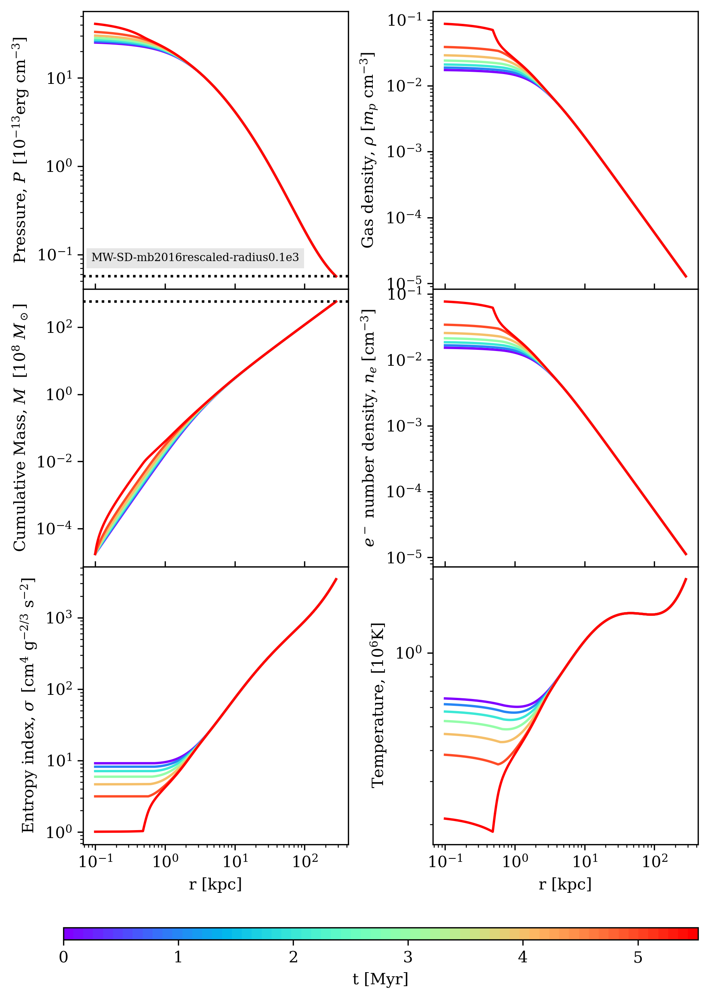

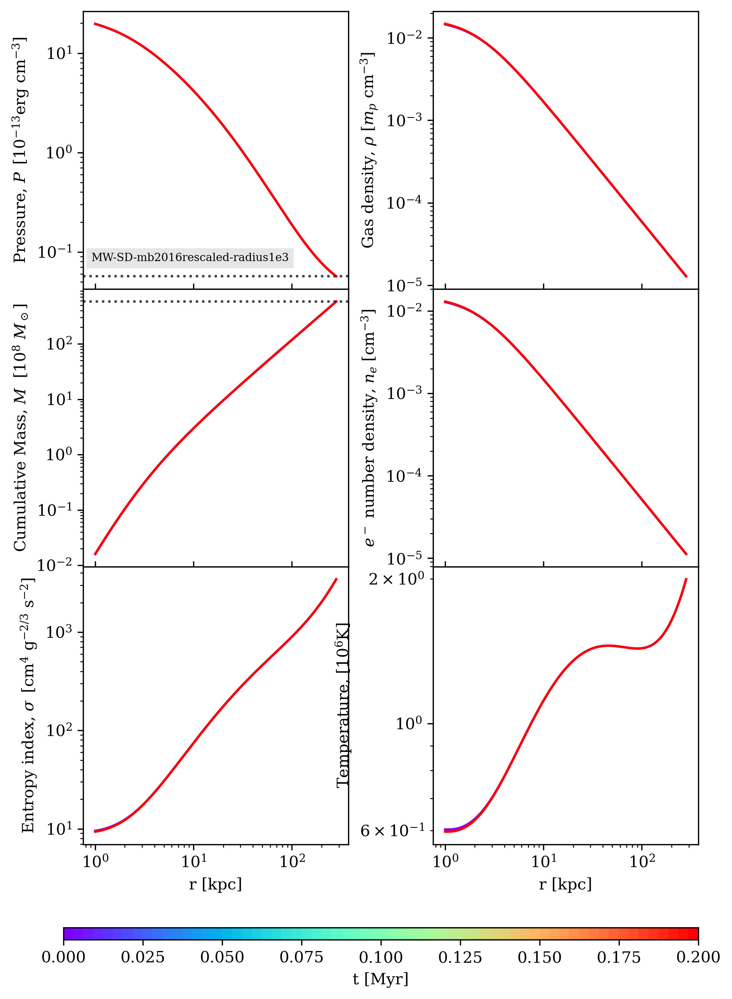

...

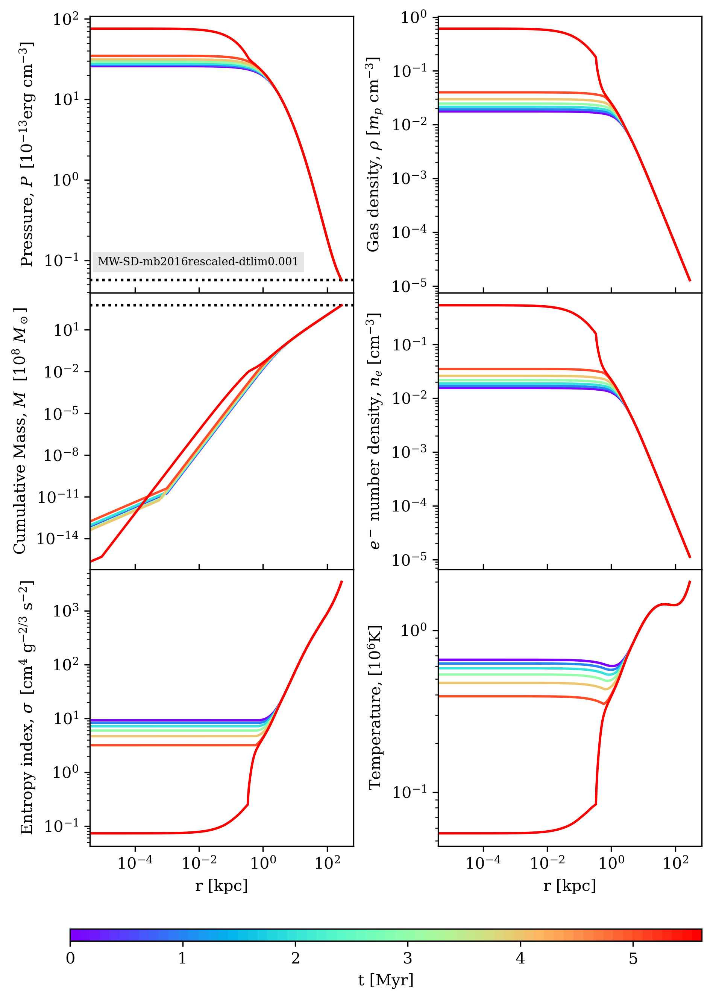

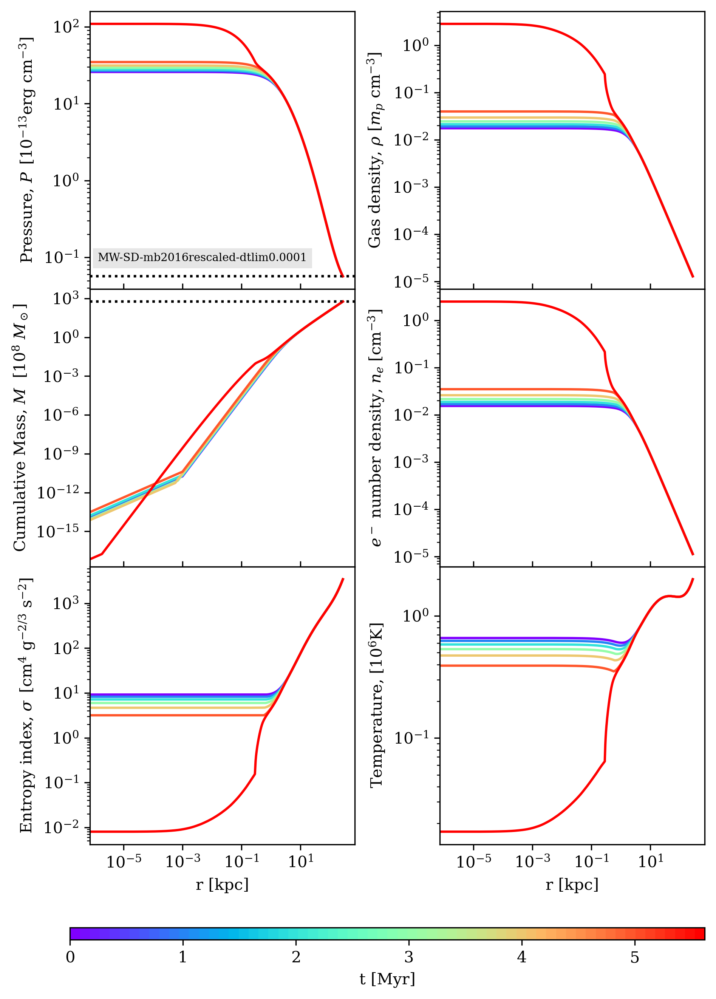

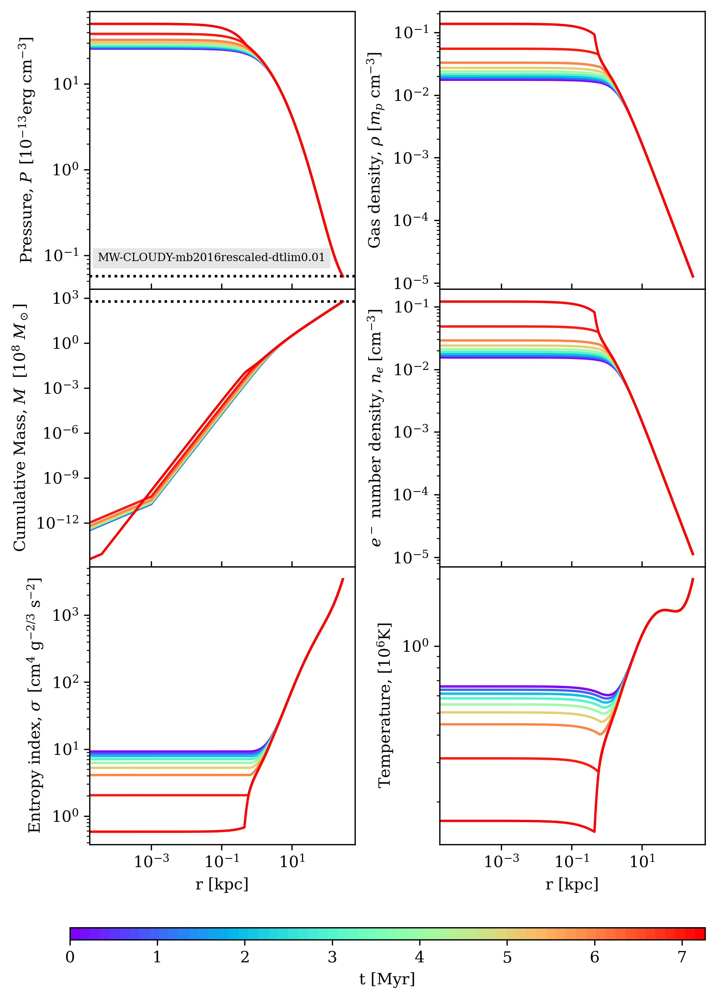

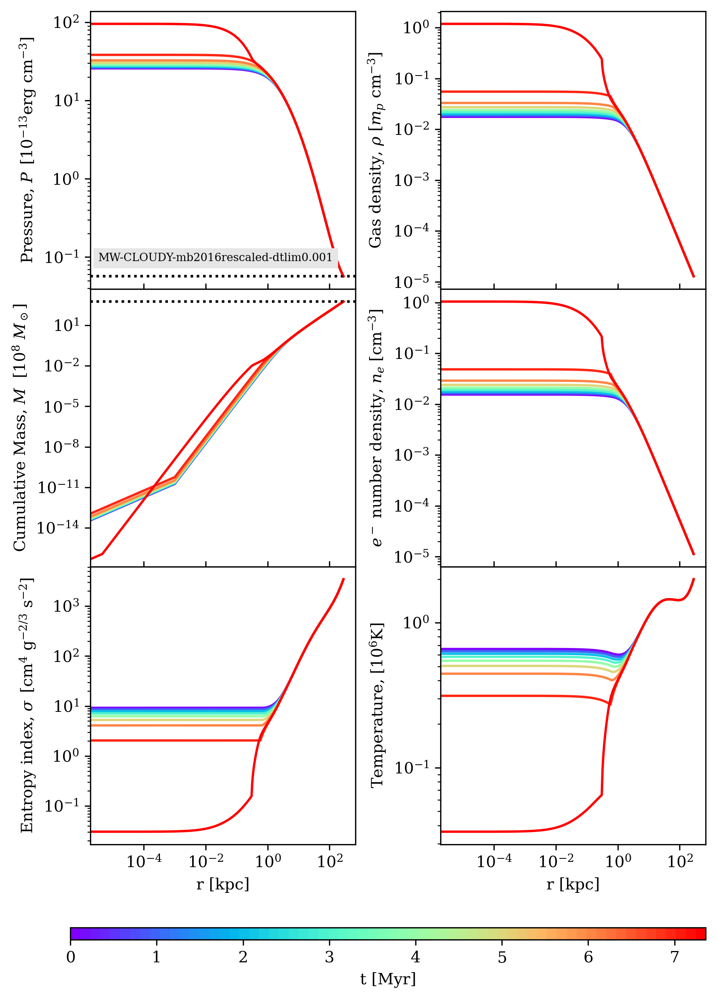

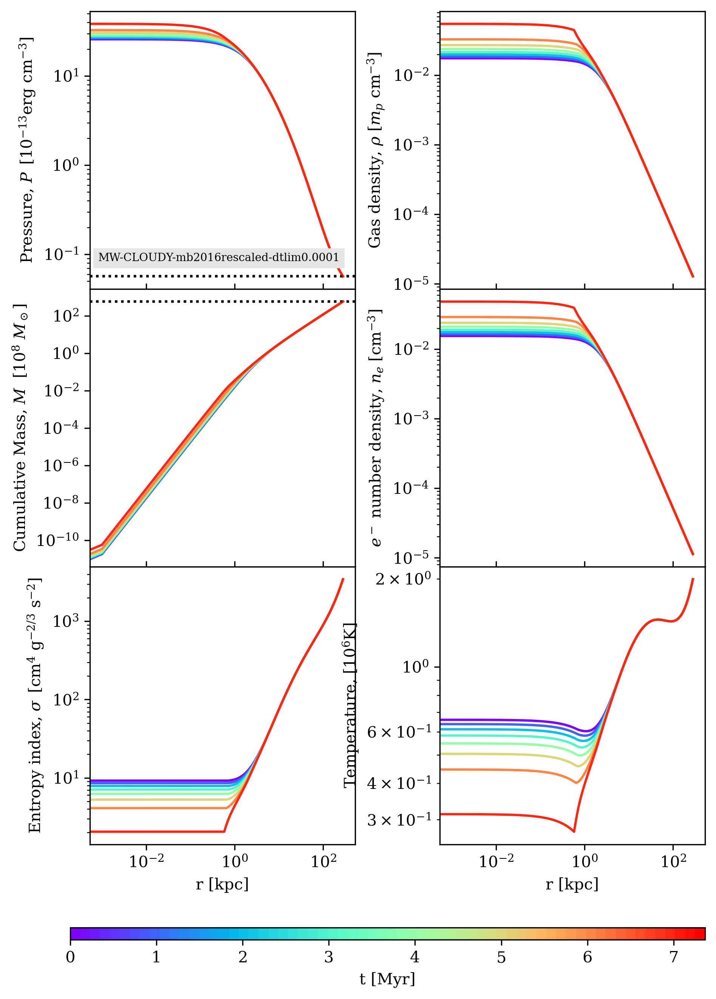

In [456]:
for name, result in res_mw.items():
    if 'radius' not in name and 'dtlim' not in name:
        continue
        
    _, (ts, *_) = result
    
    if ts[-1] > 100:
        dt = 10
    else:
        dt = 1
    times = select_times(ts, dt=dt)
    times = np.append(times, ts[-1])
    
    fig, ax = full_plot_all(result, plot_times=times)
    annotate(name, (0.03, 0.1), ax[0, 0])
#     ax[0,0].set_xlim(1e-2, 10)
#     ax[2, 0].set_ylim(3e1, 6e1)
#     param, rest = result
#     print(rest)
    
    savefig(fig, f"full-plot-radius-dt-{name}")
#     plt.close()
    plt.show()

### Density Plot All

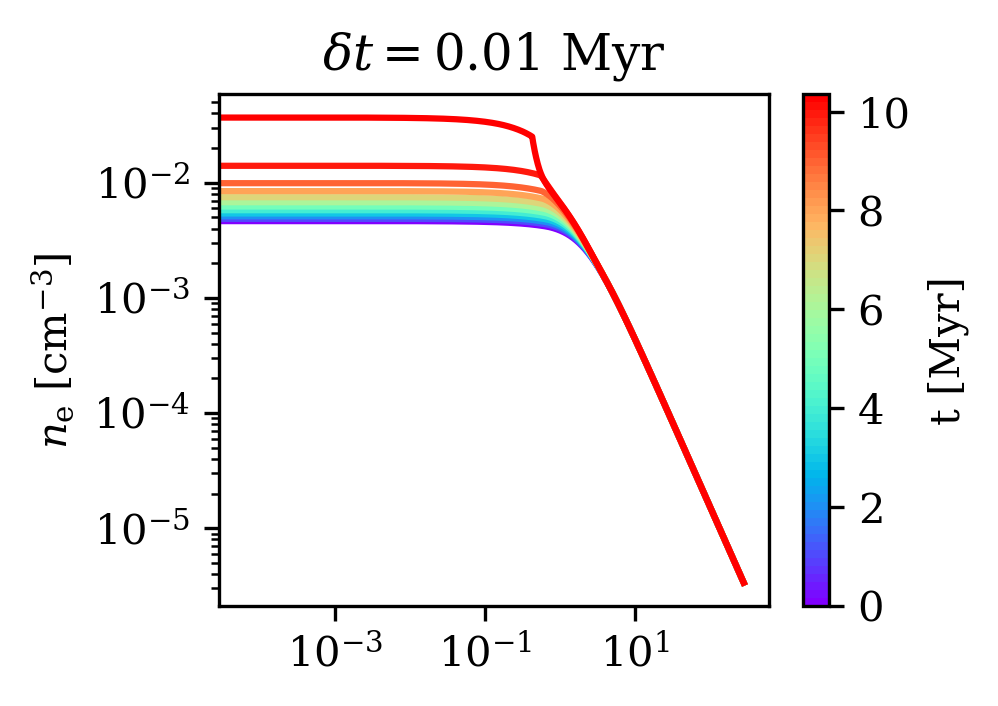

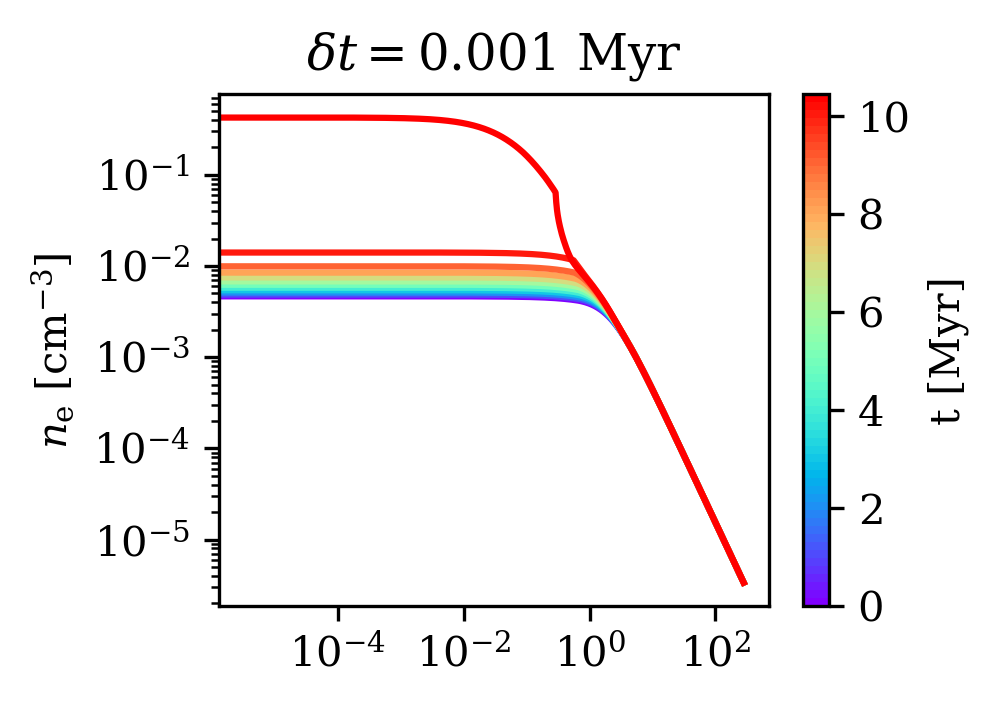

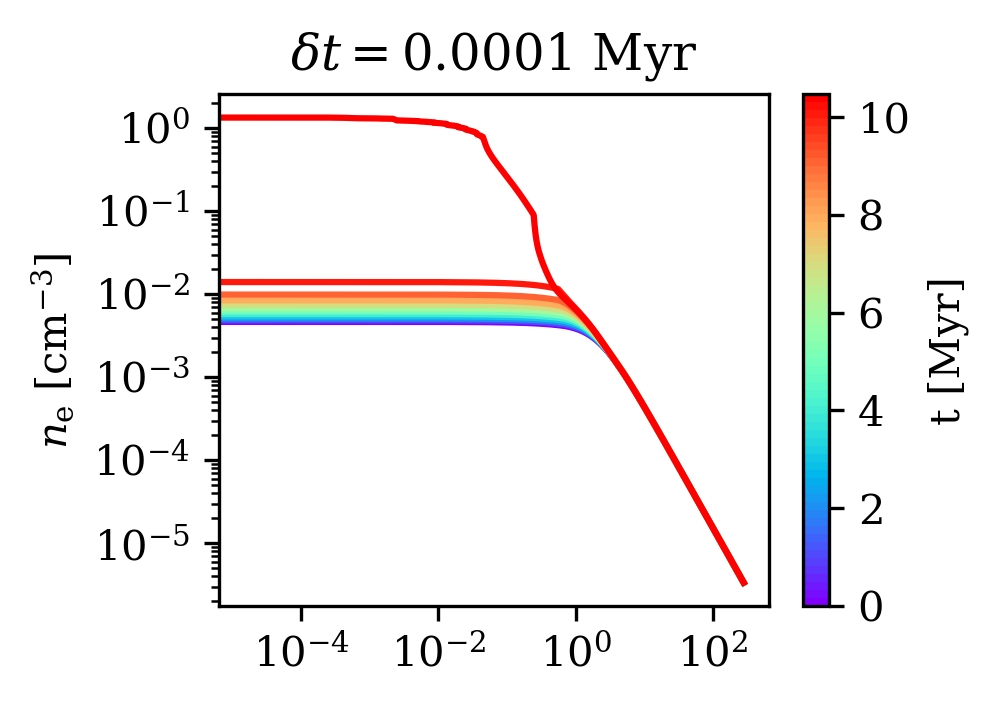

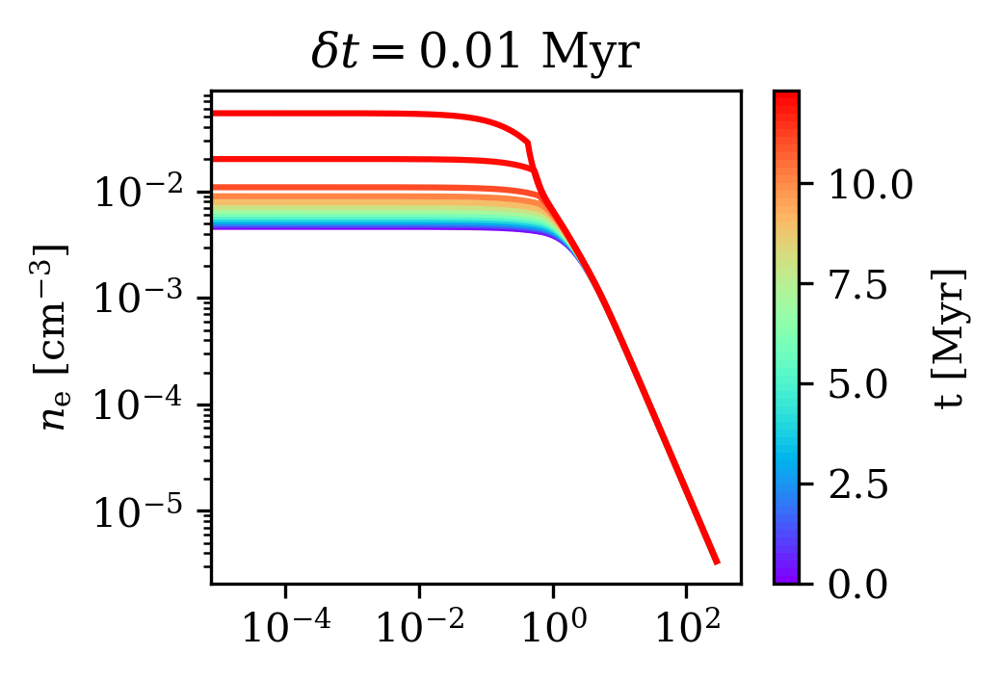

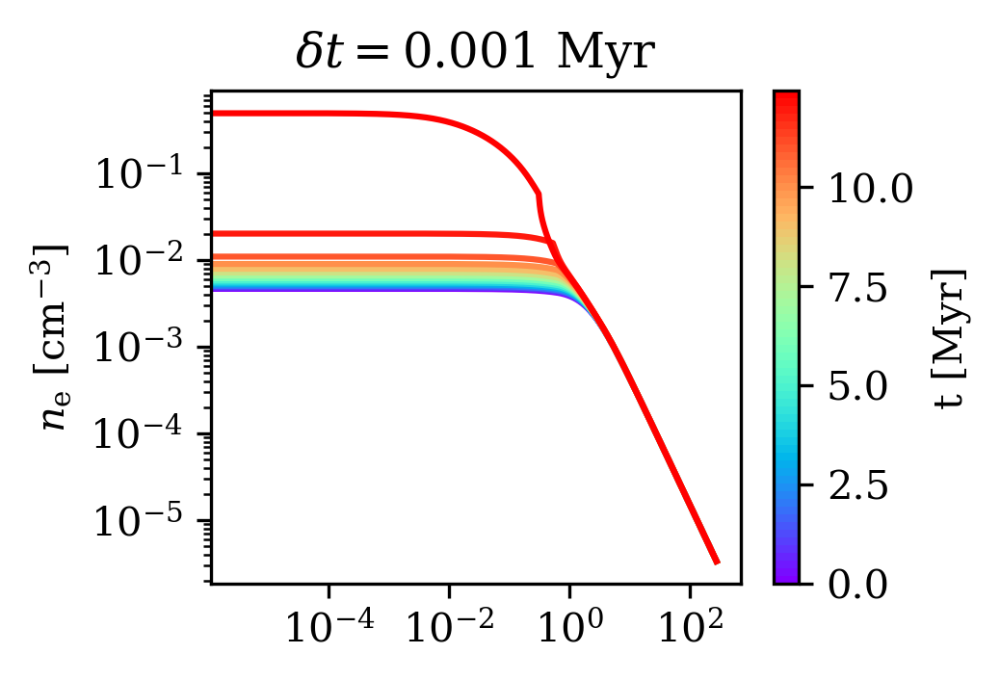

...

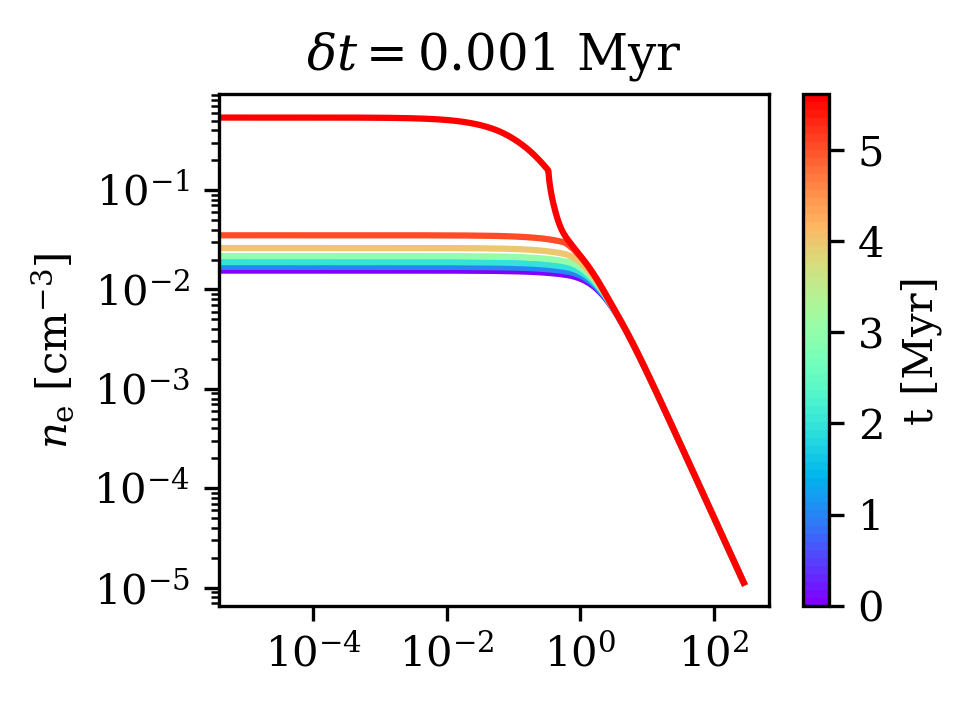

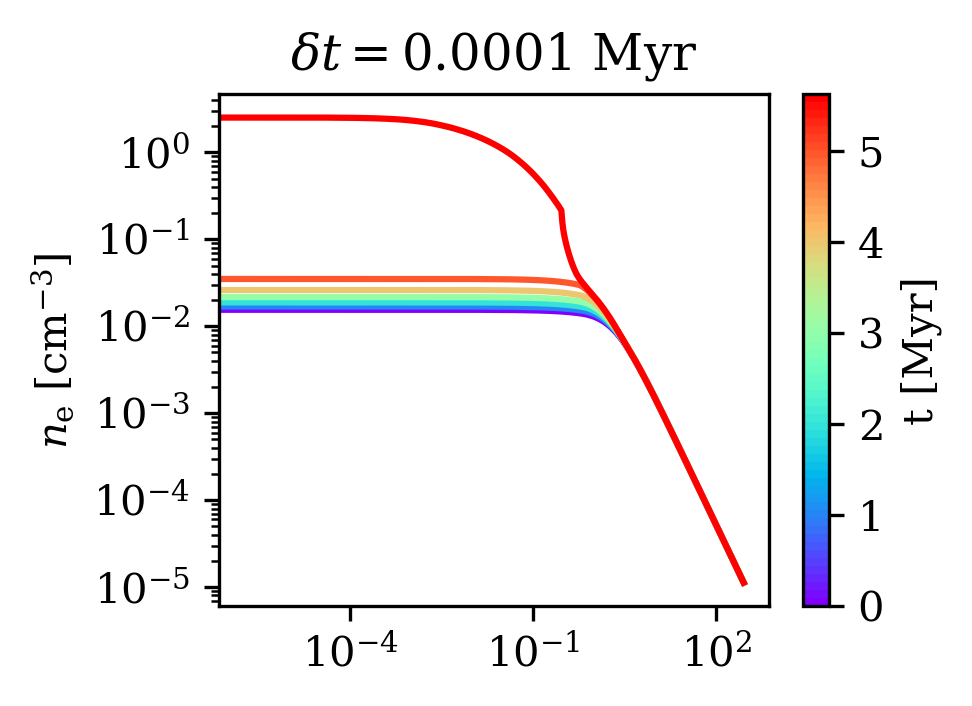

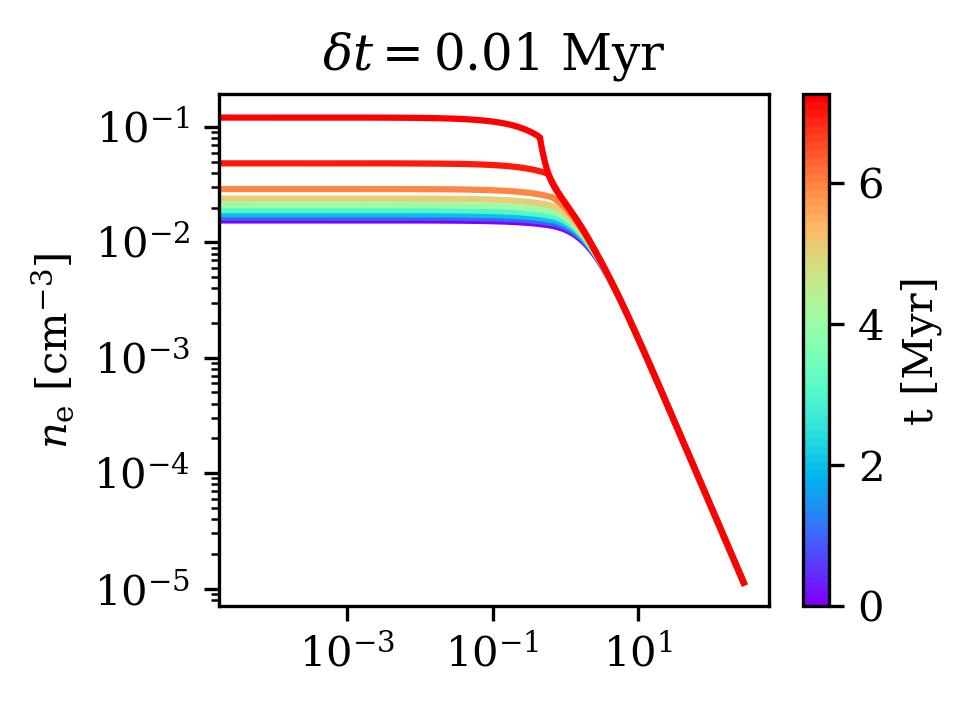

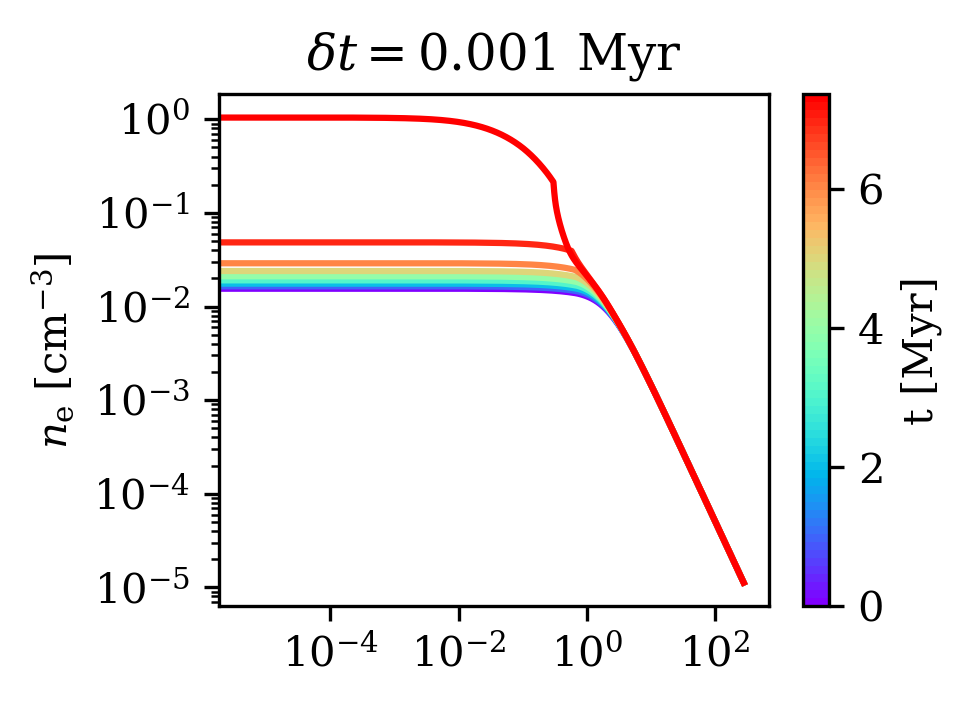

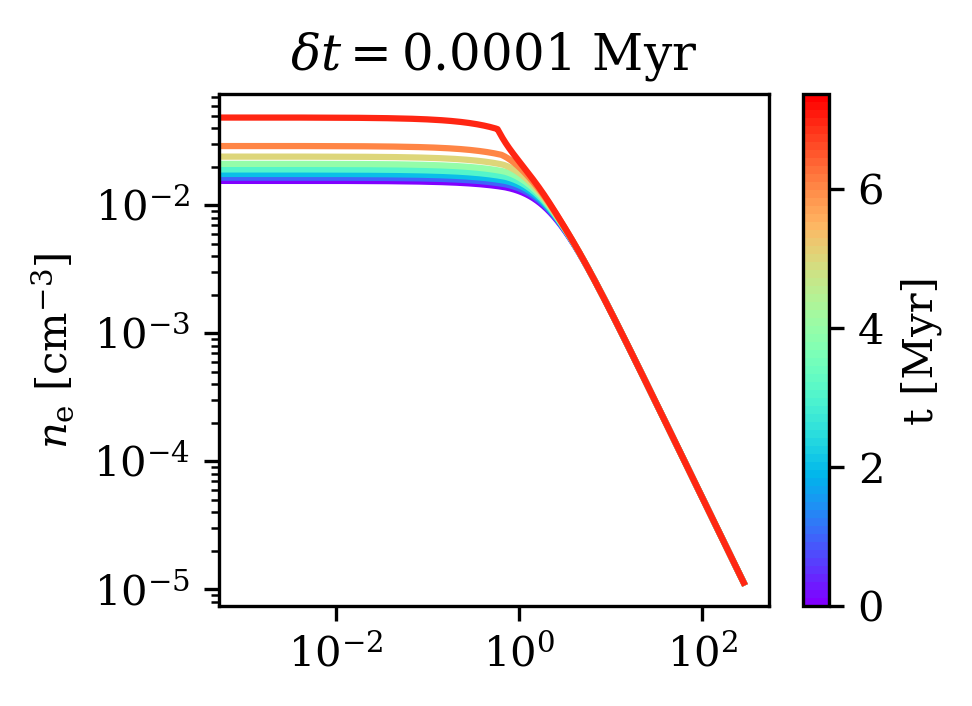

In [713]:
for name, result in res_mw.items():
#     if 'radius' not in name and 'dtlim' not in name:
    if 'dtlim' not in name:
        continue
        
    _, (ts, *_) = result
    if ts[-1] > 100:
        dt = 10
    else:
        dt = 1
        
    times = select_times(ts, dt=dt)
    times = np.append(times, ts[-1])
    fig, ax = density_plot(result, plot_times=times)
    
    if 'dtlim' in name:
        dt = float(name[name.find('lim') + len('lim'):])
        ax.set_title(f"$\delta t = {dt}$ Myr")
        
#     annotate(name, (0.03, 0.1), ax[0, 0])
    
    savefig(fig, f"density-{name}")
#     plt.close()
    plt.show()

### Timestep limit

MW-SD-mb2016rescaled-dtlim0.01 t_evo 5.524190597719082 Myr
MW-SD-mb2016rescaled-dtlim0.001 t_evo 5.61065021980981 Myr
MW-SD-mb2016rescaled-dtlim0.0001 t_evo 5.622042563839041 Myr


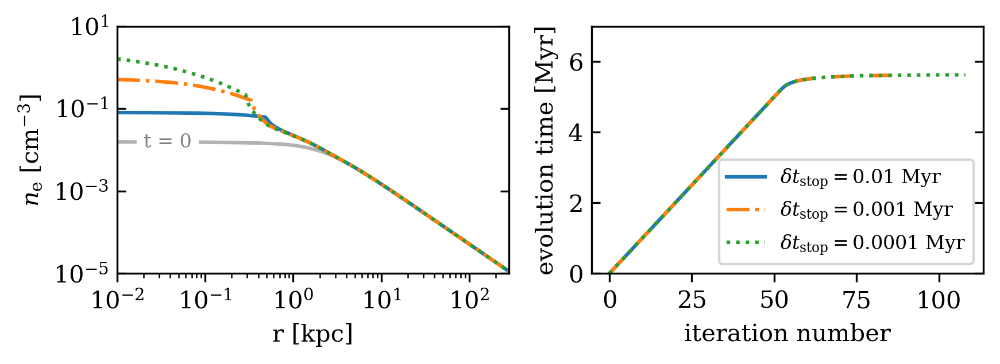

In [712]:
res_dtlim = {name: r for name, r in res_mw.items() if 'dtlim' in name and 'rescaled' in name and 'SD' in name}

fig, ax = plt.subplots(1, 2, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2))

lss = {
    0.01: '-', 
    0.001: '-.', 
    0.0001: ':'
}

for name, result in res_dtlim.items():
    
    
    param, (ts, rs, ps, ms, sigs, _) = result
    
    print(name, 't_evo', ts[-1], 'Myr')
    rho, n_e, T = compute_quantities(rs[-1], ps[-1], ms[-1], sigs[-1])

    r_plot = rs[-1] / 1e3
    dt_limit = float(name[name.find('lim') + len('lim'):])
    
    kwargs = dict(ls=lss[dt_limit], label=r"$\delta t_{\rm stop} = " + f" {dt_limit}$ Myr")
        
    if dt_limit == 0.01:
        _, n_e_first, _ = compute_quantities(rs[0], ps[0], ms[0], sigs[0])
        ax[0].plot(rs[0] / 1e3, n_e_first, alpha=0.3, c='k', ls='-')
        ax[0].text(2e-2, n_e_first[0], "t = 0", c='gray', va='center', size=8, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})
        
    
    ax[0].plot(r_plot, n_e, **kwargs)
    
    dts = ts[1:] - ts[:-1]
    ax[1].plot(ts, **kwargs)
    
#     ax[1].plot(dts, **kwargs)
#     ax[1].set_yscale('log')
    
ax[0].set_ylim(1e-5, 10)
ax[0].set_xlim(1e-2, param.R_out/1e3)
ax[0].set_ylabel(r'$n_{\rm e} \,\,[{\rm cm}^{-3}]$')
ax[0].set_xlabel(r'r [kpc]')

ax[0].set_yscale('log')
ax[0].set_xscale('log')

ax[1].set_ylabel('evolution time [Myr]')
ax[1].set_xlabel('iteration number')

ax[1].set_ylim(0, 7)


for a in ax:
    a.tick_params(axis='y', which='both', direction='in', right=True)

    
ax[1].legend(fontsize=8, loc='lower right')

fig.tight_layout()

savefig(fig, f"dtlimit-{name}")
fig.show()

### Basic
Shows density, temperature and entropy profiles

In [459]:
from matplotlib.transforms import TransformedBbox, Bbox, Transform

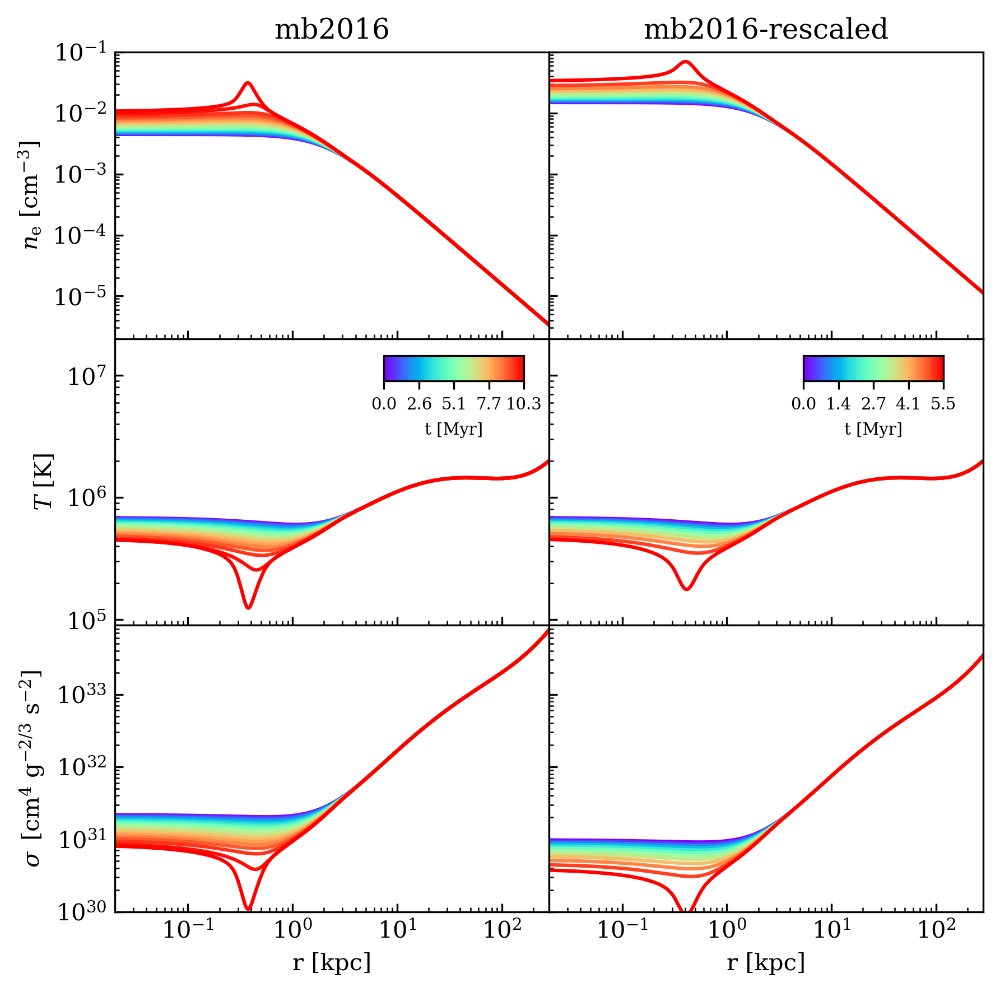

In [686]:

figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.90, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name = 'MW-SD-mb2016'
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[1, 0].transAxes).transformed(fig.transFigure.inverted()).bounds
#     colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 4),
)

axs[0, 0].set_title('mb2016')

###########

name = 'MW-SD-mb2016rescaled'
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[1, 1].transAxes).transformed(fig.transFigure.inverted()).bounds
)
axs[0, 1].set_title('mb2016-rescaled')

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1e-1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(1e30, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

savefig(fig, "full-basic-plot-SD-noconv")

plt.show()

#### Convection

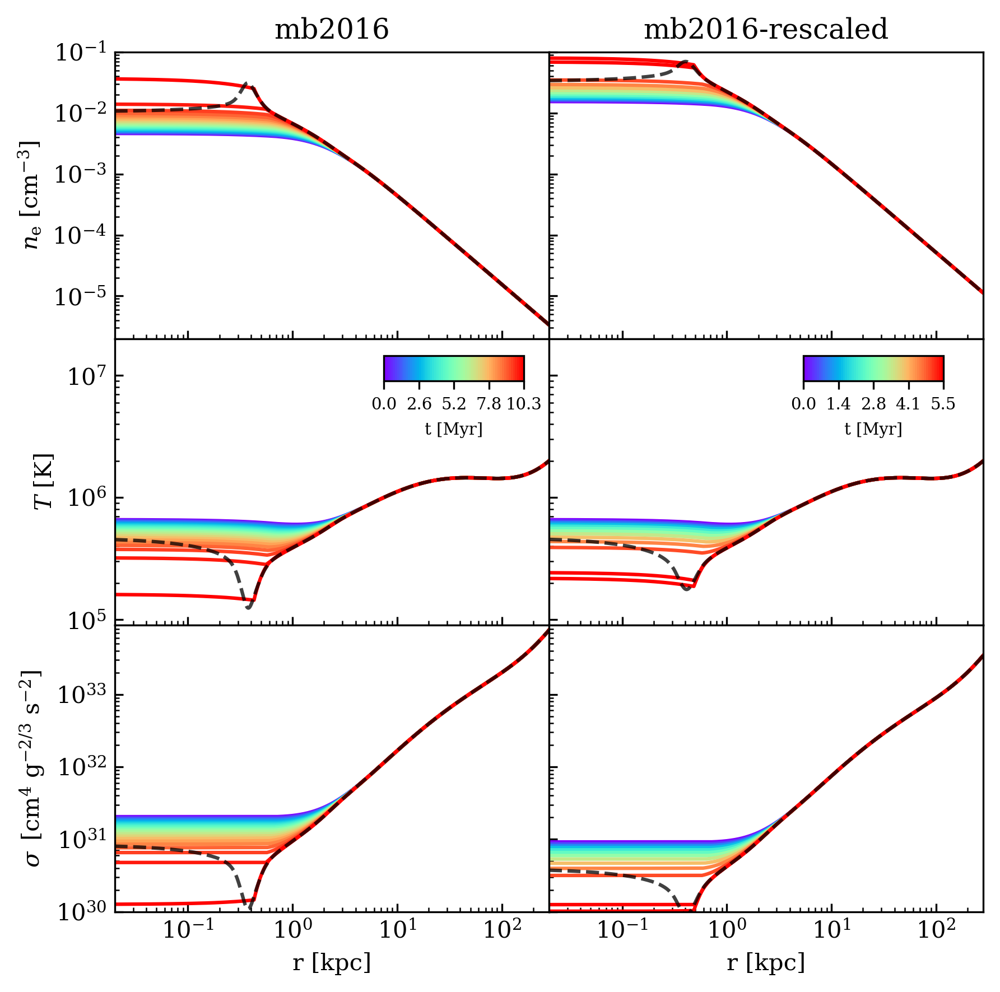

In [687]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.90, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name = 'MW-SD-mb2016-conv'
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[1, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
#     colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title('mb2016')

# Add previous corona
param, (ts, rs, ps, ms, ss, tcs) = res_mw["MW-SD-mb2016"]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = 'MW-SD-mb2016rescaled-conv'
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[1, 1].transAxes).transformed(fig.transFigure.inverted()).bounds
)
axs[0, 1].set_title('mb2016-rescaled')

# Add previous corona
param, (ts, rs, ps, ms, ss, tcs) = res_mw["MW-SD-mb2016rescaled"]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1e-1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(1e30, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

savefig(fig, "full-basic-plot-SD-conv")

plt.show()

CLOUDY (only cool)

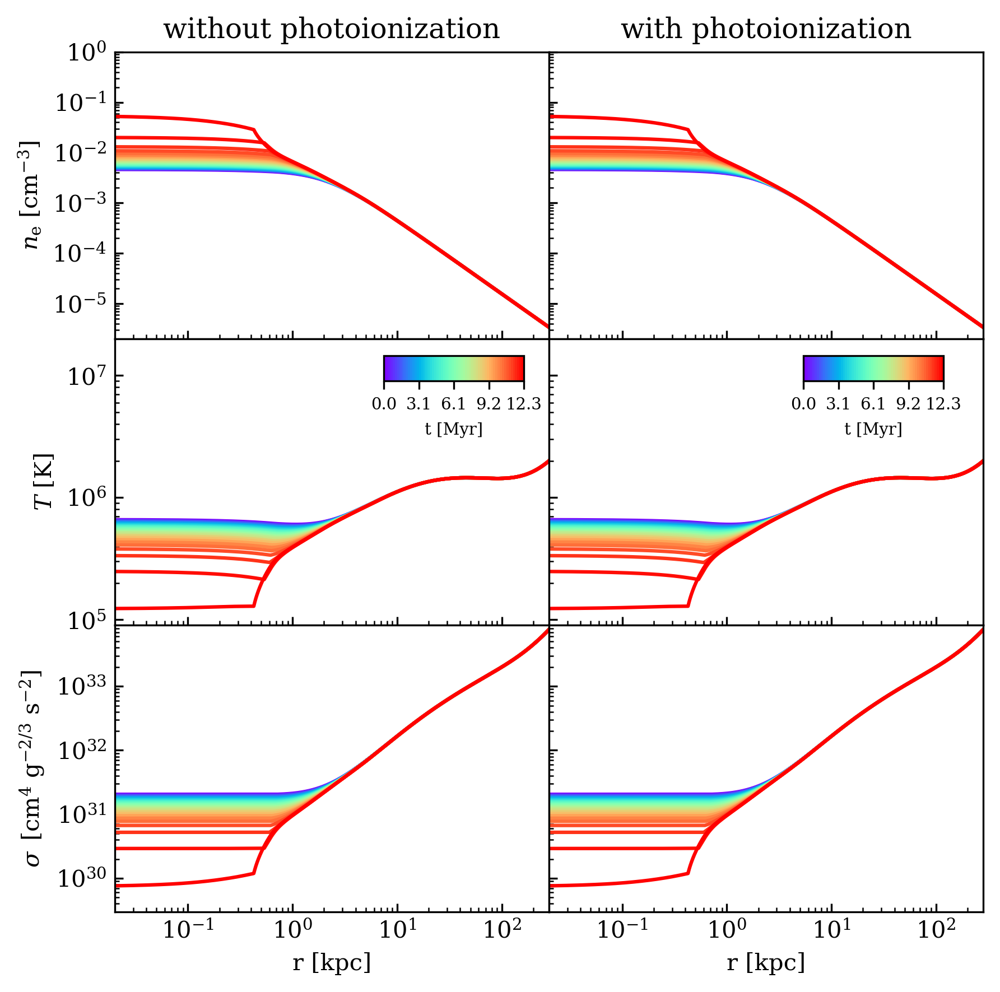

In [688]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.90, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-CLOUDY-mb2016{}-cool-conv"
name = name_fmt.format("")
result = res_mw[name]
_, (ts, *_) = result
result_cool = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[1, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
#     colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title('without photoionization')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
# cmp_name = cmp_name_fmt.format("")
# param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
# basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-CLOUDY-mb2016-conv"
# name = name_fmt.format("rescaled")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[1, 1].transAxes).transformed(fig.transFigure.inverted()).bounds
)
axs[0, 1].set_title('with photoionization')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
# cmp_name = cmp_name_fmt.format("rescaled")
# param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
# basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

savefig(fig, "full-basic-plot-CLOUDY-cool-conv")

plt.show()

[0.00000000e+00 1.00000000e+00 4.66159253e+00 ... 2.81914175e+05
 2.81963495e+05 2.81986598e+05] [0.00000000e+00 1.00000000e+00 4.66613929e+00 ... 2.81895126e+05
 2.81965433e+05 2.81986639e+05]
Times:  7.999999999999988 7.999999999999988


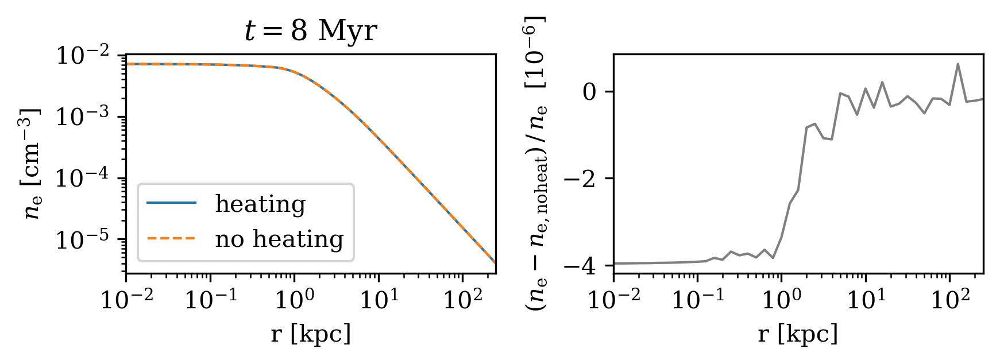

In [689]:
_, (t_cool, r_cool, p_cool, m_cool, s_cool, tc_cool) = result_cool
_, (t, r, p, m, s, tc) = result


index = 80

_, n_e_cool, _ = compute_quantities(r_cool[index], p_cool[index], m_cool[index], s_cool[index])
_, n_e, _ = compute_quantities(r[index], p[index], m[index], s[index])

dtlim = 0.1
r_eval = np.arange(dtlim, 280, dtlim) * 1e3
r_eval = (10**np.arange(-2, np.log10(280), 0.1)) * 1e3
# r_eval_2 = (10**np.arange(-2, np.log10(280), 0.1)) * 1e3

ifunc_cool = interp1d(r_cool[index], n_e_cool)
ifunc = interp1d(r[index], n_e)

print(r_cool[index], r[index])

print('Times: ', t_cool[index], t[index])

q_cool_e = ifunc_cool(r_eval)
q_e = ifunc(r_eval)


fig, ax = plt.subplots(1, 2, sharex=True, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2))
opts = dict(lw=1)
# ax[0].plot(r[index][:300], **opts)
# ax[0].plot(r_cool[index][:300], **opts)

ax[0].plot(r_eval / 1e3, q_e, **opts, ls='-', label='heating')
ax[0].plot(r_eval / 1e3, q_cool_e, **opts, ls='--', label='no heating')

ax[0].set_yscale('log')
ax[0].set_xscale('log')

# ax[1].plot(r_eval / 1e3, (q_e - q_cool_e) / q_e , **opts)
ax[1].plot(r_eval / 1e3, (q_e - q_cool_e) / q_e *1e6 , **opts, c='gray')

# q_cool_e = ifunc_cool(r_eval_2)
# q_e = ifunc(r_eval_2)
# ax[1].plot(r_eval_2 / 1e3, (q_e - q_cool_e) / q_e , **opts)

ax[0].set_xlim(0.01, r_eval[-1]/1e3)
ax[0].set_ylabel(r'$n_{\rm e}$ [cm$^{-3}$]')
ax[1].set_ylabel(r'$(n_{\rm e} - n_{\rm e, noheat})\, /\, n_{\rm e}$  [$10^{-6}$]')
ax[0].set_title(r'$t = 8$ Myr')
ax[0].set_xlabel('r [kpc]')
ax[1].set_xlabel('r [kpc]')

ax[0].legend()

fig.tight_layout()
# ax[1].set_yscale('log')
# ax.plot(r_eval, p_e / p_cool_e)

savefig(fig, "pi-vs-nopi-comparison")

fig.show()

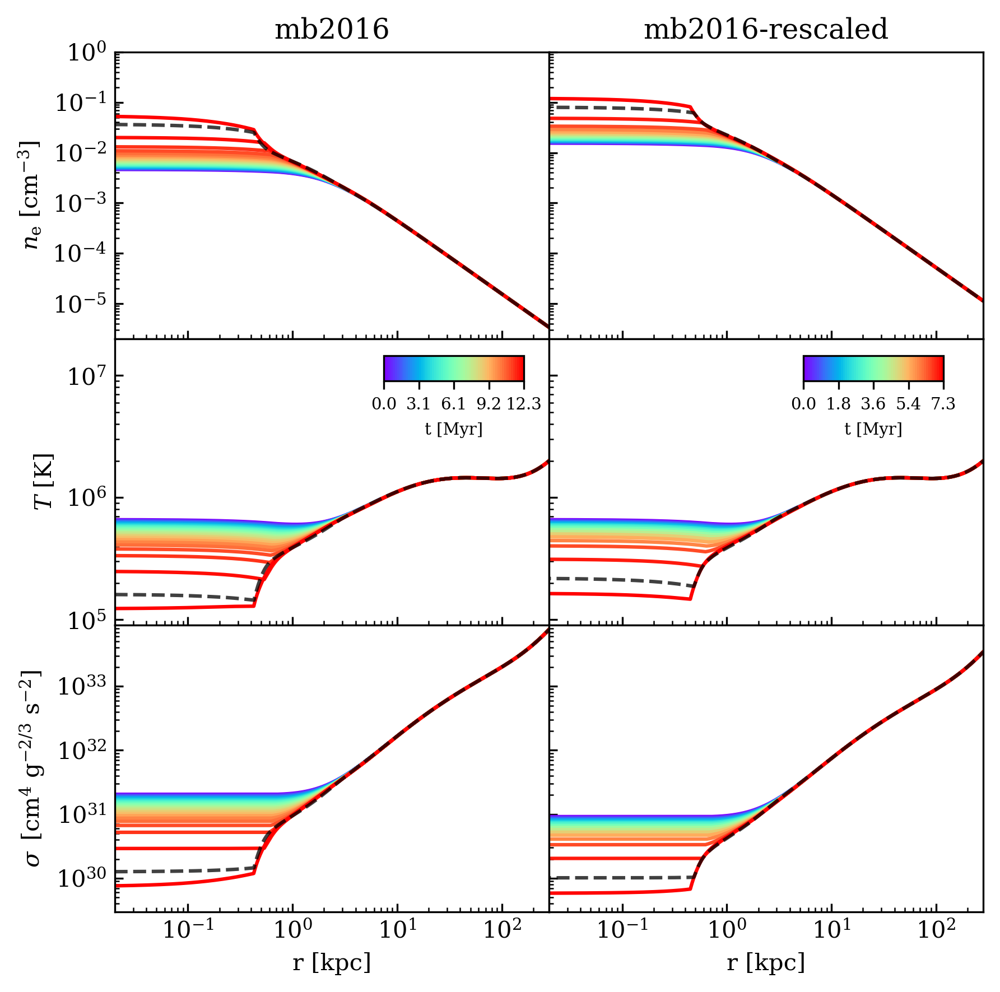

In [690]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.90, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-CLOUDY-mb2016{}-conv"
name = name_fmt.format("")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[1, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
#     colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title('mb2016')

# Add previous corona
cmp_name_fmt = "MW-SD-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = name_fmt.format("rescaled")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=0.5)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[1, 1].transAxes).transformed(fig.transFigure.inverted()).bounds
)
axs[0, 1].set_title('mb2016-rescaled')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("rescaled")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

savefig(fig, "full-basic-plot-CLOUDY-conv")

plt.show()

### Initial Condition

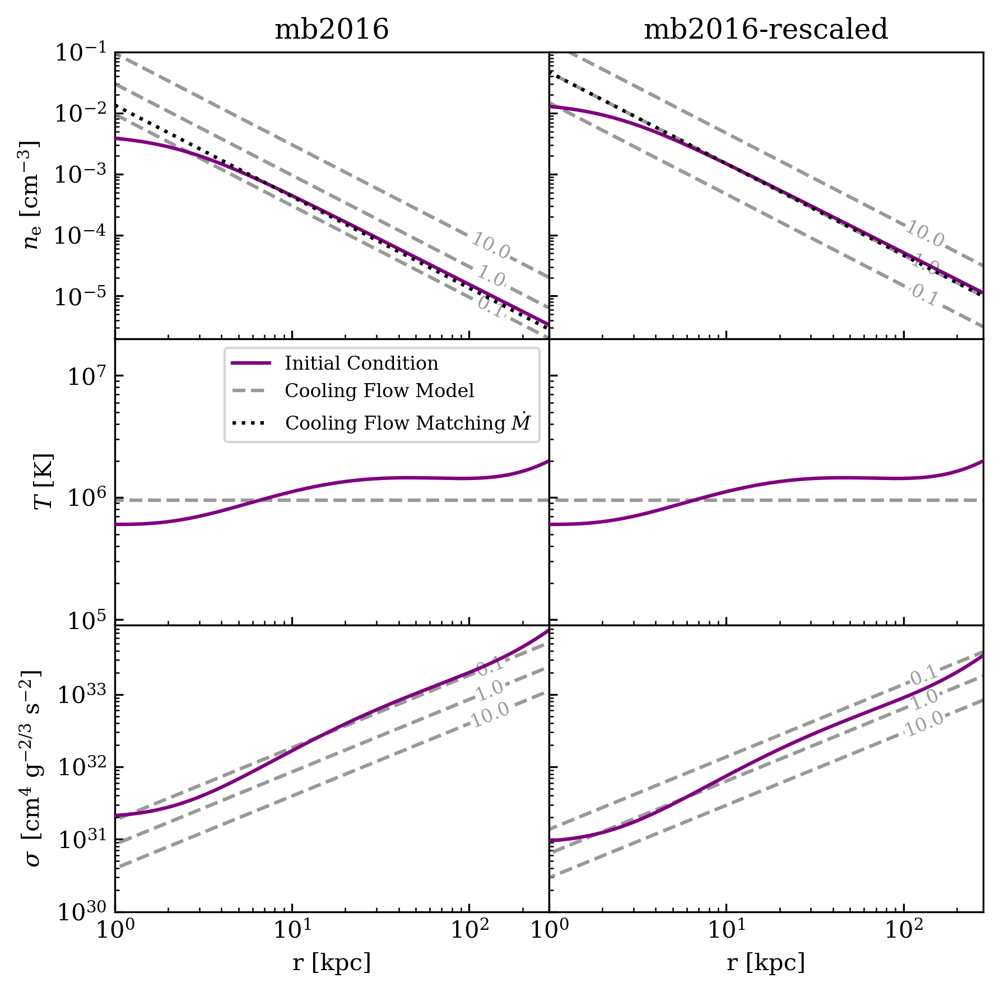

In [691]:

figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full



beta_param, Z = ic_mb2016()

P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
sig = param.sig
figax = basic_plot(r, P, M, sig, param=param, figax=(fig, axs[:, 0]), options={'c': 'purple', 'label': "Initial Condition", 'zorder': 10})

beta_param, Z = ic_mb2016_rescaled()
P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
sig = param.sig
figax = basic_plot(r, P, M, sig, param=param, figax=(fig, axs[:, 1]), options={'c': 'purple', 'label': "Initial Condition", 'zorder': 10})


############ Stern
alpha = 0.8
c = 'gray'
for cool_22, ax in zip([0.60, .25], axs.T):
    r0 = np.arange(1, param.R_out, 1000)
    
    for dotM_1 in [0.1, 1, 10]:
        rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
        n_e = 0.88*rho

        mu = 0.62
        rh = rho*cst.proton_mass
        sig = cst.k_B * T / (mu*cst.proton_mass*rh**(cst.gamma - 1))

        line, = ax[0].plot(r0 / 1e3, n_e, alpha=alpha, c=c, ls='--')
        x = line.get_xdata()[-150]
        y = line.get_ydata()[-150]
        ax[0].text(x, y, f"{dotM_1:.1f}", alpha=alpha, c=c, ha='center', va='center', size=8, rotation=-26, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})

        line, = ax[2].plot(r0 / 1e3, sig, alpha=alpha, c=c, ls='--')
        x = line.get_xdata()[-150]
        y = line.get_ydata()[-150]
        ax[2].text(x, y, f"{dotM_1:.1f}", alpha=alpha, c=c, ha='center', va='center', size=8, rotation=22, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})

    ax[1].plot(r0 / 1e3, T, alpha=alpha, c=c, ls='--')

rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=0.2, cool_22=0.6)
n_e = 0.88*rho
line, = axs[0, 0].plot(r0 / 1e3, n_e, c='k', ls=':', zorder=11)

rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=1.0, cool_22=0.25)
n_e = 0.88*rho
line, = axs[0, 1].plot(r0 / 1e3, n_e, c='k', ls=':', zorder=11)
#########

axs[0, 0].set_title('mb2016')
axs[0, 1].set_title('mb2016-rescaled')

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1e-1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(1e30, 9e33)  # Entropy index
axs[0, 0].set_xlim(1, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

handles = [
    Line2D([0], [0], c='purple', label='Initial Condition'),
    Line2D([0], [0], ls="--", c=c, alpha=alpha, label='Cooling Flow Model'),
    Line2D([0], [0], ls=":", c='k', label='Cooling Flow Matching $\dot M$'),
]
axs[1, 0].legend(handles=handles, fontsize=8)

savefig(fig, "ic-full-compare-stern")

fig.show()

### Initial Condition: Temperature

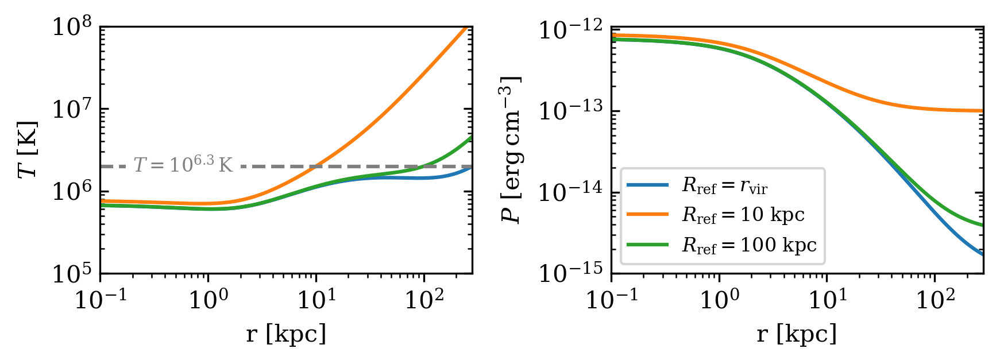

In [692]:
def plot_temp_pressure(r, P, M, sig, param=param, figax=None, **kwargs):
    if figax is None:
        figax = plt.subplots(1, 2, sharex=True)
    fig, ax = figax
        
    rho, n_e, T = compute_quantities(r, P, M, sig)

    r_plot = r / 1e3

#     ax[0].plot(r_plot, n_e * cst.NDENS_UNIT, **options_def, **kwargs)
#     ax[0].set_yscale('log')
# #     ax[0].set_ylabel(r'$e^-$ number density $n_e \,\,[{\rm cm}^{-3}]$')
#     ax[0].set_ylabel(r'$n_e \,\,[{\rm cm}^{-3}]$')

    ax[0].plot(r_plot, T * cst.TEMP_UNIT, **kwargs)
    ax[0].set_yscale('log')
    ax[0].set_ylabel(r'$T\,\, [{\rm K}]$')
        
    
#     ax[0].plot(r, T / cst.TEMP_UNIT)
    ax[1].plot(r_plot, P * cst.PRES_UNIT, **kwargs)
    ax[1].set_yscale('log')
    ax[1].set_ylabel(r'$P\,\, [{\rm erg}\,{\rm cm}^{-3}]$')
    
    ax[0].set_xscale('log')
    for a in ax:
        a.set_xlabel('r [kpc]')

    return figax

figax = plt.subplots(1,
                          2,
                          sharex=True,
#                           sharey='row',
                          figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2))
fig, axs = figax
Rrefs = [None, 10e3*cst.pc_to_cm, 100e3*cst.pc_to_cm]
labels = [r"r_{\rm vir}$", '10$ kpc', '100$ kpc']
for R_ref, label in zip(Rrefs, labels):
    beta_param, Z = ic_mb2016()
    P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param, R_ref=R_ref)
    sig = param.sig
    plot_temp_pressure(r, P, M, sig, param=param, figax=figax, label=r'$R_{{\rm ref}} = ' + label)

axs[0].axhline(10**6.3, ls='--', c='grey')

# figax = basic_plot(r, P, M, sig, param=param, figax=(fig, axs[:, 0]), options={'c': 'purple', 'label': "Initial Condition", 'zorder': 10})

# beta_param, Z = ic_mb2016_rescaled()
# P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
# sig = param.sig
# plot_temp_pressure(r, P, M, sig, param=param, figax=figax, ls='--', label=r'mb2016-rescaled ($R_{\rm ref}$)')
# figax = basic_plot(r, P, M, sig, param=param, figax=(fig, axs[:, 1]), options={'c': 'purple', 'label': "Initial Condition", 'zorder': 10})

axs[0].set_ylim(1e5, 1e8)
axs[1].set_ylim(1e-15, 1.1e-12)
axs[0].set_xlim(0.1, param.R_out/1e3)

for a in axs:
    a.tick_params(axis='y', which='both', direction='in', right=True)
    
axs[0].text(2e-1, 10**6.3, "$T = 10^{6.3}\,$K", c='gray', va='center', size=8, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})


axs[1].legend(fontsize=8)
fig.tight_layout()

savefig(fig, "initial-temperature-mb2016")
fig.show()

### Energy Injection

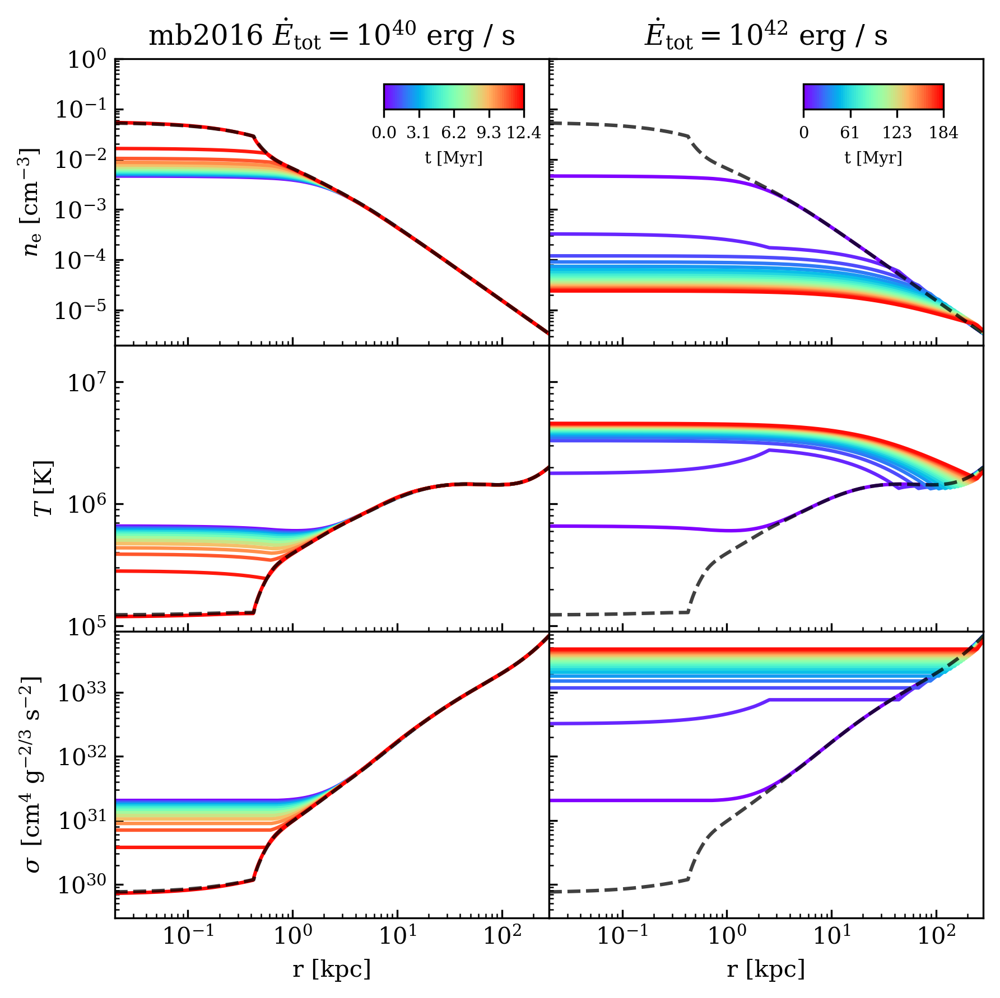

In [693]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.80, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-mb2016{}-E1e40-S8e3"
name = name_fmt.format("")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=1)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[0, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
#     colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title(r'mb2016 $\dot E_{\rm tot} = 10^{40}$ erg / s')

# Add previous corona
cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-mb2016-E1e42-S8e3"
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=10)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[0, 1].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticks=np.linspace(ts[0], ts[-1], 4),
    colorbar_ticksformat="{tick:.0f}"
)
axs[0, 1].set_title(r'$\dot E_{\rm tot} = 10^{42}$ erg / s')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

savefig(fig, "full-basic-plot-energy-mbnormal")

plt.show()

#### mb2016 threshold $\sigma = 8$

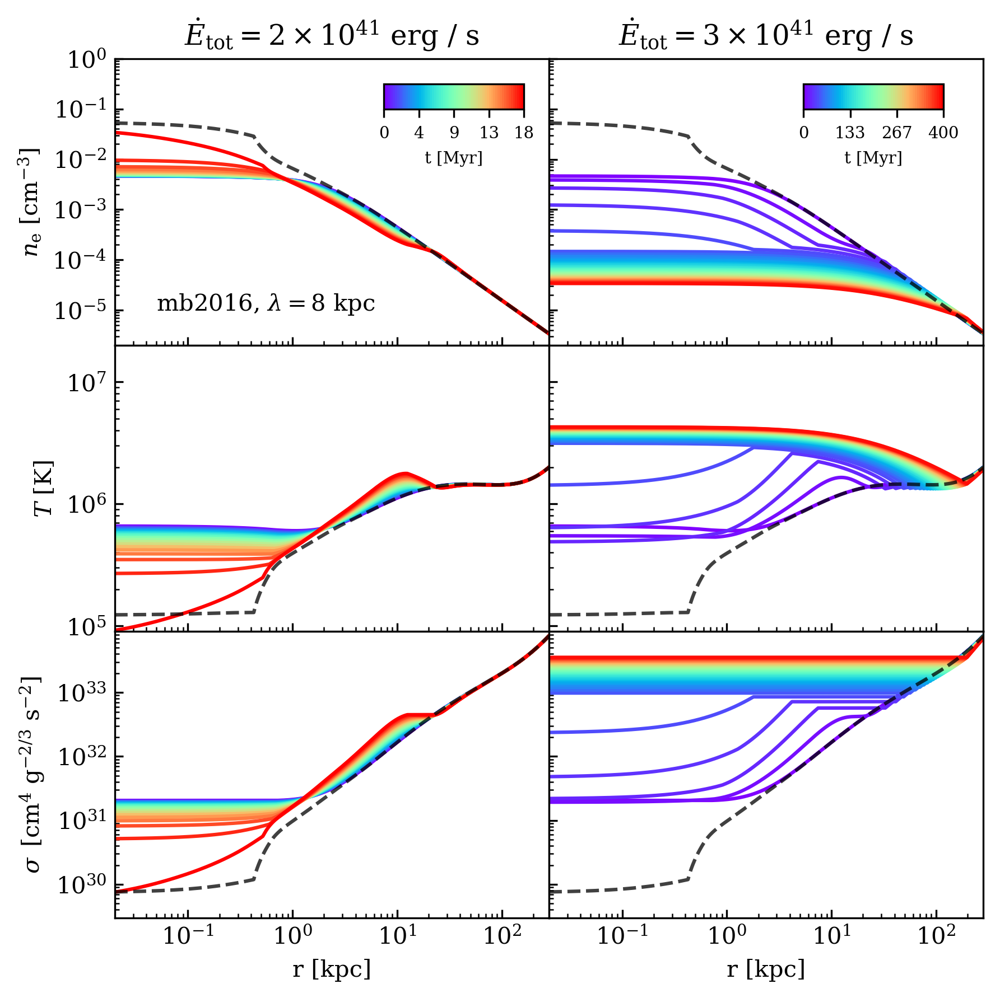

In [694]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.80, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-mb2016{}-E2e41-S8e3"
name = name_fmt.format("")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=1)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[0, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title(r'$\dot E_{\rm tot} = 2\times 10^{41}$ erg / s')

# Add previous corona
cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-mb2016-E3e41-S8e3"
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=10)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[0, 1].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticks=np.linspace(ts[0], ts[-1], 4),
    colorbar_ticksformat="{tick:.0f}"
)
axs[0, 1].set_title(r'$\dot E_{\rm tot} = 3\times 10^{41}$ erg / s')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)

axs[0,0].text(0.05, 1e-5, "mb2016, $\lambda = 8$ kpc")

savefig(fig, "full-basic-plot-energy-mbnormal-threshold")

plt.show()

#### mb2016 threshold $\sigma = 5$

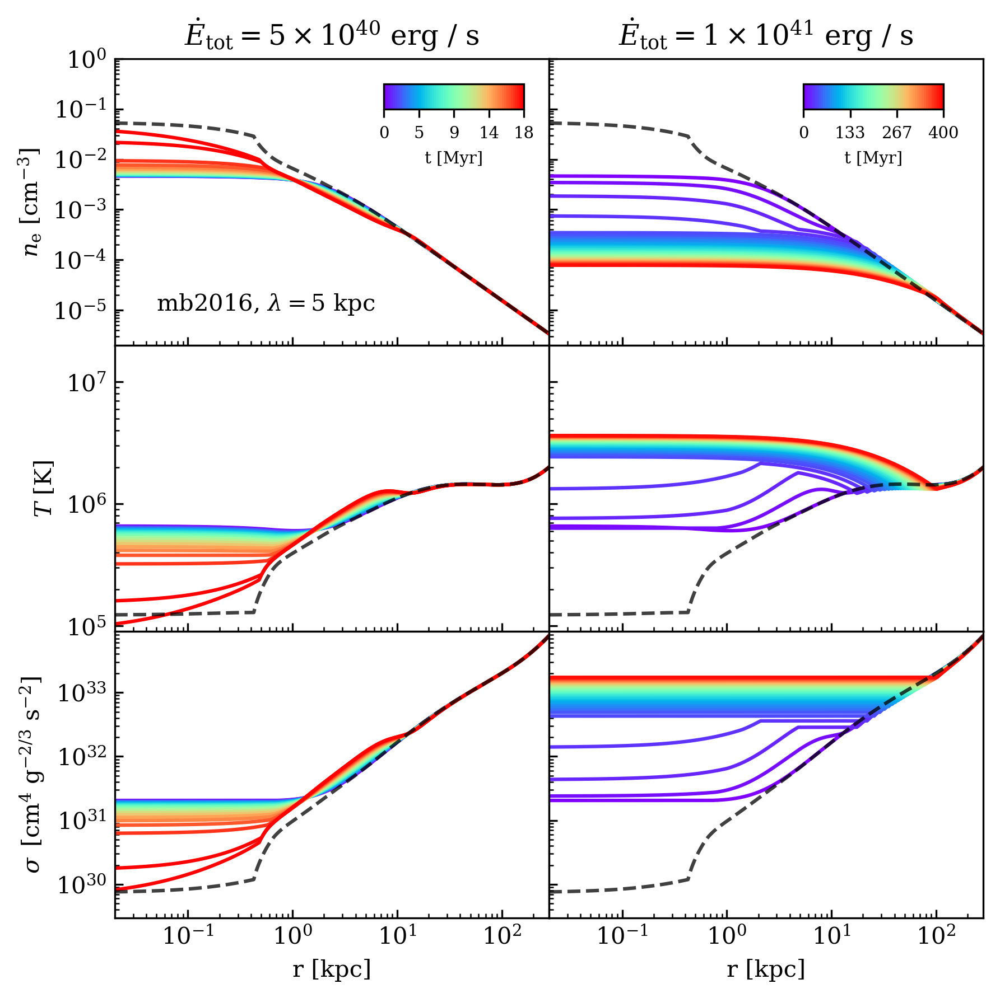

In [695]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.80, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-mb2016{}-E5e40-S5e3"
name = name_fmt.format("")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=1)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[0, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title(r'$\dot E_{\rm tot} = 5\times 10^{40}$ erg / s')

# Add previous corona
cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-mb2016-E1e41-S5e3"
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=10)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[0, 1].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticks=np.linspace(ts[0], ts[-1], 4),
    colorbar_ticksformat="{tick:.0f}"
)
axs[0, 1].set_title(r'$\dot E_{\rm tot} = 1\times 10^{41}$ erg / s')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)
axs[0,0].text(0.05, 1e-5, "mb2016, $\lambda = 5$ kpc")

savefig(fig, "full-basic-plot-energy-mbnormal-threshold-S5")

plt.show()

#### mb2016-rescaled threshold $\sigma = 8$

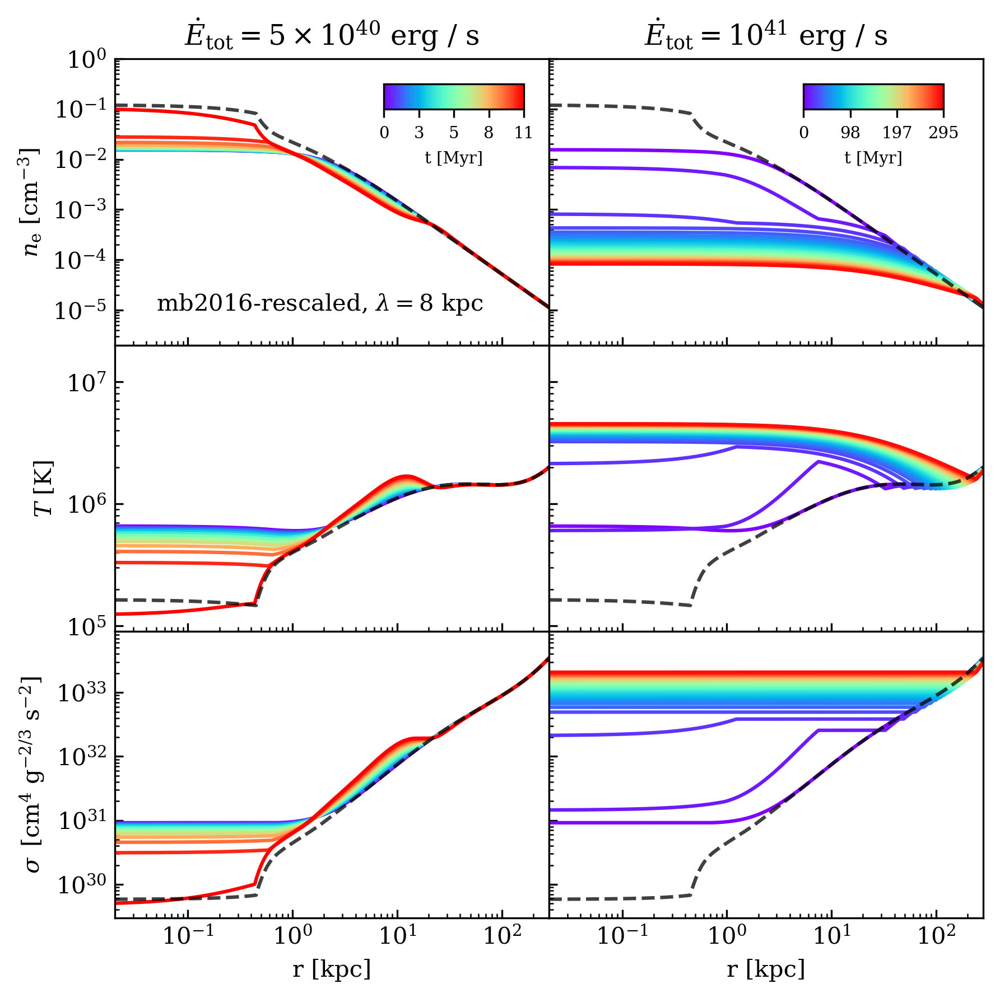

In [696]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.80, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-mb2016{}-E1e42-S8e3"
name = name_fmt.format("rescaled")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=1)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[0, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title(r'$\dot E_{\rm tot} = 5\times 10^{40}$ erg / s')

# Add previous corona
cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("rescaled")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-mb2016rescaled-E2e42-S8e3"
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=10)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[0, 1].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticks=np.linspace(ts[0], ts[-1], 4),
    colorbar_ticksformat="{tick:.0f}"
)
axs[0, 1].set_title(r'$\dot E_{\rm tot} = 10^{41}$ erg / s')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("rescaled")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)
axs[0,0].text(0.05, 1e-5, "mb2016-rescaled, $\lambda = 8$ kpc")

savefig(fig, "full-basic-plot-energy-mbrescaled-threshold")

plt.show()

#### mb2016-rescaled threshold $\sigma = 5$

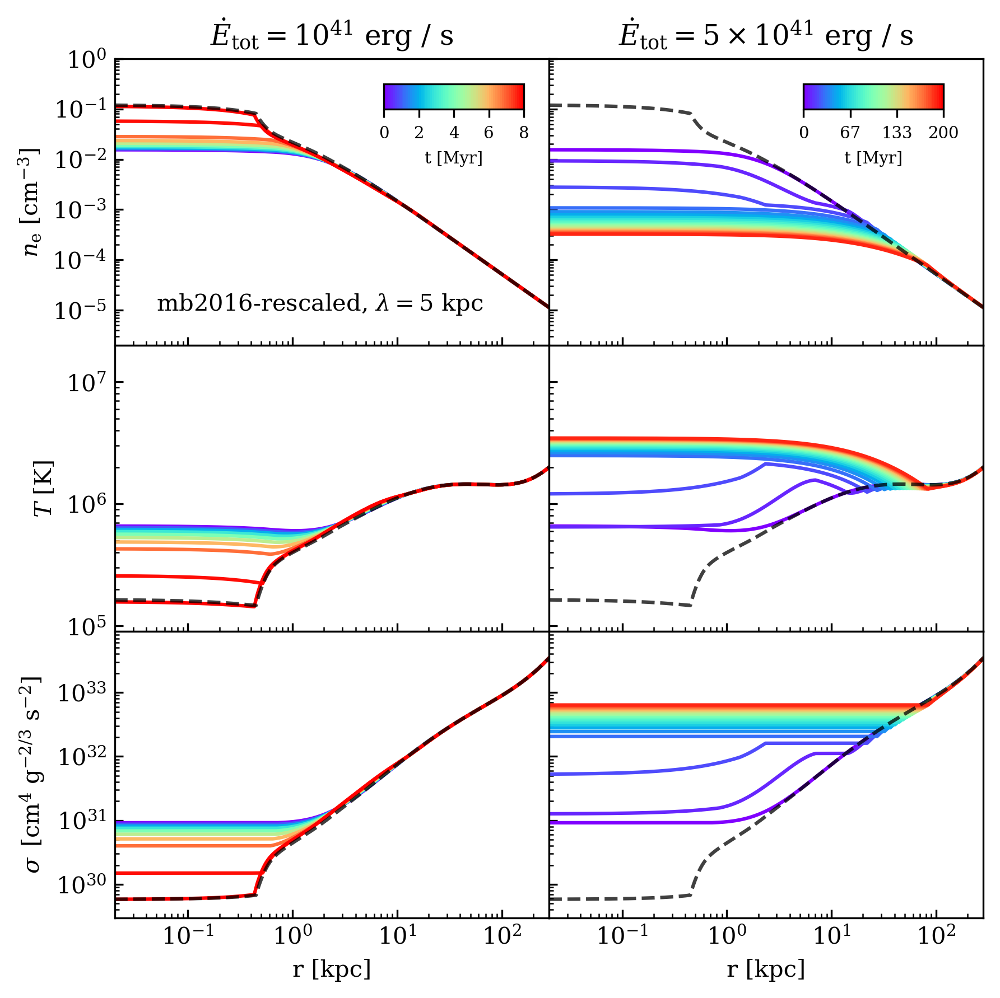

In [697]:
figax_full = plt.subplots(3,
                          2,
                          sharex=True,
                          sharey='row',
                          figsize=(MPL_STD_WIDTH, 3 * MPL_STD_HEIGHT / 2))

fig, axs = figax_full


cbar_box = Bbox.from_bounds(0.77, 0.80, 0.40, 0.10) # In Axes space
# cbar_box.transformed(axs[1, 0].transAxes).transform(fig.transFigure.inverted())

###########
name_fmt = "MW-mb2016{}-E1e41-S5e3"
name = name_fmt.format("rescaled")
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=1)
times = np.append(times, ts[-1])
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 0]),
    colorbar_loc=cbar_box.transformed(axs[0, 0].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticksformat="{tick:.0f}",
#     colorbar_ticks=np.linspace(times[0], times[-1], 5),
)

axs[0, 0].set_title(r'$\dot E_{\rm tot} = 10^{41}$ erg / s')

# Add previous corona
cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("rescaled")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 0]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

name = "MW-mb2016rescaled-E5e41-S5e3"
result = res_mw[name]
_, (ts, *_) = result
times = select_times(ts, dt=10)
times = np.append(times, ts[-1])
# basic_plot_all(result, plot_times=times, zorder=10, figax=(fig, axs[:, 1]))
basic_plot_all(
    result,
    plot_times=times,
#     zorder=10,
    figax=(fig, axs[:, 1]),
    colorbar_loc=cbar_box.transformed(axs[0, 1].transAxes).transformed(fig.transFigure.inverted()).bounds,
    colorbar_ticks=np.linspace(ts[0], ts[-1], 4),
    colorbar_ticksformat="{tick:.0f}"
)
axs[0, 1].set_title(r'$\dot E_{\rm tot} = 5\times 10^{41}$ erg / s')

# Add previous corona
# cmp_name_fmt = "MW-CLOUDY-mb2016{}-conv"
cmp_name = cmp_name_fmt.format("rescaled")
param, (ts, rs, ps, ms, ss, tcs) = res_mw[cmp_name]
basic_plot(rs[-1], ps[-1], ms[-1], ss[-1], param=param, figax=(fig, axs[:, 1]), options={ 'ls': "--", 'color': 'k', 'alpha':0.75})

###########

axs[0, 0].set_yscale('log')
axs[0, 0].set_xscale('log')
axs[1, 0].set_yscale('log')
axs[2, 0].set_yscale('log')

axs[0, 0].set_ylim(2e-6, 1)  # Density
axs[1, 0].set_ylim(9e4, 2e7)  # Temperature
axs[2, 0].set_ylim(3e29, 9e33)  # Entropy index
axs[0, 0].set_xlim(2e-2, result[0].R_out / 1e3)  # radius (kpc)

for a in axs.flat:
    a.set_xlabel('')
    a.tick_params(axis="y", direction='in', which='both')  #, length=8)
    a.tick_params(axis="x", direction='in', which='both')  #, length=8)

for a in axs[-1, :]:
    a.set_xlabel('r [kpc]')

for a in axs[:, 1]:
    #     a.tick_params(axis="y", direction='in', which='both')#, length=8)

    a.set_ylabel('')
#     a.set_yticklabels([])

fig.subplots_adjust(right=1, wspace=0.0, hspace=0)
axs[0,0].text(0.05, 1e-5, "mb2016-rescaled, $\lambda = 5$ kpc")

savefig(fig, "full-basic-plot-energy-mbrescaled-threshold-S5")

plt.show()

#### Central heating

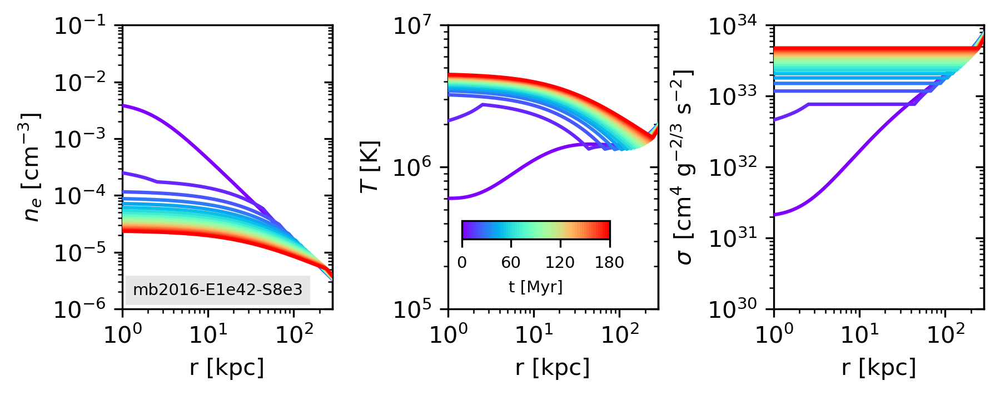

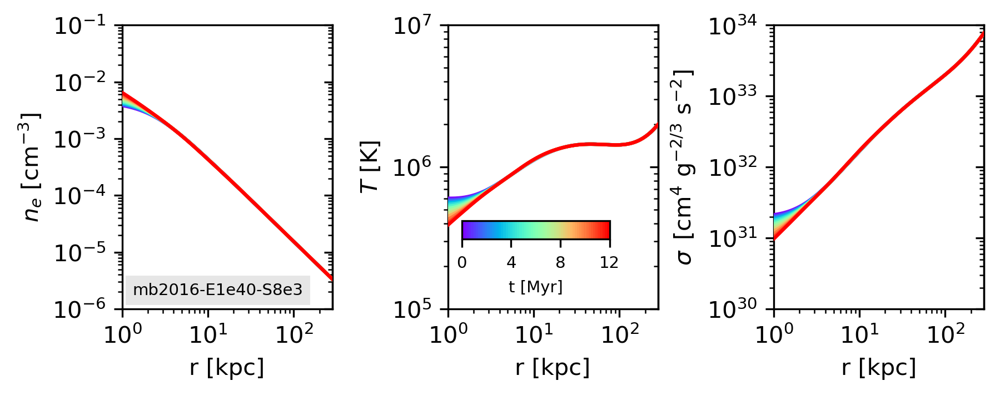

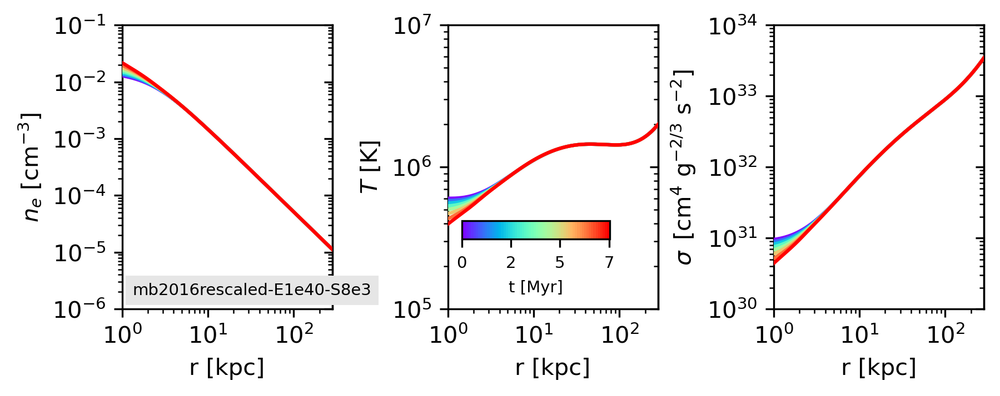

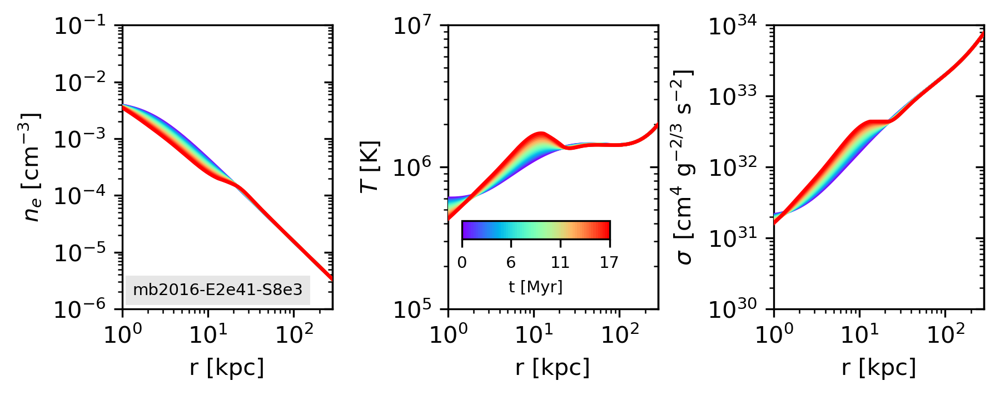

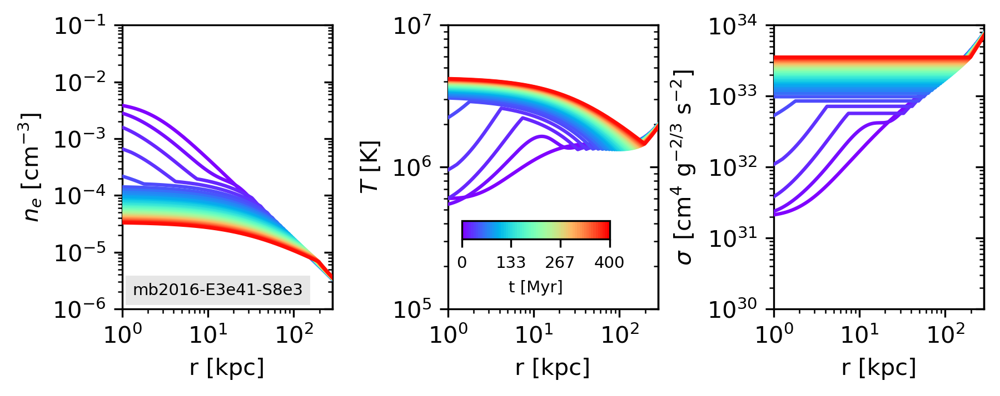

In [511]:
from itertools import islice

plot_names = [
    "MW-mb2016-E1e42-S8e3",
    "MW-mb2016-E1e40-S8e3",
    
    "MW-mb2016-E2e41-S8e3",
    "MW-mb2016-E3e41-S8e3",
    "MW-mb2016rescaled-E1e40-S8e3",
]

for name, result in res_mw.items():
    #     if 'SD' not in name and 'CLOUDY' not in name:
    #     if name != "MW-mb2016-E5e41-S5e3":
    if not name in plot_names:
        continue
#     if not name.endswith('S8e3') or not "E1e42" in name:
#         continue

    _, (ts, *_) = result
    if ts[-1] > 100:
        dt = 10
    else:
        dt = 1
    times = select_times(ts, dt=dt)

    fig, ax = basic_plot_all(result,
                             plot_times=times,
                             zorder=10,
                             colorbar_loc=[0.47, 0.30, 0.15, 0.05],
                             colorbar_ticksformat="{tick:.0f}",
                             colorbar_ticks=np.linspace(times[0], times[-1], 4))
    if 'SD' in name:
        annotate_name = name[6:]
    elif 'CLOUDY' in name:
        annotate_name = name[10:]
    elif name.endswith('S8e3'):
        annotate_name = name[3:]
    annotate(annotate_name, (0.05, 0.05), ax[0, 0])

    if False:
        r0 = np.arange(1, param.R_out, 1000)
        #         stern_params = {'M12': 1.3, 'dotM_1': 2.0, 'cool_22': 0.6}
        if 'rescaled' in name:
            cool_22 = 0.25
        else:
            cool_22 = 0.6

        ylim = ax[0, 0].get_ylim()
        ylimT = ax[0, 1].get_ylim()
        ylimS = ax[0, 2].get_ylim()
        for dotM_1 in [0.1, 1, 10]:
            rho, v_r, T, mach, Rsonic = stern2019_quantities_new(
                r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
            n_e = 0.88 * rho

            mu = 0.62
            rh = rho * cst.proton_mass
            sig = cst.k_B * T / (mu * cst.proton_mass * rh**(cst.gamma - 1))

            line, = ax[0, 0].plot(r0 / 1e3, n_e, c='gray', ls='--')
            x = line.get_xdata()[-150]
            y = line.get_ydata()[-150]
            ax[0, 0].text(x,
                          y,
                          f"{dotM_1:.1f}",
                          ha='center',
                          va='center',
                          size=8,
                          rotation=-45,
                          bbox={
                              'boxstyle': 'square,pad=0',
                              'fc': 'white',
                              'ec': 'white'
                          })

            line, = ax[0, 2].plot(r0 / 1e3, sig, c='gray', ls='--')
            x = line.get_xdata()[-150]
            y = line.get_ydata()[-150]
            ax[0, 2].text(x,
                          y,
                          f"{dotM_1:.1f}",
                          ha='center',
                          va='center',
                          size=8,
                          rotation=35,
                          bbox={
                              'boxstyle': 'square,pad=0',
                              'fc': 'white',
                              'ec': 'white'
                          })

        ax[0, 1].plot(r0 / 1e3, T, c='gray', ls='--')
#             ax[0, 2].plot(r0 / 1e3, n_e, c='gray', ls='--')

    ax[0, 0].set_ylim(1e-6, 1e-1)
    ax[0, 1].set_ylim(1e5, 1e7)
    ax[0, 2].set_ylim(1e30, 1e34)

    ax[0, 0].set_xlim(1e-0, result[0].R_out / 1e3)

    savefig(fig, name=f"basic-plot-heat-{name}")
    plt.show()
#     break

<IPython.core.display.Javascript object>


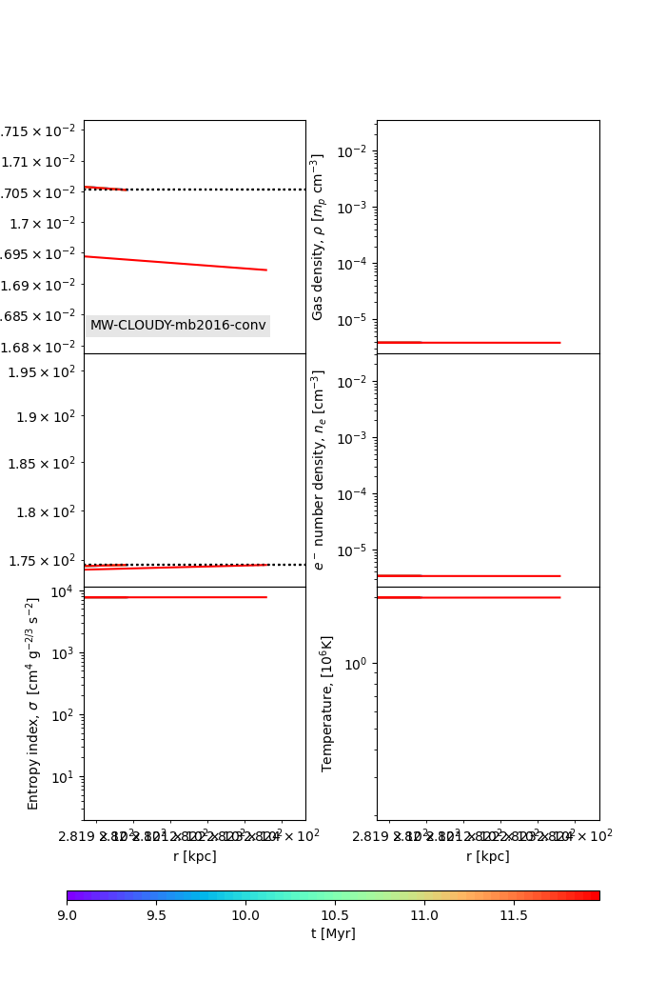

In [132]:
from itertools import islice


for name, result in res_mw.items():
    if name != "MW-CLOUDY-mb2016-conv":
#     if name != "MW-SD-mb2016rescaled":
#     if name != "MW-mb2016-E5e41-S5e3":
        continue
        
    _, (ts, *_) = result
    times = select_times(ts)
    
#     times = [9.,9.5,10.,10.5,11.,11.5,11.90,11.97909118]

#     times = [11.97909118]
    fig, ax = full_plot_all(result, plot_times=times)
    annotate(name, (0.03, 0.1), ax[0, 0])
    
    ax[0, 0].set_xlim(0.001, ax[0, 0].get_xlim()[-1])
#     param, (t, r, P, M, sig, tcools) = result
#     print(tcools[-10:])
#     print(name)
#     for tc, r_i in islice(zip(tcools, r), len(tcools)-10, None):
#         minimal = np.argmin(np.abs(tc))
#         print(f"at {r_i[minimal]/1e3:.1e} kpc: tcool {tc[minimal]:.1e}")
    
#     ax[-1, -1].axvline(r_i[minimal] / 1e3, ls='--', c='k')
#     print()

#     savefig(fig, name=f"full-plot-{name}")
#     plt.close()
    plt.show()
    break

In [63]:
## Recreate plots (??? don't think is needed)
# for name, result in res_mw.items():
#     _, (ts, *_) = result
#     times = select_times(ts)
    
#     fig, ax = recreate_plot_all(result, plot_times=times, kb_ylims=False)
    
#     ax[0, 0].set_xlim(10, ax[0, 0].get_xlim()[1])
    
#     annotate(name, (0.03, 0.9), ax[0, 0])
    
#     savefig(fig, name=f"recreate-plot-{name}")
#     plt.close()
# #     plt.show()
# #     break

### Quantity

In [109]:
def evaluate_quantity_time(ts, rs, qs, radii=None):
    if radii is None:
        radii = [0, 10e3, 100e3, 250e3]
        
    plot_q = np.empty((len(ts), len(radii)), dtype=float)
    
    for i, (t, r, q) in enumerate(zip(ts, rs, qs)):
        ifunc = interp1d(r, q)
        plot_q[i, :] = ifunc(radii)

    return np.array(radii), plot_q.T

Demonstration of how to plot a quantity (in this case mass) at three radii over time. Color indicates different initial conditions

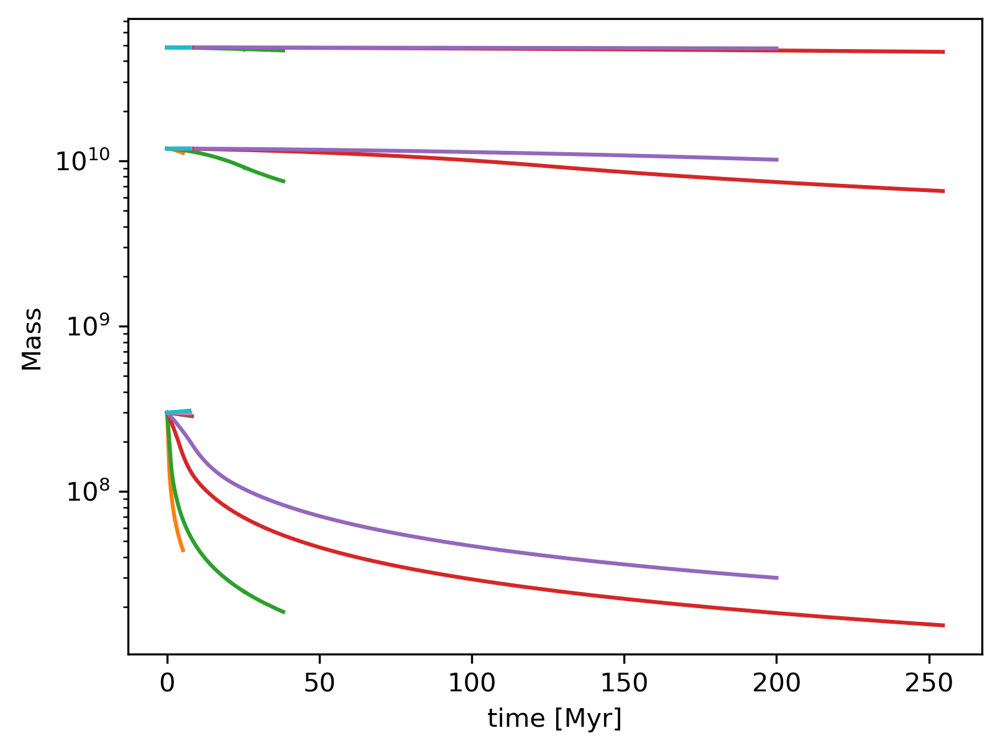

In [110]:
def plot_quantity_time(ts, rs, qs, qscale=1, figax=None):
    plot_radii, plot_q = evaluate_quantity_time(ts, rs, qs)
    plot_q *= qscale
    if figax is None:
        figax = plt.subplots(1, 1)
    fig, ax = figax
    
    color = None
    for i, r in enumerate(plot_radii):
        if color is None:
            line, = ax.plot(ts, plot_q[i], label=f'{r}')
            color = line.get_color()
        else:
            ax.plot(ts, plot_q[i], c=color, label=f'{r}')
            
    
    ax.set_yscale('log')
    ax.set_ylabel('Mass')
    ax.set_xlabel('time [Myr]')
    
    return figax


figax = plt.subplots(1, 1)
for n, res in res_mw.items():
    if not (n.endswith('S5e3') and 'rescaled' in n):
        continue
    _, (ts, rs, ps, ms, ss, tcs) = res
    plot_quantity_time(ts, rs, ms, qscale=cst.MASS_UNIT / cst.solmass, figax=figax)

### tmp

In [111]:
def find_tstop(times, limit=0.9, init_lower=1e-1):
    #
    dts = times[:-1] - times[1:]
    dt_change = dts[1:] / dts[:-1]
    init_dt = dts[0]
    
#     print(dts)
#     print(dt_change)
    for i, (change, dt) in enumerate(zip(dt_change, dts[1:]), 2):
        if dt / init_dt < init_lower and change > limit:
            return times[i]

    # Default is just the final index (i.e. we don't exclude anything)
    return times[len(times)-1]

### Mass Accretion

In [112]:
def fit_linear(x, y):
    """
    fits straight line: y = ax + b
    
    for y having additional dimensions '...' ':
    
        y[x, ... ]
        
    computes for all the dimensions:
    
        a[...], b[...]
        
    """
    N = x.size
    xna = x[:, np.newaxis]
    
    Sx = np.sum(xna, axis=0)
    Sy = np.sum(y, axis=0)
    Sxy = np.sum(xna*y, axis=0)
    Sxx = np.sum(xna*xna, axis=0)
    
    delta = N*Sxx - Sx*Sx
    a = (N*Sxy - Sx*Sy) / delta
    b = (Sy*Sxx - Sx*Sxy) / delta
    return a, b

In [113]:
def compute_mdot_from_result(result, plot_mask=None, plot_times=None, **kwargs):
    ts, rs, ps, ms, ss, tcs = result[1]
    return compute_mdot(ts, rs, ms, param, plot_times=plot_times, **kwargs)
#     param, _ = result
#     selected = mask_result(result, plot_mask, plot_times)
#     ts, rs, ps, ms, ss, tcs = selected
#     return compute_mdot(plot_times, rs, ms, param, **kwargs)
        
def compute_mdot(ts, rs, ms, param, plot_times=None, dr=100., eval_radii=None, convert_unit=True):
    if eval_radii is None:
        r0 = 1.0 if rs[0][0] < 1 else rs[0][0]
        eval_radii = np.arange(r0, param.R_out-1000., dr)
    if plot_times is None:
        plot_times = ts
    
    # Evaluate for _all_ times
    masses = evaluate_quantity_time(ts, rs, ms, radii=eval_radii)[1].T
    # masses[time][radius] (after transpose)
    
    ### Compute using fitting:
    m_dot = []
    times = plot_times[:-1]
    for t0, t1 in zip(plot_times[:-1], plot_times[1:]):
        mask = (ts >= t0) & (ts < t1)
        t_interval = ts[mask]
        m_interval = masses[mask]
        
        if len(t_interval) < 4:
            print(f"Warning, fitting with less than 4 points (time = {t0}, {t1})")
        m_dot_fit, offset = fit_linear(t_interval, m_interval)
        m_dot.append(m_dot_fit)
        
    m_dot = np.stack(m_dot)

#     ### Compute directly
#     m_dot = (masses[1:] - masses[:-1]) / (ts[1:] - ts[:-1])[:, np.newaxis]
#     times = ts[:-1] + (ts[1:] - ts[:-1]) / 2

    # Converting to Msol / yr
    if convert_unit:
        unit_factor = (cst.MASS_UNIT / cst.solmass) / (cst.TIME_UNIT / u.yr.to('s'))
        m_dot = m_dot * unit_factor

    return m_dot, times, eval_radii

In [114]:
def plot_mass_accretion(result, dt=1):
    
    param, (ts, *_) = result
    comp_times  = select_times(ts, dt=dt)
    m_dot, times, radii = compute_mdot_from_result(result, plot_times=comp_times, convert_unit=True)
    
    
    cmap = colormaps['rainbow'].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)
    
    fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/2, MPL_STD_HEIGHT/2))
    for md, t in zip(m_dot, times):
        
        color = mapper.to_rgba(t)
        ax.plot(radii / 1e3, md, c=color)
        ax.plot(radii / 1e3, -md, ls=':', c=color)
        
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_ylabel('$\dot M$ [$M_\odot$ / yr]')
    ax.set_xlabel('r [kpc]')
    colbar = fig.colorbar(ax=ax, mappable=mapper)
    colbar.set_label('t [Myr]')

    return fig, ax

In [115]:
def valid_pressures(result, tol=1e-5):
    param, (ts, rs, ps, ms, ss, tcs) = result
    p_infs = np.array([p[-1] for p in ps])
    
    ref = param.P_inf
    
    residual = (p_infs - ref) / param.P_inf
    mask = np.abs(residual) < tol
    
    return mask

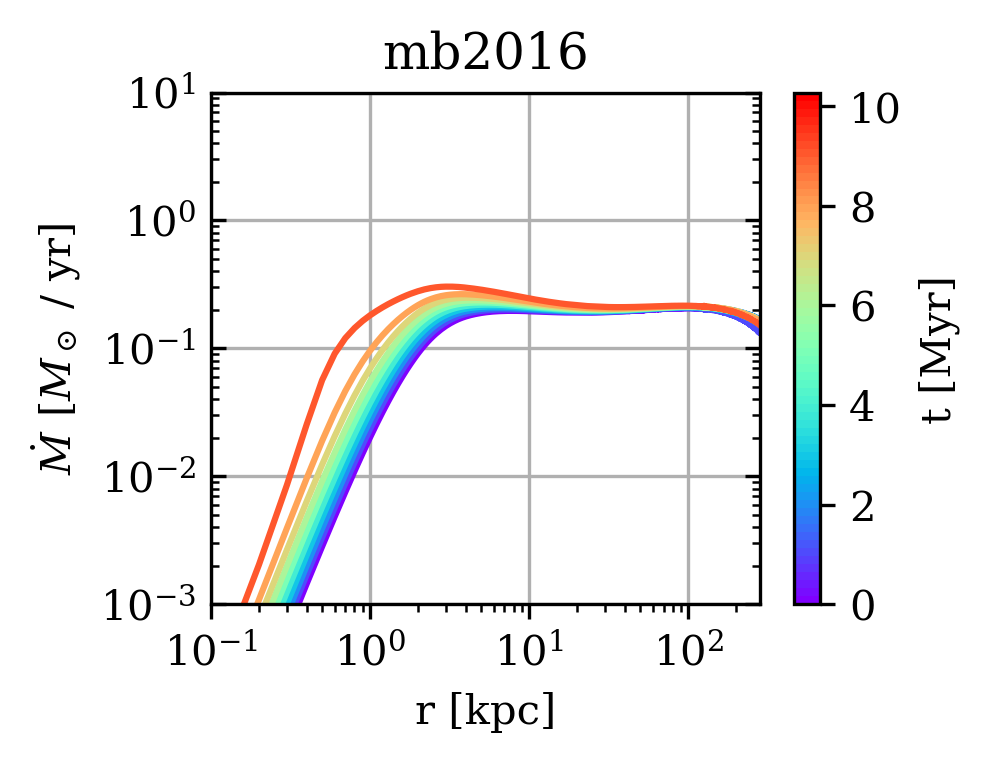

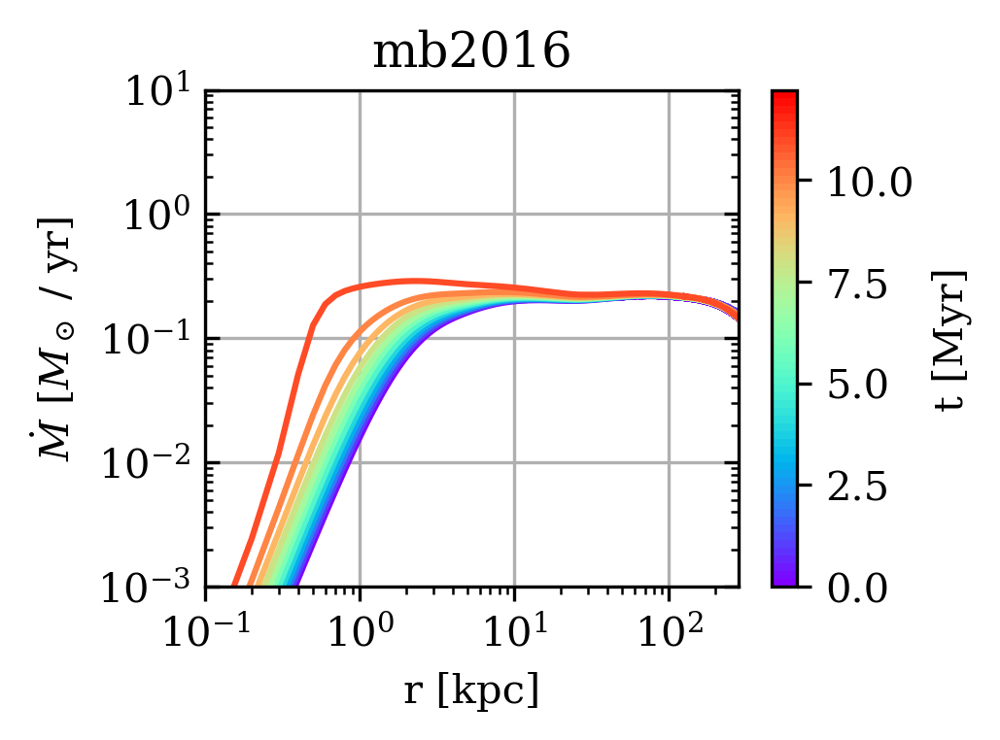

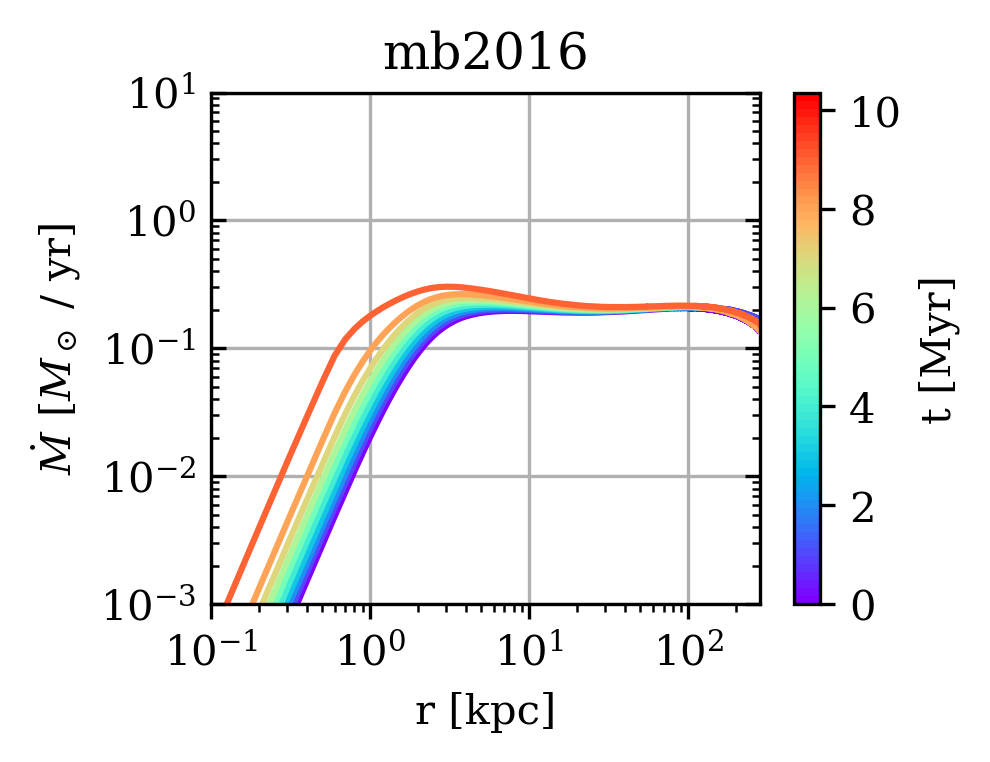

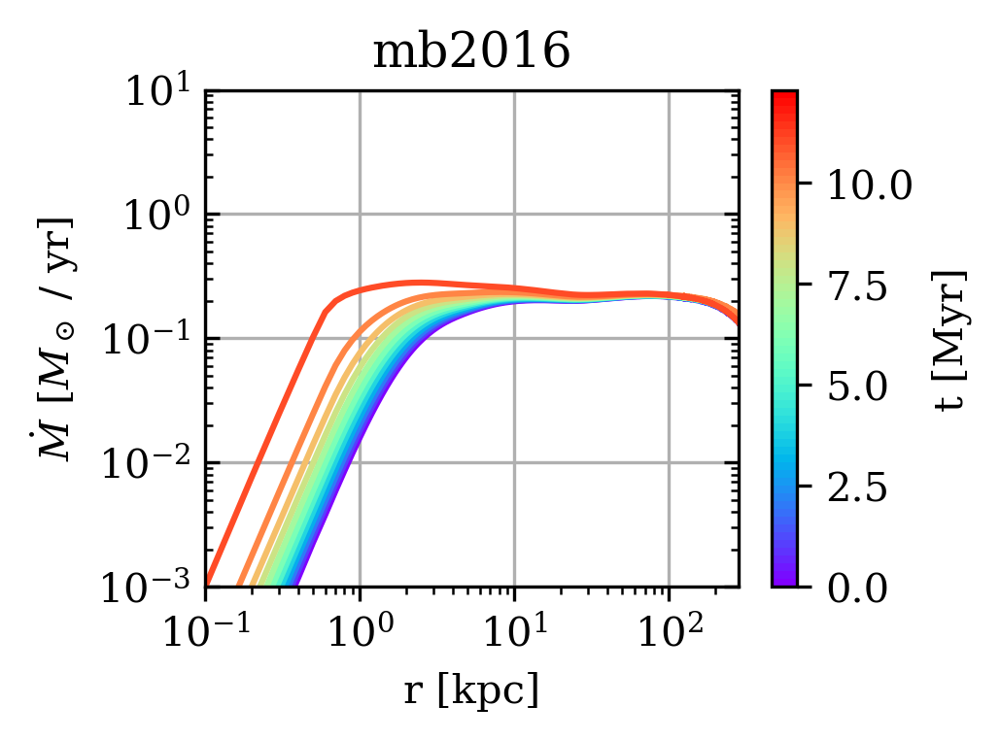

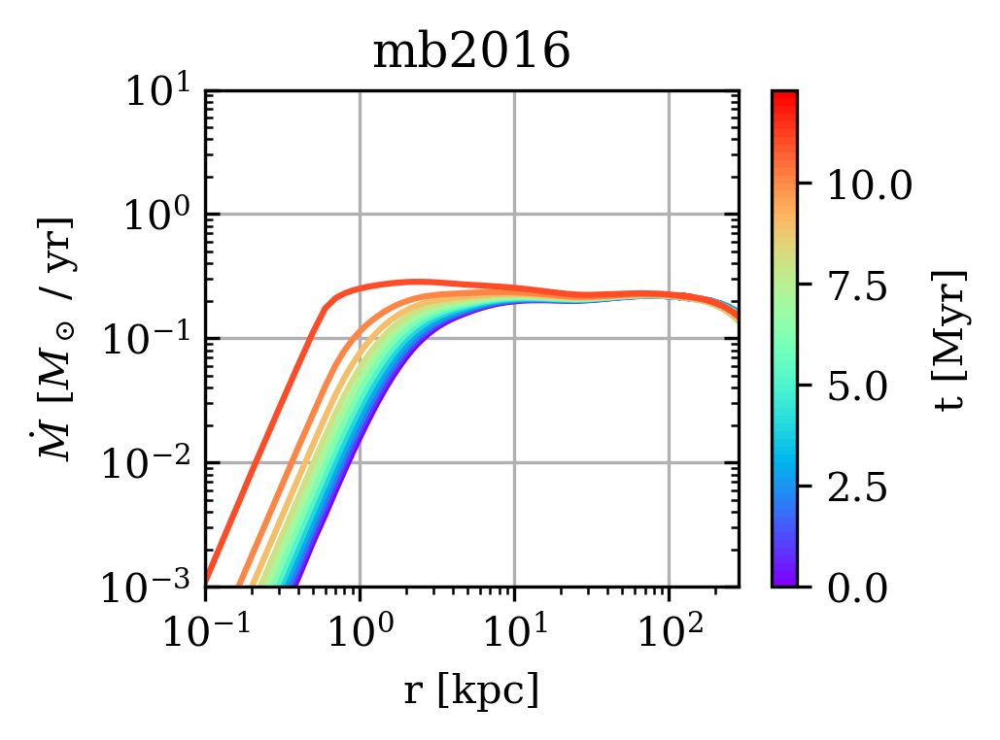

...

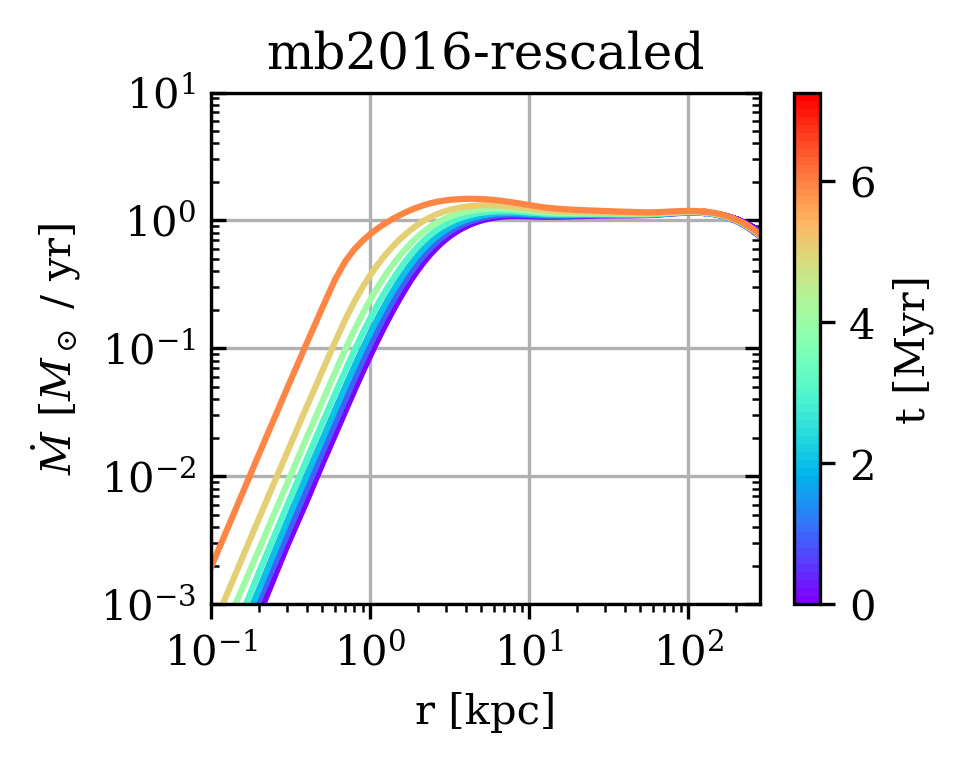

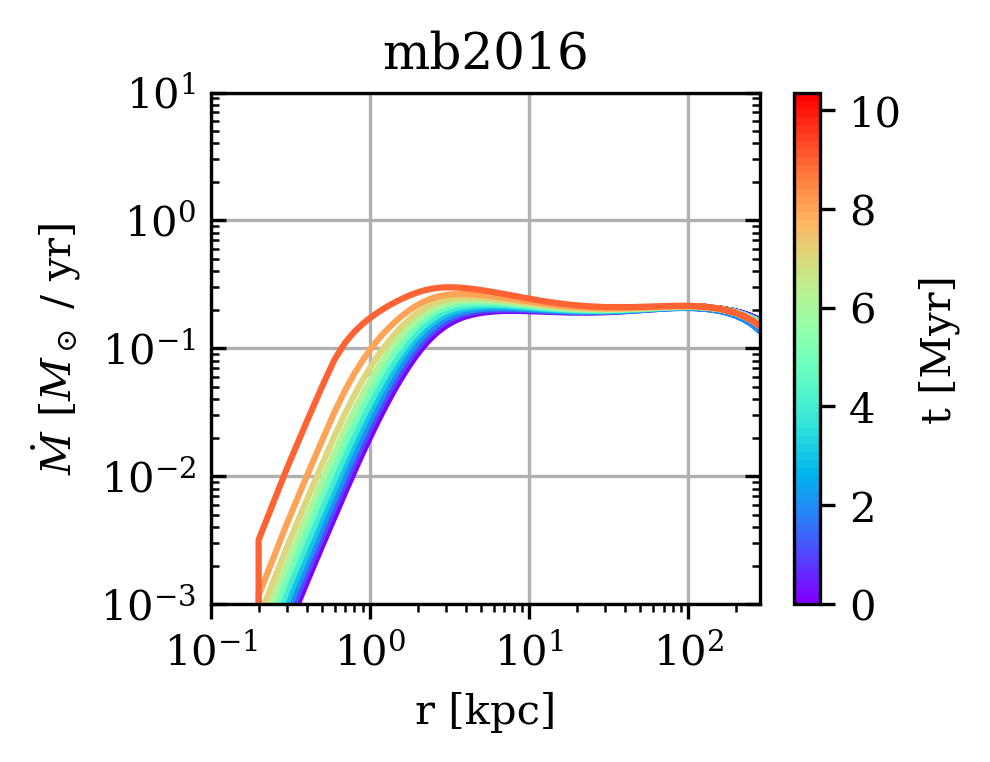

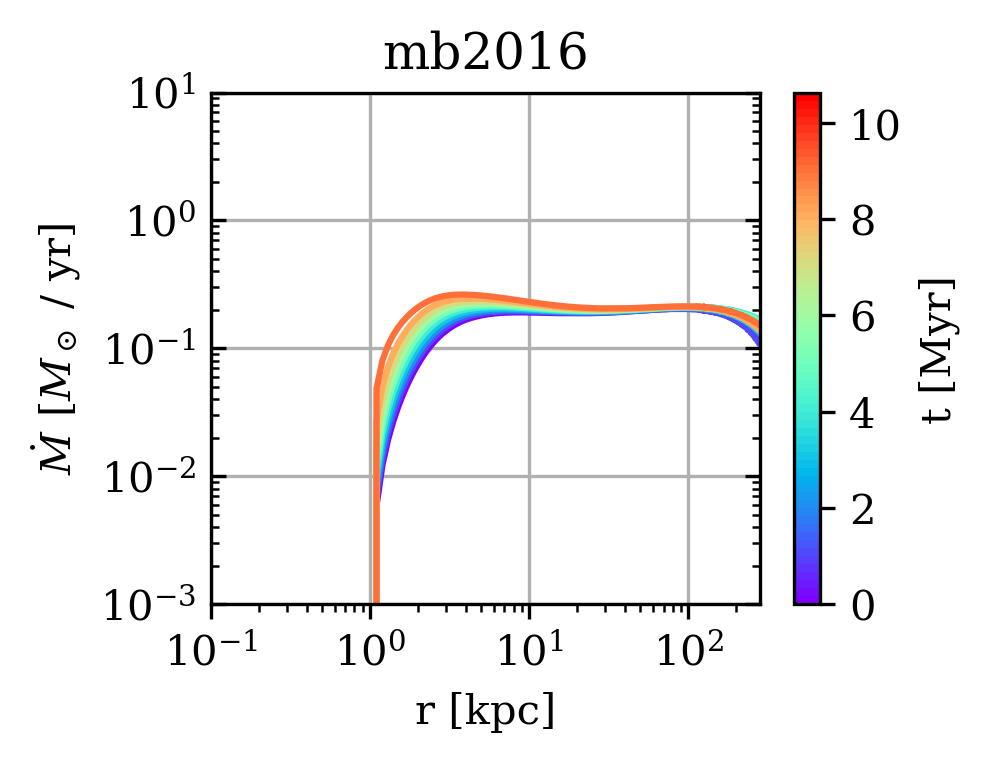

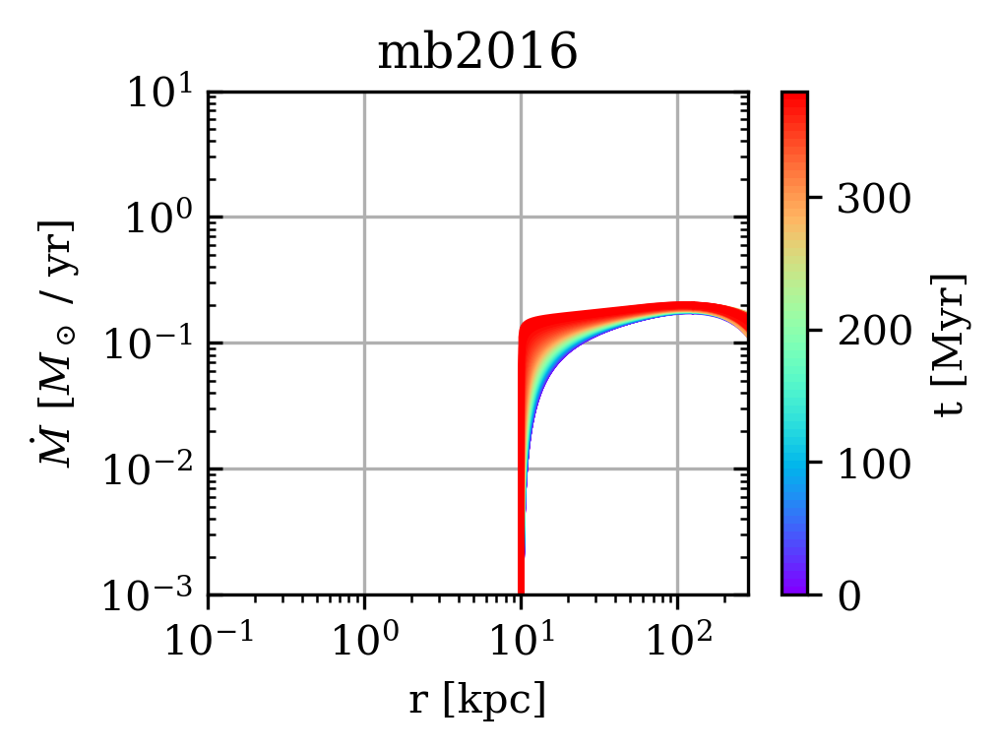

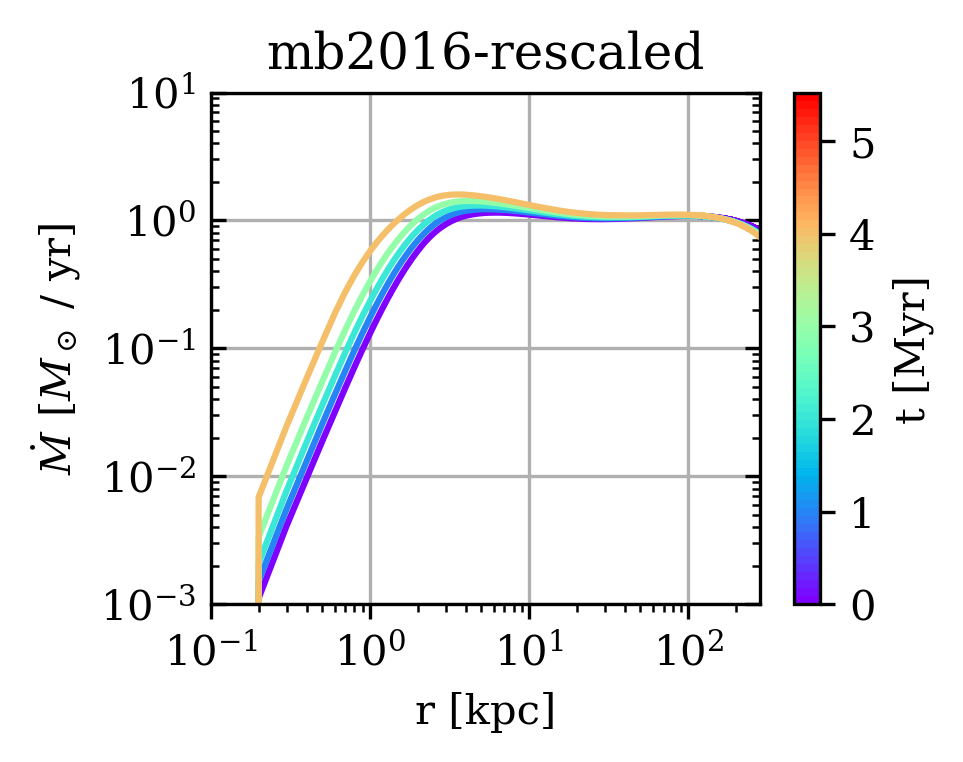

Time too short, skipping MW-SD-mb2016rescaled-radius1e3
Time too short, skipping MW-SD-mb2016rescaled-radius10e3


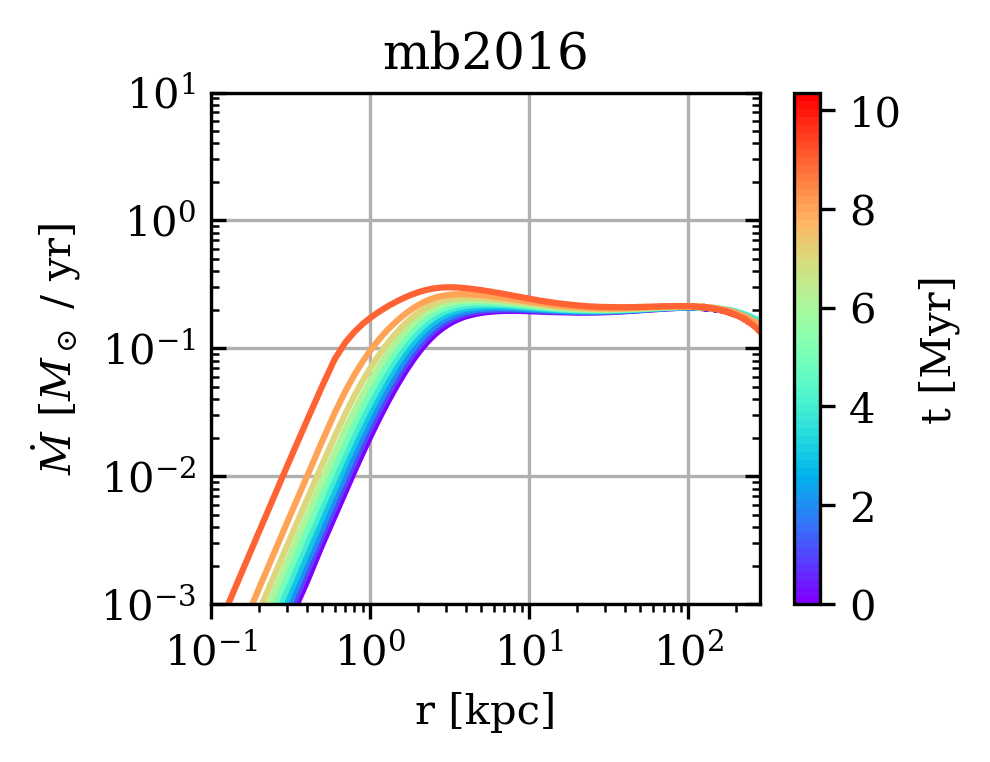

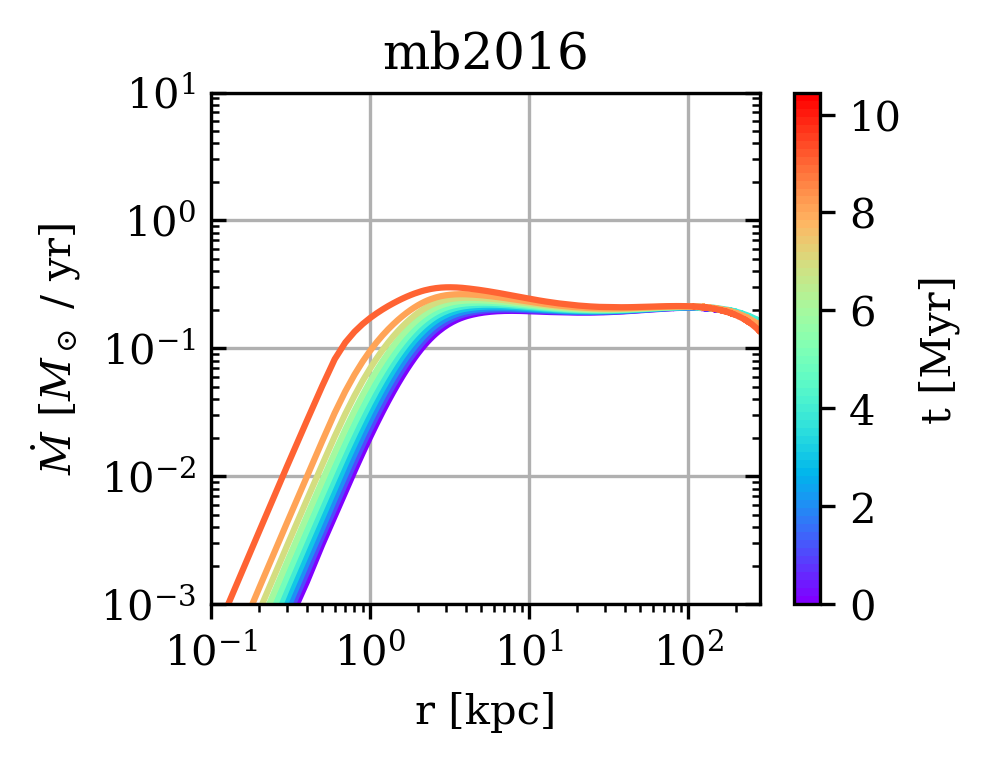

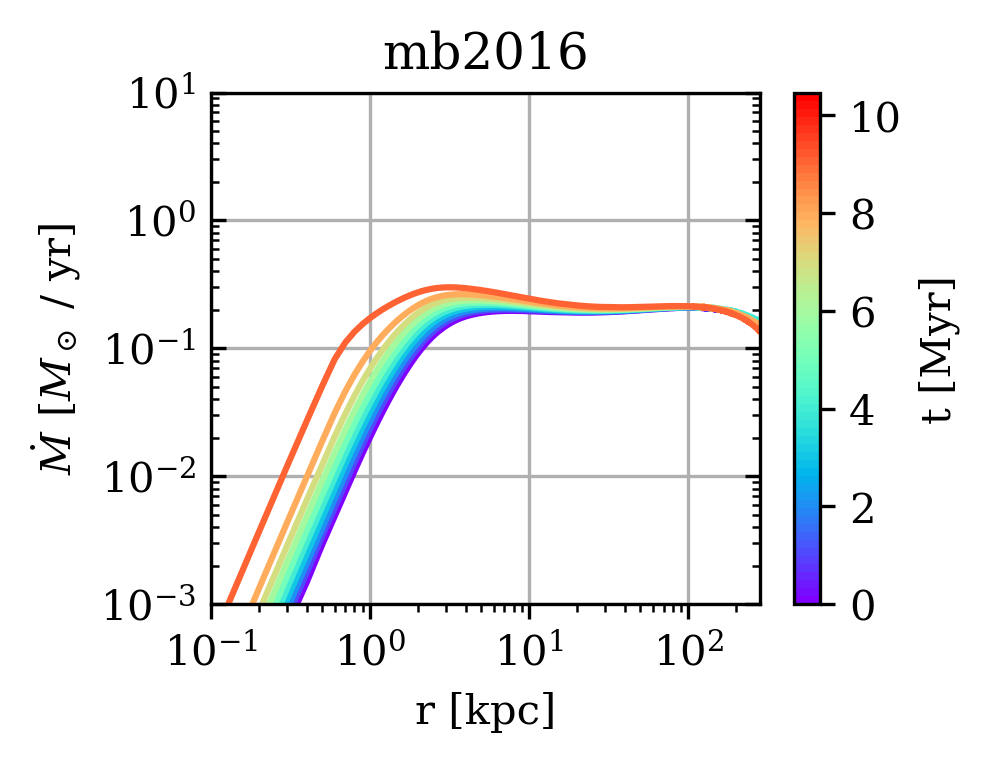

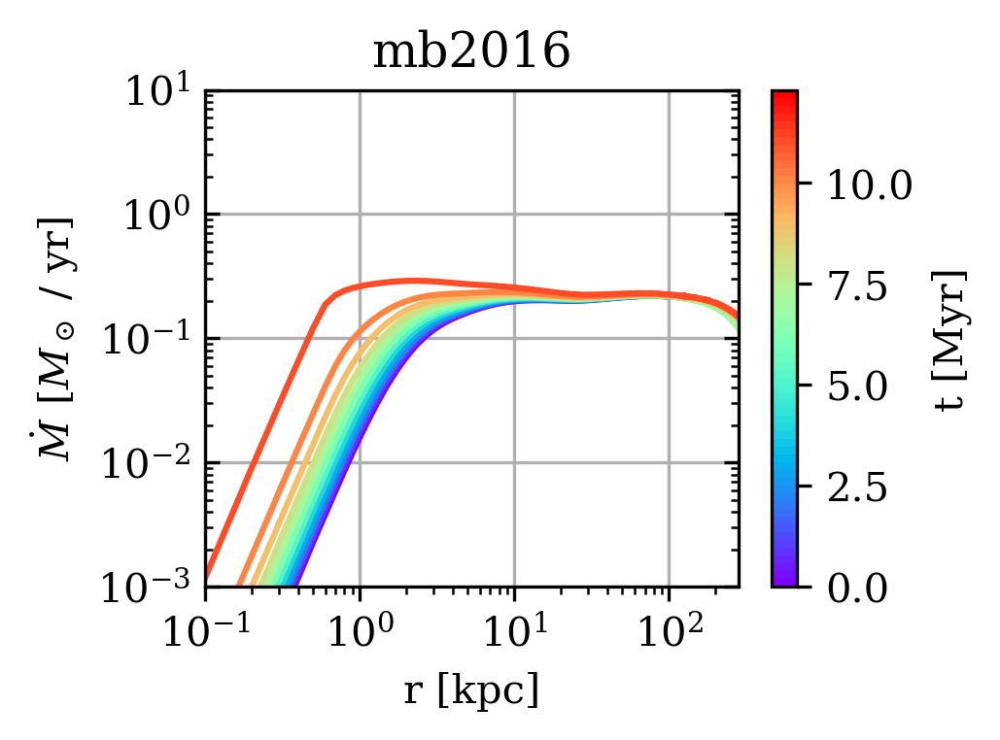

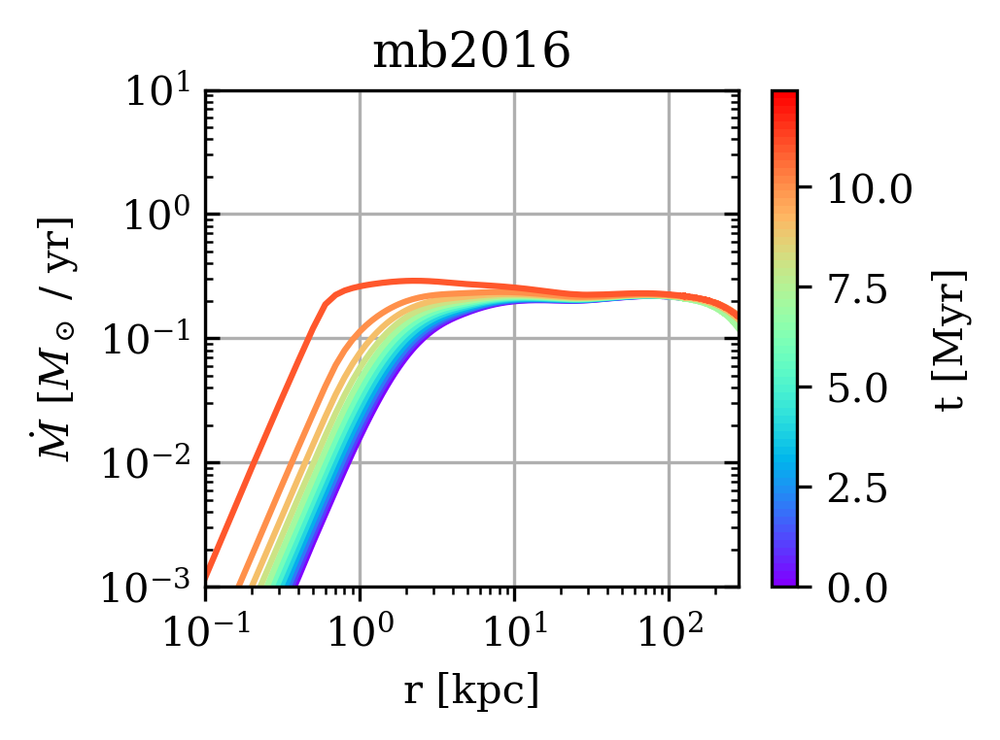

...

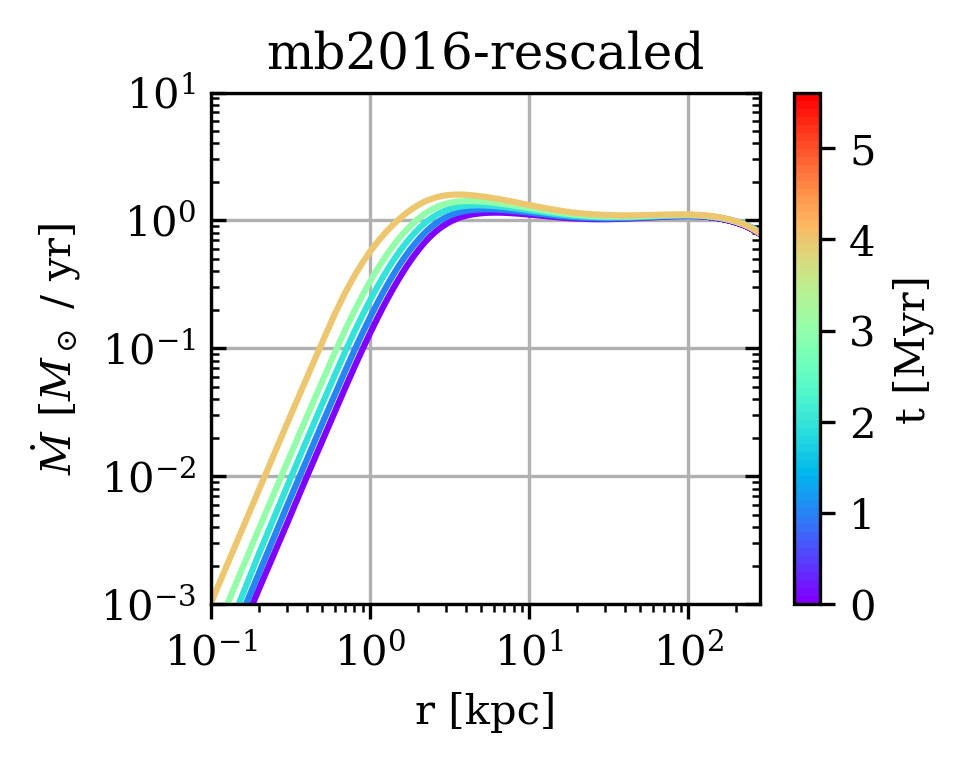

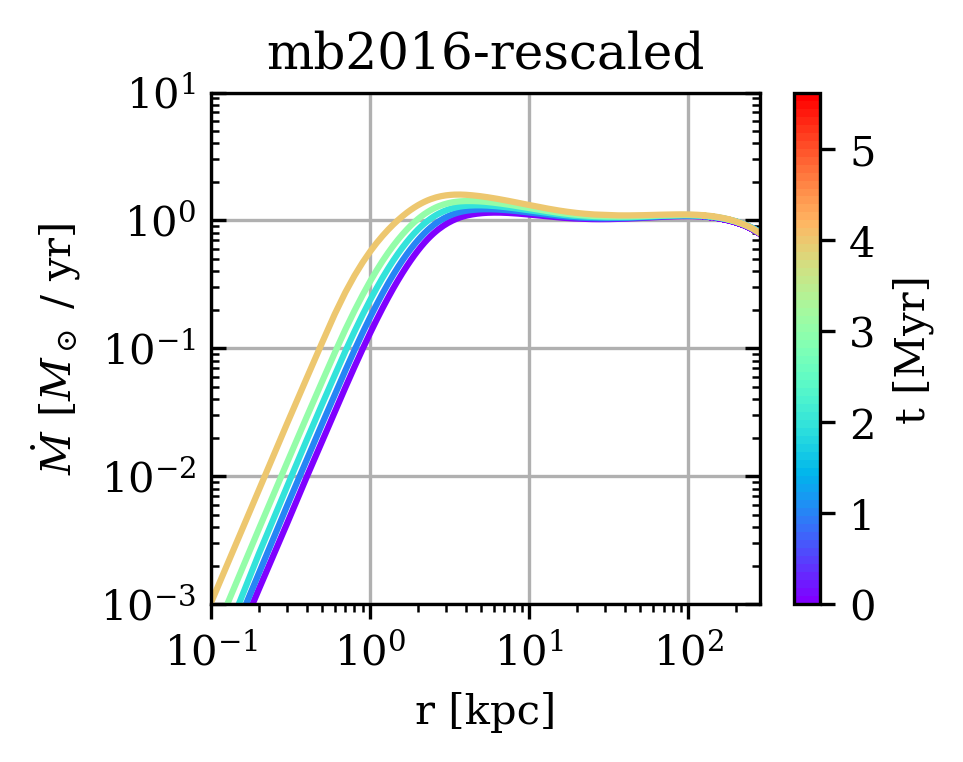

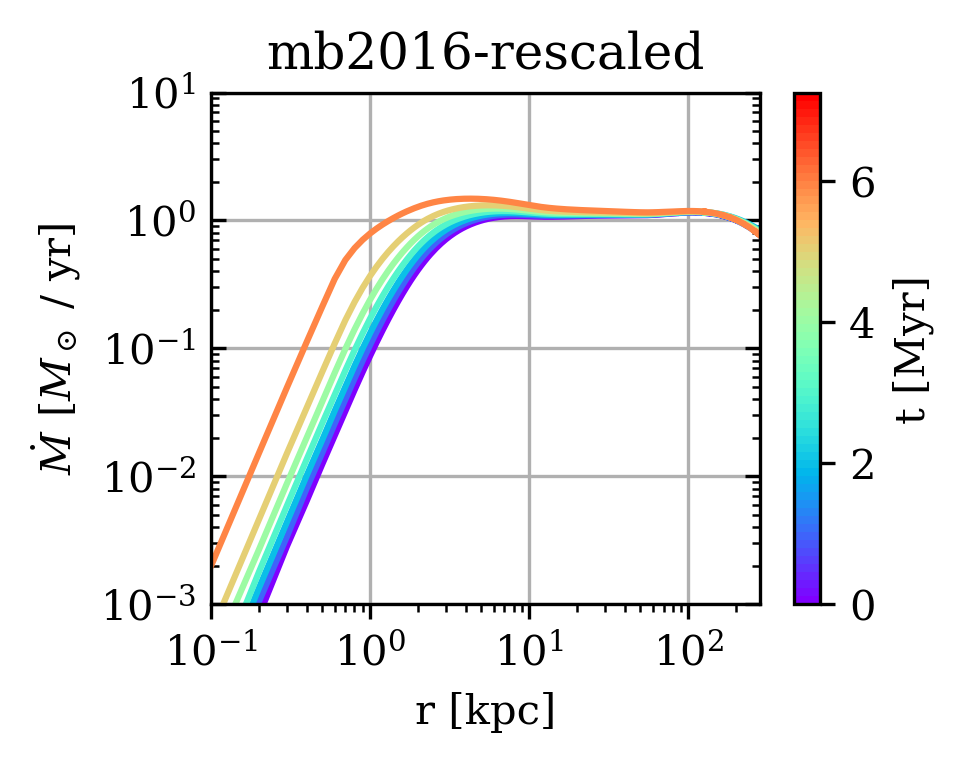

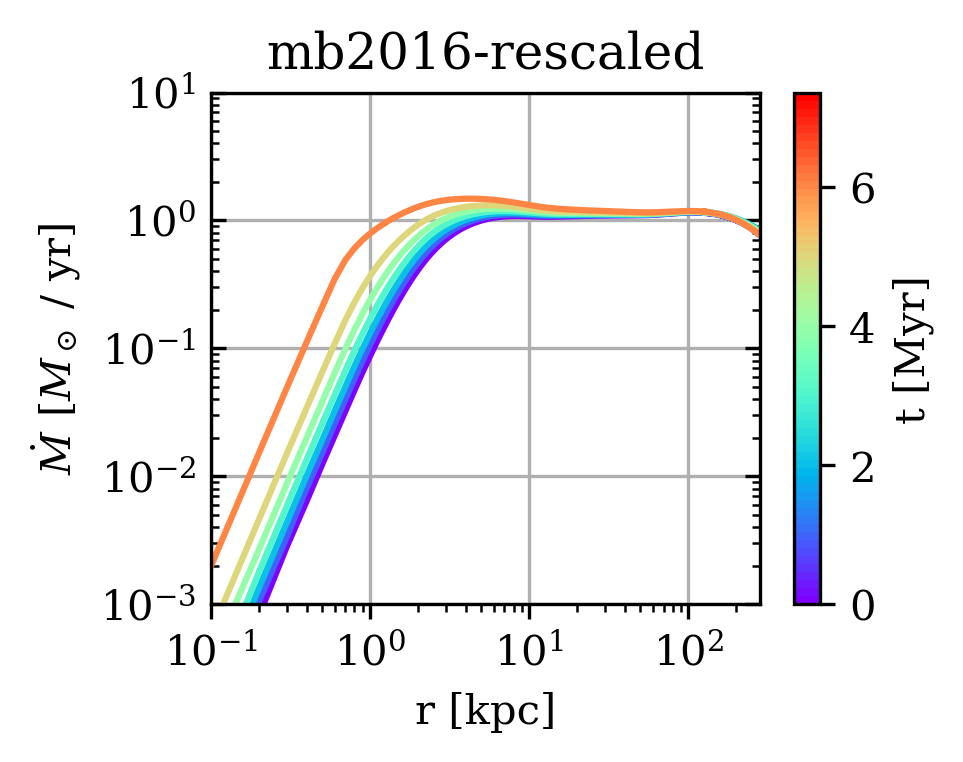

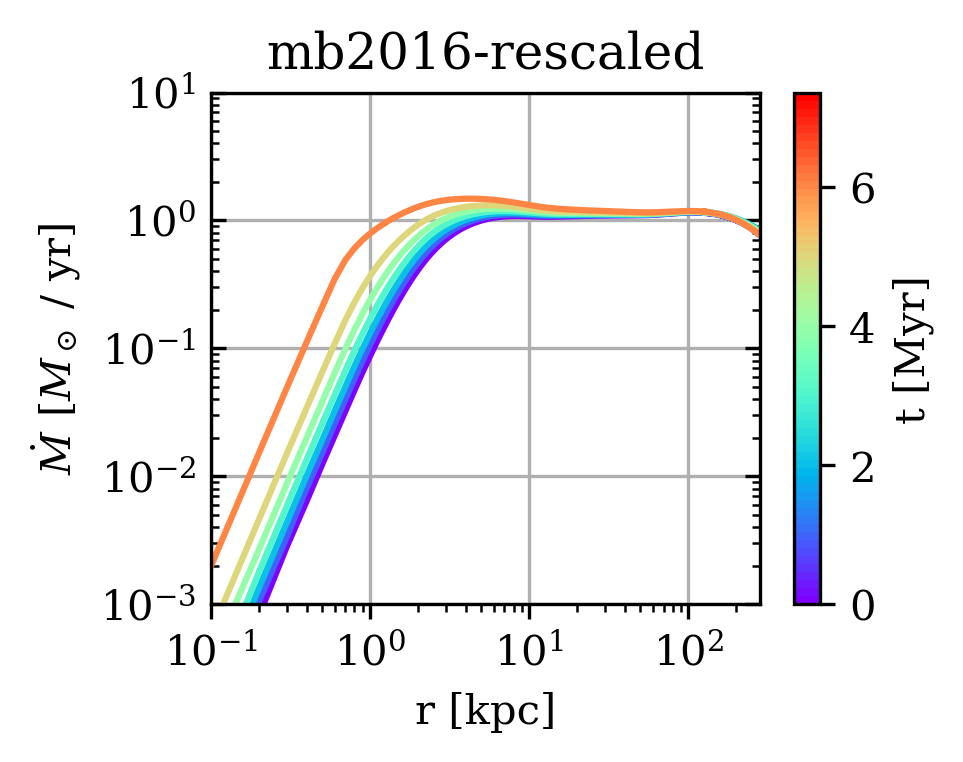

In [698]:
i = 0
for name, result in res_mw.items():
    if 'SD' not in name and 'CLOUDY' not in name:
#     if name != "MW-CLOUDY-mb2016-conv":
#     if name != "MW-mb2016-E5e41-S5e3":
        continue
    
    selected = mask_result(result, plot_mask=valid_pressures(result))
    
    if selected[0][-1] < 1:
        print(f"Time too short, skipping {name}")
        continue
    
    result_mask = (result[0], selected)
    fig, ax = plot_mass_accretion(result_mask, dt=1.)
#     annotate(name, (1-0.7, 0.1), ax)
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(titlename)
    if True:
        ax.set_xlim(0.1, 282)
        ax.set_ylim(1e-3, 10)
#         ax.set_ylim(1e-2, 10)
    ax.grid(True)
    ax.tick_params(axis='y', which='both', direction='in', right=True)
    savefig(fig, name=f"mass-accretion-full-{name}")
#     savefig(fig, name=f"mass-accretion-full-{name}")
    plt.show()
#     break

MW-SD-mb2016-radius0.1e3


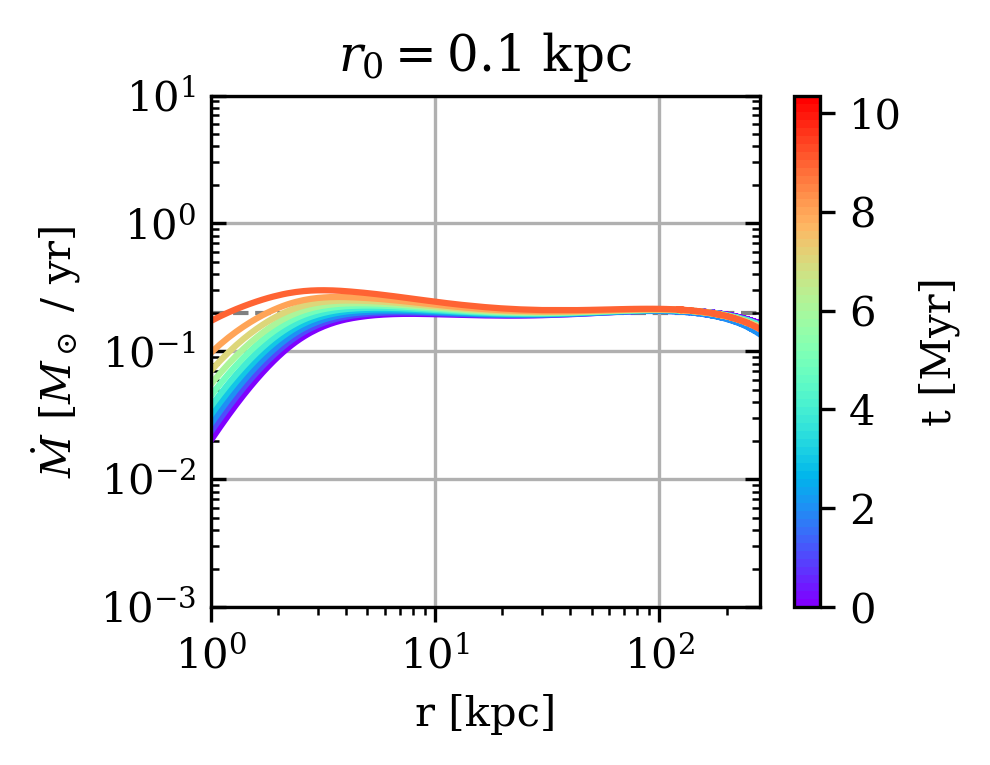

MW-SD-mb2016-radius1e3


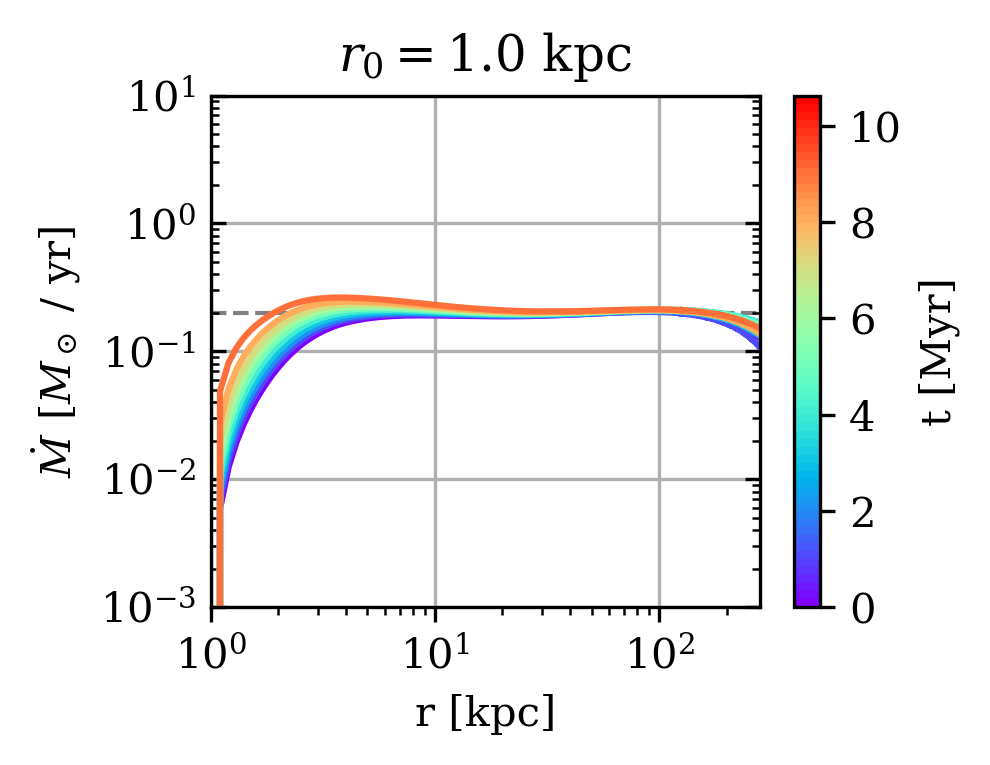

MW-SD-mb2016-radius10e3


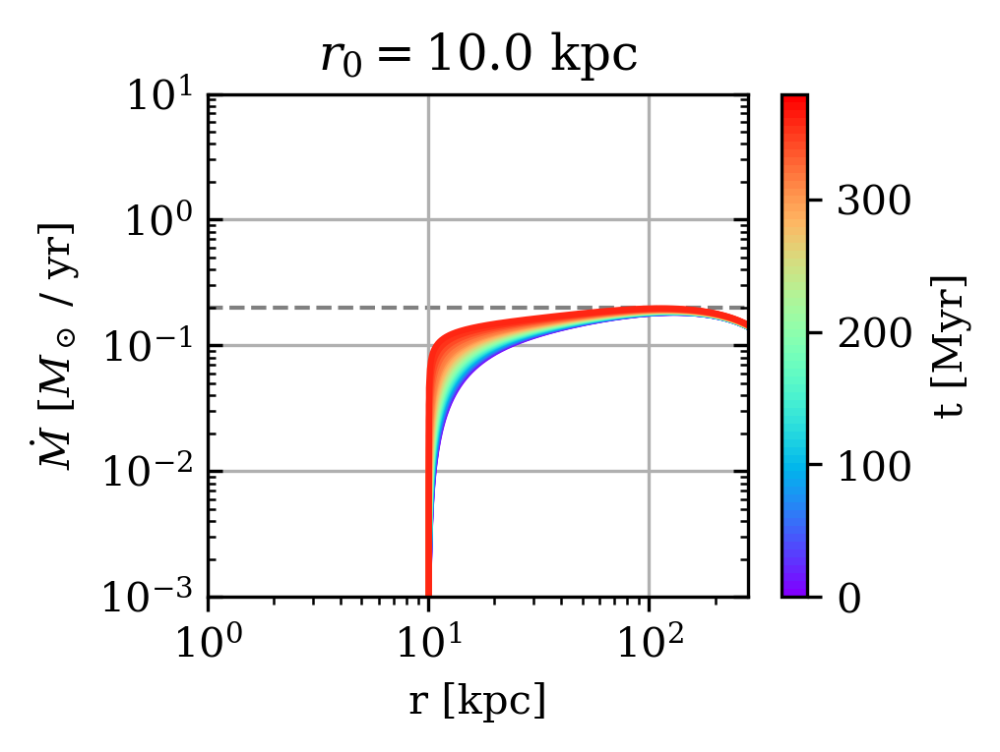

In [699]:
i = 0
for name, result in res_mw.items():
    if 'SD' not in name or 'radius' not in name or 'rescaled' in name:
        continue
    print(name)
#     radius = float(name[-5:])
    radius = float(name[name.find('radius') + len('radius'):])
    selected = mask_result(result, plot_mask=valid_pressures(result))

    if selected[0][-1] < 1:
        print(f"Time too short, skipping {name}")
        continue

    result_mask = (result[0], selected)
    if selected[0][-1] > 100:
        dt = 10
    else:
        dt = 1
    fig, ax = plot_mass_accretion(result_mask, dt=dt)

    ax.axhline(0.2, c='gray', zorder=-1, ls='--', lw='1')
    
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(f"$r_0 = ${radius/1e3} kpc")
    if True:
#         ax.set_yscale('linear')
#         ax.set_xlim(radius/1e3, 282)
        ax.set_xlim(1, 282)
        ax.set_ylim(1e-3, 10)

    ax.grid(True)
    ax.tick_params(axis='y', which='both', direction='in', right=True)
    savefig(fig, name=f"mass-accretion-radius-{name}")

    plt.show()

MW-SD-mb2016-conv


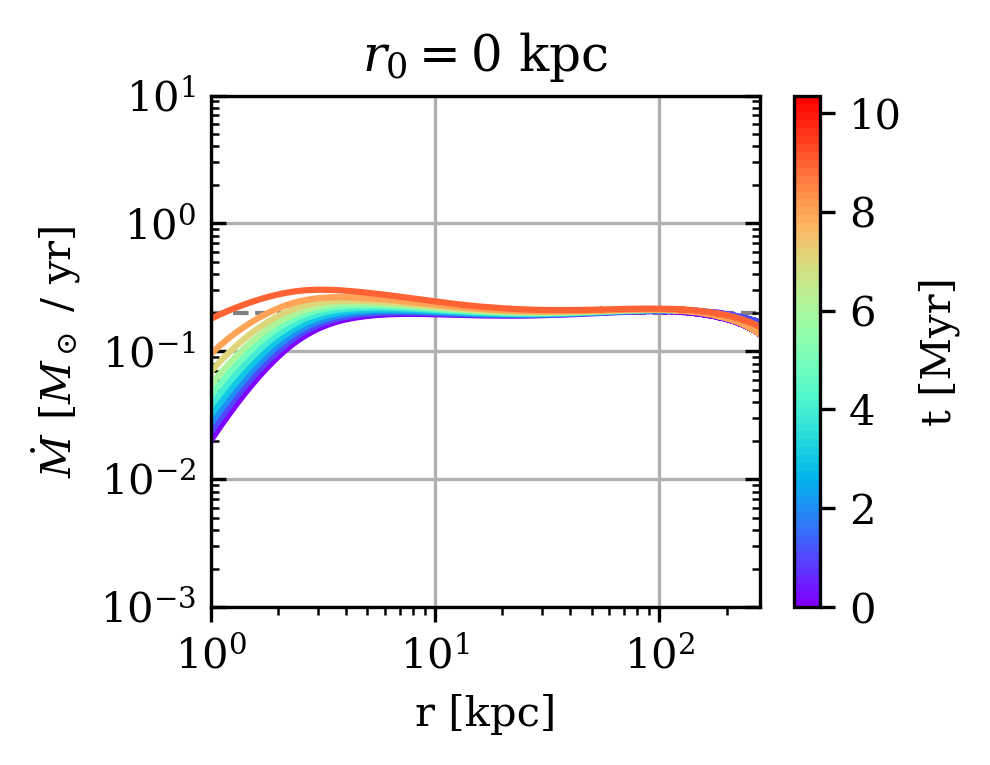

In [700]:
i = 0
for name, result in res_mw.items():
    if 'MW-SD-mb2016-conv' != name: 
#     if 'SD' not in name or 'rescaled' in name:
        continue
    print(name)
#     radius = float(name[-5:])
#     radius = float(name[name.find('radius') + len('radius'):])
    selected = mask_result(result, plot_mask=valid_pressures(result))

    if selected[0][-1] < 1:
        print(f"Time too short, skipping {name}")
        continue

    result_mask = (result[0], selected)
    if selected[0][-1] > 100:
        dt = 10
    else:
        dt = 1
    fig, ax = plot_mass_accretion(result_mask, dt=dt)

    ax.axhline(0.2, c='gray', zorder=-1, ls='--', lw='1')
    
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(f"$r_0 = 0$ kpc")
    if True:
#         ax.set_yscale('linear')
        ax.set_xlim(1, 282)
        ax.set_ylim(1e-3, 10)

    ax.grid(True)
    ax.tick_params(axis='y', which='both', direction='in', right=True)
    savefig(fig, name=f"mass-accretion-radius-original-{name}")

    plt.show()

MW-SD-mb2016-dtlim0.01


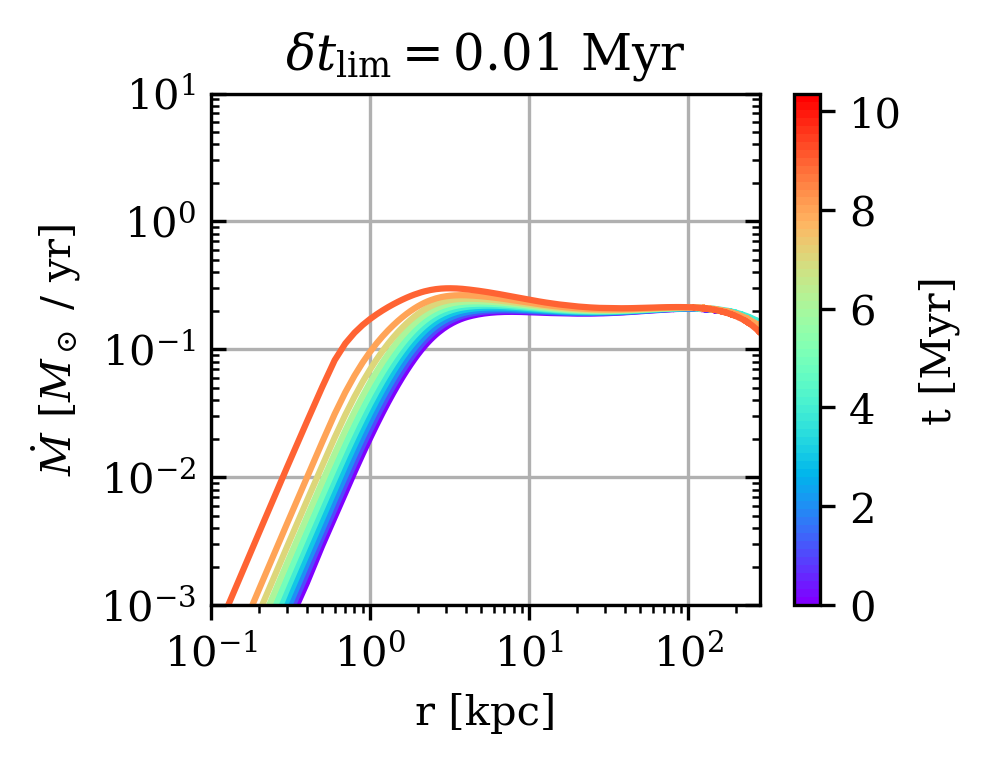

MW-SD-mb2016-dtlim0.001


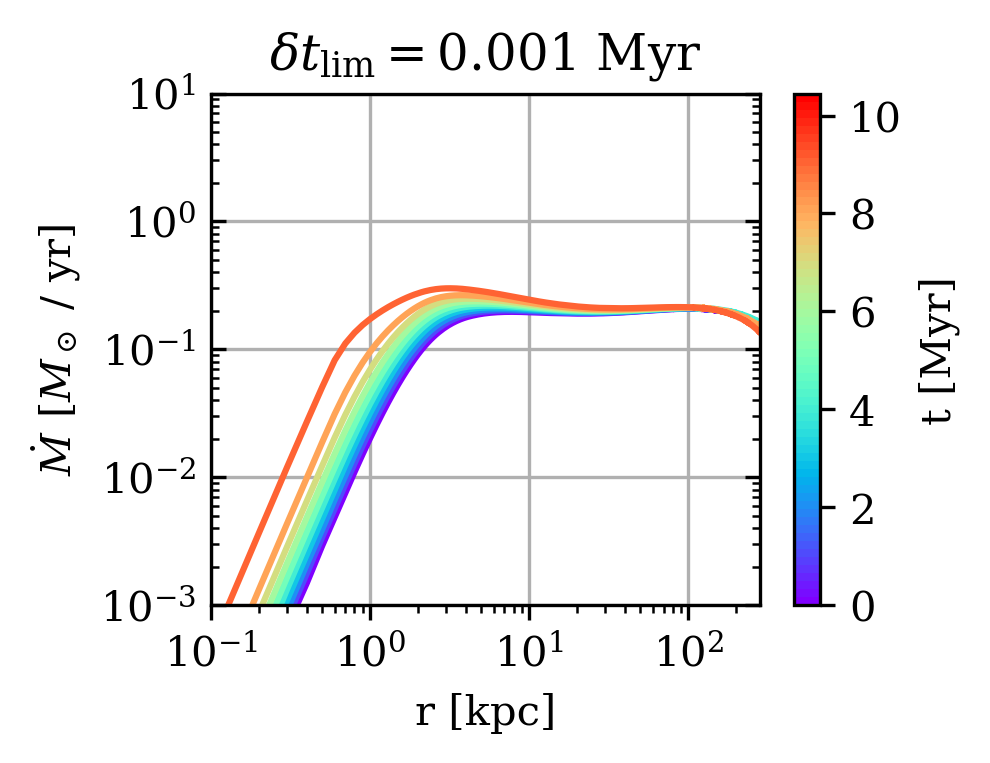

MW-SD-mb2016-dtlim0.0001


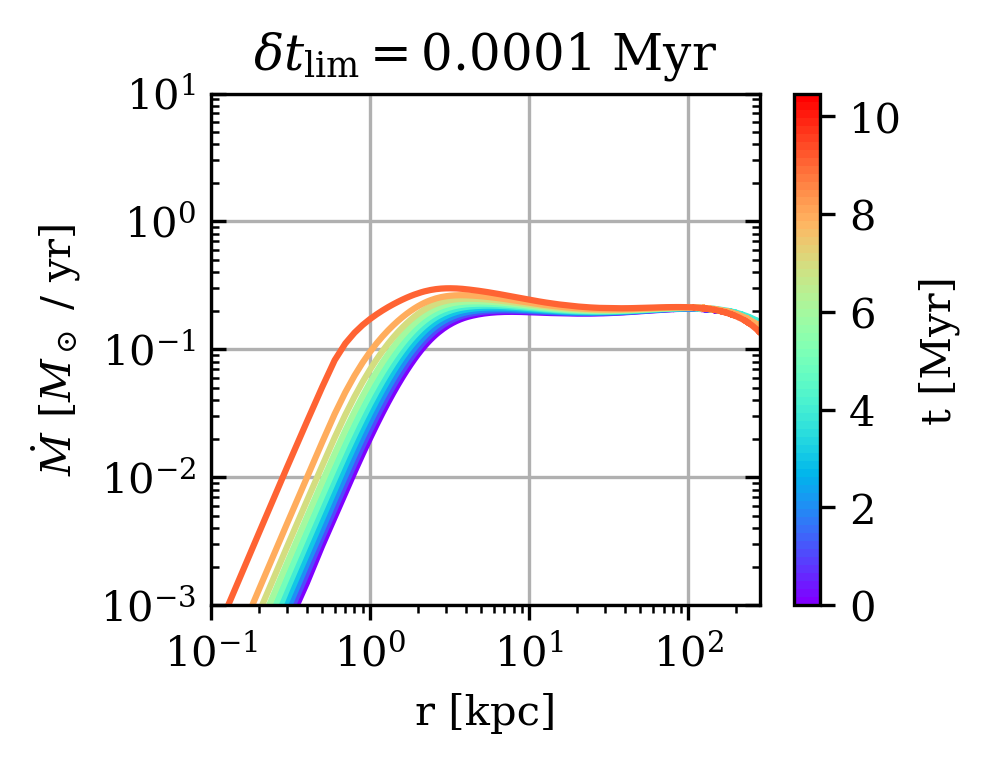

In [701]:
i = 0
for name, result in res_mw.items():
    if 'SD' not in name or 'dtlim' not in name or 'rescaled' in name:
        continue
    print(name)
#     radius = float(name[-5:])
    dtlim = float(name[name.find('dtlim') + len('dtlim'):])
    selected = mask_result(result, plot_mask=valid_pressures(result))

    if selected[0][-1] < 1:
        print(f"Time too short, skipping {name}")
        continue

    result_mask = (result[0], selected)
    if selected[0][-1] > 100:
        dt = 10
    else:
        dt = 1
    fig, ax = plot_mass_accretion(result_mask, dt=dt)

    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(r"$\delta t_{\rm lim} = "+f"{dtlim}$ Myr")
    if True:
#         ax.set_yscale('linear')
        ax.set_xlim(0.1, 282)
        ax.set_ylim(1e-3, 10)

    ax.grid(True)
    ax.tick_params(axis='y', which='both', direction='in', right=True)
    savefig(fig, name=f"mass-accretion-dtlim-{name}")

    plt.show()

In [702]:
i = 0
for name, result in res_mw.items():
#     if 'SD' not in name and 'CLOUDY' not in name:
# #     if name != "MW-CLOUDY-mb2016-conv":
# #     if name != "MW-mb2016-E5e41-S5e3":
#         continue
    
    selected = mask_result(result, plot_mask=valid_pressures(result))
    
    if selected[0][-1] < 1:
        print(f"Time too short, skipping {name}")
        continue
    
    if selected[0][-1] > 100:
        dt = 10.
    else:
        dt = 1.
    result_mask = (result[0], selected)
    fig, ax = plot_mass_accretion(result_mask, dt=dt)
#     annotate(name, (1-0.7, 0.1), ax)
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(titlename)
    if True:
        ax.set_xlim(0.1, 282)
        ax.set_ylim(1e-3, ax.get_ylim()[1])
#         ax.set_ylim(1e-2, 10)
    ax.grid(True)
    ax.tick_params(axis='y', which='both', direction='in', right=True)
    savefig(fig, name=f"mass-accretion-{name}")
#     savefig(fig, name=f"mass-accretion-full-{name}")
    plt.close()
#     plt.show()

Time too short, skipping MW-SD-mb2016rescaled-radius1e3
Time too short, skipping MW-SD-mb2016rescaled-radius10e3
Time too short, skipping MW-mb2016-E5e43-S8e3
Time too short, skipping MW-mb2016rescaled-E5e43-S8e3
Time too short, skipping MW-mb2016-E5e43-S5e3
Time too short, skipping MW-mb2016-E1e43-S5e3
Time too short, skipping MW-mb2016-E5e42-S5e3
Time too short, skipping MW-mb2016rescaled-E5e43-S5e3


#### Specific Accretion plot

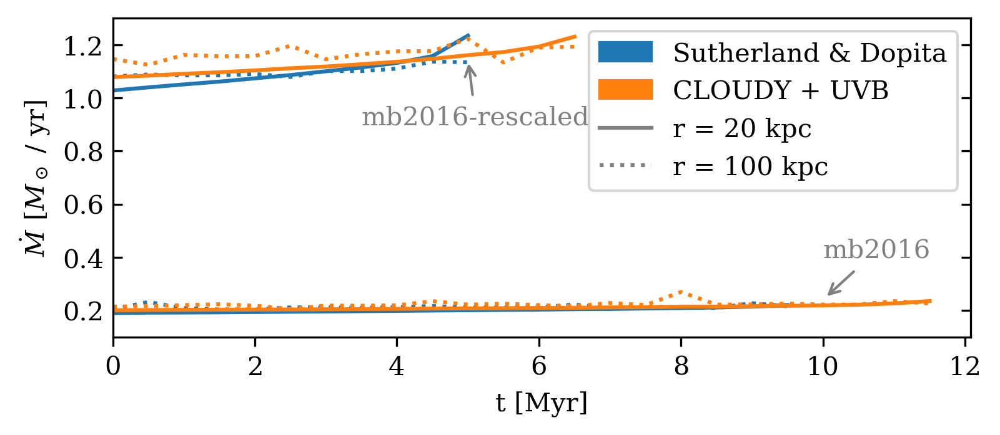

In [703]:
plot_names = [
    "MW-SD-mb2016-conv",
    "MW-SD-mb2016rescaled-conv",
    "MW-CLOUDY-mb2016-conv",
    "MW-CLOUDY-mb2016rescaled-conv",
#     "MW-SD-mb2016",
#     "MW-SD-mb2016rescaled",
#     "MW-CLOUDY-mb2016",
#     "MW-CLOUDY-mb2016rescaled",
]

fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2))
for name in plot_names:
    
    result = res_mw[name]

    selected = mask_result(result, plot_mask=valid_pressures(result, tol=1e-4))
    result = (result[0], selected)
    
    param, (ts, *_) = result
    
    comp_times = select_times(ts, dt=0.5)
    eval_radii = np.array([20e3, 100e3])  #kpc
#     eval_radii = np.array([40e3])#, 100e3])  #kpc
    m_dot, times, radii = compute_mdot_from_result(result,
                                                   plot_times=comp_times,
                                                   eval_radii=eval_radii,
                                                   convert_unit=True)

#     print(times)
    for md, r in zip(m_dot.T, radii):
        c = 'tab:blue' if 'SD' in name else 'tab:orange' 
        ls = ':' if r > 50e3 else '-'
        nm = 'mb2016rescaled' if 'rescaled' in name else 'mb2016'

#         color = mapper.to_rgba(t)
        ax.plot(times, md, ls=ls, c=c, label=f"{nm}")# r = {r / 1e3:.0f} kpc")
#         ax.plot(times, -md, ls=':', c=color)

#     ax.set_yscale('log')
#     ax.set_xscale('log')
ax.set_ylabel('$\dot M$ [$M_\odot$ / yr]')
ax.set_xlabel('t [Myr]')

ax.tick_params(axis='y', which='both', direction='in', right=True)

ax.set_xlim(0)
ax.set_ylim(0.1, 1.3)
    
ax.annotate("mb2016", (10, 0.24), (10, 0.4), c='grey', arrowprops=dict(edgecolor='grey', arrowstyle='->'))
# ax.annotate("mb2016rescaled", (5, 1.1), (6, 0.8), alpha=0.5, arrowprops=dict(alpha=0.5, facecolor='k', arrowstyle='->'))
ax.annotate("mb2016-rescaled", (5, 1.15), (3.5, 0.9), c='grey', arrowprops=dict(edgecolor='grey', arrowstyle='->'))

lines = [
    Patch(color='tab:blue', label='Sutherland & Dopita'),
    Patch(color='tab:orange', label='CLOUDY + UVB'),
    Line2D([0], [0], c='gray', ls='-', label='r = 20 kpc'),
    Line2D([0], [0], c='gray', ls=':', label='r = 100 kpc'),
]
ax.legend(handles=lines)

savefig(fig, f"mass-accretion-time-cloudy-vs-sd")

fig.show()

### Radial Velocity

In [492]:
from scipy.interpolate import PchipInterpolator

from plotting import recreate_plot
from itertools import chain, islice

from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from matplotlib import colormaps


def plot_inflow_velocity(result,
                         machnum=False,
                         plot_stern=True,
                         mask_plot=None,
                         stern_param=None,
                         dt=1.):

    param, (ts, *_) = result
    comp_times  = select_times(ts, dt=dt)
    m_dot, times, radii = compute_mdot_from_result(result, plot_times=comp_times, convert_unit=False)
    
    selected = mask_result(result, mask_plot, comp_times)
    ts, rs, ps, ms, ss, tcs = selected
#     m_dot, times, radii = compute_mdot(ts, rs, ms, param, convert_unit=False)

    pressures = evaluate_quantity_time(ts[:-1], rs[:-1], ps[:-1],
                                       radii=radii)[1].T
    masses = evaluate_quantity_time(ts[:-1], rs[:-1], ms[:-1],
                                    radii=radii)[1].T
    sigmas = evaluate_quantity_time(ts[:-1], rs[:-1], ss[:-1],
                                    radii=radii)[1].T

    fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/2, MPL_STD_HEIGHT/2))

    cmap = colormaps['rainbow'].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)

    for t, p, m, s, md in zip(ts, pressures, masses, sigmas, m_dot):
        # Plot the densities
        rho, n_e, T = compute_quantities(radii, p, m, s, mu=0.62)

        v = md / (4 * np.pi * radii**2 * rho) * cst.C6

        color = mapper.to_rgba(t)

        pos = v > 0
        if machnum:
            # const-T sound speed ?
            sound_speed = np.sqrt(T / 0.62) * cst.C7
            ax.plot(radii / 1e3, v / sound_speed, c=color)
            ax.plot(radii / 1e3, -v / sound_speed, c=color, ls='--')
            ax.set_ylabel(r'$|v_{\rm r}| \,/\, c_{\rm s}$')
        else:
            ax.plot(radii / 1e3, v, c=color)
            ax.plot(radii / 1e3, -v, c=color, ls='--')
            ax.set_ylabel(r'$-v_{\rm r}$ [km / s]')


#         ax.plot(radii / 1e3, M_dot, c=color)
        ax.set_yscale('log')
        ax.set_xscale('log')
        ax.set_xlabel('r [kpc]')

    # TODO: put better parameters for stern quantities, maybe motivated
    # by initial density & cooling values?
#     if plot_stern:
#         r0 = radii
#         stern_params = {'M12': 1.3, 'dotM_1': 2.0, 'cool_22': 0.6}
#         if stern_param is not None:
#             stern_params.update(stern_param)
#         for dotM_1 in 
#         v_c, n_H, t_cool, v_r, mach, Rsonic = stern2019_quantities( r0 / 1e3, **stern_params)
#         if machnum:
#             ax.plot(r0 / 1e3, mach, c='k', ls='-.')
#         else:
#             ax.plot(r0 / 1e3, -v_r, c='k', ls='-.')
#         ax.axvline(Rsonic, ls='-.', c='k', label='R_sonic Stern 2019')

    colbar = fig.colorbar(ax=ax, mappable=mapper)
    colbar.set_label('t [Myr]')
    return fig, ax

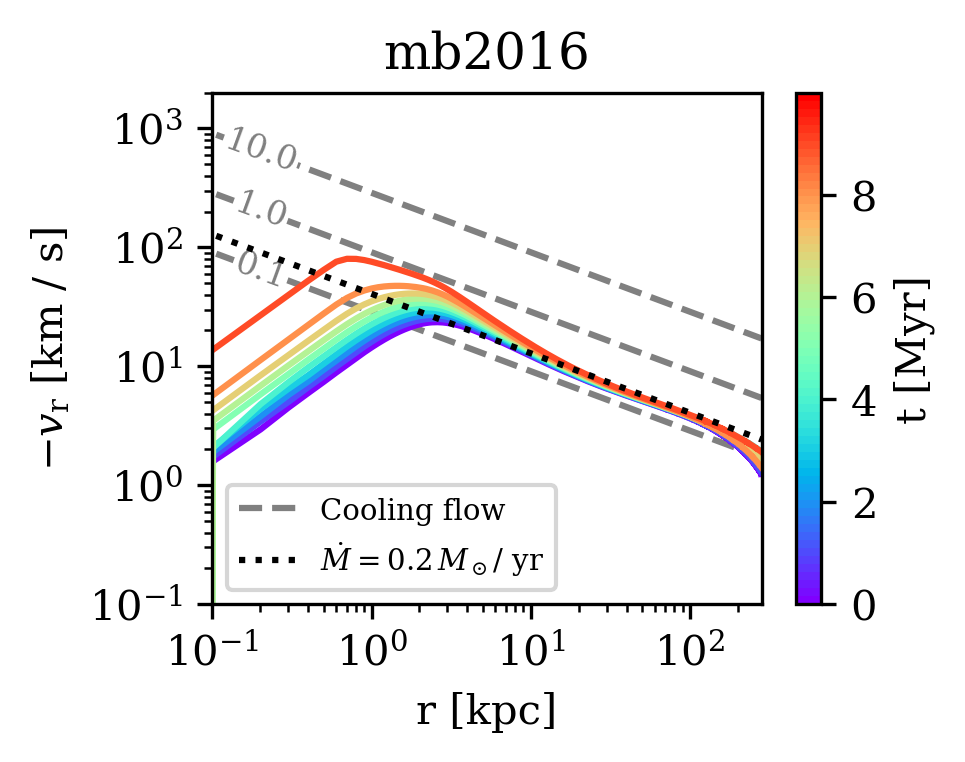

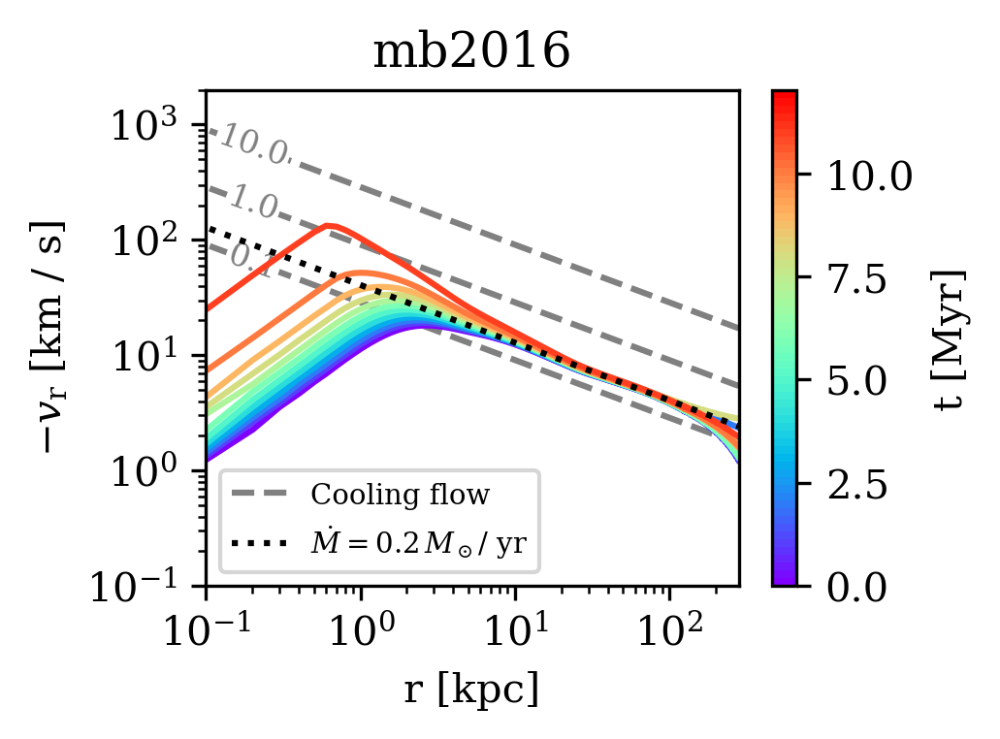

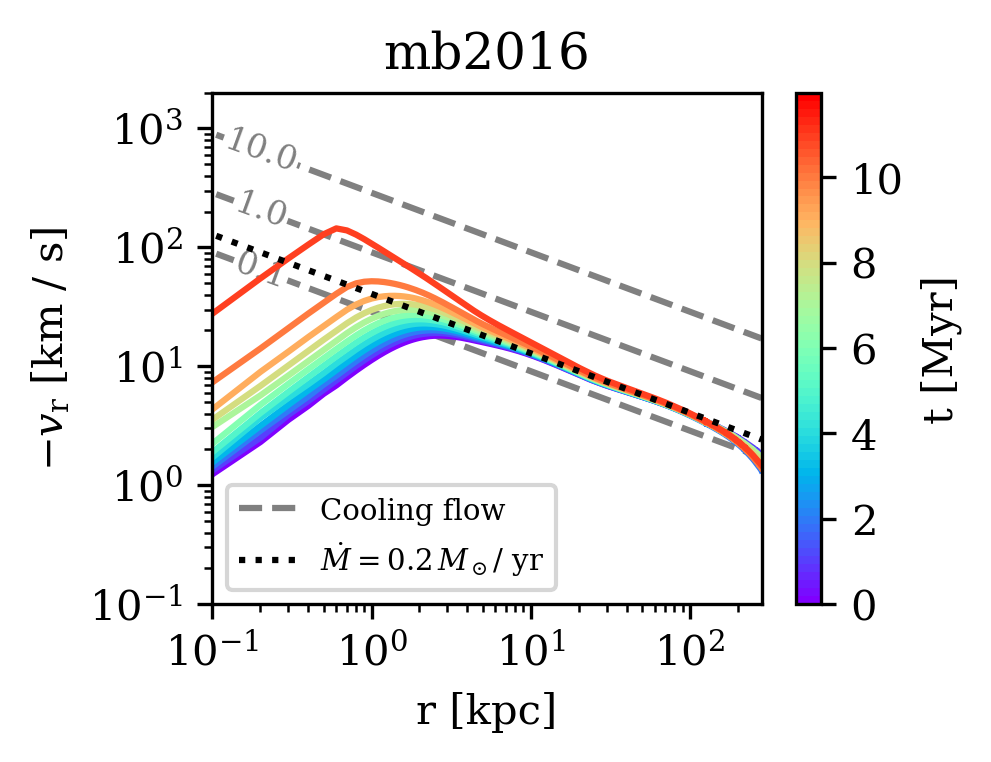

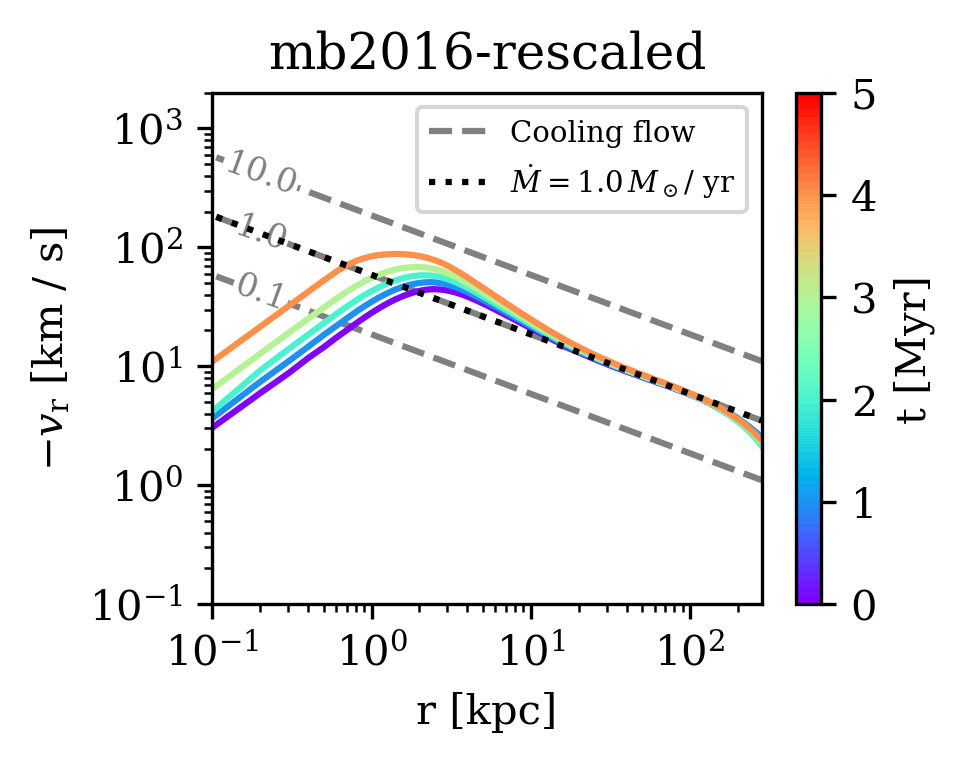

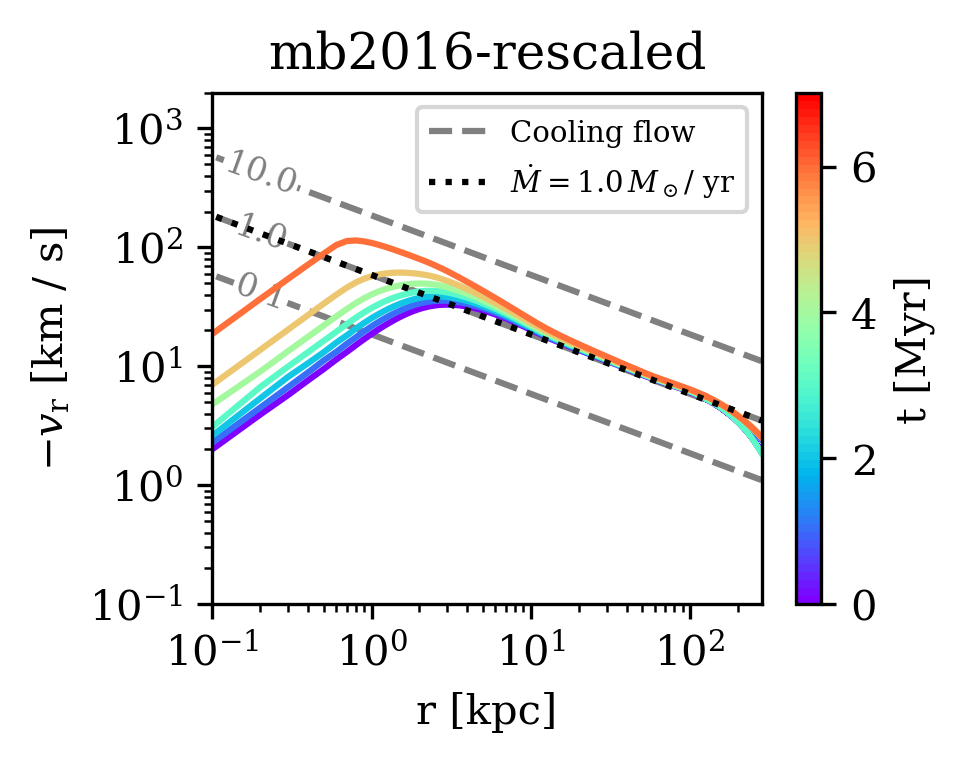

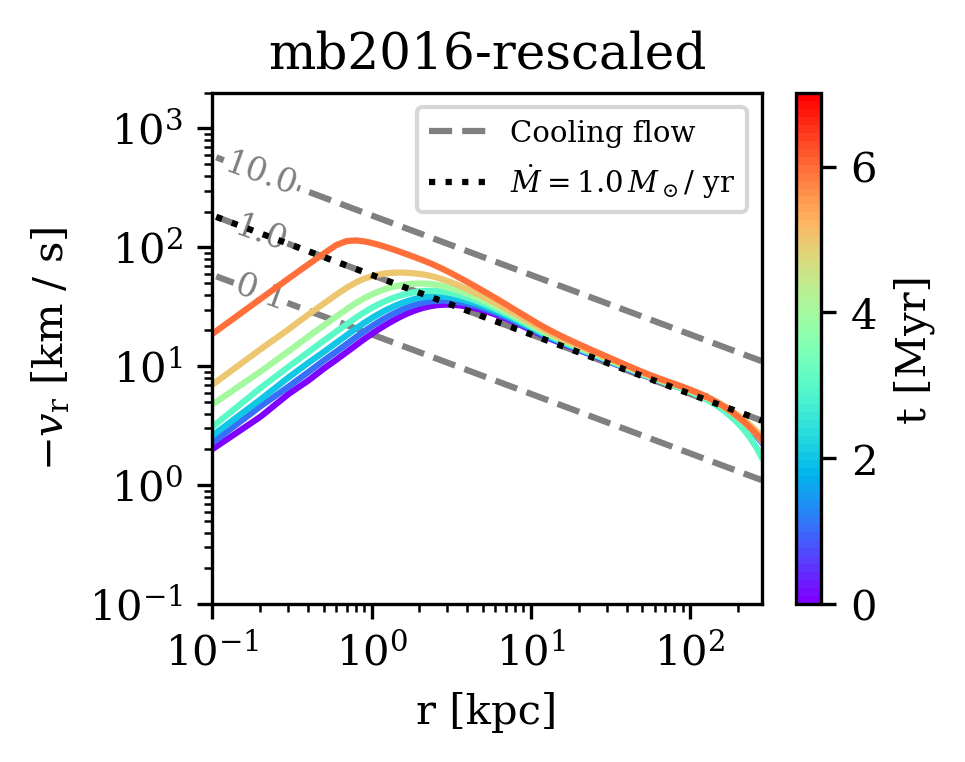

In [704]:
machnum = False
for name, result in res_mw.items():
    if not ("SD" in name or "CLOUDY" in name):
        continue
    if not "conv" in name:
        continue

    param, _ = result
    
    selected = mask_result(result, plot_mask=valid_pressures(result, tol=1e-4))
    result = (result[0], selected)
    

    fig, ax = plot_inflow_velocity(result, machnum=machnum)
    if True:
        r0 = np.arange(1, param.R_out, 100)
        if 'rescaled' in name:
            cool_22 = 0.25
            match_dotM_1 = 1.0
        else:
            cool_22 = 0.6
            match_dotM_1 = 0.2

        for dotM_1 in [0.1, 1, 10]:
#             v_c, n_H, t_cool, v_r, mach, Rsonic = stern2019_quantities(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
            rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
            if machnum:
                line, = ax.plot(r0 / 1e3, mach, c='gray', ls='--', zorder=-10)
            else:
                line, = ax.plot(r0 / 1e3, -v_r, c='gray', ls='--', zorder=-10)
                
            x = line.get_xdata()[2]
            y = line.get_ydata()[2]
            ax.text(x, y, f"{dotM_1:.1f}", zorder=-9, ha='center', va='center', c='gray', size=8, rotation=-20, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})

        rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=match_dotM_1, cool_22=cool_22)
        ax.plot(r0 / 1e3, -v_r, c='k', ls=':')

    ax.set_xlim(1e-1, param.R_out / 1e3)
    ax.set_ylim(1e-1, 2e3)
    
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(titlename)

    handles = [
        Line2D([0], [0], ls="--", c='grey', label='Cooling flow'),
        Line2D([0], [0], ls=":", c='k', label=f'$\dot M = {match_dotM_1}\,M_\odot$/ yr'),
    ]
    ax.legend(handles=handles, fontsize=7)
    
    savefig(fig, name=f"radial-velocity-{name}")
    plt.show()

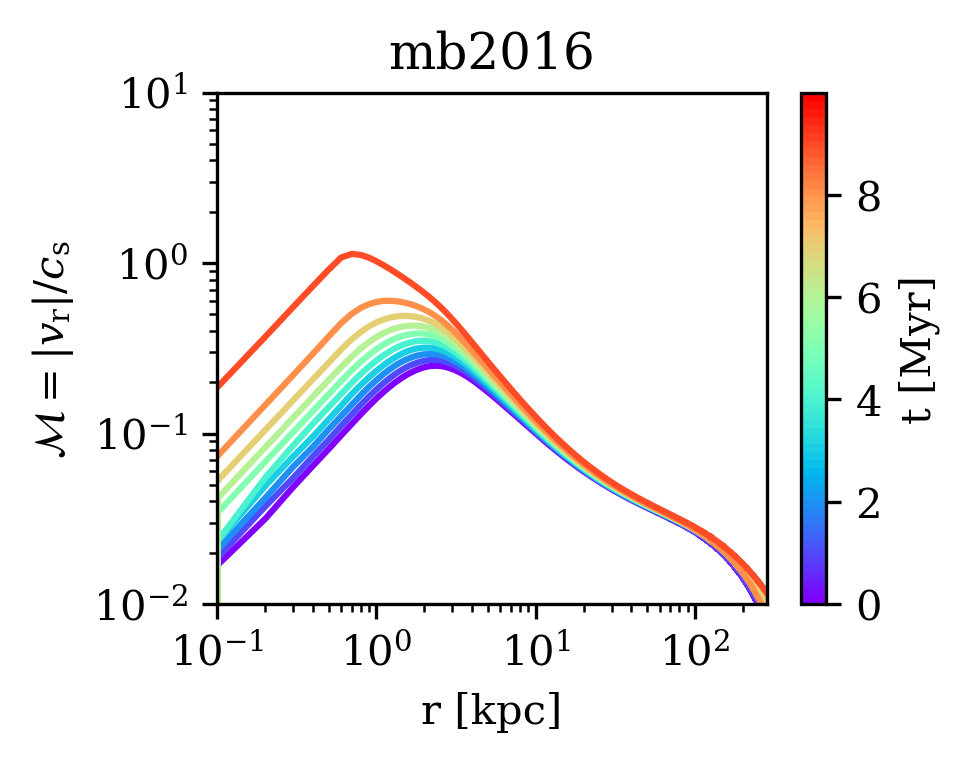

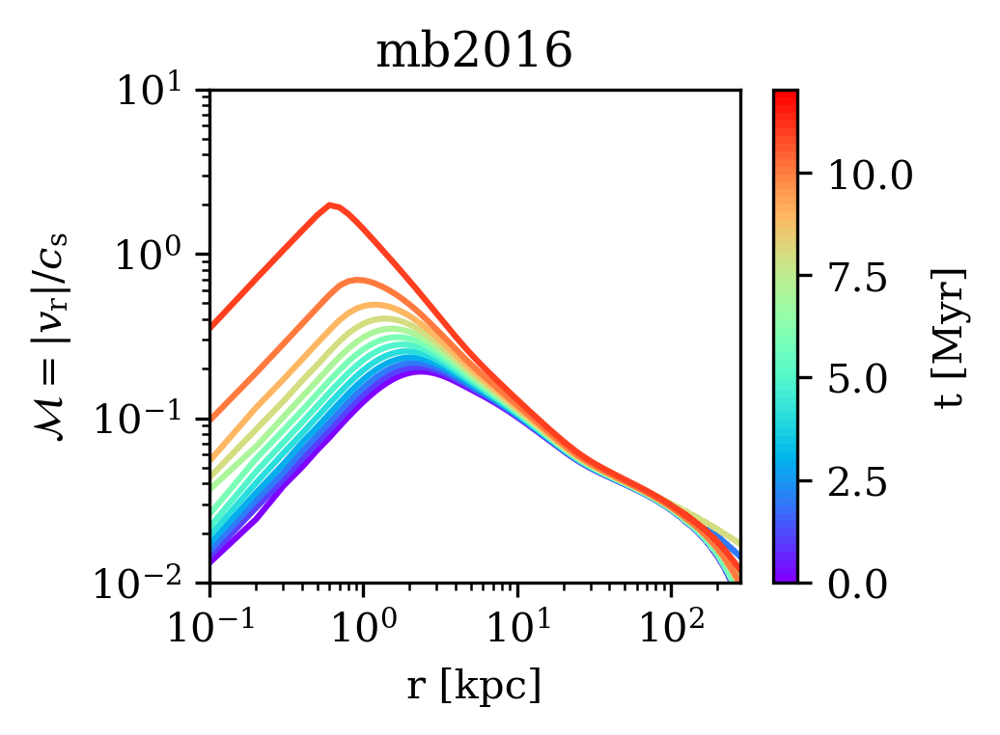

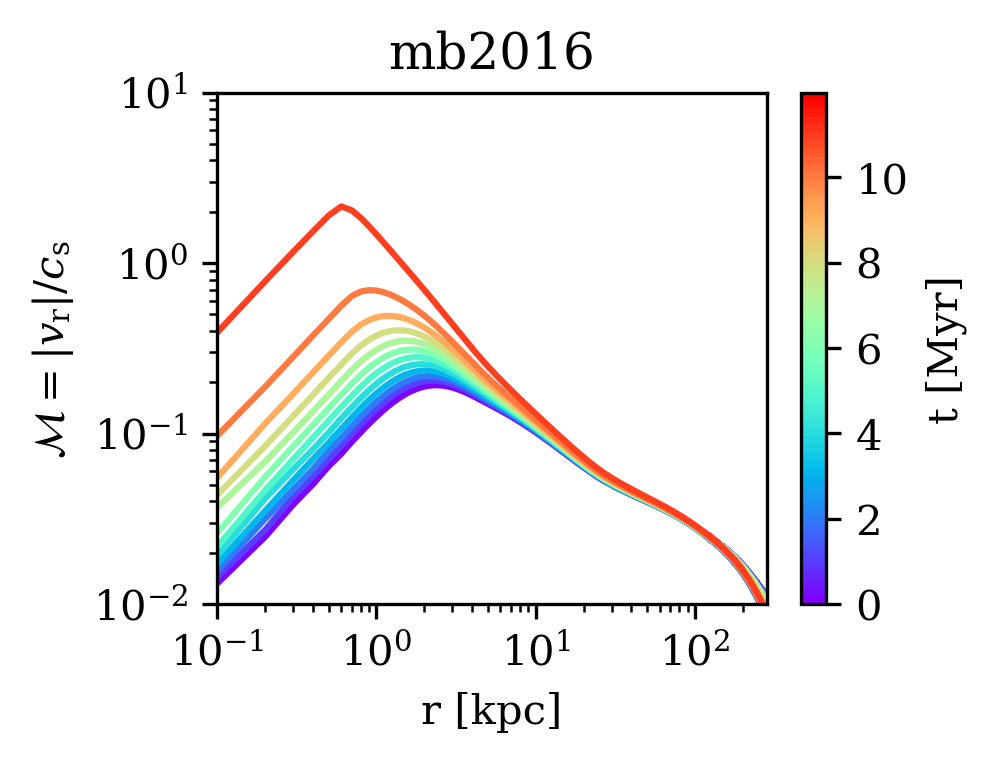

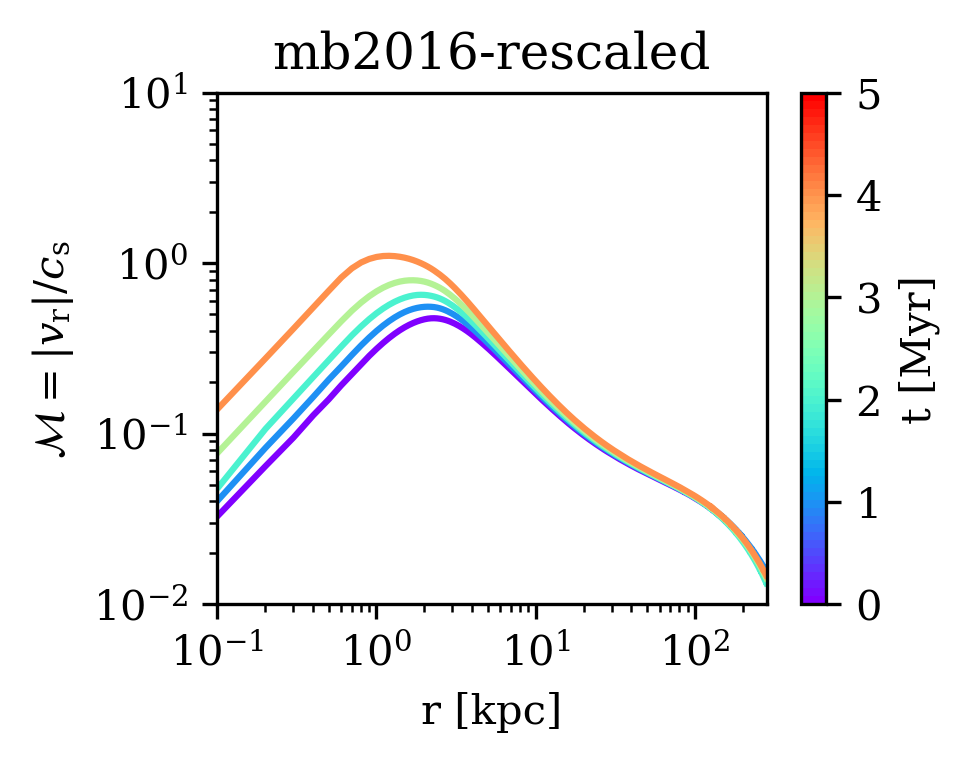

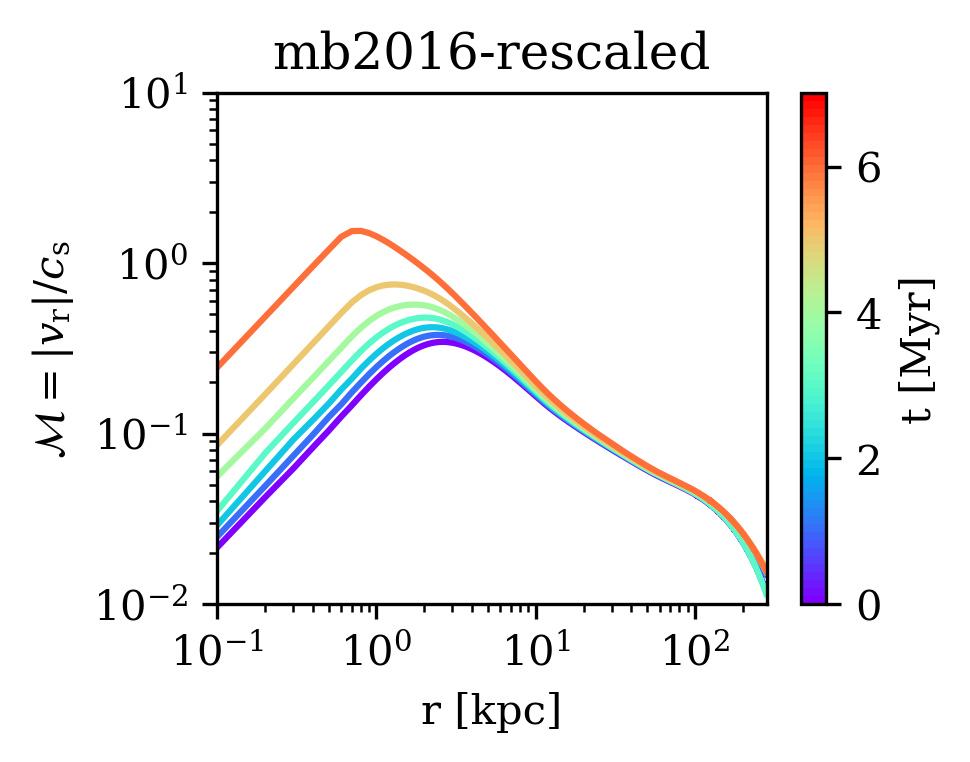

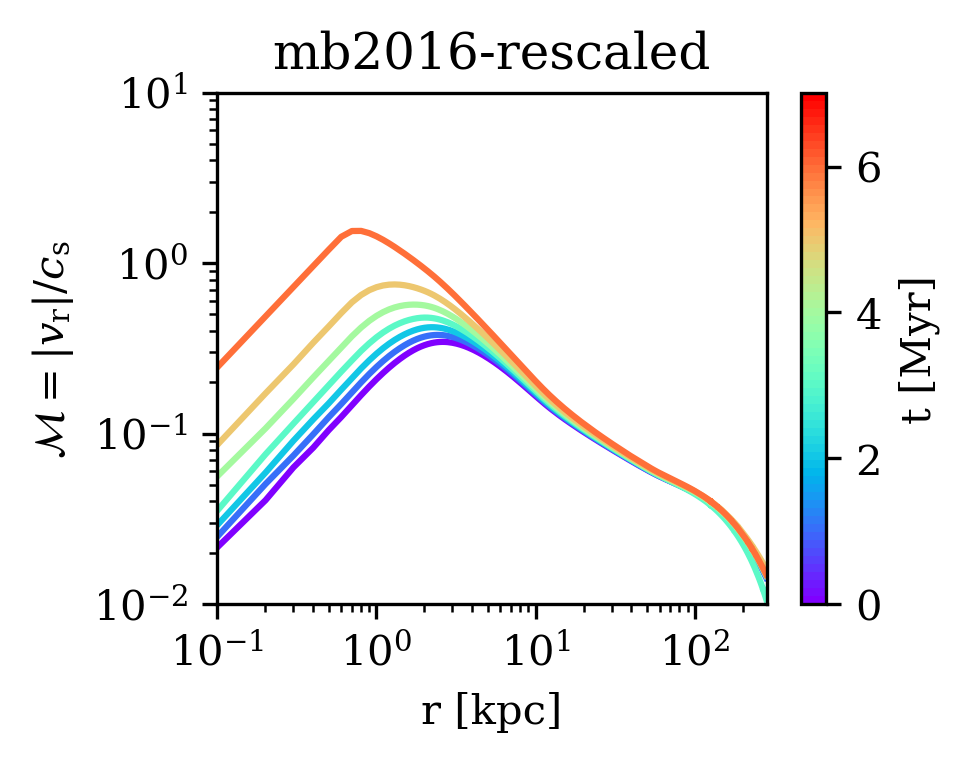

In [705]:
for name, result in res_mw.items():
    if not ("SD" in name or "CLOUDY" in name):
        continue
    if not "conv" in name:
        continue

    param, _ = result
    
    selected = mask_result(result, plot_mask=valid_pressures(result, tol=1e-4))
    result = (result[0], selected)
    
    fig, ax = plot_inflow_velocity(result, machnum=True)
    if False:
        r0 = np.arange(1, param.R_out, 100)
        if 'rescaled' in name:
            cool_22 = 0.25
            match_dotM_1 = 1.0
        else:
            cool_22 = 0.6
            match_dotM_1 = 0.2

        for dotM_1 in [0.1, 1, 10]:
#             v_c, n_H, t_cool, v_r, mach, Rsonic = stern2019_quantities(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
            rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=dotM_1, cool_22=cool_22)
            if machnum:
                line, = ax.plot(r0 / 1e3, mach, c='gray', ls='-.', zorder=-10)
            else:
                line, = ax.plot(r0 / 1e3, -v_r, c='gray', ls='-.', zorder=-10)
                
            x = line.get_xdata()[2]
            y = line.get_ydata()[2]
            ax.text(x, y, f"{dotM_1:.1f}", zorder=-9, ha='center', va='center', c='gray', size=8, rotation=-20, bbox={'boxstyle': 'square,pad=0', 'fc':'white', 'ec':'white'})

        rho, v_r, T, mach, Rsonic = stern2019_quantities_new(r0 / 1e3, M12=1.3, dotM_1=match_dotM_1, cool_22=cool_22)
        ax.plot(r0 / 1e3, -v_r, c='k', ls=':')

    ax.set_xlim(1e-1, param.R_out / 1e3)
    ax.set_ylim(1e-2, 10)
    ax.set_ylabel(r'$\mathcal{M} = |v_{\rm r}| / c_{\rm s}$')
    
    if 'rescaled' in name:
        titlename = 'mb2016-rescaled'
    else:
        titlename = 'mb2016'
    ax.set_title(titlename)

    
    savefig(fig, name=f"sound-speed-{name}")
    plt.show()

### Cooling time

In [495]:
# Alternative method of calculating tcool:
from itertools import chain, islice

from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from matplotlib.lines import Line2D
from matplotlib import colormaps

def plot_cooling_time(result, plot_mask=None, plot_times=None):
    mw_param, (ts, rs, ps, ms, ss, tcs) = result

    if plot_mask is not None:
        selected = [q[plot_mask] for q in result[1]]
    elif plot_times is not None:
        t = result[1][0]
        plot_mask = index_closest(t, plot_times)
        selected = [[qi for qi, m in zip(quantity, plot_mask) if m]
                    for quantity in result[1]]
        selected[0] = t[plot_mask]
    else:
        selected = result[1]
        
    t_selected = selected[0]

    fig, ax = plt.subplots(1, 1)

    cmap = colormaps['rainbow'].resampled(64)
    norm = Normalize(vmin=ts.min(), vmax=ts.max())
    mapper = ScalarMappable(norm=norm, cmap=cmap)

    for i, (t, r, p, m, s, tc) in islice(enumerate(zip(*selected)), 0, len(selected[0])-1):
        t_cool = tc

        color = mapper.to_rgba(t)

        positive = t_cool > 0
        ax.plot(r / 1e3, t_cool, c=color)
        ax.plot(r / 1e3, -t_cool, c=color, ls='--')
        ax.set_yscale('log')
        ax.set_xscale('log')
        ax.set_ylabel(r'$t_\epsilon$ [Myr]')
        ax.set_xlabel('r [kpc]')

    cbar = fig.colorbar(ax=ax, mappable=mapper)
    cbar.ax.set_ylabel('t [Myr]')
    
    ax.axhline(13.6e3, ls=':', c='k', label="Hubble Time (13.6 Gyr)")
    ax.axhline(0.1, ls='-.', c='k', label="Lower Limit")
    
    pos_neg_lines = [
        Line2D([0], [0], color='gray', label=r'$t_\epsilon > 0$ Cooling'),
        Line2D([0], [0], color='gray', ls='--', label=r'$t_\epsilon < 0$ Heating'),
        Line2D([0], [0], color='k', ls=':', label="Hubble Time (13.6 Gyr)"),
        Line2D([0], [0], color='k', ls='-.', label="Lower Limit"),
    ]
    ax.legend(handles=pos_neg_lines)

    return fig, ax

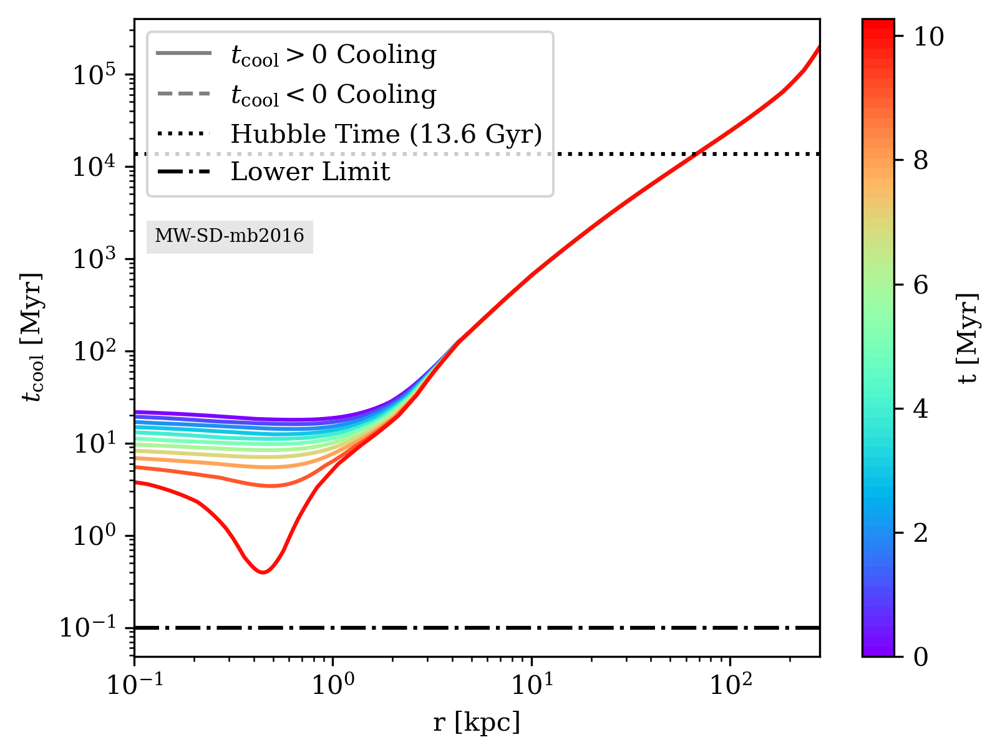

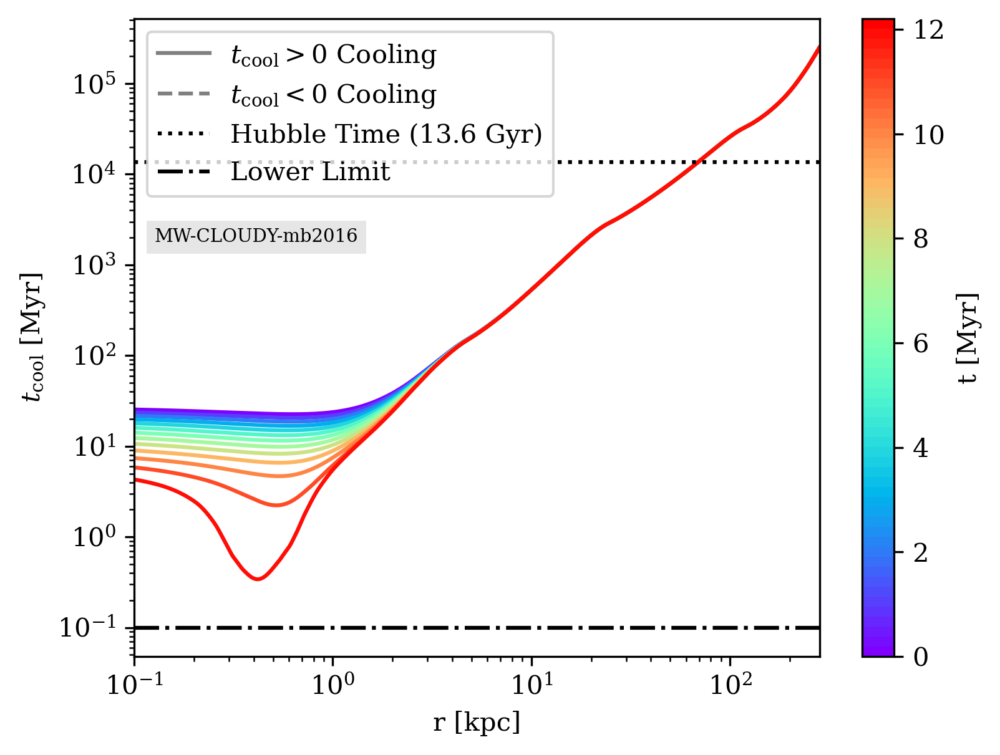

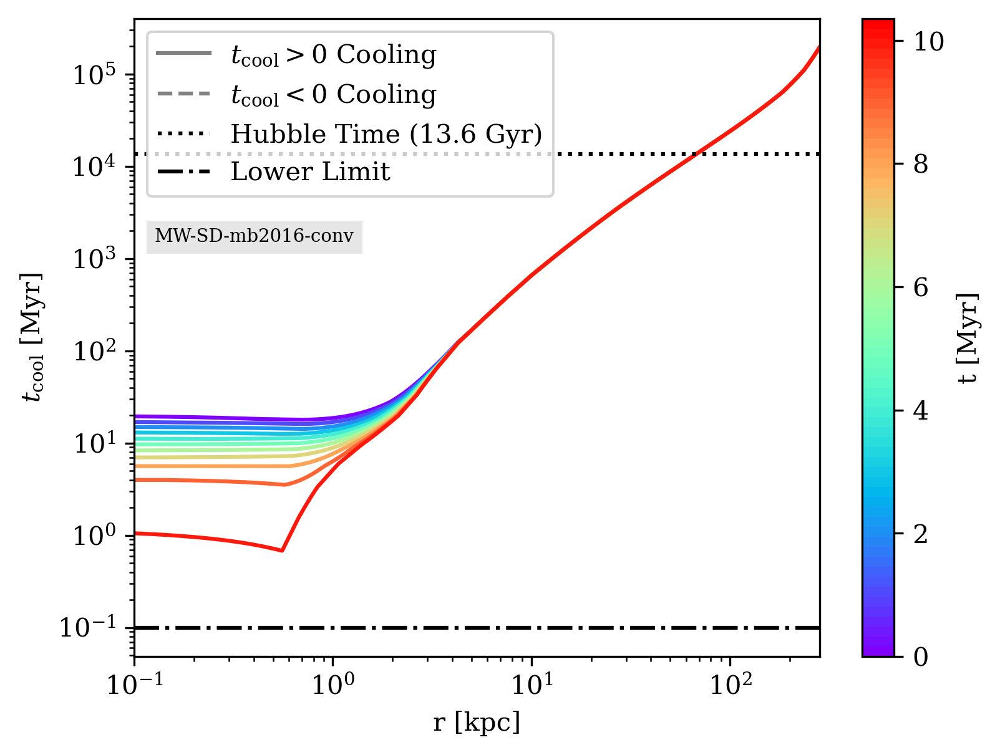

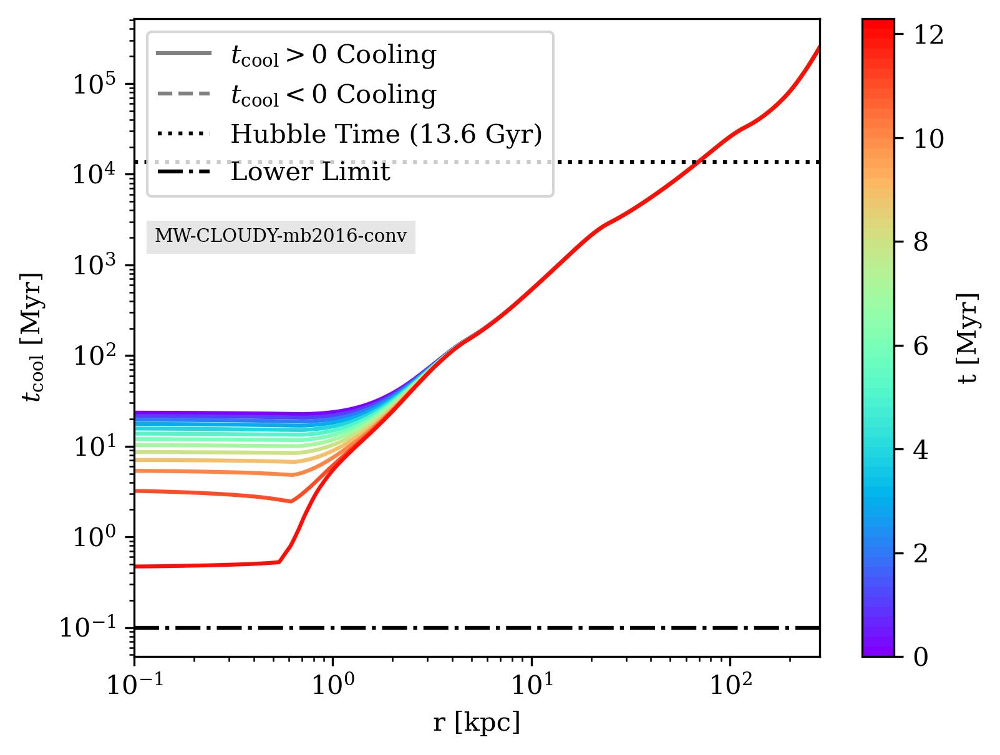

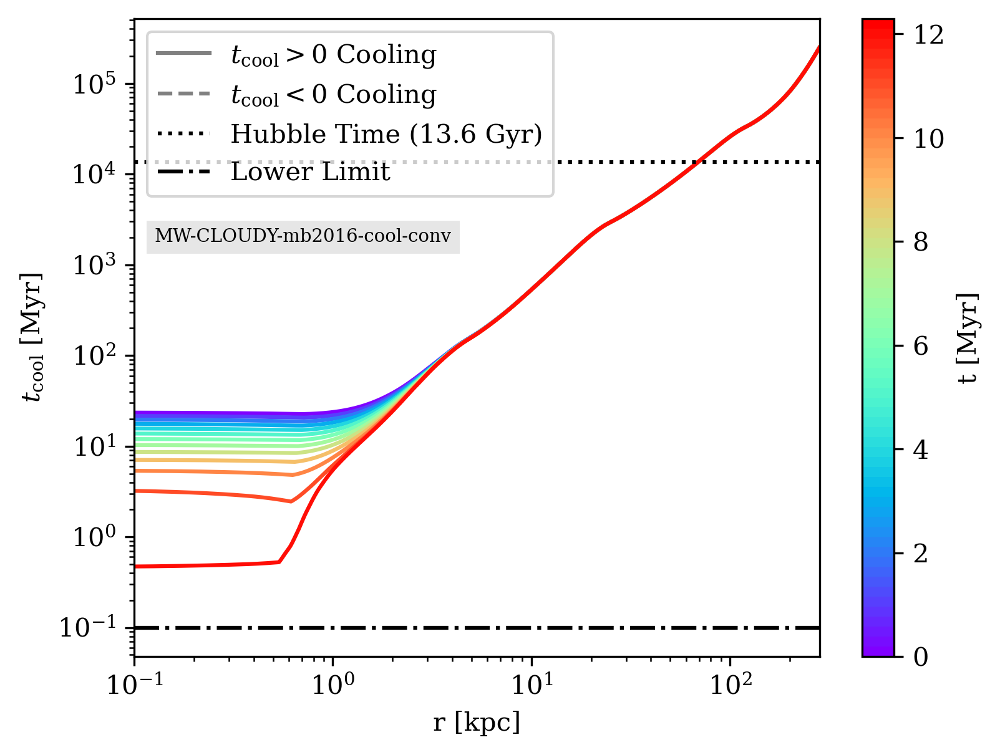

...

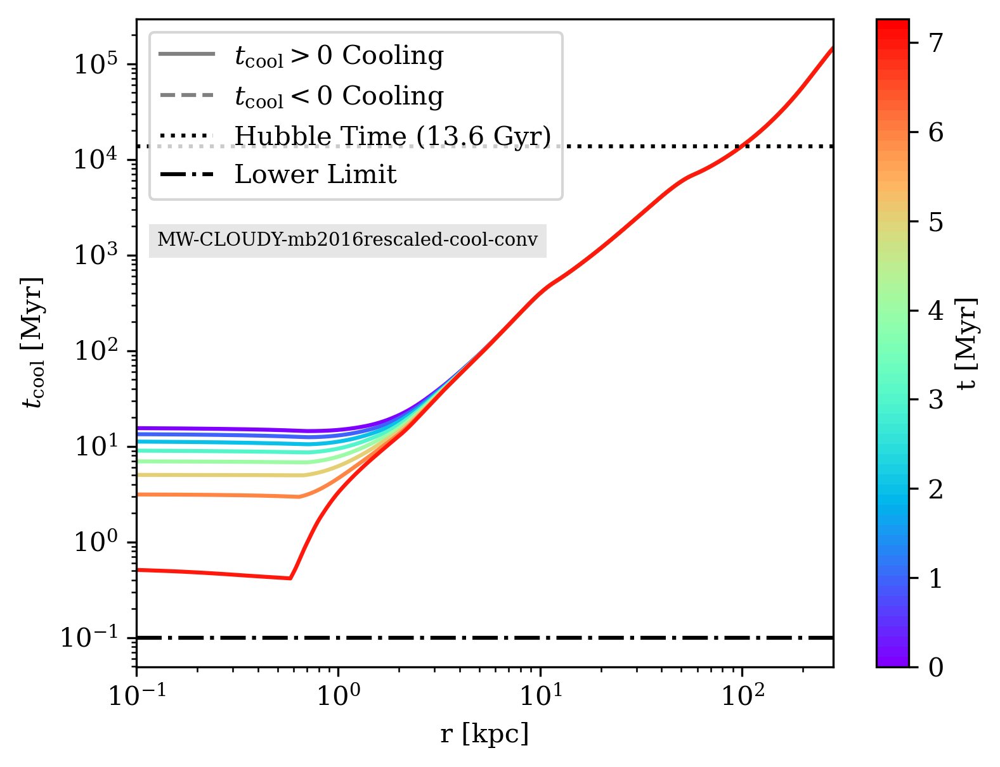

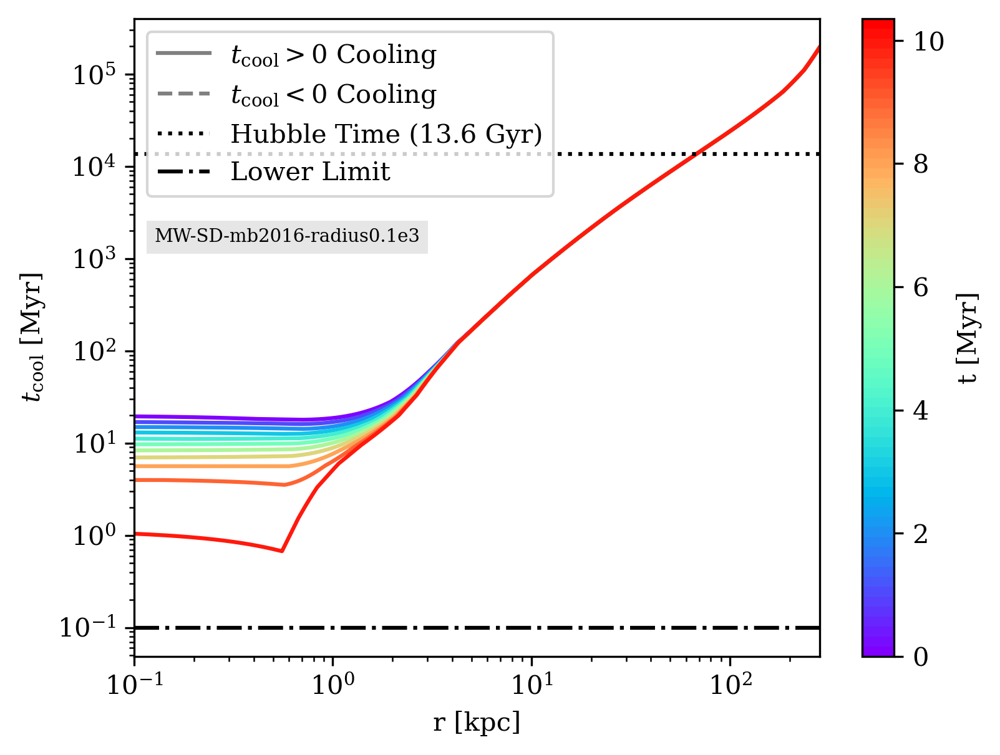

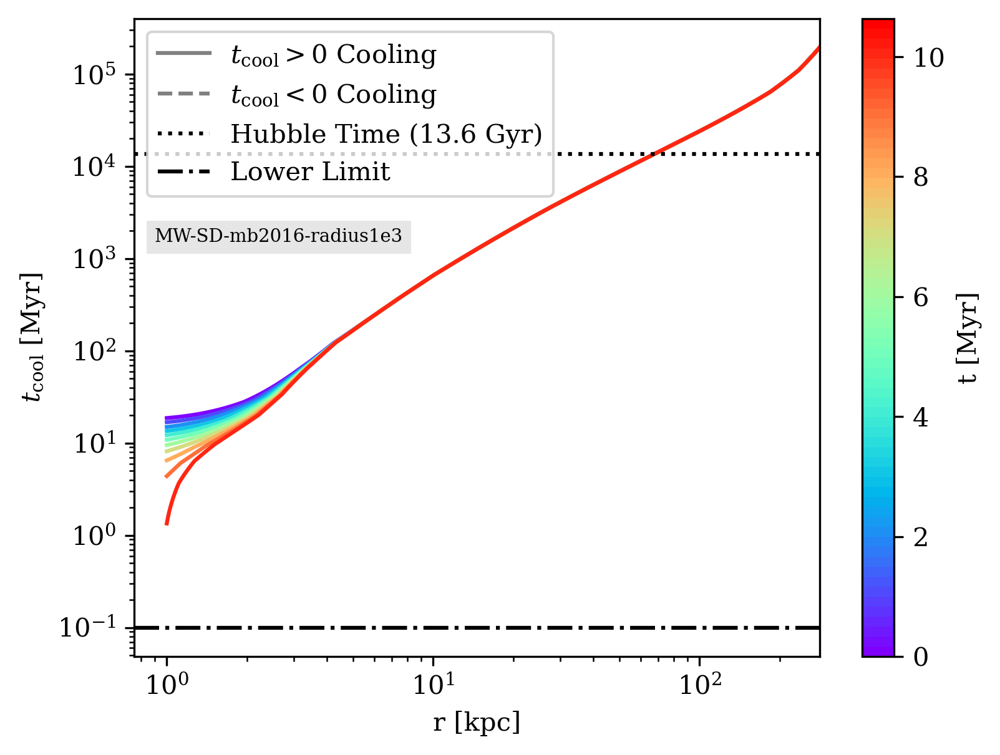

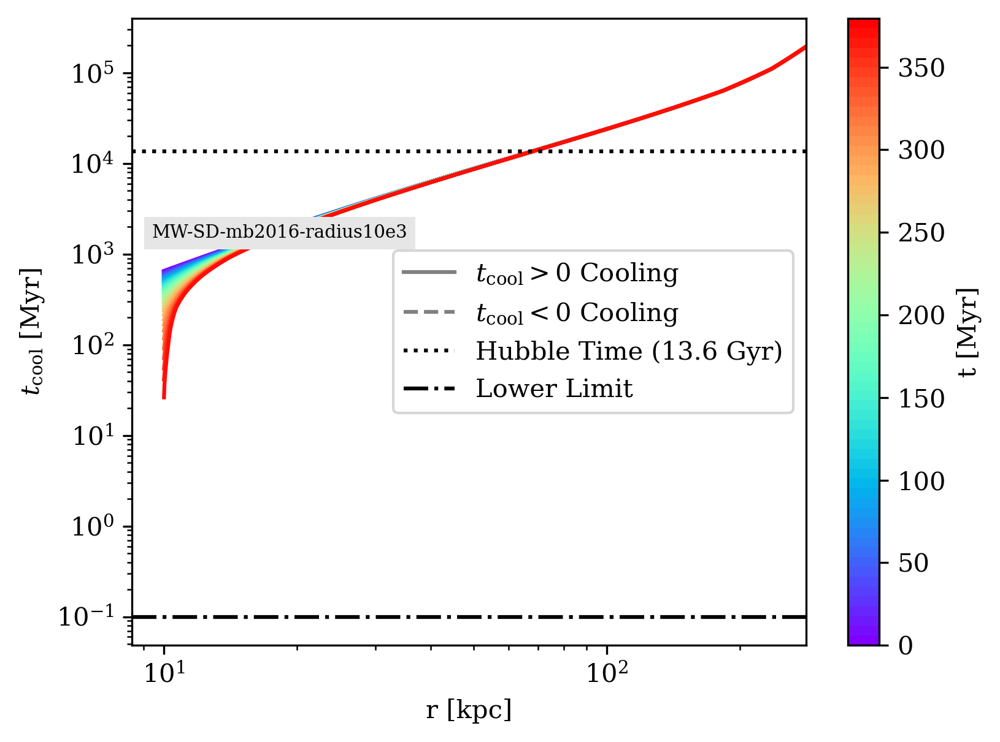

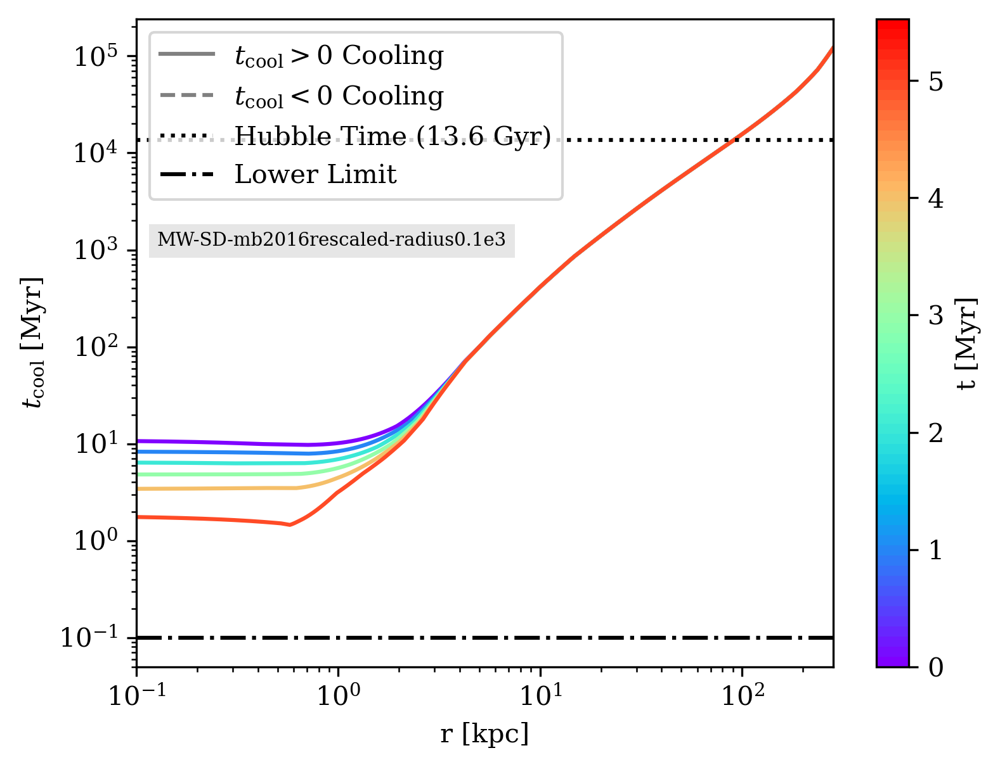

Time evolution too short (< 1 Myr) skipping MW-SD-mb2016rescaled-radius1e3
Time evolution too short (< 1 Myr) skipping MW-SD-mb2016rescaled-radius10e3


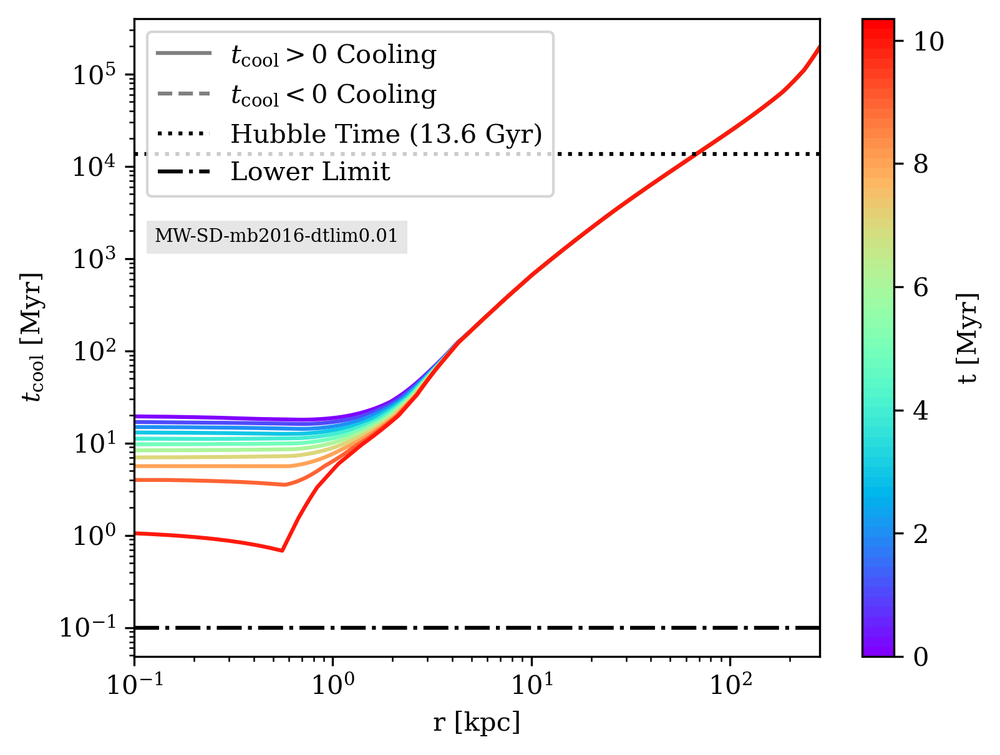

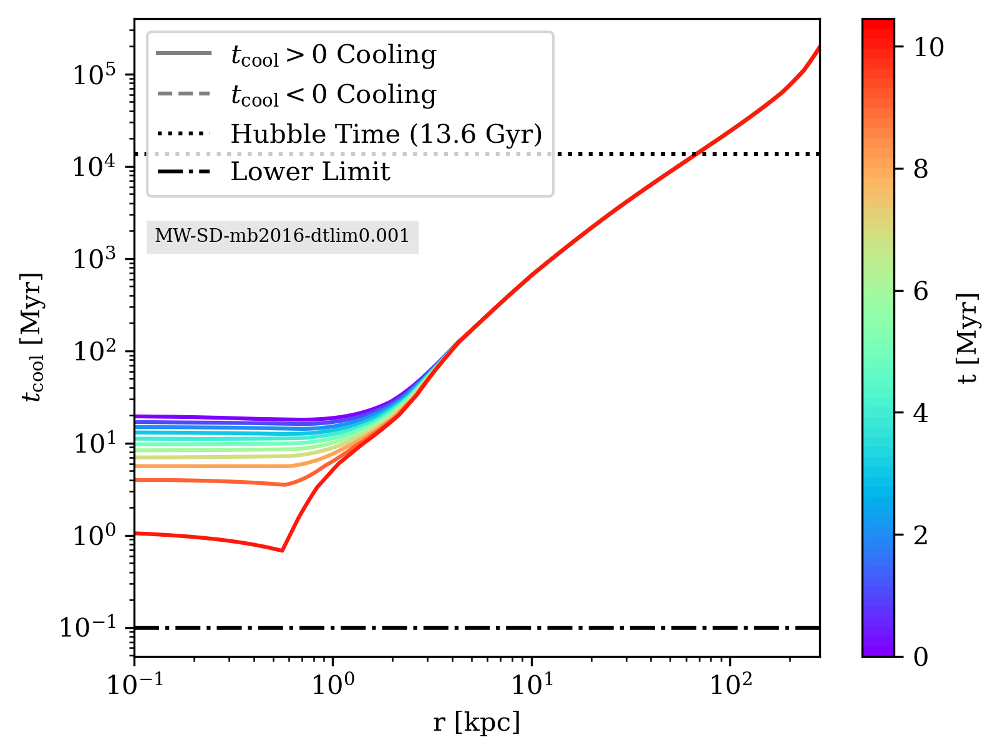

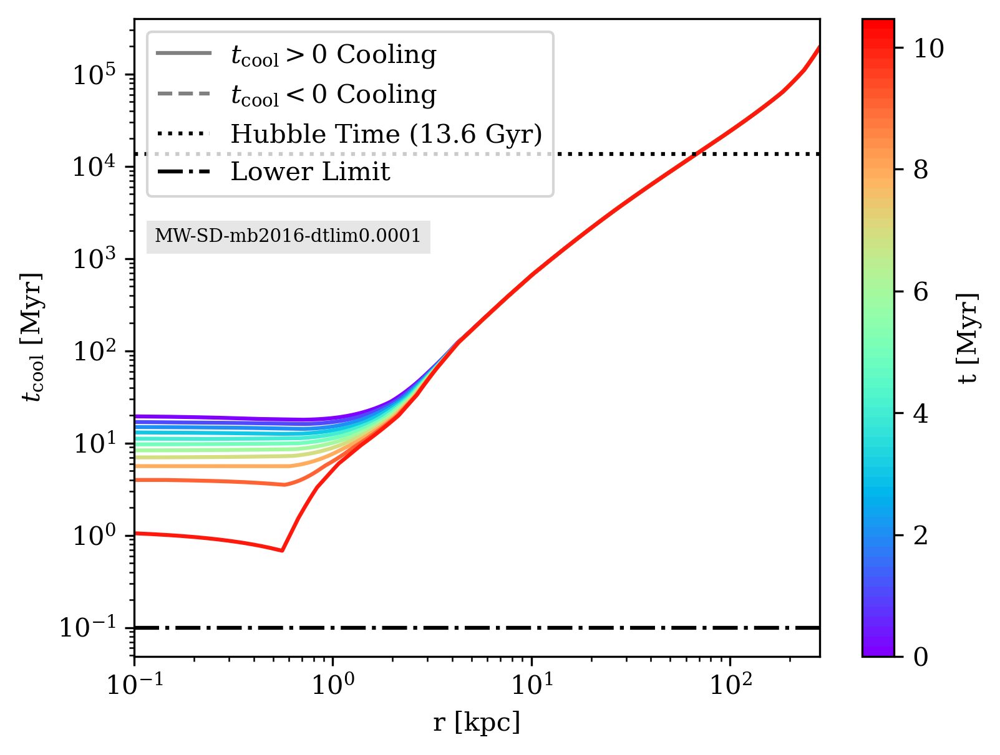

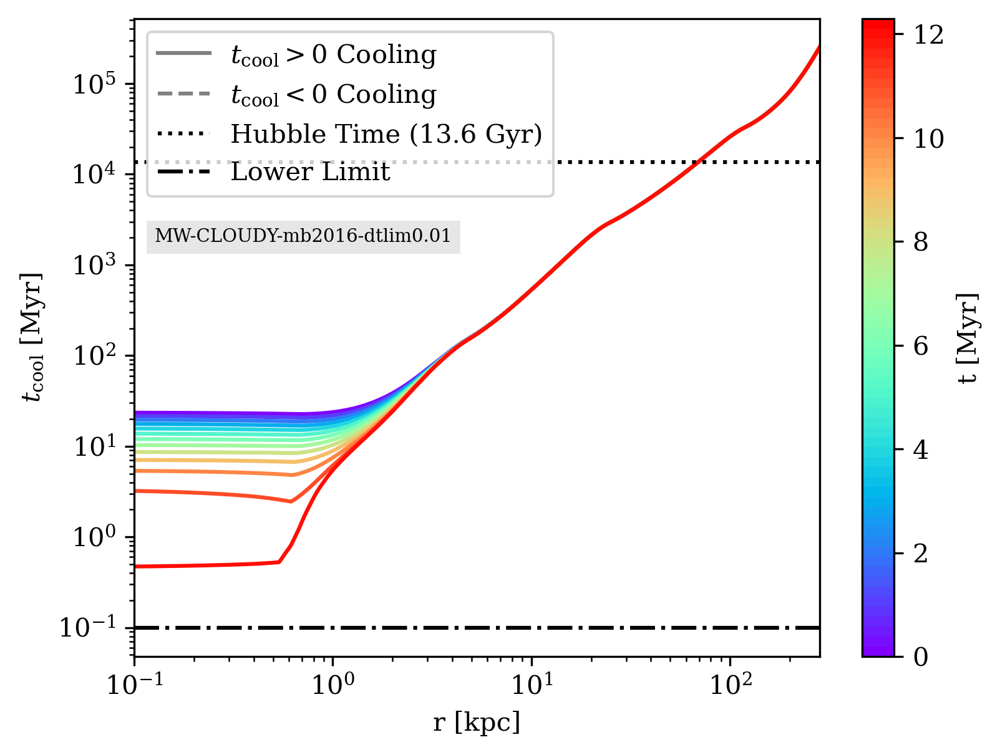

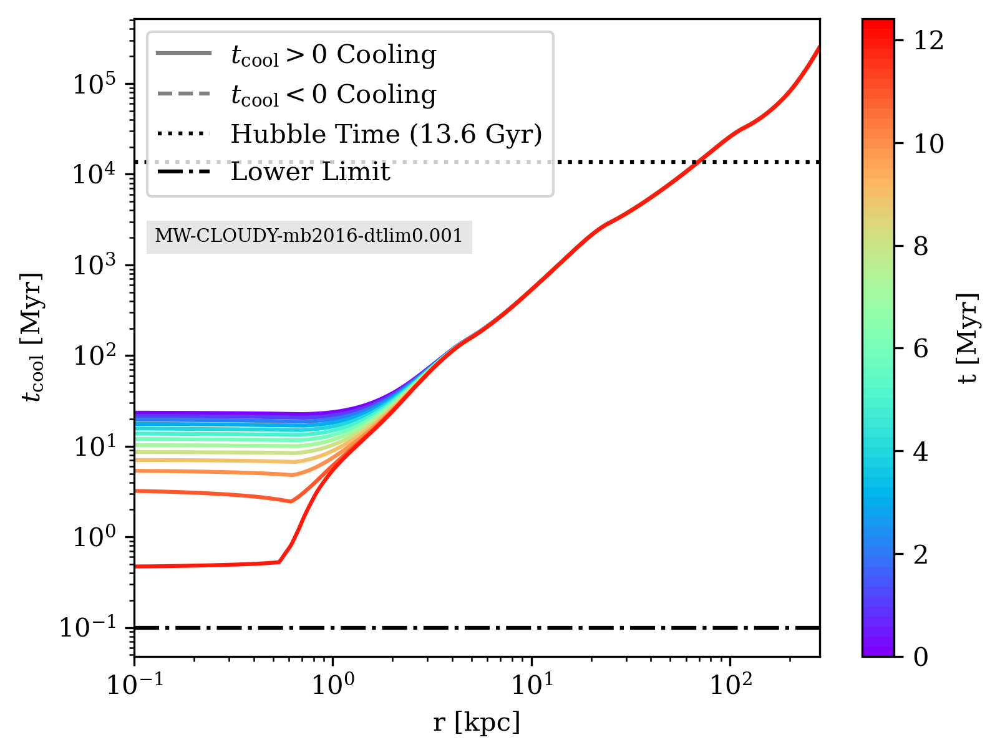

...

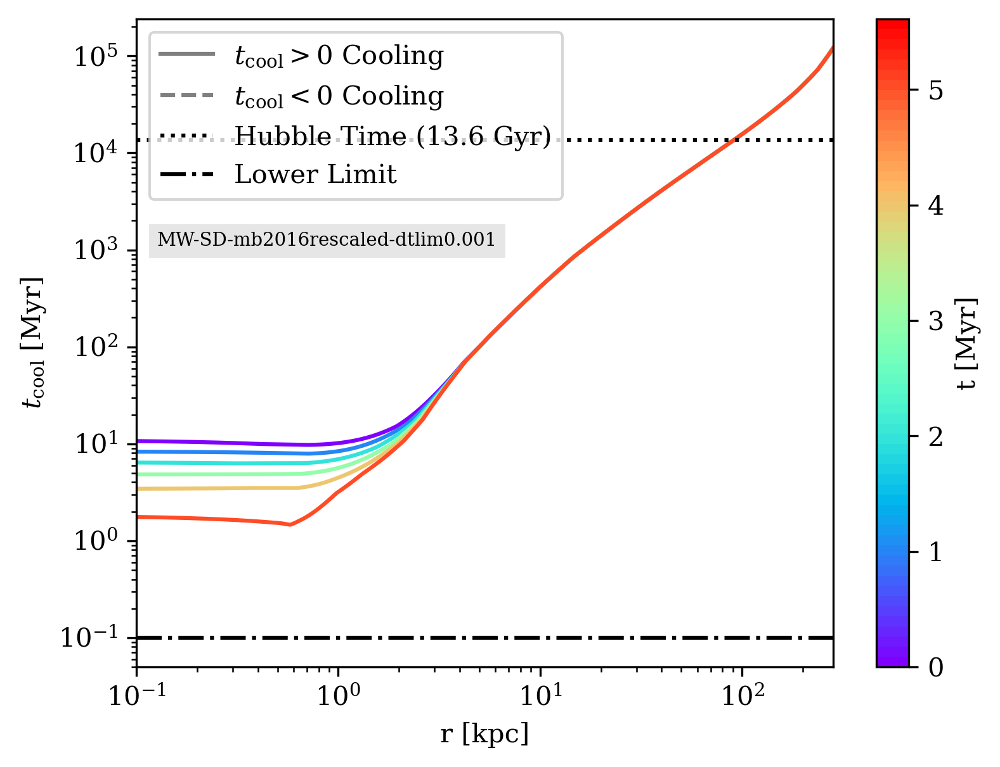

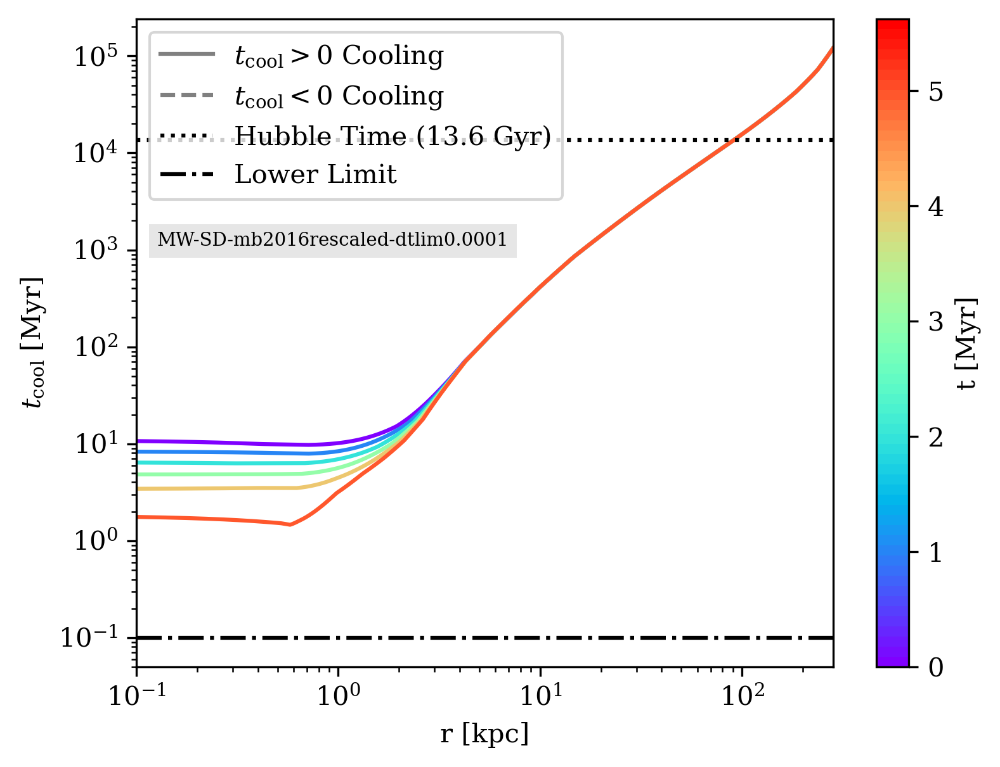

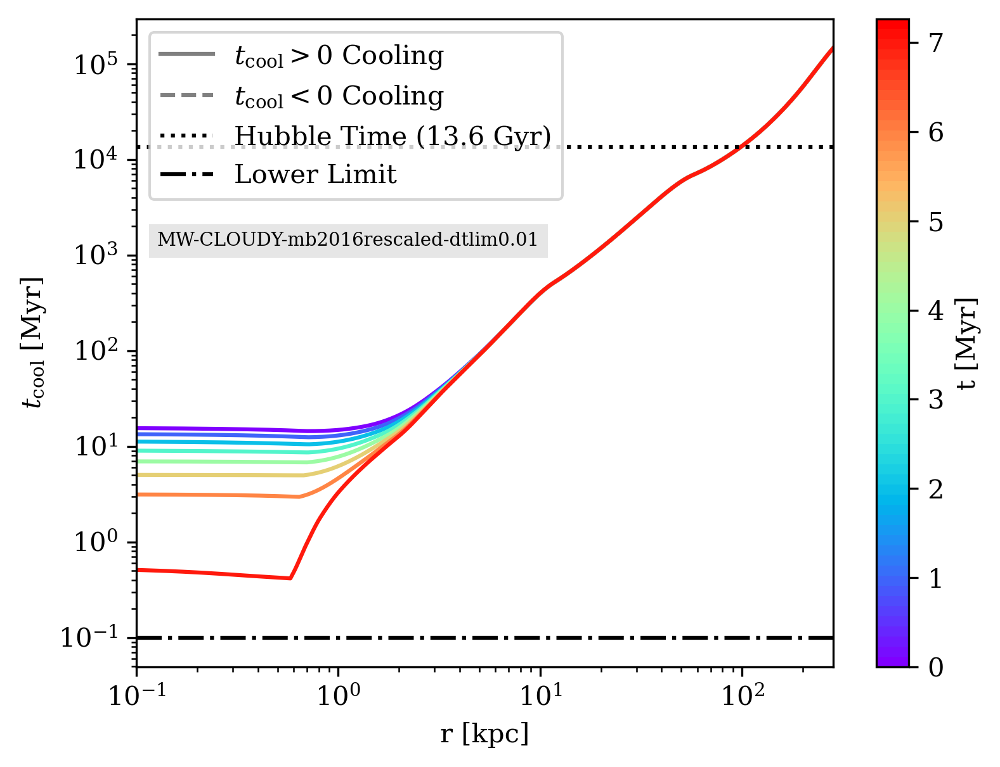

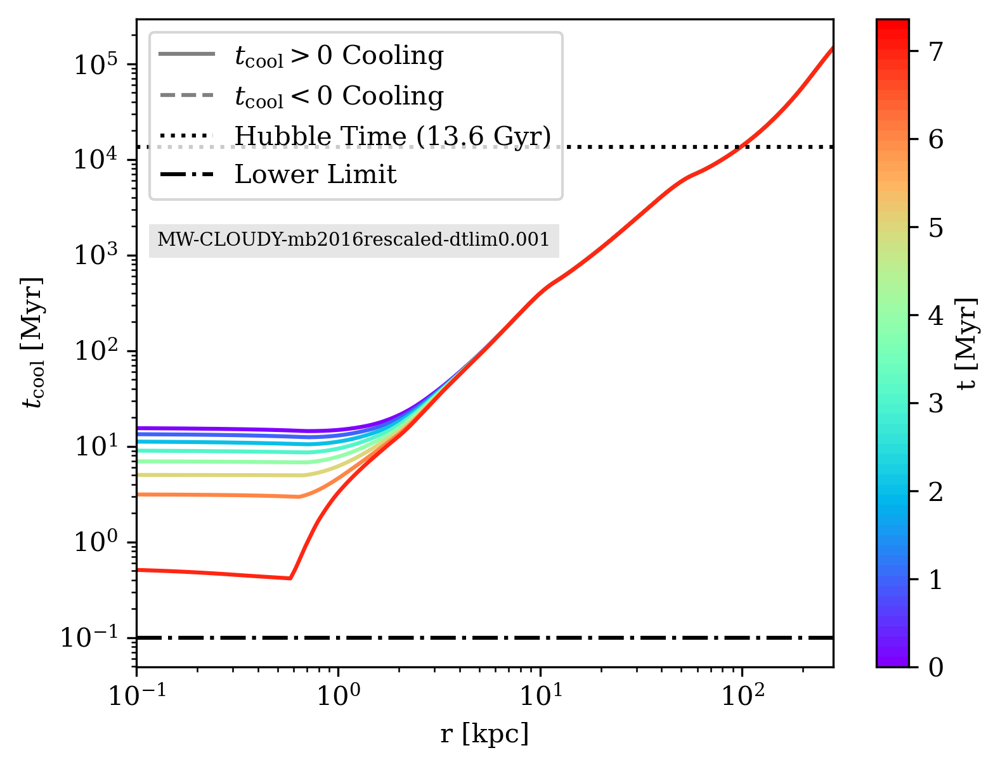

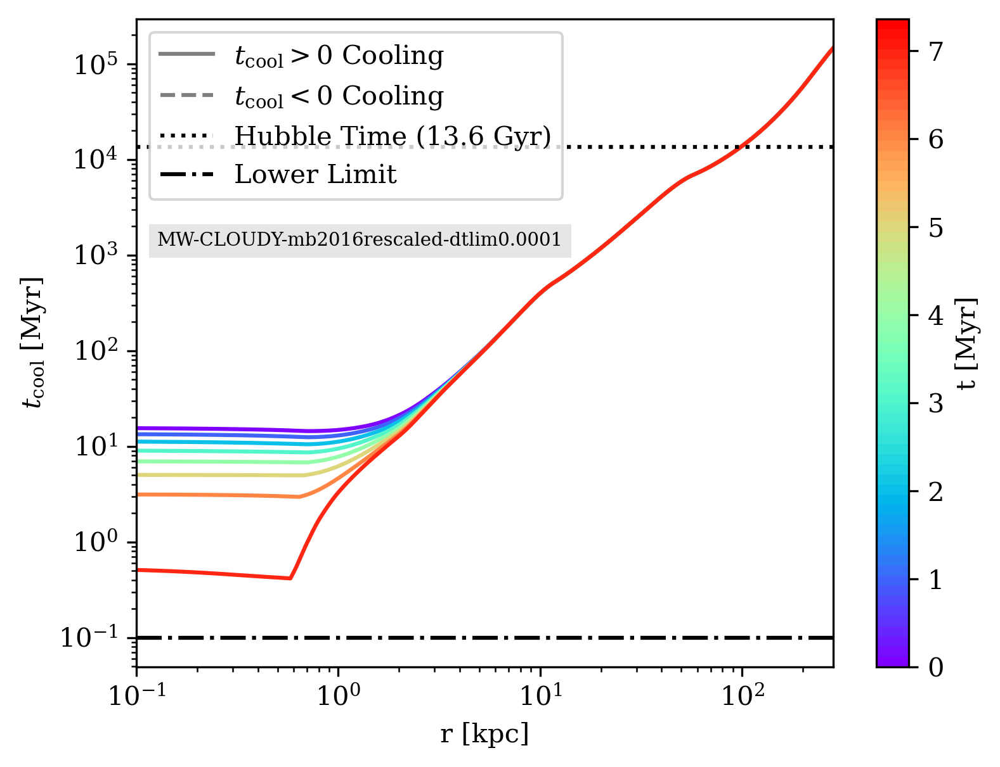

Time evolution too short (< 1 Myr) skipping MW-mb2016-E5e43-S8e3


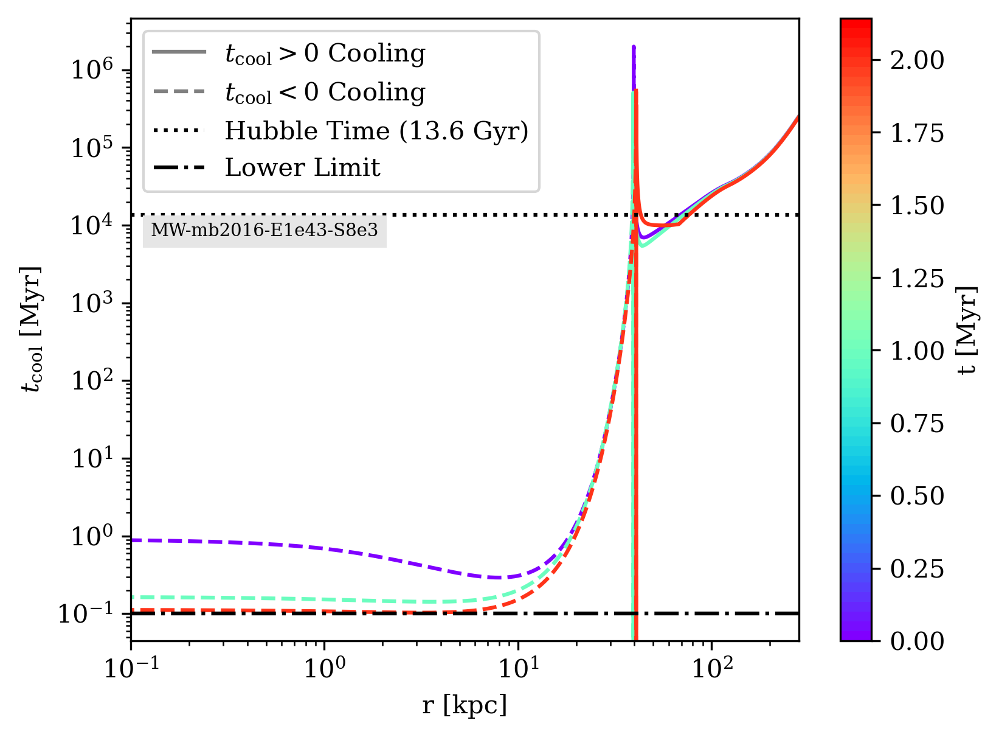

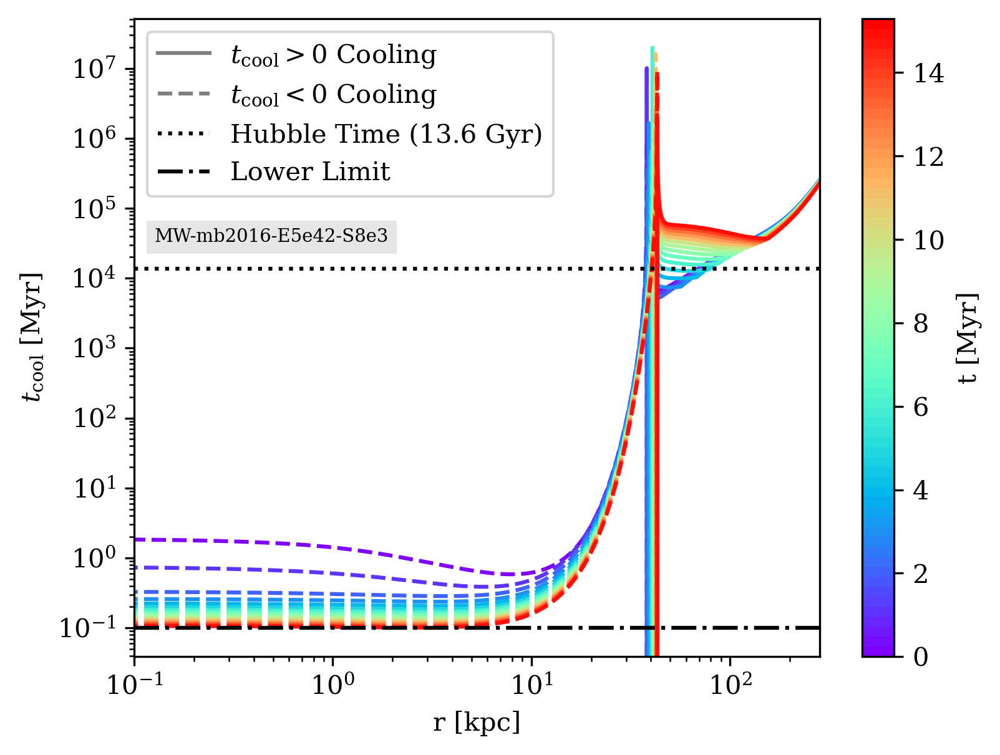

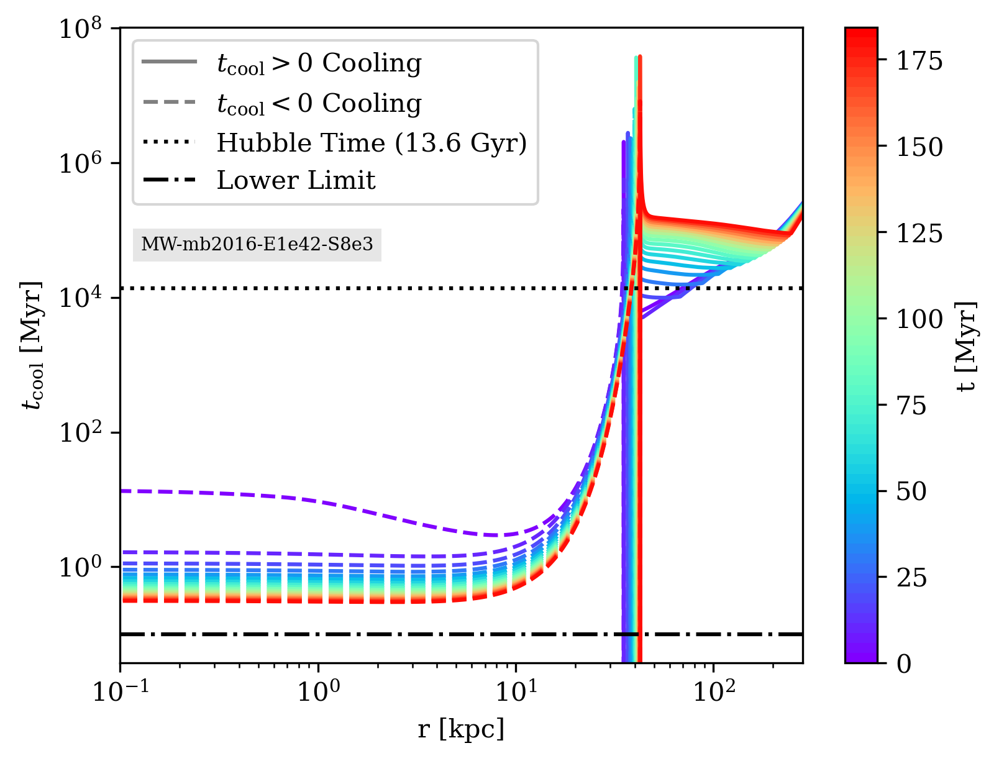

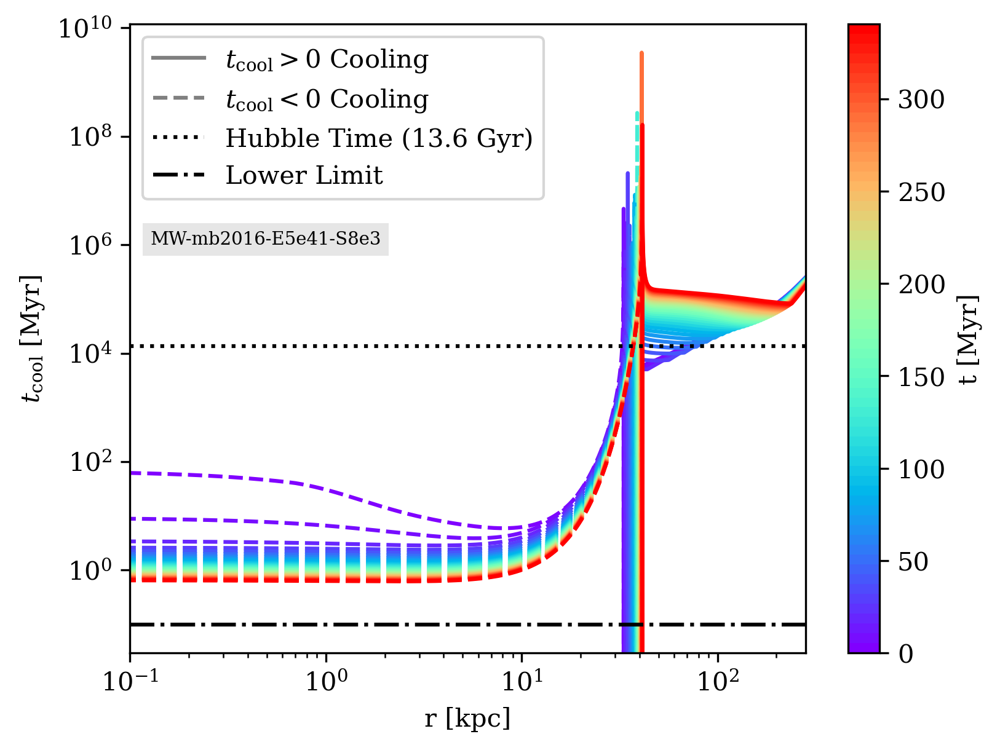

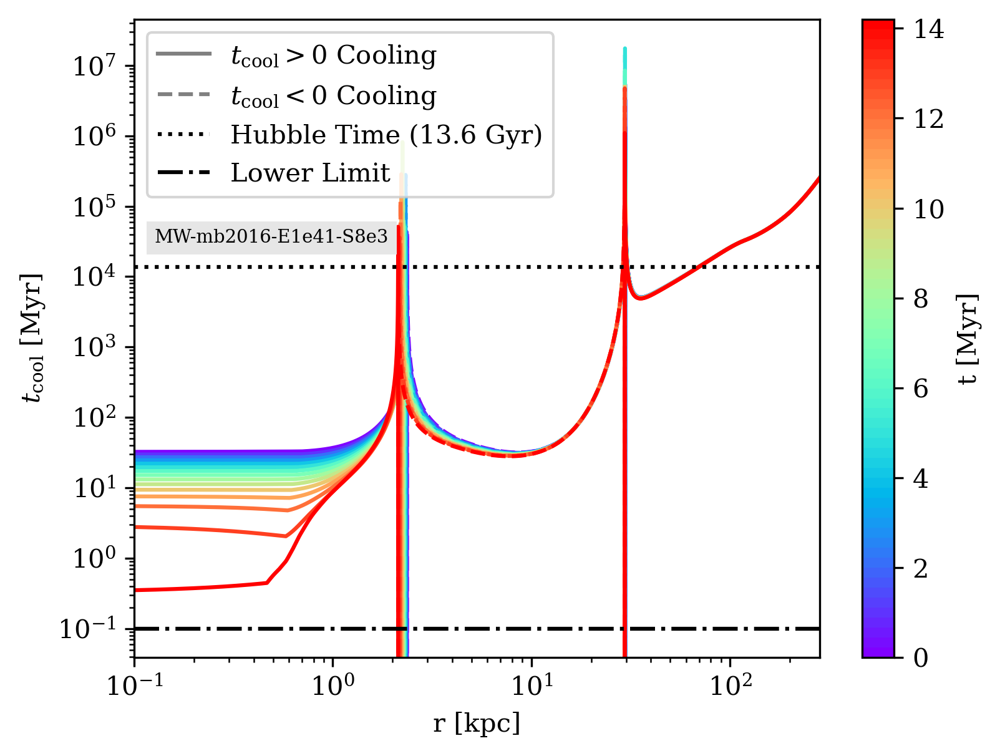

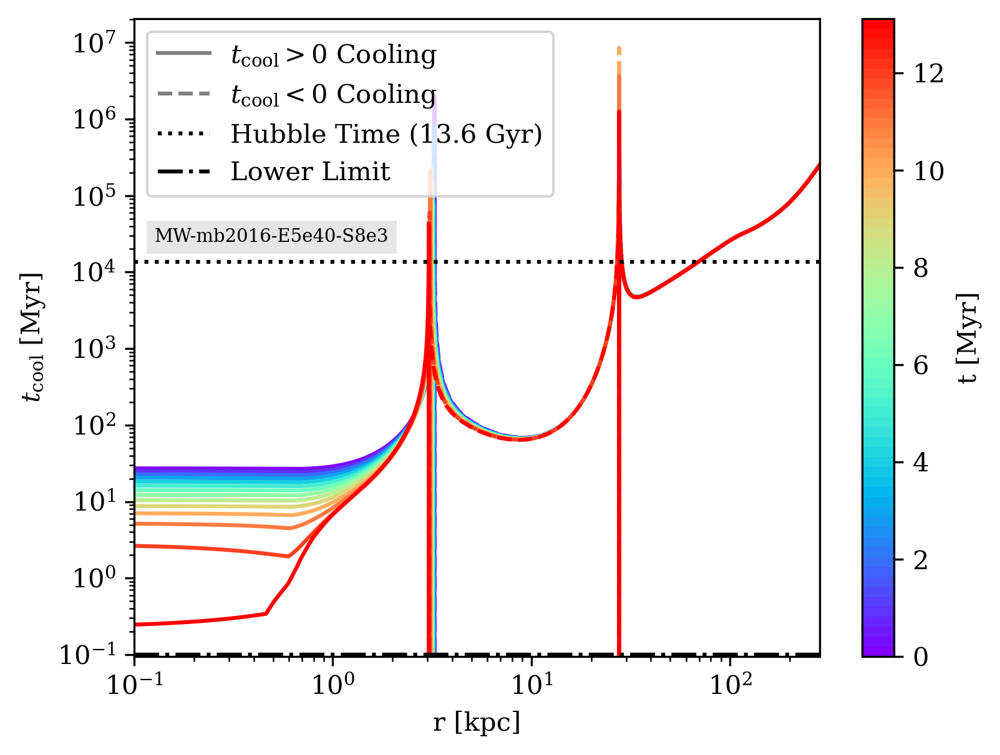

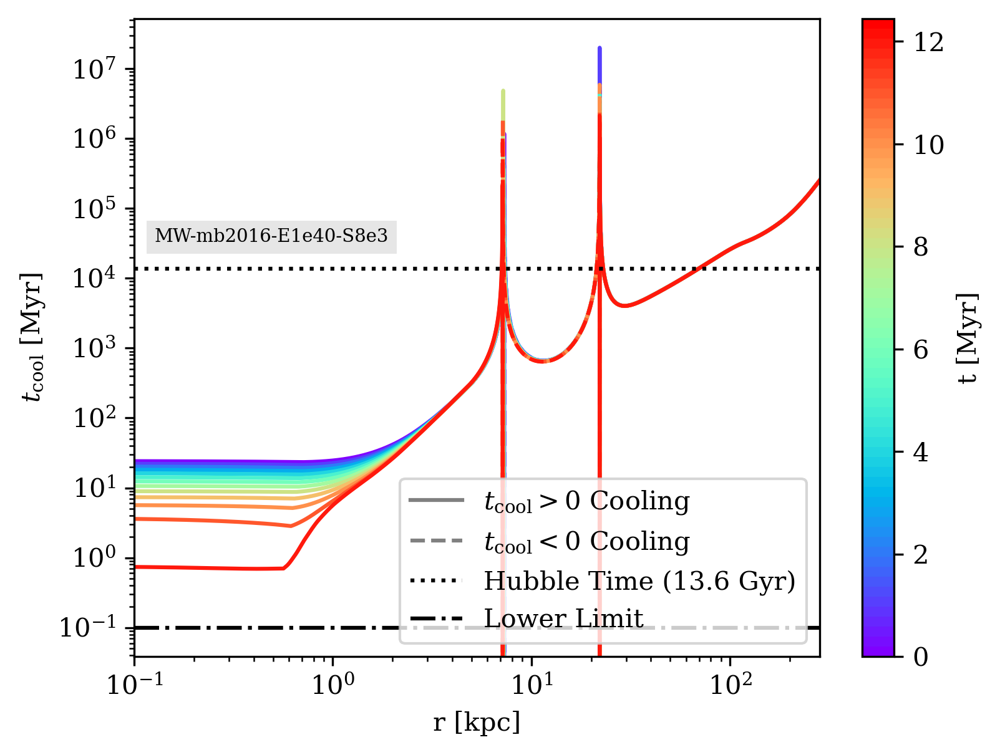

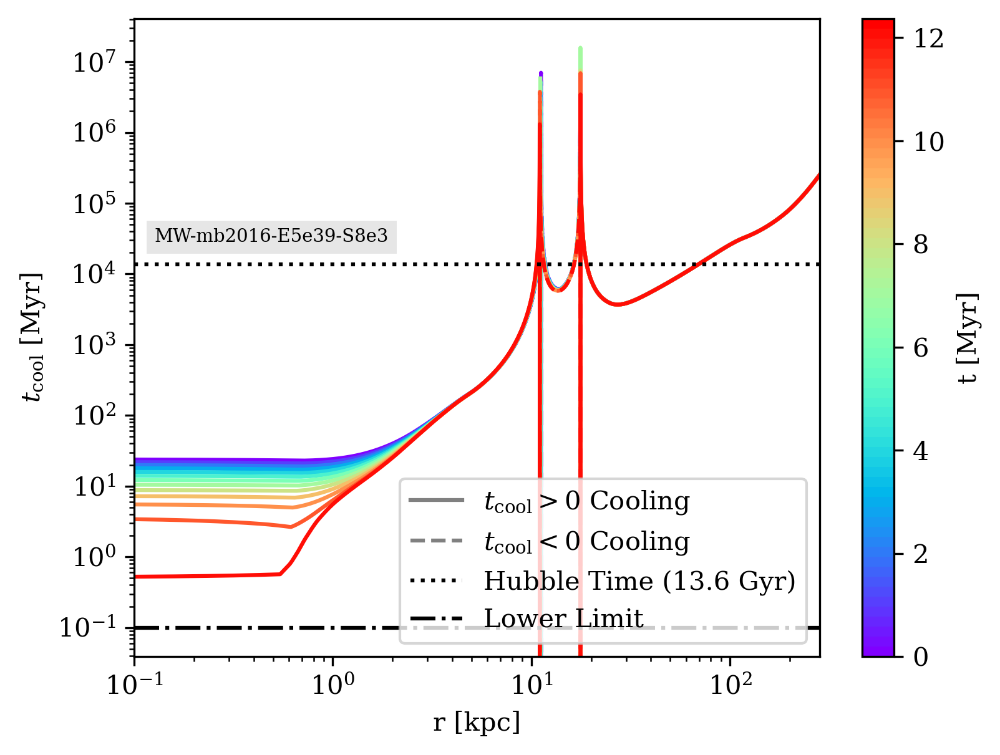

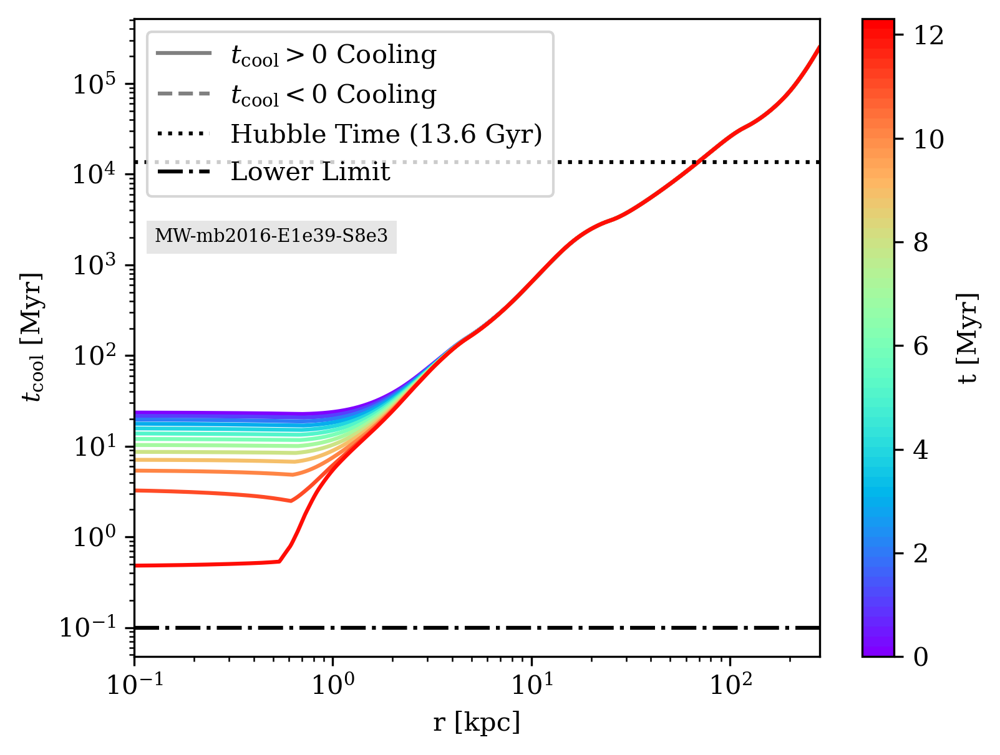

Time evolution too short (< 1 Myr) skipping MW-mb2016rescaled-E5e43-S8e3


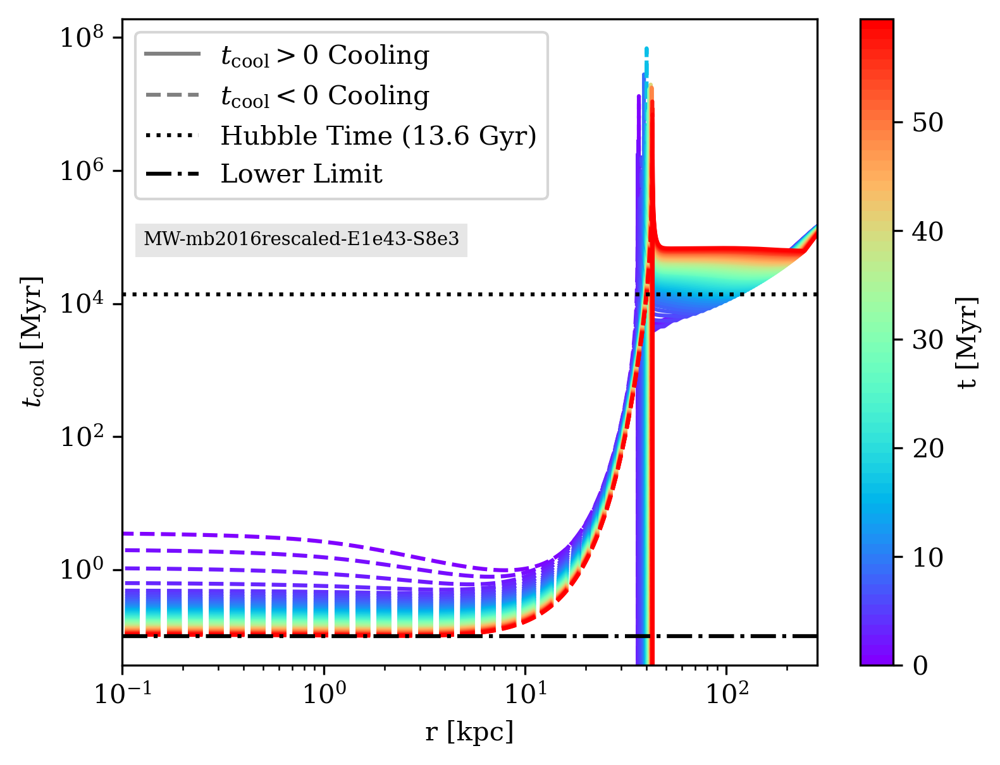

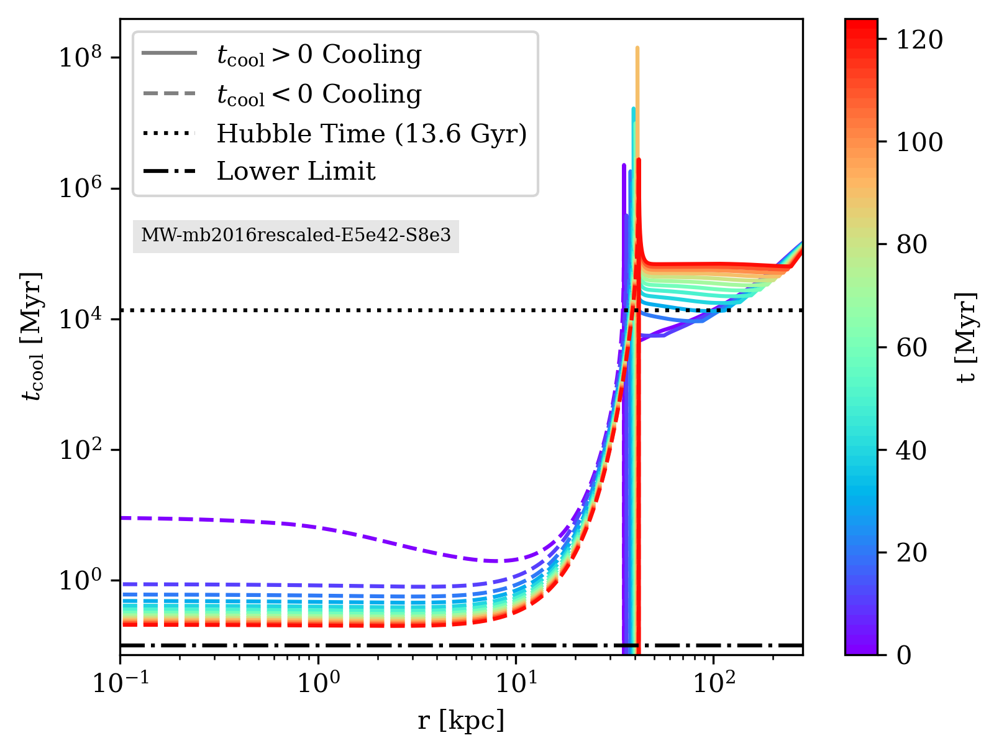

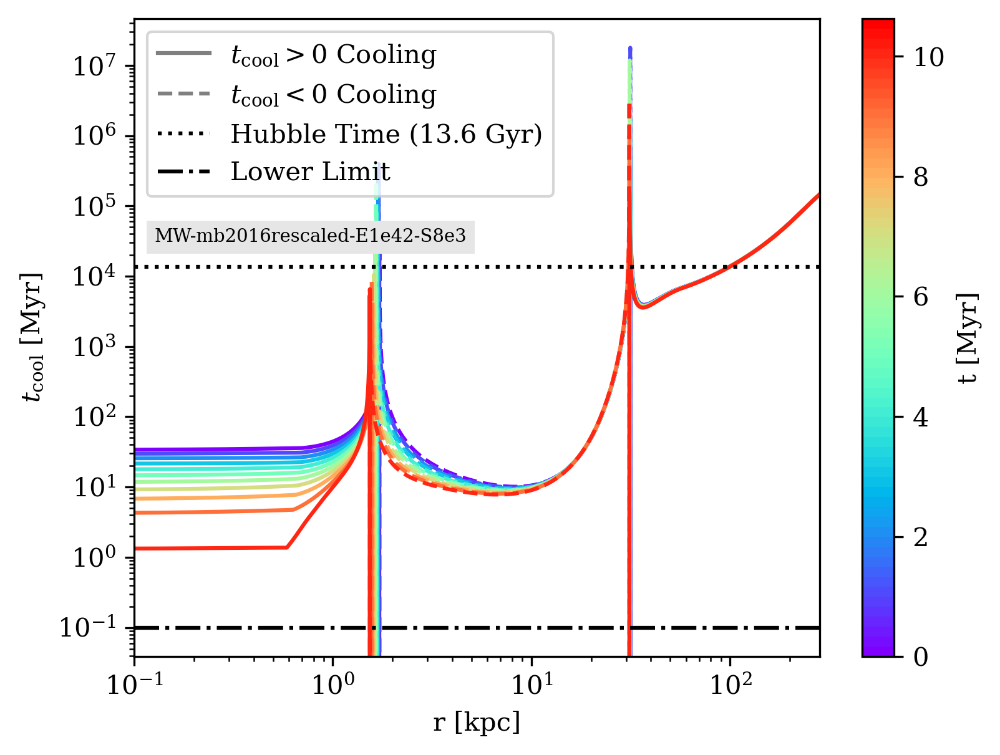

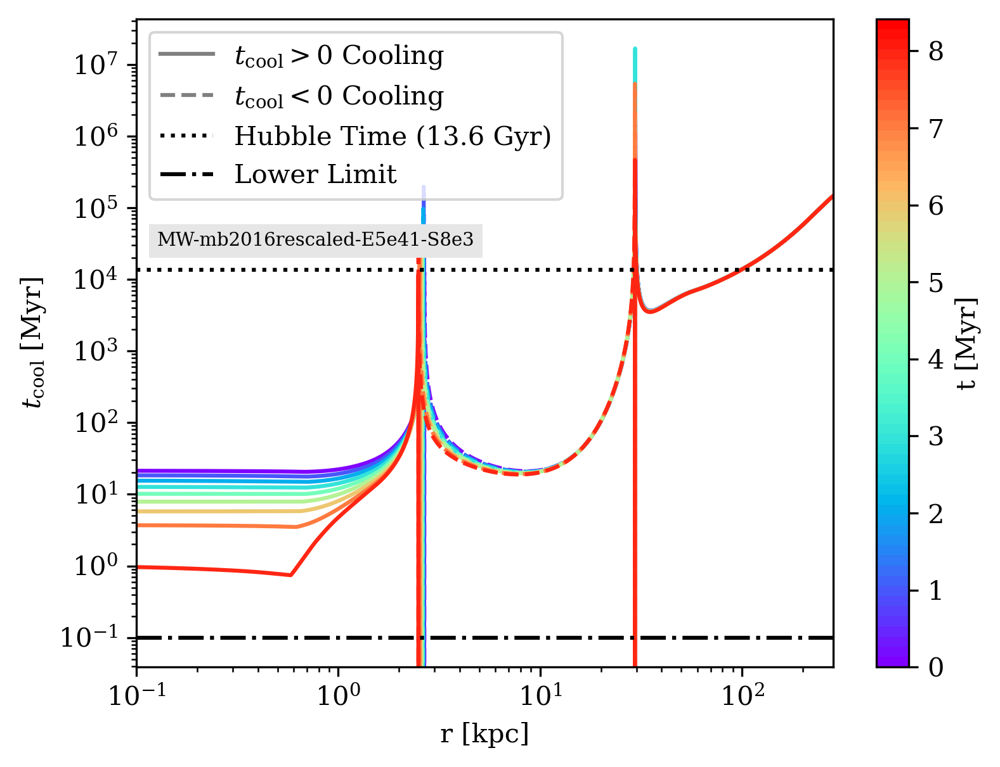

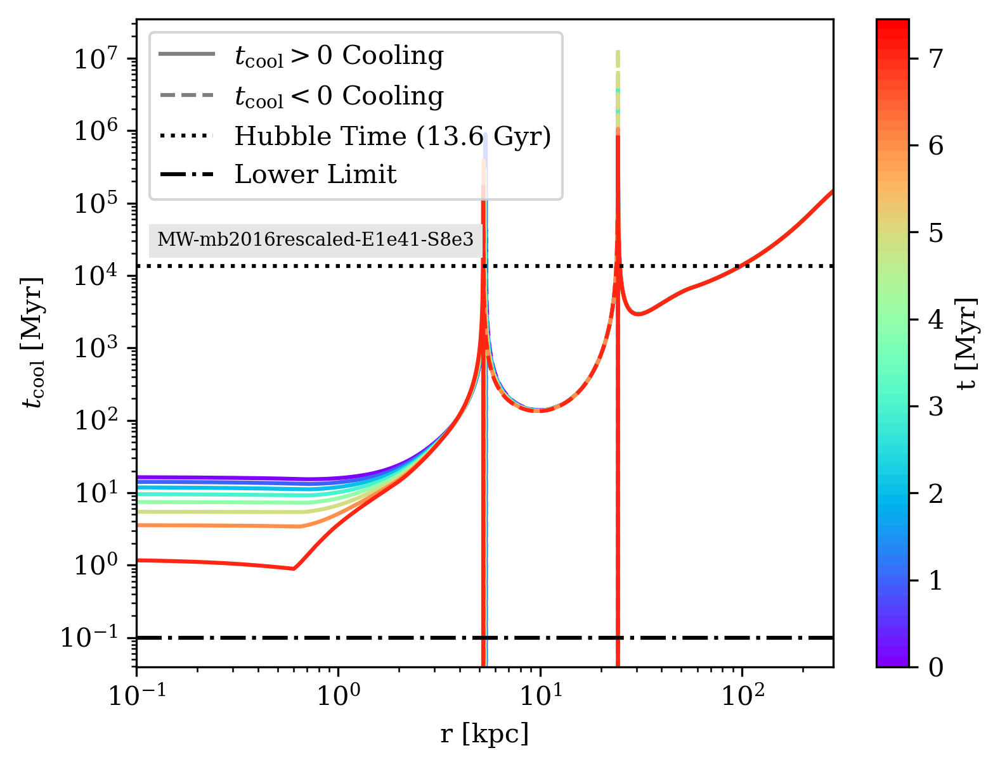

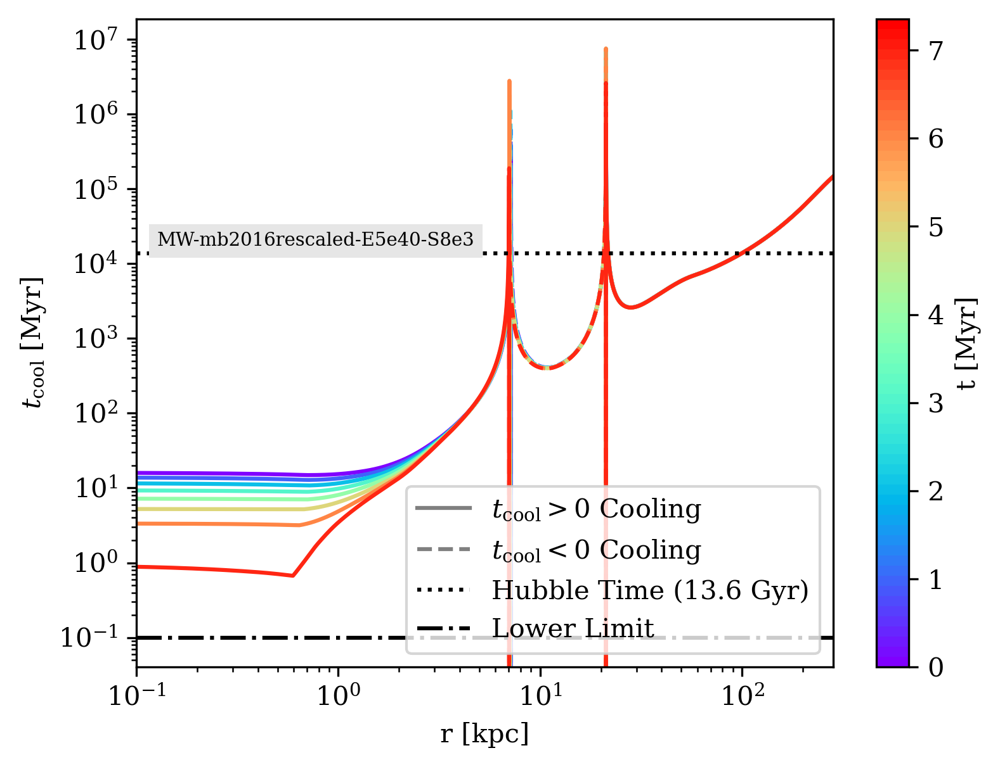

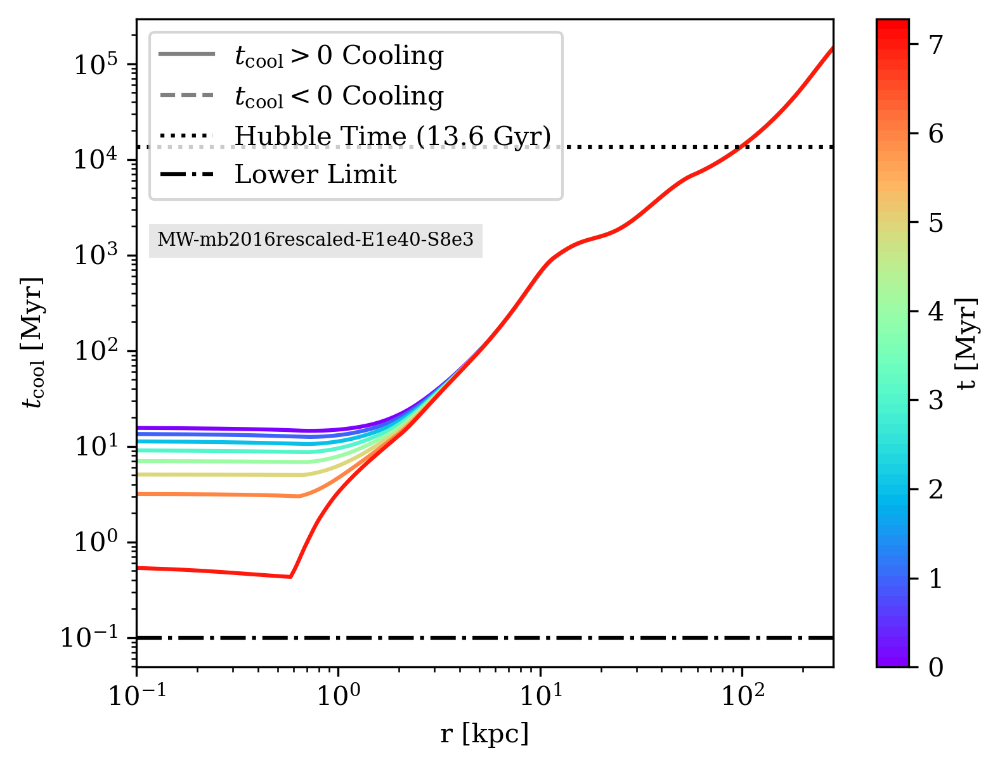

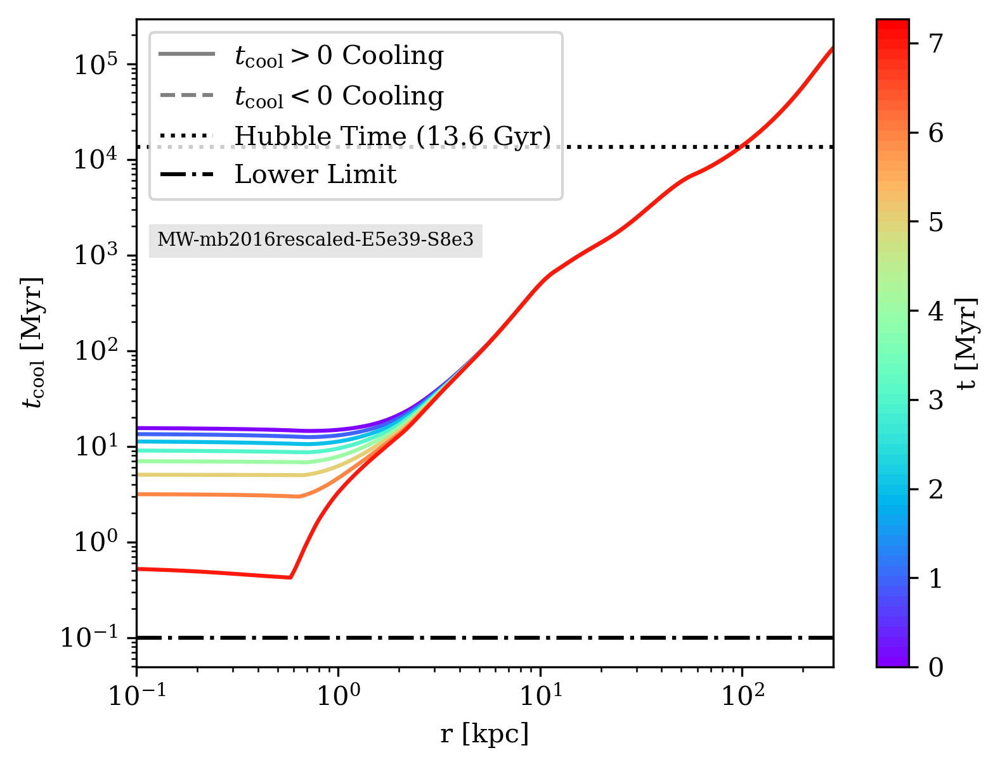

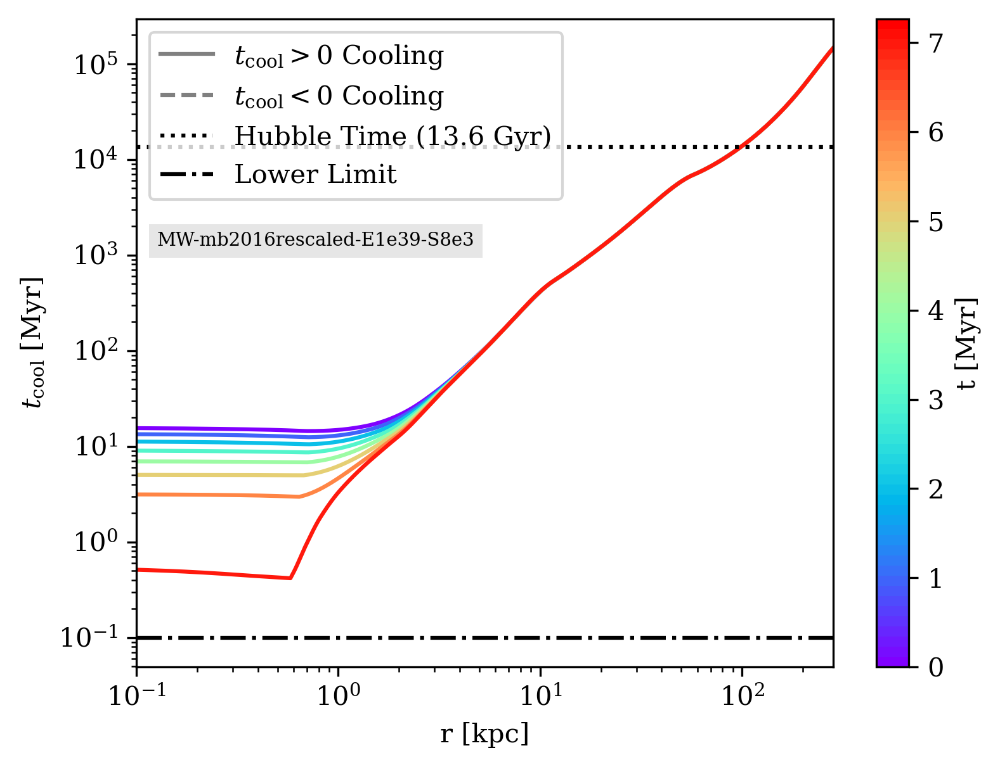

Time evolution too short (< 1 Myr) skipping MW-mb2016-E5e43-S5e3
Time evolution too short (< 1 Myr) skipping MW-mb2016-E1e43-S5e3
Time evolution too short (< 1 Myr) skipping MW-mb2016-E5e42-S5e3


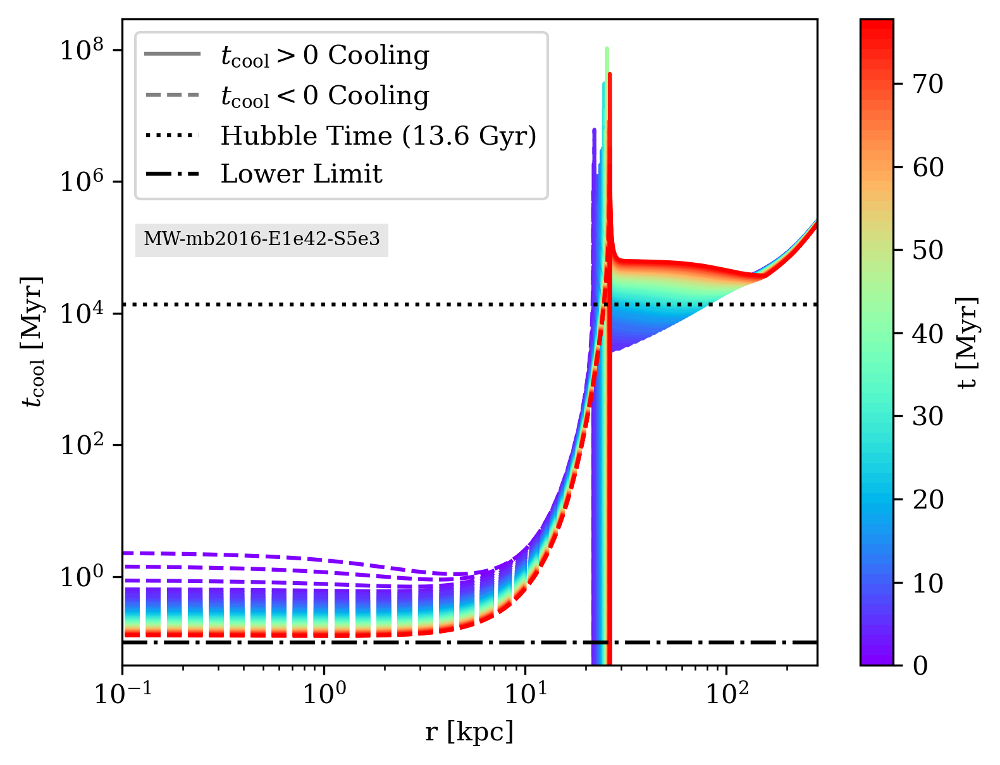

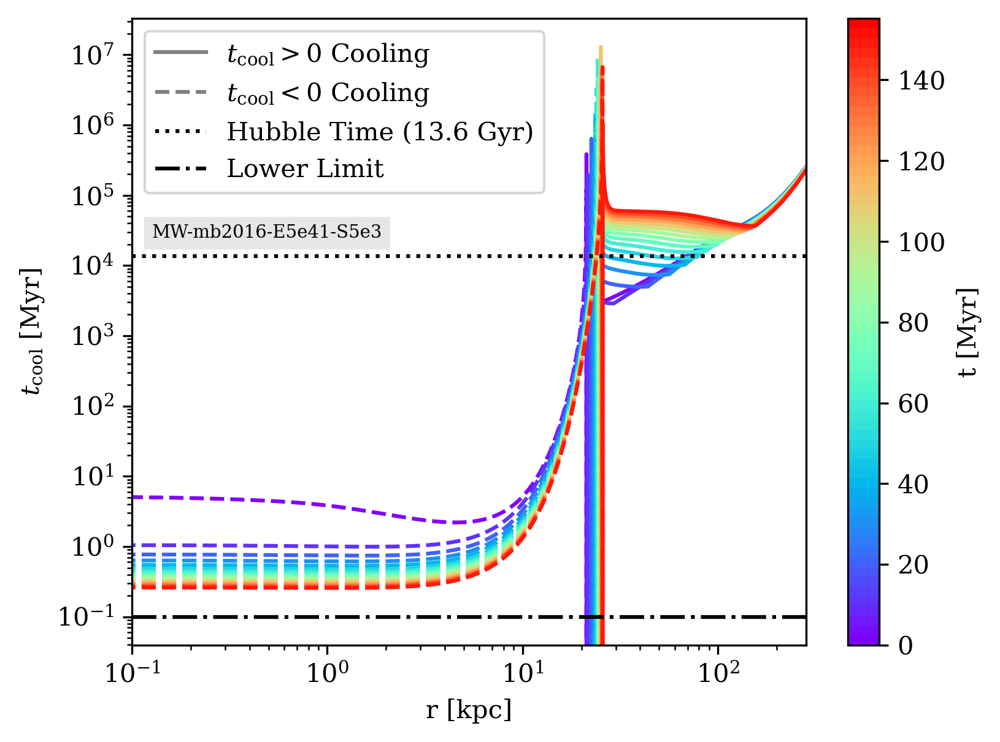

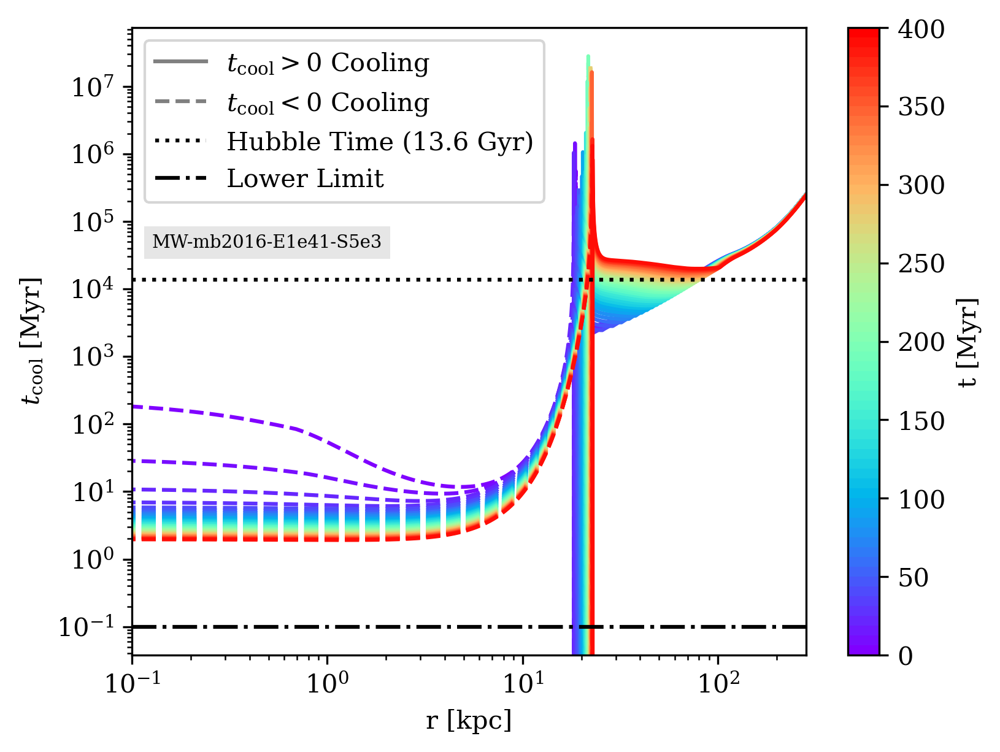

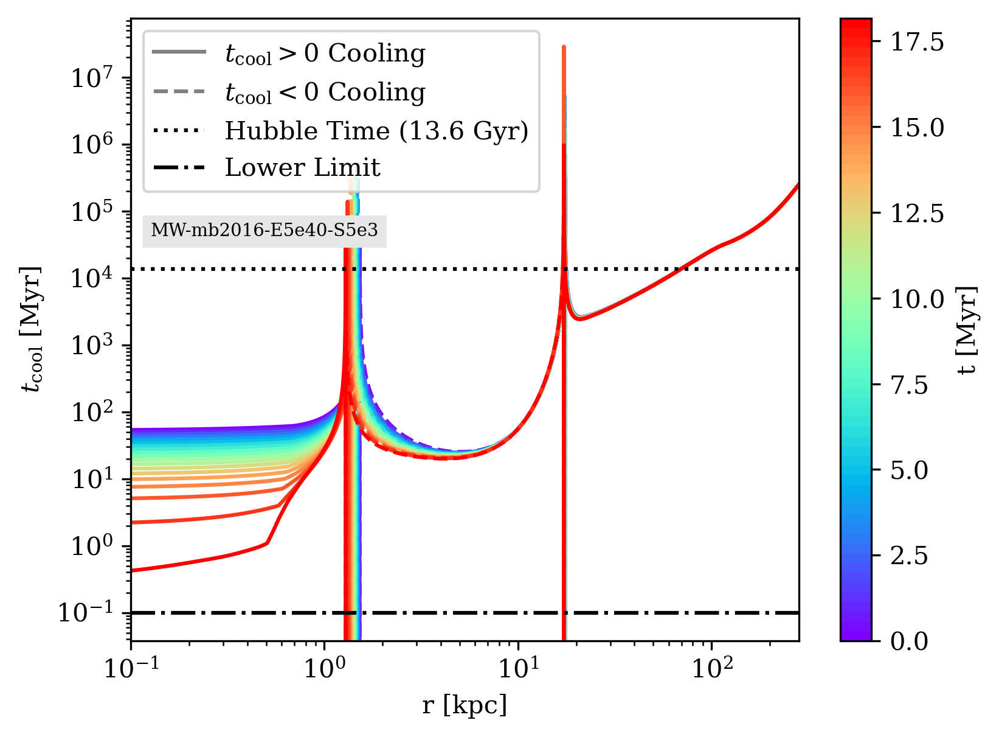

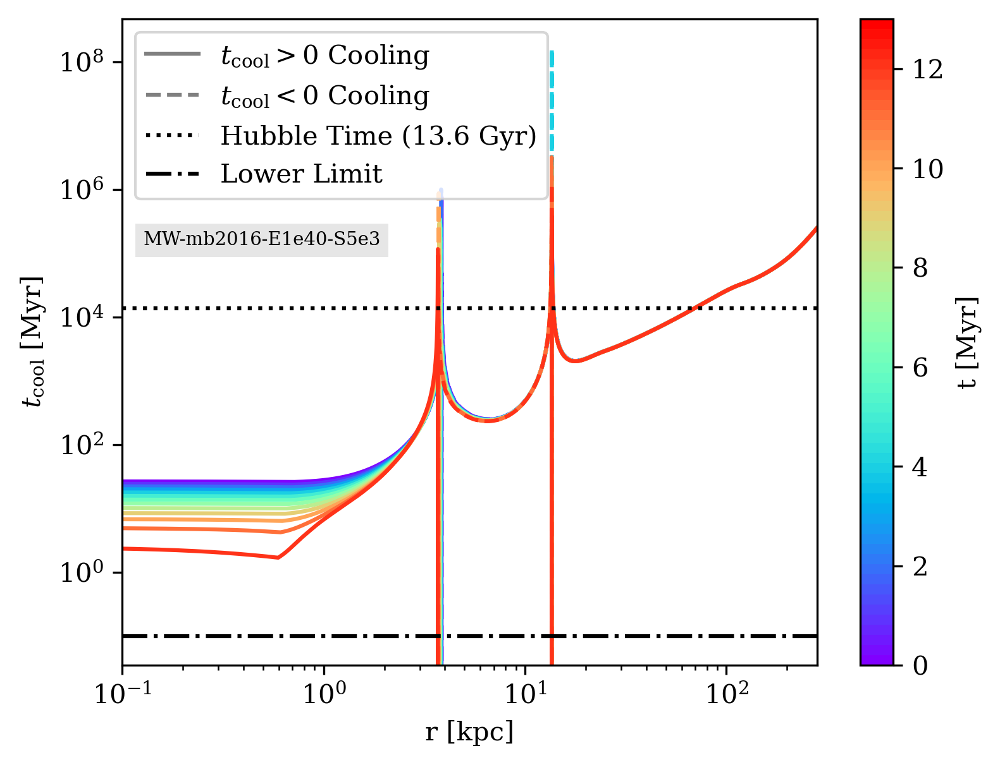

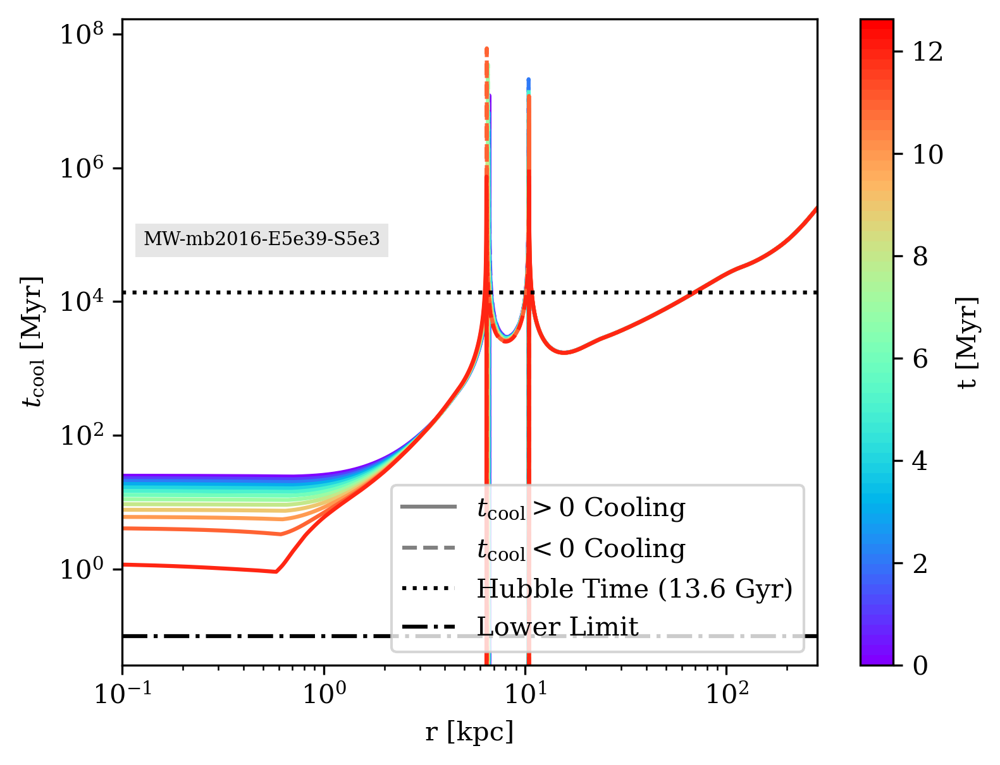

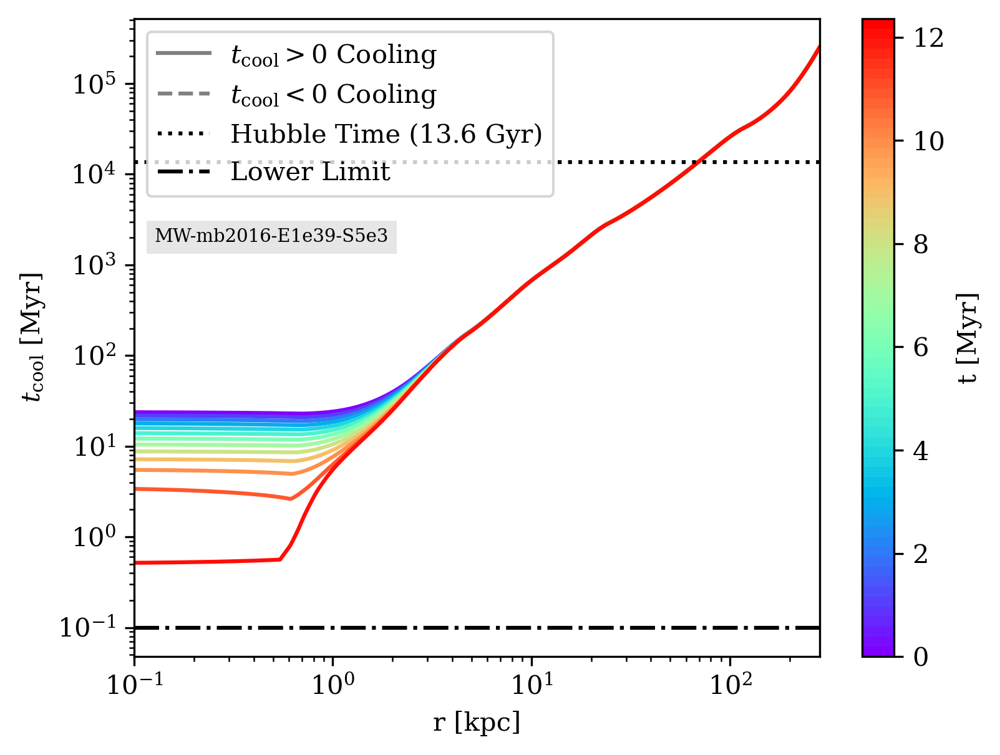

Time evolution too short (< 1 Myr) skipping MW-mb2016rescaled-E5e43-S5e3


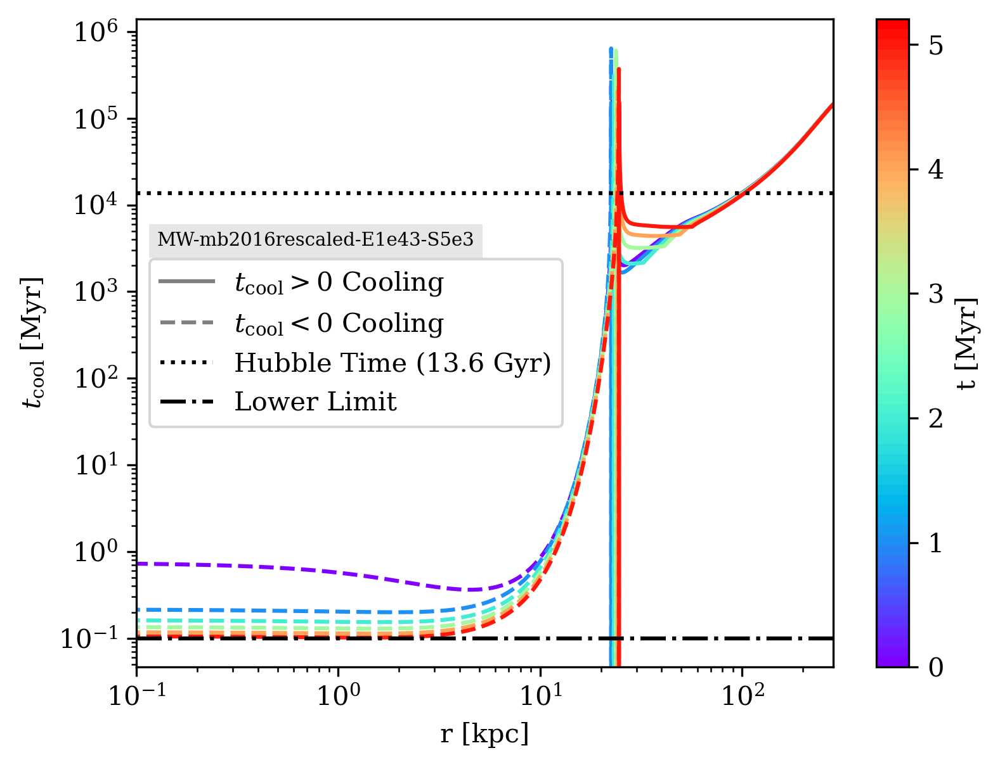

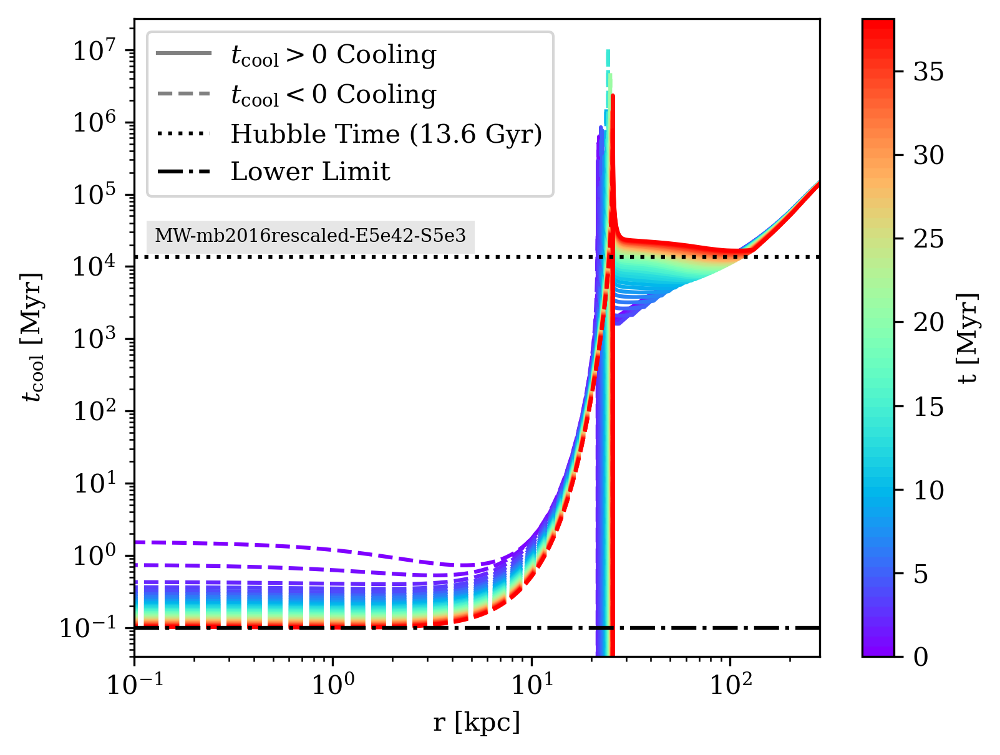

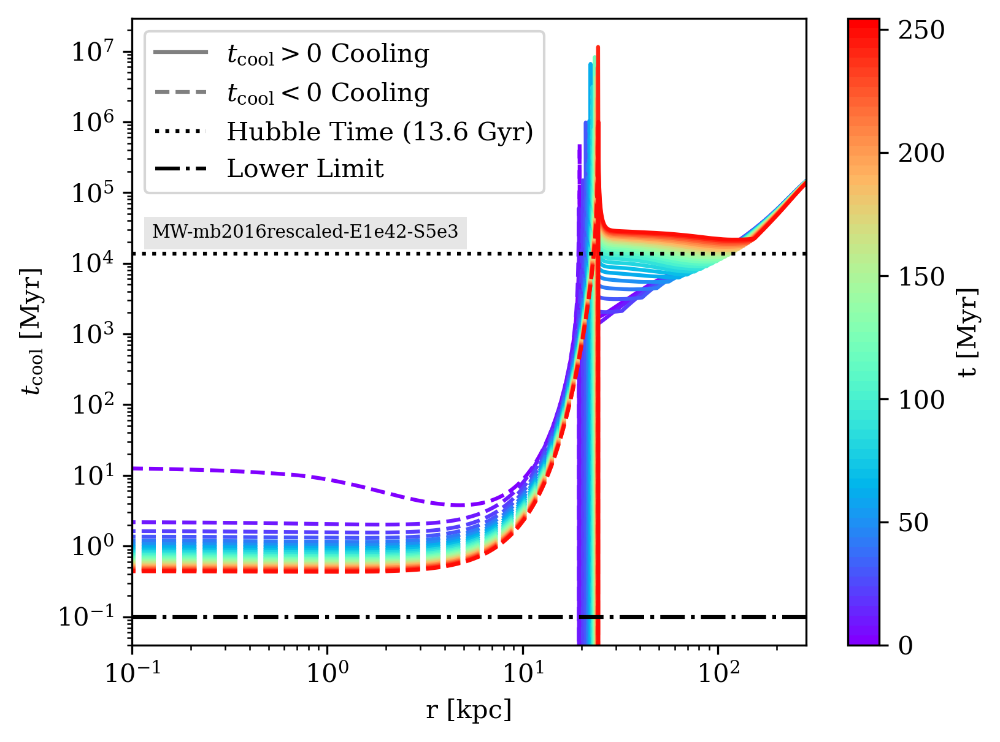

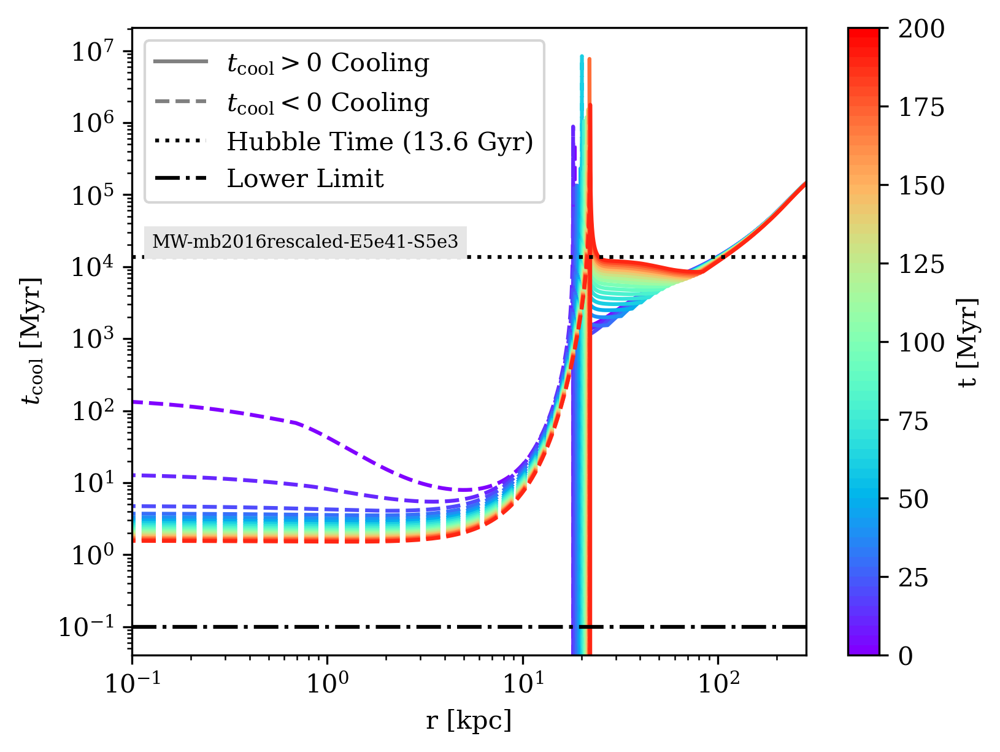

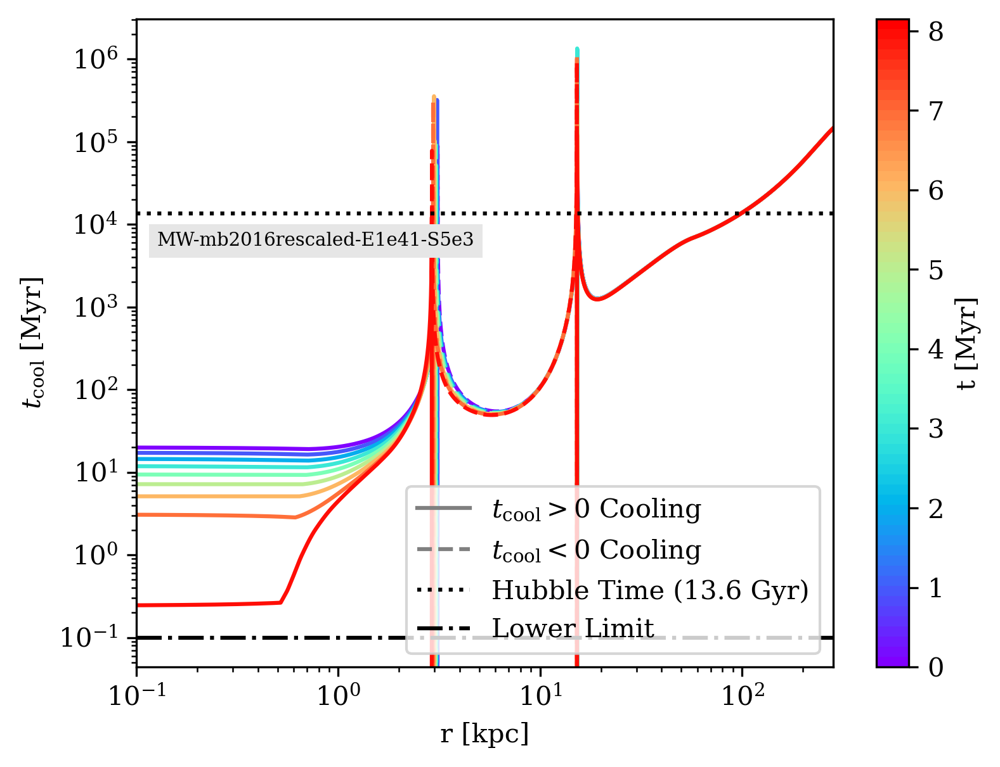

...

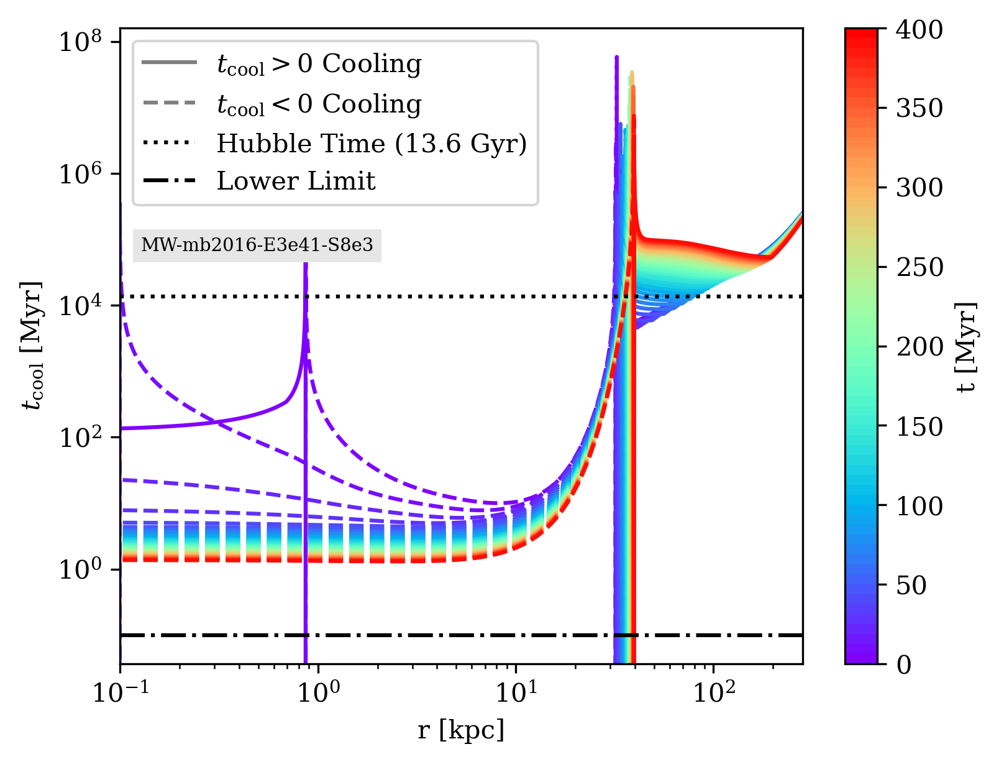

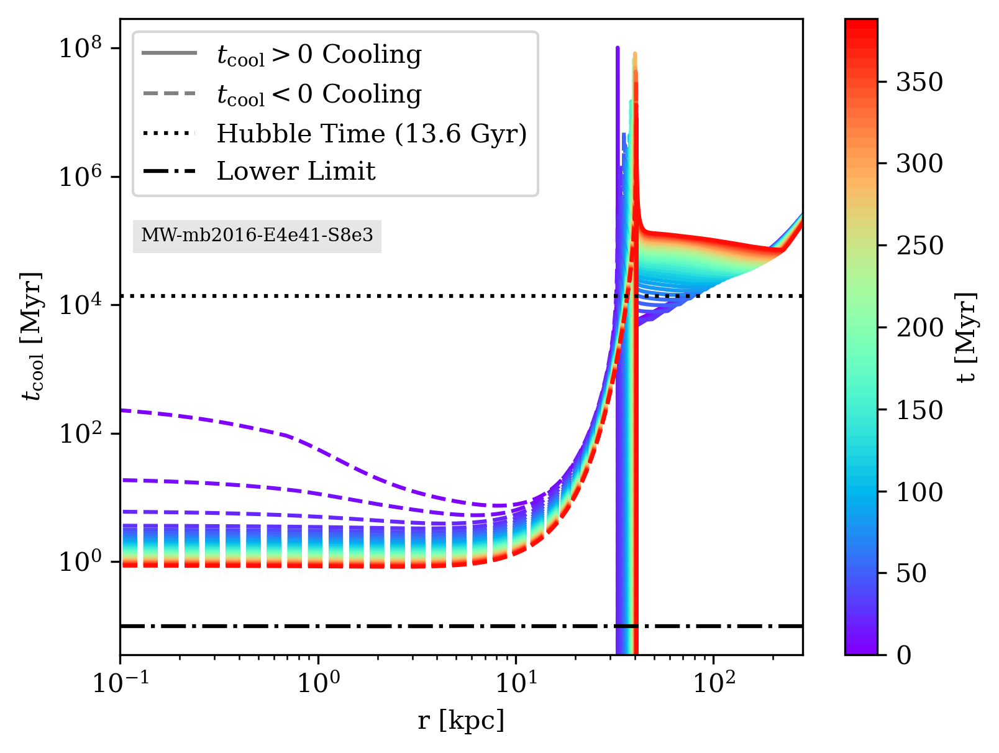

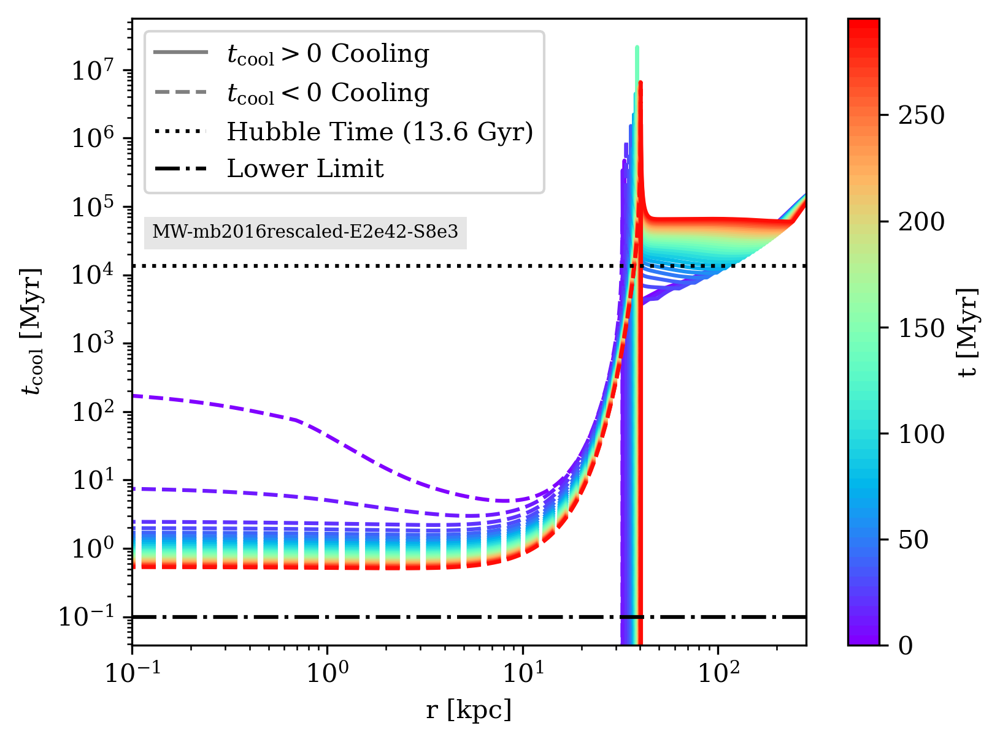

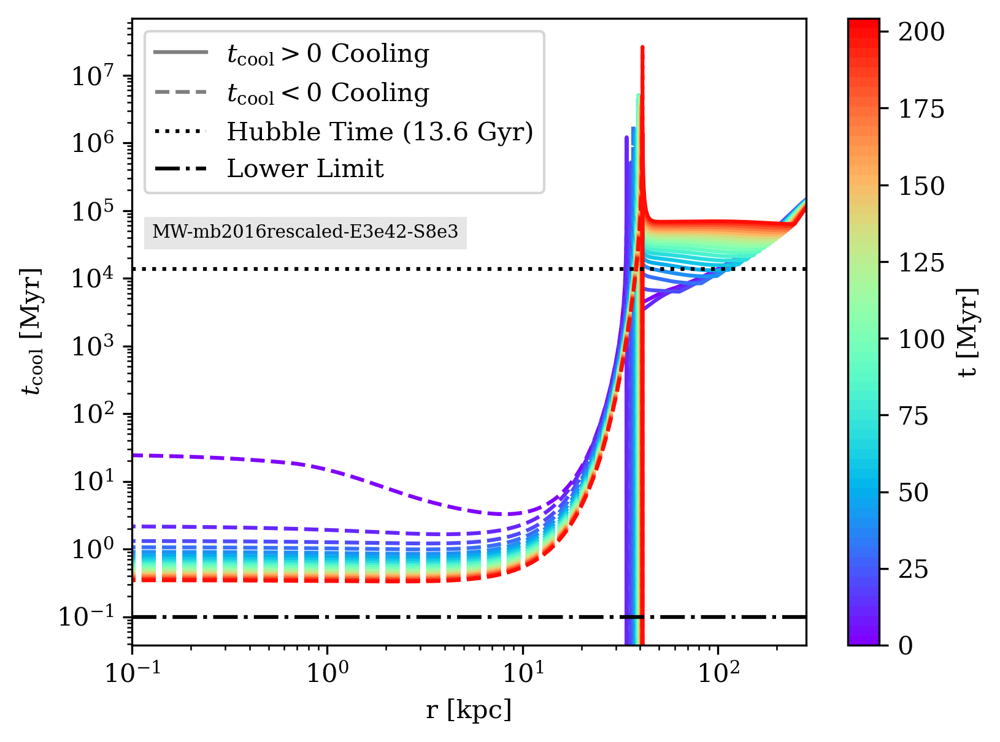

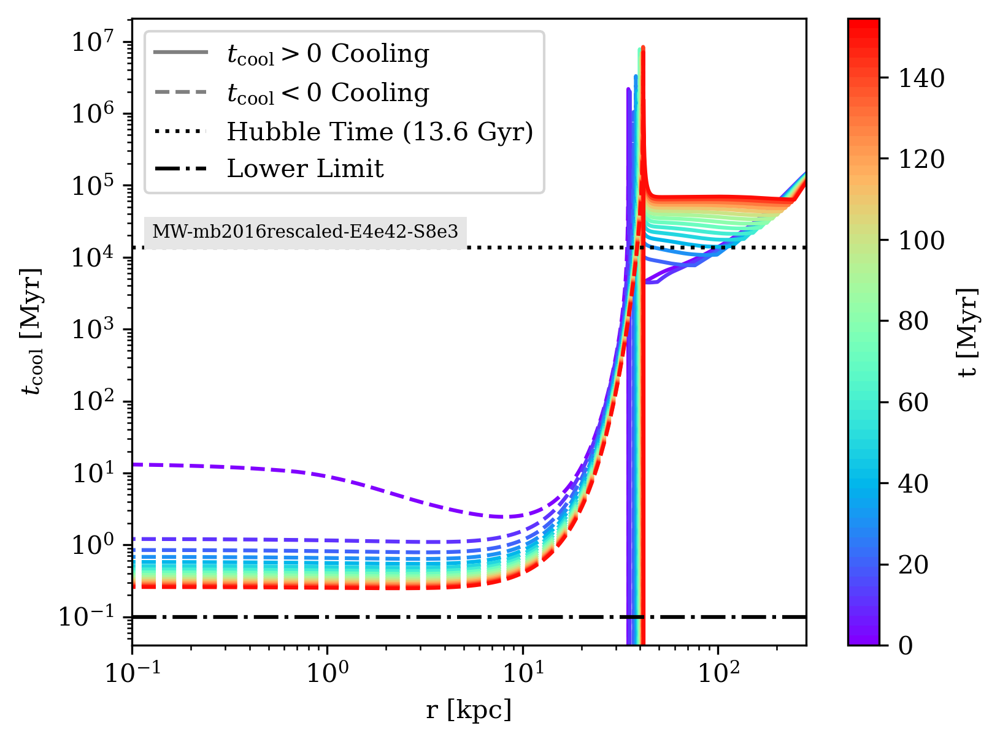

In [496]:
for name, result in res_mw.items():
    
    param, (ts, *_) = result
    if ts[-1] < 1:
        print(f"Time evolution too short (< 1 Myr) skipping {name}")
        continue
        
    if ts[-1] > 100:
        dt = 10.
    else:
        dt = 1.

    times = select_times(ts, dt=dt)
    times = np.append(times, ts[-1])
    
    fig, ax = plot_cooling_time(result, plot_times=times)
    annotate(name, (0.03, 1- 0.35), ax)
    
    low_xlim, _  = ax.get_xlim()
    low_xlim = max(low_xlim, 0.1)
    ax.set_xlim(low_xlim, param.R_out / 1e3)
    
    savefig(fig, f"coolingtime-{name}")
    plt.show()

### Evolution vs E_in

#### evolution time

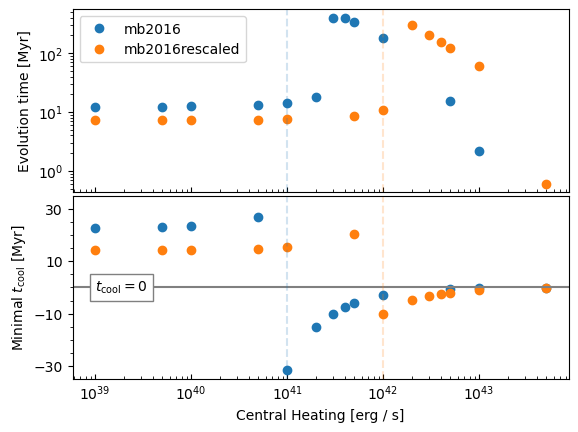

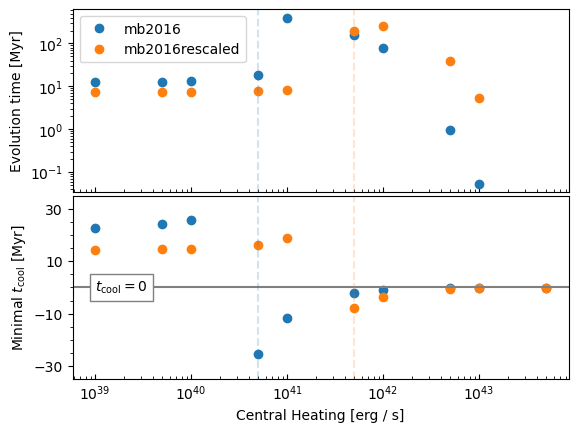

In [303]:
# def time_v_energy():
for scale in ["8e3", "5e3"]:
    method = f'S{scale}'
    plot_dict = {k: v for k, v in res_mw.items() if method in k}

    energies = {'mb2016': [], 'mb2016rescaled': []}
    times = {'mb2016': [], 'mb2016rescaled': []}
    cool_times = {'mb2016': [], 'mb2016rescaled': []}

    for name, result in plot_dict.items():
        mw_param, (ts, rs, ps, ms, ss, tcs) = result

        energy = float(name[-9:-5])
        time = ts[-1]
        min_tcool = tcs[0][np.abs(tcs[0]).argmin()]
        if 'rescaled' in name:
            energies['mb2016rescaled'].append(energy)
            times['mb2016rescaled'].append(time)
            cool_times['mb2016rescaled'].append(min_tcool)
        else:
            energies['mb2016'].append(energy)
            times['mb2016'].append(time)
            cool_times['mb2016'].append(min_tcool)

    fig, axs = plt.subplots(2, 1, sharex=True)
    for n in energies:
        es = np.array(energies[n])
        ts = np.array(times[n])
        tcs = np.array(cool_times[n])
        idx_sorted = np.argsort(es)

        axs[0].plot(es[idx_sorted], ts[idx_sorted], ls='', marker='o', label=n)
        axs[1].plot(es[idx_sorted], tcs[idx_sorted], ls='', marker='o', label=n)

    axs[0].set_xscale('log')
    axs[0].set_yscale('log')

    axs[0].set_ylabel('Evolution time [Myr]')
    axs[1].set_ylabel(r'Minimal $t_{\rm cool}$ [Myr]')
    axs[1].set_xlabel('Central Heating [erg / s]')
    axs[0].legend()
    axs[1].axhline(0, c='gray')

    axs[1].set_ylim(-35, 35)
    # axs[1].set_yticks([-25, -15, -5,  5, 15, 25])
    axs[1].set_yticks(np.arange(-30, 31, 20))
    axs[1].set_yticks(np.arange(-30, 31, 5), minor=True)

    axs[1].text(1e39,
                0,
                r'$t_{\rm cool} = 0$',
                horizontalalignment='left',
                verticalalignment='center',
                bbox={'facecolor': 'white', 'ec':'gray'})

    for ax in axs:
        if scale == "8e3":
            ax.axvline(1e41, ls='--', alpha=0.2, c='tab:blue')
            ax.axvline(1e42, ls='--', alpha=0.2, c='tab:orange')
        elif scale == "5e3":
            ax.axvline(5e40, ls='--', alpha=0.2, c='tab:blue')
            ax.axvline(5e41, ls='--', alpha=0.2, c='tab:orange')

        ax.tick_params(axis="x", direction="in", which="both")

    savefig(fig, name=f"time-vs-energy-{method}")

    fig.subplots_adjust(wspace=0, hspace=0.02)

    fig.show()

    # fig, axs = time_evolution_plots(plot_dict)

    # plt.show()

#### density

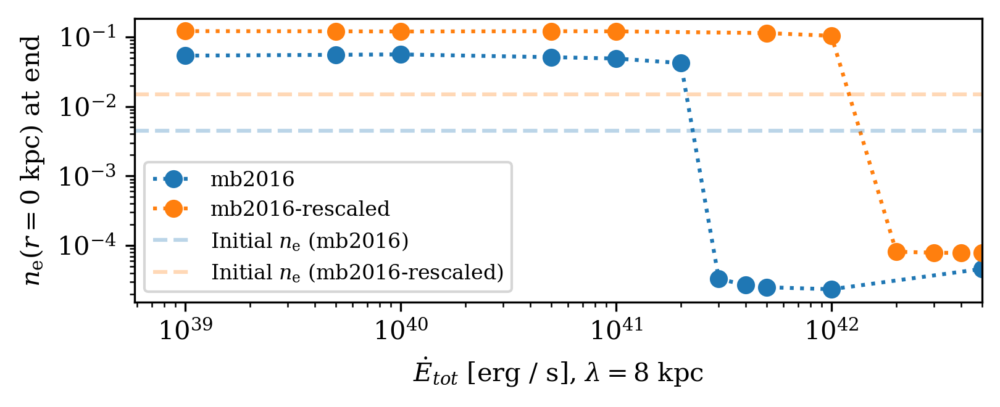

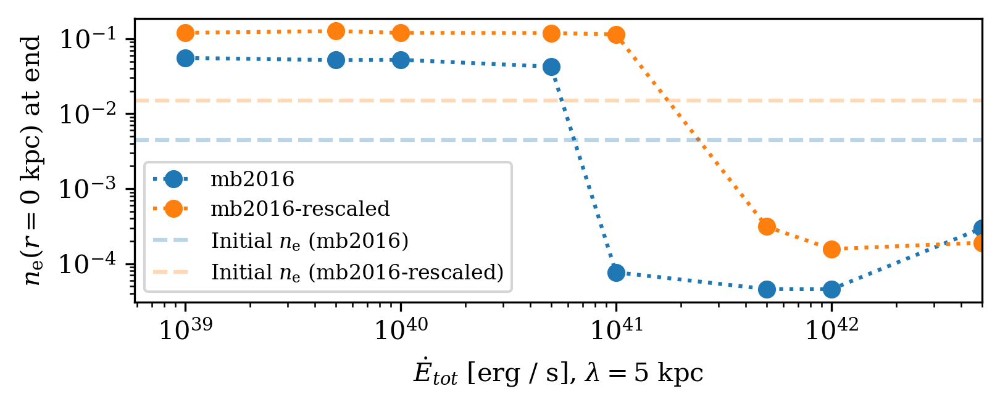

In [706]:
# def time_v_energy():
for scale in ["8e3", "5e3"]:
    method = f'S{scale}'
    plot_dict = {k: v for k, v in res_mw.items() if method in k}

    energies = {'mb2016': [], 'mb2016-rescaled': []}
    times = {'mb2016': [], 'mb2016-rescaled': []}
    cool_times = {'mb2016': [], 'mb2016-rescaled': []}
    densities = {'mb2016': [], 'mb2016-rescaled': []}

    for name, result in plot_dict.items():
#         if name[-9] != "1" and name[-9] != "5":
#             print('skip')
#             continue
            
        mw_param, (ts, rs, ps, ms, ss, tcs) = result
        _, n_e_start, _ = compute_quantities(r=rs[0], P=ps[0], M=ms[0], sig=ss[0])
        n_e_start = n_e_start[0]

        rho, n_e, T = compute_quantities(r=rs[-1], P=ps[-1], M=ms[-1], sig=ss[-1])
        
        energy = float(name[-9:-5])
        time = ts[-1]
        n_e_inner = n_e[0]
        min_tcool = tcs[0][np.abs(tcs[0]).argmin()]
        
        dict_name = 'mb2016-rescaled' if 'rescaled' in name else 'mb2016'
        energies[dict_name].append(energy)
        times[dict_name].append(time)
        cool_times[dict_name].append(min_tcool)
        densities[dict_name].append(n_e_inner)

    fig, axs = plt.subplots(1, 1, sharex=True, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT*0.45))
    for n in energies:
        es = np.array(energies[n])
        ts = np.array(times[n])
        denss = np.array(densities[n])
        tcs = np.array(cool_times[n])
        idx_sorted = np.argsort(es)

#         axs[0].plot(es[idx_sorted], ts[idx_sorted], ls='', marker='o', label=n)
        axs.plot(es[idx_sorted], denss[idx_sorted], ls=':', marker='o', label=n)
#         axs[1].plot(es[idx_sorted], tcs[idx_sorted], ls='', marker='o', label=n)

    axs.set_xscale('log')
    axs.set_yscale('log')
    

    axs.set_ylabel(r'$n_{\rm e}(r=0\text{ kpc})$ at end')
    axs.set_xlabel(f'$\dot E_{{tot}}$ [erg / s], $\lambda = {scale[0]}$ kpc')
    axs.set_xlim(axs.get_xlim()[0], 5e42)
    
    
    normal_res = res_mw['MW-SD-mb2016']
    mw_param, (ts, rs, ps, ms, ss, tcs) = normal_res
    _, n_e_start, _ = compute_quantities(r=rs[0], P=ps[0], M=ms[0], sig=ss[0])
    axs.axhline(n_e_start[0], ls='--', c='tab:blue', alpha=0.3, label=r"Initial $n_{\rm e}$ (mb2016)")
    
    rescaled_res = res_mw['MW-SD-mb2016rescaled']
    mw_param, (ts, rs, ps, ms, ss, tcs) = rescaled_res
    _, n_e_start, _ = compute_quantities(r=rs[0], P=ps[0], M=ms[0], sig=ss[0])
    axs.axhline(n_e_start[0], ls='--', c='tab:orange', alpha=0.3, label=r"Initial $n_{\rm e}$ (mb2016-rescaled)")
    
    axs.legend(fontsize=8)
    
#     axs[1].axhline(0, c='gray')

#     axs[1].set_ylim(-35, 35)
    # axs[1].set_yticks([-25, -15, -5,  5, 15, 25])
#     axs[1].set_yticks(np.arange(-30, 31, 20))
#     axs[1].set_yticks(np.arange(-30, 31, 5), minor=True)

#     axs[1].text(1e39,
#                 0,
#                 r'$t_{\rm cool} = 0$',
#                 horizontalalignment='left',
#                 verticalalignment='center',
#                 bbox={'facecolor': 'white', 'ec':'gray'})

#     for ax in axs:
#         if scale == "8e3":
#             ax.axvline(1e41, ls='--', alpha=0.2, c='tab:blue')
#             ax.axvline(1e42, ls='--', alpha=0.2, c='tab:orange')
#         elif scale == "5e3":
#             ax.axvline(5e40, ls='--', alpha=0.2, c='tab:blue')
#             ax.axvline(5e41, ls='--', alpha=0.2, c='tab:orange')
#         ax.tick_params(axis="x", direction="in", which="both")

    savefig(fig, name=f"final-density-vs-energy-{method}")

    fig.subplots_adjust(wspace=0, hspace=0.02)

    fig.show()

    # fig, axs = time_evolution_plots(plot_dict)

    # plt.show()

### Evolution of timestep

In [271]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize, LogNorm
from matplotlib import colormaps

def time_evolution_plots_energy(results, plot_tcool=False, colour_range=None):
    
    cmap = colormaps['rainbow'].resampled(64)
    if colour_range is None:
        colour_range = (1e41, 5e43)
    vmin, vmax = colour_range
        
    norm = LogNorm(vmin=vmin, vmax=vmax)
    mapper = ScalarMappable(norm=norm, cmap=cmap)
    
    
    fig, axs = plt.subplots(1, 2, figsize=(10, 4), sharex=True)
    
    for name, (result, energy) in results.items():
        mw_param, (ts, rs, ps, ms, ss, tcs) = result

        dts = ts[1:] - ts[:-1]

        color = mapper.to_rgba(energy)
        
        line, = axs[0].plot(ts, c=color, label=str(energy))
        if plot_tcool:
            min_tcool = np.abs(tcs[0]).min()
            axs[0].axhline(min_tcool, ls='--', c=line.get_color())

        axs[1].plot(dts, c=color, label=str(energy))

    axs[0].set_ylabel('evolution time [Myr]')
    axs[0].set_xlabel('iteration number')
    
    axs[1].set_ylabel(r'$\delta t$ [Myr]')
    axs[1].set_xlabel('iteration number')

    axs[1].axhline(0.01, ls='--', c='k', label='Stop')
    axs[1].axvline(4000, ls='--', c='k')
    
    fig.colorbar(ax=axs[1], mappable=mapper, label="Central Heating [erg / s]")
#     axs[0].legend()
#     axs[0].set_yscale('log')
#     axs[1].set_yscale('log')

    return fig, axs


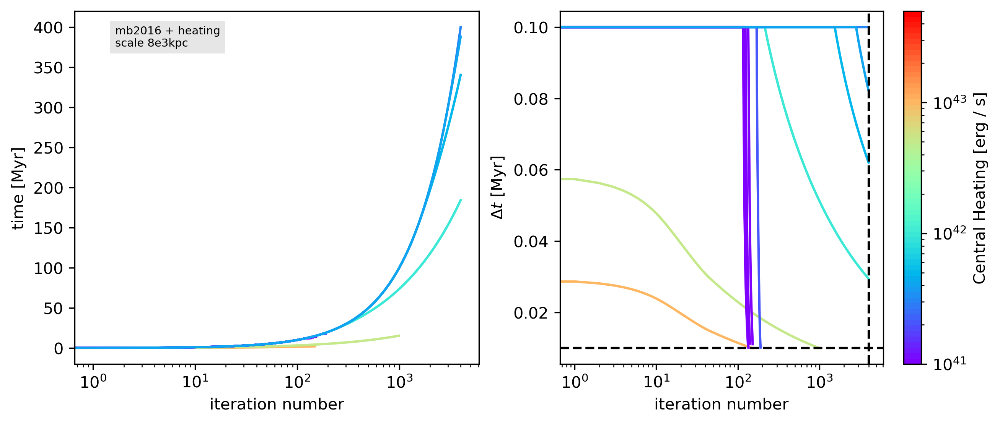

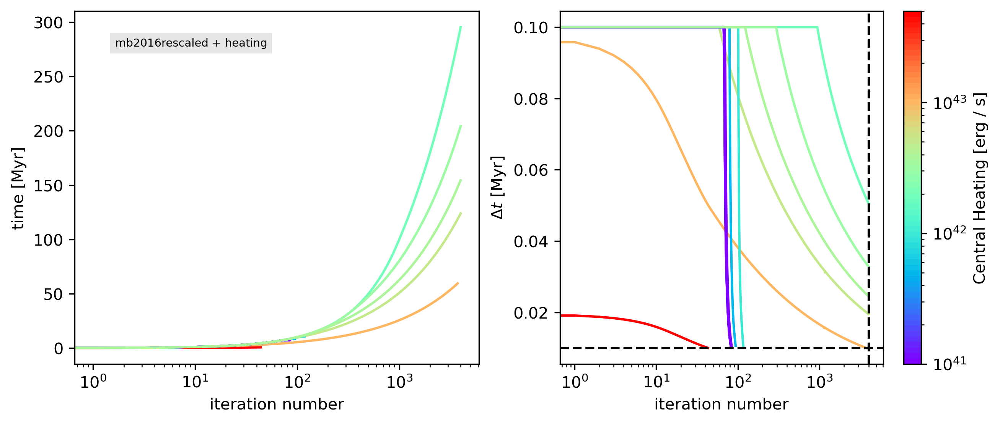

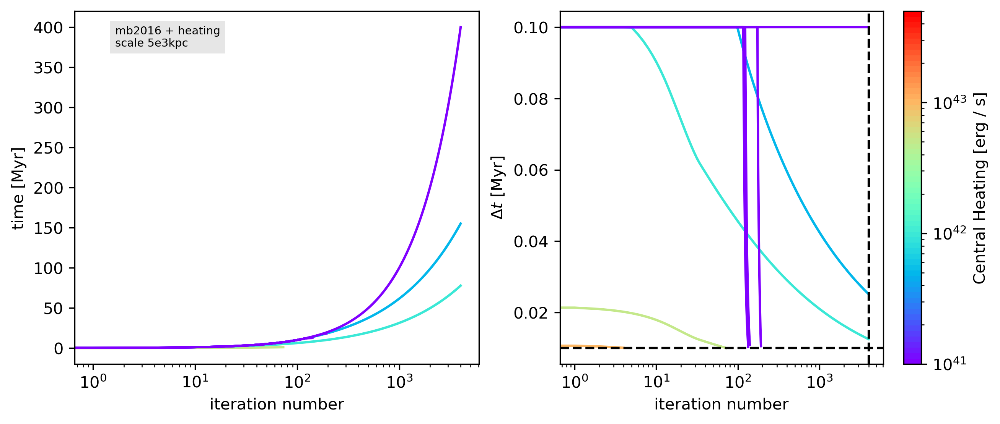

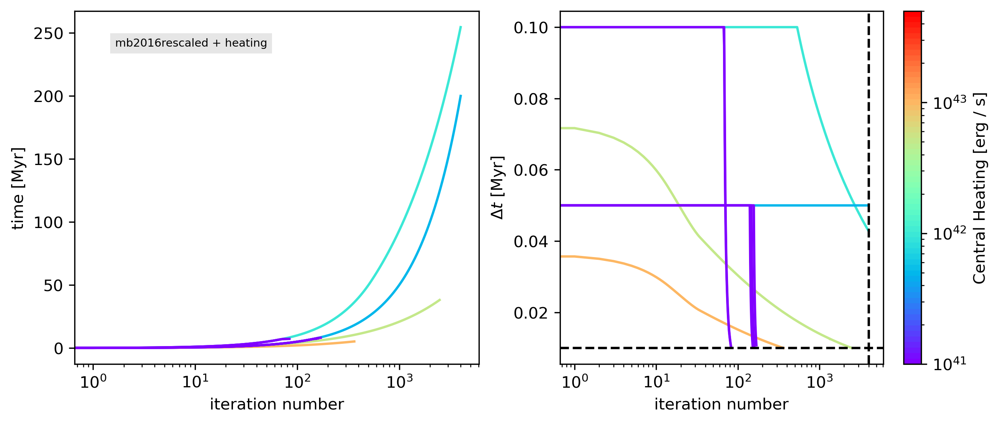

In [254]:
import re
for scale in ["8e3", "5e3"]:
    p0 = re.compile(f'mb2016-E.*-S{scale}')
    p1 = re.compile(f'mb2016rescaled-E.*-S{scale}')

    plot_dict = {k:(v, float(k[-9:-5])) for k, v in res_mw.items() if p0.search(k) is not None}
    fig, axs = time_evolution_plots_energy(plot_dict)
    axs[0].set_xscale('log')

    annotate(f"mb2016 + heating\nscale {scale}kpc", (0.10, 0.90), axs[0])
    savefig(fig, name="mb2016-timeevolution")
    plt.show()

    plot_dict = {k:(v, float(k[-9:-5])) for k, v in res_mw.items() if p1.search(k) is not None}
    fig, axs = time_evolution_plots_energy(plot_dict)
    axs[0].set_xscale('log')
    annotate("mb2016rescaled + heating", (0.10, 0.90), axs[0])

    savefig(fig, name="mb2016rescaled-timeevolution")
    plt.show()

In [287]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize, LogNorm
from matplotlib import colormaps

def timestep_evolution_plots_energy(results, plot_tcool=False, colour_range=None):
    
    cmap = colormaps['rainbow'].resampled(64)
    if colour_range is None:
        colour_range = (1e41, 5e43)
    vmin, vmax = colour_range
        
    norm = LogNorm(vmin=vmin, vmax=vmax)
    mapper = ScalarMappable(norm=norm, cmap=cmap)
    
    
#     fig, axs = plt.subplots(1, 2, figsize=(10, 4), sharex=True)
    fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/1.5, MPL_STD_HEIGHT/1.5))
    
    for name, (result, energy) in results.items():
        mw_param, (ts, rs, ps, ms, ss, tcs) = result

        dts = ts[1:] - ts[:-1]

        color = mapper.to_rgba(energy)
        
#         line, = axs[0].plot(ts, c=color, label=str(energy))
        ax.plot(dts, c=color, label=str(energy))

#     axs[0].set_ylabel('evolution time [Myr]')
#     axs[0].set_xlabel('iteration number')
    
    ax.set_ylabel(r'$\delta t$ [Myr]')
    ax.set_xlabel('iteration number')

    ax.axhline(0.01, ls='--', c='k', label='Stop')
    ax.axvline(4000, ls='--', c='k')
    
    fig.colorbar(ax=ax, mappable=mapper, label="Heating power [erg / s]")
#     axs[0].legend()
#     axs[0].set_yscale('log')
#     axs[1].set_yscale('log')

    return fig, ax


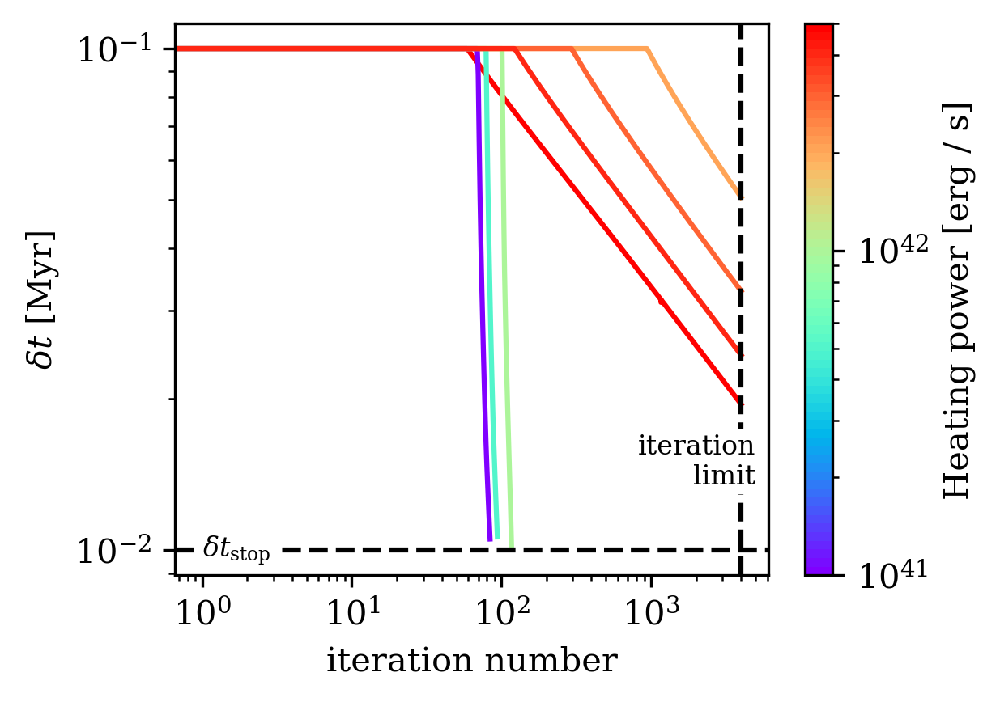

In [707]:
import re
scale = "8e3"

# p0 = re.compile(f'mb2016-E.*-S{scale}')
p1 = re.compile(f'mb2016rescaled-E.*-S{scale}')

# plot_dict = {k:(v, float(k[-9:-5])) for k, v in res_mw.items() if p0.search(k) is not None}
# fig, axs = time_evolution_plots_energy(plot_dict)
# axs[0].set_xscale('log')

# annotate(f"mb2016 + heating\nscale {scale}kpc", (0.10, 0.90), axs[0])
# savefig(fig, name="mb2016-timeevolution")
# plt.show()

E_range = (1e41, 5e42)
plot_dict = {k:(v, float(k[-9:-5])) for k, v in res_mw.items() if p1.search(k) is not None and (E_range[0] <= float(k[-9:-5]) <= E_range[1])}

# for k, (result, E) in plot_dict.items():
#     print(k, E)
#     if not (1e41 < E < 1e43):
#         continue
#     print(k, E)
    
#     param, (ts, rs, ps, ms, sigs, _) = result
#     ax[0].plot(ts)
    
#     dts = ts[1:] - ts[:-1]
#     ax[1].plot(dts)
    
    
    
# fig.show()
fig, ax = timestep_evolution_plots_energy(plot_dict, colour_range=E_range)
ax.set_xscale('log')
ax.set_yscale('log')
# annotate("mb2016rescaled + heating", (0.10, 0.90), axs[0])

ax.text(1, 1e-2, r"$\delta t_{\rm stop}$", c='k', va='center', size=8, bbox={'boxstyle': 'square,pad=0.1', 'fc':'white', 'ec':'white'})
ax.text(5000, 1.5e-2, "iteration\nlimit", c='k', ha='right', va='center', size=8, bbox={'boxstyle': 'square,pad=0.1', 'fc':'white', 'ec':'white'})
# axs[0].set_xlim(1, axs[0]._xlim()[-1])

savefig(fig, name="mb2016rescaled-heating-timestep-evol")
fig.show()

### Checks

In [176]:
def time_evolution_plots(results, plot_first_lower_line=False, plot_tcool=False):
    fig, axs = plt.subplots(1, 2, figsize=(10, 4), sharex=True)
    
    for name, result in results.items():
        mw_param, (ts, rs, ps, ms, ss, tcs) = result

        dts = ts[1:] - ts[:-1]


        line, = axs[0].plot(ts, label=name)
        if plot_tcool:
            min_tcool = np.abs(tcs[0]).min()
            axs[0].axhline(min_tcool, ls='--', c=line.get_color())

        axs[1].plot(dts, label=name)
        
        if plot_first_lower_line:
            # Find the iteration where dts is lowered for the first time
            try:
                niter_first_lower = np.where(dts != dts[0])[0][0]
            except:
                # Base case, never lowered, just assign it as the last iteration.
                niter_first_lower = len(dts) - 1

            axs[1].axvline(niter_first_lower, ls='--', c=line.get_color())

    axs[0].set_ylabel('time [Myr]')
    axs[0].set_xlabel('iteration number')
    
    axs[1].set_ylabel(r'$\Delta t$ [Myr]')
    axs[1].set_xlabel('iteration number')

    axs[1].axhline(0.01, ls='--', c='k', label='Stop')
    axs[1].axvline(4000, ls='--', c='k')
    
    axs[0].legend()
#     axs[0].set_yscale('log')
#     axs[1].set_yscale('log')

    return fig, axs


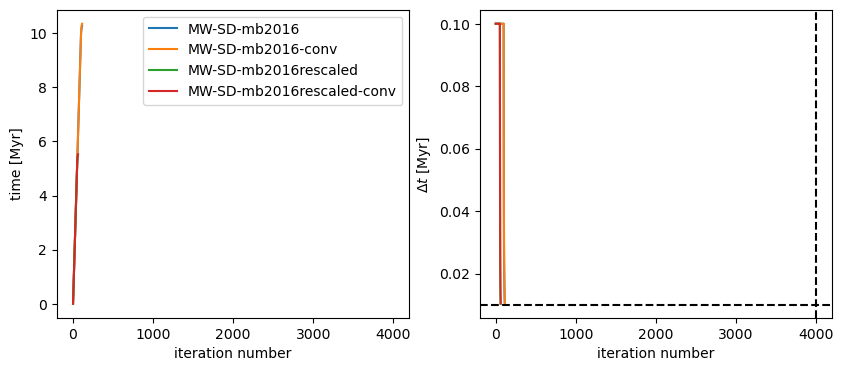

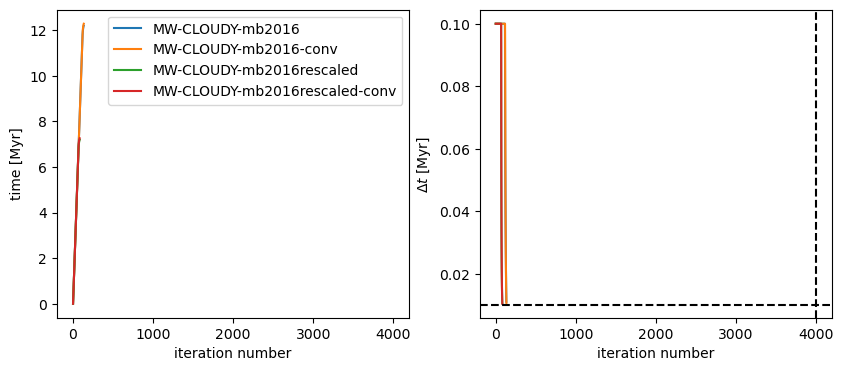

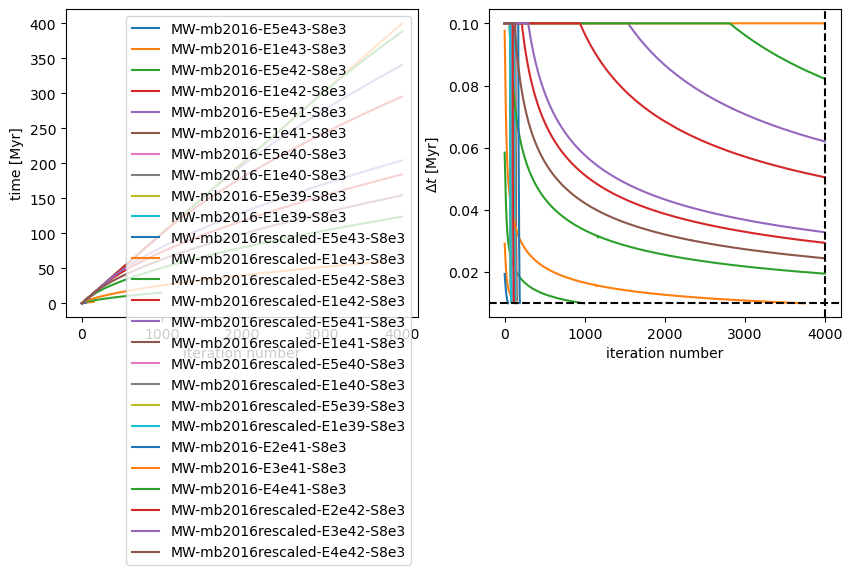

In [177]:
for method in ['SD', 'CLOUDY', 'S8e3']:
    plot_dict = {k:v for k, v in res_mw.items() if method in k}
    fig, axs = time_evolution_plots(plot_dict)
    
    plt.show()

In [175]:
def quality_plots(result):
    mw_param, (ts, rs, ps, ms, ss, tcs) = result

    fig, ax = plt.subplots(2, 2, figsize=(8, 4), sharex=True, tight_layout=True)

    Pinfs = np.array([p[-1] for p in ps])
    ax[0, 0].plot(ts, (Pinfs - mw_param.P_inf) / mw_param.P_inf)
    ax[0, 0].axhline(0, ls='--', c='k')
    ax[0, 0].set_ylabel('$P_\infty$: (found - ref) / ref ')

    M_tots = np.array([m[-1] for m in ms])
    ax[0, 1].plot(ts, (M_tots - mw_param.M_tot) / mw_param.M_tot)
    ax[0, 1].set_ylabel('$M_{tot}$: (found - ref) / ref')

    Rinfs = np.array([r[-1] for r in rs])
    ax[1, 0].plot(ts, Rinfs)
    ax[1, 0].set_ylabel('$R_{out}$ [pc]')

    sig0s = np.array([s[-1] for s in ss])
    ax[1, 1].plot(ts, sig0s - mw_param.sig[0])
    ax[1, 1].set_ylabel('$\sigma_0(t) - \sigma_0(0)$')

    # Print the values:
    # print(Pinfs - mw_param.P_inf)
    # print(sig0s - mw_param.sig[0])

    for a in ax.flat:
        a.set_xlabel('t [Myr]')

        
    return fig, ax

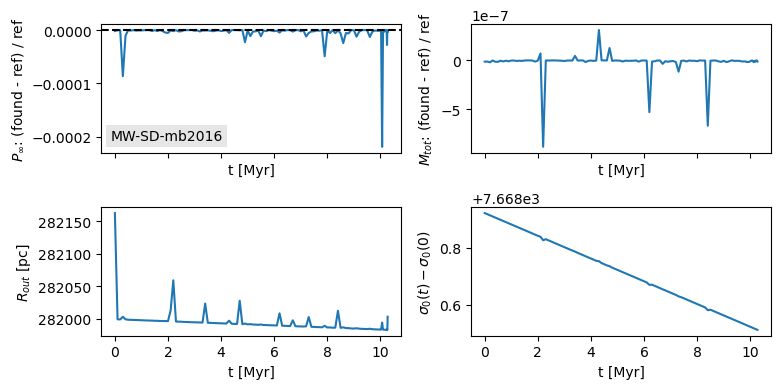

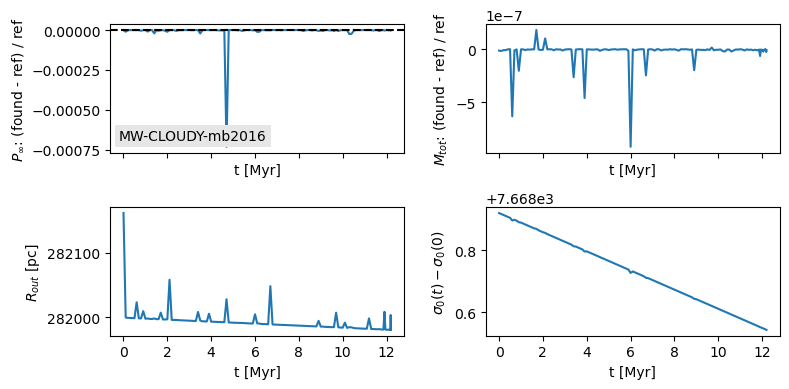

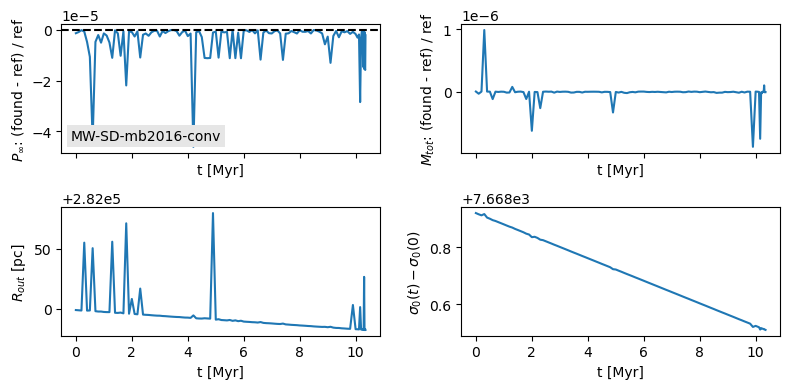

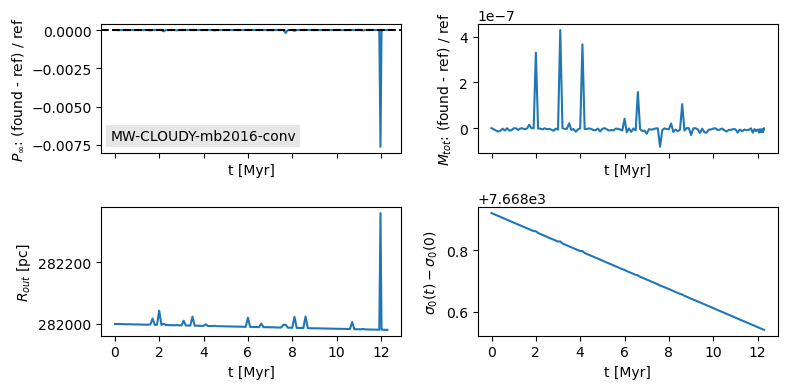

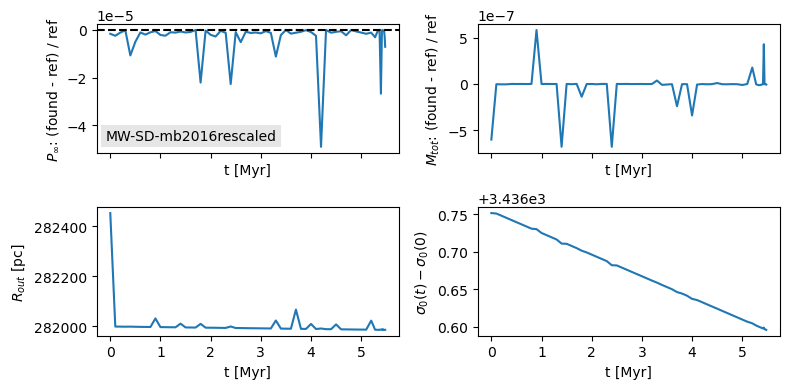

...

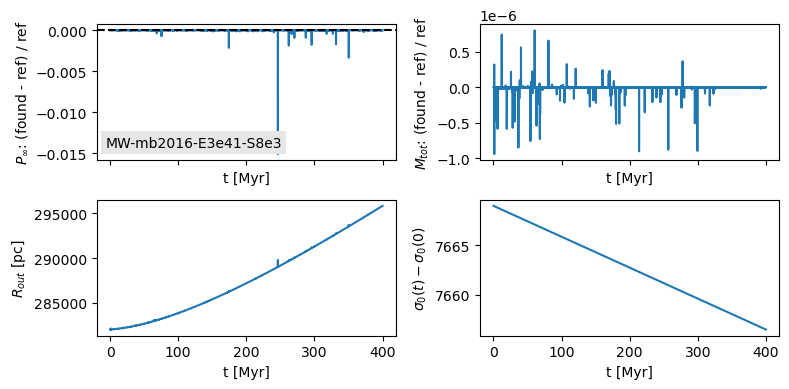

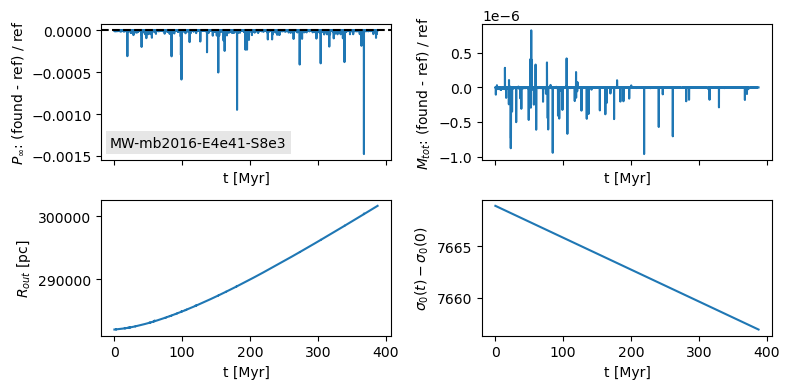

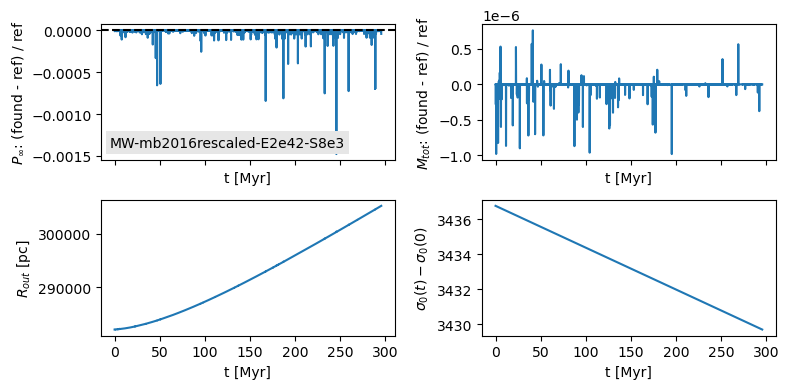

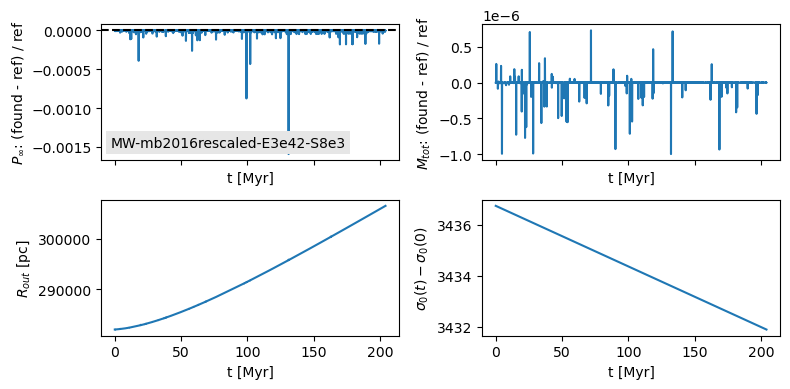

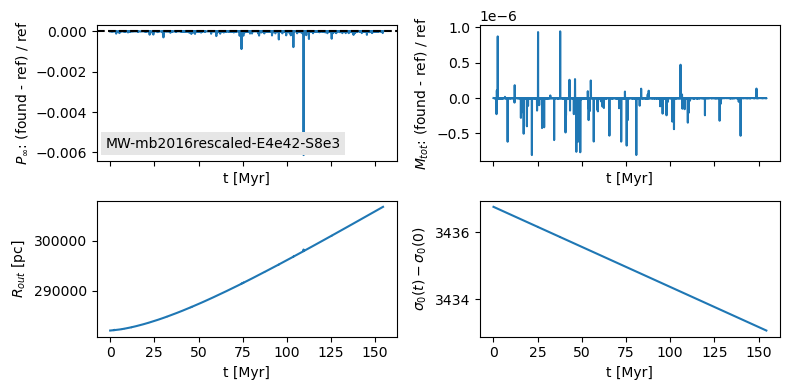

In [178]:
for name, result in res_mw.items():
#     fig, ax = plot_cooling_time(result)
    fig, ax = quality_plots(result)
    annotate(name, (0.03, 0.10), ax[0,0])
    plt.show()

### Optimization

In [708]:
from kb_integration import stepper_dopr_853_hydrostat, he_derivs, integrate_he

beta_param, Z = ic_mb2016()
P_original, M_original, _, r_original, param = mw_initial_conditions(beta_param=beta_param)

# *_, mw_param = mw_initial_conditions()
P_0 = param.P_0

Ps = np.linspace(P_0 / 2, P_0 * 2, 50)
# Ps = 10**np.linspace(8400, 9600, 1000)
# Ps = np.linspace(8000, 10000, 1000)

results = []
for p in Ps:
    print(f"{p}")
    r, y = integrate_he(p,
                        M=param.M,
                        sig=param.sig,
                        r_s=param.r_s,
                        rho_s=param.rho_s,
                        M_tot=param.M_tot,
                        P_inf=param.P_inf)

    results.append((r, y))

3.8778279475328783
Pressure low, stopping early
4.115245985136932
Pressure low, stopping early
4.352664022740986
Pressure low, stopping early
4.59008206034504
Pressure low, stopping early
4.827500097949093
Pressure low, stopping early
5.064918135553147
Pressure low, stopping early
5.302336173157201
Pressure low, stopping early
5.539754210761255
Pressure low, stopping early
5.777172248365309
Pressure low, stopping early
6.014590285969362
Pressure low, stopping early
6.252008323573416
Pressure low, stopping early
6.48942636117747
Pressure low, stopping early
6.726844398781523
Pressure low, stopping early
6.964262436385578
Pressure low, stopping early
7.201680473989631
Pressure low, stopping early
7.439098511593684
7.676516549197739
7.913934586801792
8.151352624405847
8.3887706620099
8.626188699613953
8.863606737218008
9.101024774822061
9.338442812426115
9.57586085003017
9.813278887634223
10.050696925238277
10.28811496284233
10.525533000446384
10.762951038050439
11.000369075654492
11.2377

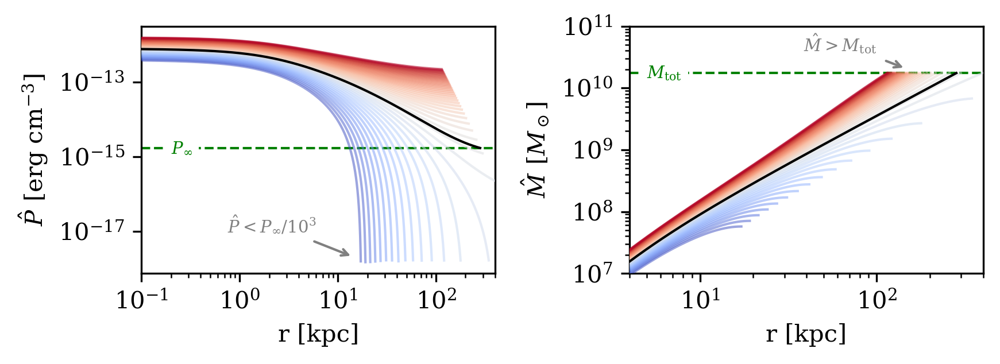

In [709]:
fig, axs = plt.subplots(1, 2, figsize=(MPL_STD_WIDTH, MPL_STD_HEIGHT/2))

cmap = colormaps['Spectral'].resampled(64)
cmap = colormaps['coolwarm'].resampled(64)
norm = LogNorm(vmin=Ps[0], vmax=Ps[-1])
mapper = ScalarMappable(norm=norm, cmap=cmap)

for r, y in results:
    P, M = y.T

    opts = dict(c=mapper.to_rgba(P[0]), alpha=0.5, lw=1, zorder=10)
    axs[0].plot(r / 1e3, P * cst.PRES_UNIT, **opts)
    axs[1].plot(r / 1e3, M * cst.MASS_UNIT / cst.solmass, **opts)


opts = dict(lw=1, c='k', zorder=20)
axs[0].plot(r_original / 1e3, P_original * cst.PRES_UNIT, **opts)
axs[1].plot(r_original / 1e3, M_original * cst.MASS_UNIT / cst.solmass, **opts)

for a in axs:
    a.set_yscale('log')
    a.set_xscale('log')
    a.set_xlim(1e-1, 400)
    a.set_xlabel('r [kpc]')
    
axs[1].set_ylim(1e7, 1e11)
axs[1].set_xlim(4, 400)

axline_opt = dict(lw=1, c='green', ls='--')
axs[0].axhline(param.P_inf * cst.PRES_UNIT, **axline_opt)
axs[1].axhline(param.M_tot * cst.MASS_UNIT / cst.solmass, **axline_opt)
axs[0].set_ylabel('$\hat P$ [erg cm$^{-3}$]')
axs[1].set_ylabel('$\hat M$ [$M_\odot$]')



annotate_opts = dict(fontsize=7, c='grey', arrowprops=dict(edgecolor='grey', arrowstyle='->'))
axs[0].annotate(xy=(1.5e1, 2e-18), xytext=(6, 1e-17), ha='right', text=r"$\hat P < P_\infty / 10^{3}$", **annotate_opts)
axs[1].annotate(xy=(150, 2e10), xytext=(100, 4e10), ha='right', text=r"$\hat M > M_{\rm tot}$", **annotate_opts)

axs[0].text(2e-1, param.P_inf * cst.PRES_UNIT, r"$P_\infty$", c='green', va='center', size=7, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})
axs[1].text(5, param.M_tot * cst.MASS_UNIT / cst.solmass, r"$M_{\rm tot}$", c='green', va='center', size=7, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})


fig.tight_layout()

savefig(fig, "optimization-example")

fig.show()

In [710]:
Ps_actual = Ps[:len(results)]

# Get P_infs
infs = []
outs = []
P0s = []
Mtots = []
for r, y in results:
    P, M = y.T
    P_inf = P[-1]
    infs.append(P_inf)
    R_out = r[-1]
    outs.append(R_out)
    Mtots.append(M[-1])
    
infs = np.array(infs)
outs = np.array(outs)
Mtots = np.array(Mtots)

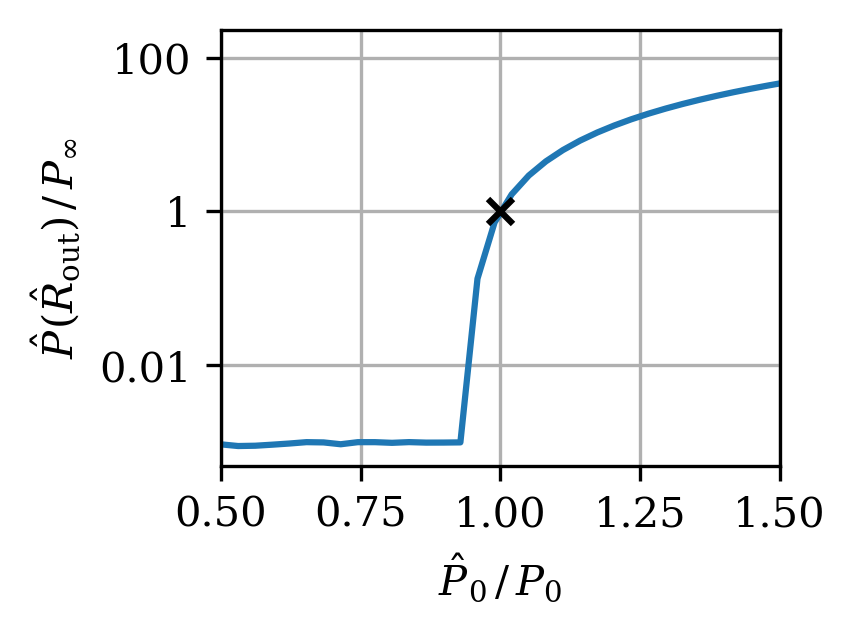

In [711]:
from matplotlib.ticker import FormatStrFormatter

fig, ax = plt.subplots(1, 1, figsize=(MPL_STD_WIDTH/2, MPL_STD_HEIGHT/2), tight_layout=True, sharex=True)

# ax.plot(Ps_actual / P_0, infs, label='$F(P_0)$')
ax.plot(Ps_actual / P_0, infs / param.P_inf , label='$F(P_0)$')

# ax.axhline(param.P_inf *cst.PRES_UNIT , label='reference', ls='--', c='green')
# axs[0].text(2e-1, param.P_inf * cst.PRES_UNIT, r"$P_\infty$", c='green', va='center', size=7, bbox={'boxstyle': 'square,pad=0.3', 'fc':'white', 'ec':'white'})

ax.scatter([1], [1], c='k', marker='x', zorder=10)

ax.grid(True)

ax.set_yscale('log')
ax.set_xlim(0.5, 1.5)

ax.set_ylabel(r"$\hat P(\hat R_{\rm out}) \,/\, P_{\rm \infty}$")
ax.set_xlabel(r"$\hat P_0 \,/\, P_{0}$")
ax.yaxis.set_major_formatter(FormatStrFormatter("%g"))

savefig(fig, "optimization-function")

fig.show()

## Calculations

In [446]:
from astropy import constants as aconst
r0 = 8.5e3

beta_param, Z = ic_mb2016()

P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
sig = param.sig


Pfunc = interp1d(r, P)
P_8kpc = Pfunc(r0) * cst.PRES_UNIT

P_faerman = (2200 / u.cm**3 * u.K) * aconst.k_B

P_faerman2020 = (1350 / u.cm**3 * u.K) * aconst.k_B

beta_param, Z = ic_mb2016_rescaled()
P, M, n_e, r, param = mw_initial_conditions(beta_param=beta_param)
sig = param.sig

Pfunc = interp1d(r, P)
P_8kpc_rescaled = Pfunc(r0) * cst.PRES_UNIT

print(f"faerman: {P_faerman.to('erg / cm3'):.2e}")
print(f"faerman2020: {P_faerman2020.to('erg / cm3'):.2e}")
print(f"mb2016: {P_8kpc:.2e} erg / cm3")
print(f"mb2016-rescaled: {P_8kpc_rescaled:.2e} erg / cm3")

faerman: 3.04e-13 erg / cm3
faerman2020: 1.86e-13 erg / cm3
mb2016: 1.48e-13 erg / cm3
mb2016-rescaled: 4.93e-13 erg / cm3


In [454]:
R = 282 * u.kpc
volume = (4/3)*np.pi*R**3
volume.to('kpc3')
volume.to('Mpc3')

<Quantity 0.09393684 Mpc3>